In [80]:
from joblib import Parallel, delayed
import time
import os
import xml.etree.ElementTree as ET
import re
from datetime import datetime,timedelta
import pytz
import csv
import multiprocessing
import os
from multiprocessing.pool import ThreadPool as Pool
multiprocessing.set_start_method("fork", force=True)
import matplotlib.pyplot as plt

In [2]:
path = "data_info_main_par.csv"
with open(path,'w') as f:
    csv_write = csv.writer(f)
    csv_head = ["Time","Temperature","Relative Humidity"]
    # csv_head = np.array(csv_head)
    # str.encode(csv_head,'utf-8')
    csv_write.writerow(csv_head)

In [3]:
path = "data_info_area_par.csv"
with open(path,'w') as f:
    csv_write = csv.writer(f)
    csv_head = ["Time","Area","Temperature"]
    csv_write.writerow(csv_head)

In [4]:
path = "data_info_rain_par.csv"
with open(path,'w') as f:
    csv_write = csv.writer(f)
    csv_head = ["Time","area","rain"]
    csv_write.writerow(csv_head)

In [5]:
path = "data_info_reminder_par.csv"
with open(path,'w') as f:
    csv_write = csv.writer(f)
    csv_head = ["Time","reminder"]
    csv_write.writerow(csv_head)

In [6]:
path = "data_info_uv_par.csv"
with open(path,'w') as f:
    csv_write = csv.writer(f)
    csv_head = ["Time","UV","Intensity"]
    csv_write.writerow(csv_head)

In [7]:
def convert_to_beijing_time(gmt_time_str):
    
    gmt_timezone = pytz.timezone('GMT')

    gmt_time = datetime.strptime(gmt_time_str, '%a, %d %b %Y %H:%M:%S %Z').replace(tzinfo=gmt_timezone)
    
    beijing_timezone = pytz.timezone('Asia/Shanghai')
    
    beijing_time = gmt_time.astimezone(beijing_timezone)

    return beijing_time.strftime('%Y-%m-%d %H:%M:%S')

In [8]:
def write_xml_main(file_path, xml_path, file_name):

    tree = ET.parse(file_path)
    root = tree.getroot()
    
    data_row = []
    
    # Open the new file in write mode
    with open(file_name + '.txt', 'w') as f:
        for item in root.iter('item'):
            # Extract and write the time
            time = item.find('pubDate').text
            time = convert_to_beijing_time(time)
            f.write(f'Time: {time}\n')
            data_row.append(time)
    
            # Extract and write the air temperature and relative humidity
            description = item.find('description').text
            air_temp_match = re.search('Air temperature : (.*) degrees Celsius', description)
            rel_humidity_match = re.search('Relative Humidity : (.*) per cent', description)
            uv_match = re.search('the mean UV Index recorded at King\'s Park : (.*)<br/>', description)
            remind_match = re.search('reminded that:<br/>(.*)<br/></SPAN><br/>', description)
            air_temp = air_temp_match.group(1) if air_temp_match else 'NONE'
            rel_humidity = rel_humidity_match.group(1) if rel_humidity_match else 'NONE'
            uv = uv_match.group(1) if uv_match else 'NONE'
            remind = remind_match.group(1) if remind_match else 'NONE'
            f.write(f'Air Temperature: {air_temp} degrees Celsius\n')
            f.write(f'Relative Humidity: {rel_humidity} per cent\n')
            f.write(f'the mean UV Index recorded at King\'s Park : {uv}\n')
            f.write(f'remind that: {remind}\n')
            data_row.append(air_temp)
            data_row.append(rel_humidity)
            print(data_row)
    
            # Extract and write the air temperatures at other places
            f.write('Air Temperatures at Other Places:\n')
            for match in re.finditer('<tr><td><font size="-1">(.*?)</font></td><td width="100" align="right"><font size="-1">(.*?) ;</font></td></tr>', description):
                place_temp = match.group(1) + ' ' + match.group(2)
                f.write(f'{place_temp}\n')
    
            # Extract and write the rainfall recorded in various regions
            f.write('Rainfall Recorded in Various Regions:\n')
            for match in re.finditer('<tr><td>(.*?)</td><td width="100" align="right">(.*?)&nbsp;mm.', description):
                rainfall = match.group(1) + ' ' + match.group(2) + ' mm' 
                f.write(f'{rainfall}\n')
    
    # write the xml file
    with open(xml_path, 'a+') as f:
        csv_write = csv.writer(f)
        csv_write.writerow(data_row)

In [9]:
def write_xml_area(file_path, xml_path):

    tree = ET.parse(file_path)
    root = tree.getroot()
    
    # Open the new file in write mode
    for item in root.iter('item'):
        time = item.find('pubDate').text
        time = convert_to_beijing_time(time)
        
    
        description = item.find('description').text
        
        # Extract and write the air temperatures at other places
        for match in re.finditer('<tr><td><font size="-1">(.*?)</font></td><td width="100" align="right"><font size="-1">(.*?) degrees ', description):
            data_row = []
            data_row.append(time)
            place = match.group(1)
            place_temp = match.group(2)
            data_row.append(place)
            data_row.append(place_temp)
            print(data_row)
            with open(xml_path, 'a+') as f:
                csv_write = csv.writer(f)
                csv_write.writerow(data_row)

In [10]:
def write_xml_rain(file_path, xml_path):

    tree = ET.parse(file_path)
    root = tree.getroot()
    
    
    # Open the new file in write mode
    for item in root.iter('item'):
        time = item.find('pubDate').text
        time = convert_to_beijing_time(time)
        
    
        description = item.find('description').text
        
            
        for match in re.finditer('<tr><td>(.*?)</td><td width="100" align="right">(.*?)&nbsp;mm.', description):
            data_row = []
            data_row.append(time)
            rain_place = match.group(1)
            rainfall = match.group(2)
            data_row.append(rain_place)
            data_row.append(rainfall)
            print(data_row)
            if data_row.__len__() != 1:
                with open(xml_path, 'a+') as f:
                    csv_write = csv.writer(f)
                    csv_write.writerow(data_row)
    

In [11]:
def write_xml_uv(file_path, xml_path):

    tree = ET.parse(file_path)
    root = tree.getroot()
    
    data_row = []
    
    # Open the new file in write mode
    for item in root.iter('item'):
        time = item.find('pubDate').text
        time = convert_to_beijing_time(time)
        data_row.append(time)
    
        description = item.find('description').text
        
        # Extract and write the air temperatures at other places
        uv_match = re.search('the mean UV Index recorded at King\'s Park : (.*)<br/>\n', description)
        uv = uv_match.group(1) if uv_match else 'NONE'
        if uv != 'NONE':
            data_row.append(uv)
            Intensity = re.search('Intensity of UV radiation : (.*)<br/>', description).group(1)
            if Intensity.__len__() > 20:
                Intensity = Intensity.split('<br/>',1)[0]
                data_row.append(Intensity)
            else:
                data_row.append(Intensity)
            print(data_row)
            
    # write the xml file
    if data_row.__len__() != 1:
        with open(xml_path, 'a+') as f:
            csv_write = csv.writer(f)
            csv_write.writerow(data_row)

In [14]:
path = '/Users/lpl/Desktop/bigdata new/CS5488-Group8-main/data'

path_list = os.listdir(path)

#path_list.remove('.DS_Store')

path_list.sort()

print(path_list)

['20221001-0001.xml', '20221001-0101.xml', '20221001-0201.xml', '20221001-0301.xml', '20221001-0401.xml', '20221001-0501.xml', '20221001-0601.xml', '20221001-0701.xml', '20221001-0801.xml', '20221001-0901.xml', '20221001-1001.xml', '20221001-1101.xml', '20221001-1201.xml', '20221001-1301.xml', '20221001-1401.xml', '20221001-1501.xml', '20221001-1601.xml', '20221001-1701.xml', '20221001-1801.xml', '20221001-1901.xml', '20221001-2001.xml', '20221001-2101.xml', '20221001-2201.xml', '20221001-2301.xml', '20221002-0001.xml', '20221002-0101.xml', '20221002-0201.xml', '20221002-0301.xml', '20221002-0401.xml', '20221002-0501.xml', '20221002-0601.xml', '20221002-0701.xml', '20221002-0801.xml', '20221002-0901.xml', '20221002-1001.xml', '20221002-1101.xml', '20221002-1201.xml', '20221002-1301.xml', '20221002-1401.xml', '20221002-1501.xml', '20221002-1601.xml', '20221002-1701.xml', '20221002-1801.xml', '20221002-1901.xml', '20221002-2001.xml', '20221002-2101.xml', '20221002-2201.xml', '20221002-23

## without using any function

In [62]:
name_list=['main','area','rain','uv']
time_list_none=[]

In [29]:
xml_path = '/Users/lpl/Desktop/bigdata new/CS5488-Group8-main/data_info_main_par.csv'

start_main=time.time()

for f in path_list:
    file_path = '/Users/lpl/Desktop/bigdata new/CS5488-Group8-main/data/' + f
    file_name = f[0:13]
    final_file_name = '/Users/lpl/Desktop/bigdata new/CS5488-Group8-main/data_txt/' + file_name
    write_xml_main(file_path, xml_path, final_file_name)
    
end_main=time.time()


['2022-09-30 23:11:00', '26', '93']
['2022-10-01 00:02:00', '26', '93']
['2022-10-01 01:02:00', '26', '93']
['2022-10-01 02:02:00', '26', '93']
['2022-10-01 03:02:00', '26', '94']
['2022-10-01 04:02:00', '26', '93']
['2022-10-01 05:02:00', '26', '92']
['2022-10-01 06:02:00', '27', '91']
['2022-10-01 07:02:00', '27', '90']
['2022-10-01 08:02:00', '27', '87']
['2022-10-01 09:02:00', '28', '87']
['2022-10-01 10:02:00', '28', '84']
['2022-10-01 11:02:00', '29', '82']
['2022-10-01 12:02:00', '29', '78']
['2022-10-01 13:30:00', '29', '87']
['2022-10-01 14:31:00', '30', '76']
['2022-10-01 15:26:00', '29', '81']
['2022-10-01 16:02:00', '28', '83']
['2022-10-01 17:11:00', '28', '83']
['2022-10-01 18:02:00', '28', '83']
['2022-10-01 19:02:00', '28', '84']
['2022-10-01 20:02:00', '28', '84']
['2022-10-01 21:02:00', '28', '83']
['2022-10-01 22:02:00', '28', '85']
['2022-10-01 23:02:00', '28', '85']
['2022-10-02 00:02:00', '28', '85']
['2022-10-02 01:02:00', '28', '85']
['2022-10-02 02:02:00', '28'

['2022-10-11 05:02:00', '22', '44']
['2022-10-11 06:02:00', '21', '46']
['2022-10-11 07:02:00', '21', '47']
['2022-10-11 08:02:00', '21', '50']
['2022-10-11 09:02:00', '22', '46']
['2022-10-11 10:02:00', '23', '46']
['2022-10-11 11:02:00', '25', '44']
['2022-10-11 12:02:00', '26', '43']
['2022-10-11 13:02:00', '27', '44']
['2022-10-11 14:02:00', '28', '44']
['2022-10-11 15:02:00', '28', '44']
['2022-10-11 16:02:00', '28', '44']
['2022-10-11 17:02:00', '26', '50']
['2022-10-11 18:02:00', '25', '55']
['2022-10-11 19:02:00', '25', '55']
['2022-10-11 20:02:00', '24', '57']
['2022-10-11 21:02:00', '24', '57']
['2022-10-11 22:02:00', '24', '57']
['2022-10-11 23:02:00', '24', '55']
['2022-10-12 00:02:00', '24', '60']
['2022-10-12 01:02:00', '24', '63']
['2022-10-12 02:02:00', '24', '63']
['2022-10-12 03:02:00', '23', '58']
['2022-10-12 04:02:00', '23', '58']
['2022-10-12 05:02:00', '23', '50']
['2022-10-12 06:02:00', '22', '46']
['2022-10-12 07:02:00', '22', '42']
['2022-10-12 08:02:00', '22'

['2022-10-20 21:02:00', '25', '70']
['2022-10-20 22:02:00', '25', '72']
['2022-10-20 23:02:00', '25', '71']
['2022-10-21 00:02:00', '24', '75']
['2022-10-21 01:02:00', '24', '74']
['2022-10-21 02:02:00', '24', '72']
['2022-10-21 03:02:00', '24', '74']
['2022-10-21 04:02:00', '24', '73']
['2022-10-21 05:02:00', '23', '72']
['2022-10-21 06:02:00', '23', '74']
['2022-10-21 07:02:00', '23', '70']
['2022-10-21 08:02:00', '24', '68']
['2022-10-21 09:02:00', '24', '67']
['2022-10-21 10:02:00', '25', '61']
['2022-10-21 11:02:00', '27', '59']
['2022-10-21 12:02:00', '27', '54']
['2022-10-21 13:02:00', '28', '56']
['2022-10-21 14:02:00', '28', '54']
['2022-10-21 15:02:00', '28', '58']
['2022-10-21 16:02:00', '28', '61']
['2022-10-21 17:02:00', '26', '65']
['2022-10-21 18:02:00', '25', '67']
['2022-10-21 19:02:00', '25', '68']
['2022-10-21 20:02:00', '25', '73']
['2022-10-21 21:02:00', '25', '76']
['2022-10-21 22:02:00', '25', '77']
['2022-10-21 23:02:00', '24', '79']
['2022-10-22 00:02:00', '24'

['2022-10-31 16:21:00', '27', '47']
['2022-10-31 17:02:00', '27', '47']
['2022-10-31 18:02:00', '27', '44']
['2022-10-31 19:02:00', '26', '45']
['2022-10-31 20:02:00', '27', '42']
['2022-10-31 21:02:00', '26', '42']
['2022-10-31 22:02:00', '26', '42']
['2022-10-31 23:02:00', '26', '43']
['2022-11-01 00:02:00', '25', '46']
['2022-11-01 01:02:00', '25', '45']
['2022-11-01 02:02:00', '25', '48']
['2022-11-01 03:02:00', '24', '49']
['2022-11-01 04:02:00', '24', '48']
['2022-11-01 05:02:00', '24', '48']
['2022-11-01 06:02:00', '23', '49']
['2022-11-01 07:02:00', '23', '50']
['2022-11-01 08:02:00', '23', '49']
['2022-11-01 09:02:00', '23', '53']
['2022-11-01 10:02:00', '22', '65']
['2022-11-01 11:02:00', '22', '60']
['2022-11-01 12:02:00', '23', '57']
['2022-11-01 13:02:00', '22', '61']
['2022-11-01 14:02:00', '21', '69']
['2022-11-01 15:02:00', '20', '82']
['2022-11-01 16:02:00', '19', '89']
['2022-11-01 17:02:00', '19', '85']
['2022-11-01 18:02:00', '20', '84']
['2022-11-01 19:02:00', '20'

['2022-11-10 13:02:00', '27', '65']
['2022-11-10 14:02:00', '27', '67']
['2022-11-10 15:02:00', '27', '67']
['2022-11-10 16:02:00', '27', '69']
['2022-11-10 17:02:00', '26', '73']
['2022-11-10 18:02:00', '25', '77']
['2022-11-10 19:02:00', '25', '81']
['2022-11-10 20:02:00', '25', '79']
['2022-11-10 21:02:00', '24', '84']
['2022-11-10 22:02:00', '24', '84']
['2022-11-10 23:02:00', '24', '84']
['2022-11-11 00:02:00', '24', '85']
['2022-11-11 01:02:00', '24', '85']
['2022-11-11 02:02:00', '24', '83']
['2022-11-11 03:02:00', '24', '84']
['2022-11-11 04:02:00', '24', '81']
['2022-11-11 05:02:00', '23', '81']
['2022-11-11 06:02:00', '24', '81']
['2022-11-11 07:02:00', '24', '82']
['2022-11-11 08:02:00', '24', '80']
['2022-11-11 09:02:00', '25', '76']
['2022-11-11 10:02:00', '25', '79']
['2022-11-11 11:02:00', '26', '74']
['2022-11-11 12:02:00', '27', '67']
['2022-11-11 13:02:00', '27', '65']
['2022-11-11 14:02:00', '27', '66']
['2022-11-11 15:02:00', '27', '66']
['2022-11-11 16:02:00', '27'

['2022-11-21 03:02:00', '23', '77']
['2022-11-21 04:02:00', '23', '80']
['2022-11-21 05:02:00', '23', '79']
['2022-11-21 06:02:00', '23', '77']
['2022-11-21 07:02:00', '23', '77']
['2022-11-21 08:02:00', '24', '76']
['2022-11-21 09:02:00', '24', '77']
['2022-11-21 10:02:00', '24', '74']
['2022-11-21 11:02:00', '25', '71']
['2022-11-21 12:02:00', '25', '69']
['2022-11-21 13:02:00', '25', '71']
['2022-11-21 14:02:00', '25', '74']
['2022-11-21 15:02:00', '25', '74']
['2022-11-21 16:02:00', '25', '79']
['2022-11-21 17:02:00', '23', '89']
['2022-11-21 18:02:00', '23', '83']
['2022-11-21 19:02:00', '24', '81']
['2022-11-21 20:02:00', '23', '84']
['2022-11-21 21:02:00', '23', '83']
['2022-11-21 22:02:00', '23', '85']
['2022-11-21 23:02:00', '23', '85']
['2022-11-22 00:02:00', '23', '83']
['2022-11-22 01:02:00', '23', '82']
['2022-11-22 02:02:00', '23', '85']
['2022-11-22 03:02:00', '23', '87']
['2022-11-22 04:02:00', '23', '88']
['2022-11-22 05:02:00', '23', '86']
['2022-11-22 06:02:00', '23'

['2022-12-01 08:02:00', '16', '79']
['2022-12-01 09:02:00', '16', '76']
['2022-12-01 10:02:00', '16', '76']
['2022-12-01 11:02:00', '17', '72']
['2022-12-01 12:02:00', '18', '69']
['2022-12-01 13:02:00', '18', '67']
['2022-12-01 14:02:00', '18', '66']
['2022-12-01 15:02:00', '17', '67']
['2022-12-01 16:02:00', '17', '67']
['2022-12-01 17:02:00', '16', '68']
['2022-12-01 18:02:00', '16', '73']
['2022-12-01 19:02:00', '16', '71']
['2022-12-01 20:02:00', '16', '72']
['2022-12-01 21:02:00', '15', '71']
['2022-12-01 22:02:00', '15', '72']
['2022-12-01 23:02:00', '15', '71']
['2022-12-02 00:02:00', '15', '71']
['2022-12-02 01:02:00', '15', '72']
['2022-12-02 02:02:00', '15', '74']
['2022-12-02 03:02:00', '15', '74']
['2022-12-02 04:02:00', '15', '74']
['2022-12-02 05:02:00', '14', '77']
['2022-12-02 06:02:00', '14', '74']
['2022-12-02 07:02:00', '14', '73']
['2022-12-02 08:02:00', '14', '70']
['2022-12-02 09:02:00', '15', '69']
['2022-12-02 10:02:00', '15', '66']
['2022-12-02 11:02:00', '17'

['2022-12-12 06:02:00', '15', '65']
['2022-12-12 07:02:00', '15', '66']
['2022-12-12 08:02:00', '15', '66']
['2022-12-12 09:02:00', '15', '67']
['2022-12-12 10:02:00', '16', '65']
['2022-12-12 11:02:00', '17', '61']
['2022-12-12 12:02:00', '17', '58']
['2022-12-12 13:02:00', '17', '58']
['2022-12-12 14:02:00', '18', '56']
['2022-12-12 15:02:00', '18', '56']
['2022-12-12 16:02:00', '17', '55']
['2022-12-12 17:02:00', '17', '57']
['2022-12-12 18:02:00', '17', '60']
['2022-12-12 19:02:00', '16', '60']
['2022-12-12 20:02:00', '16', '57']
['2022-12-12 21:02:00', '16', '58']
['2022-12-12 22:02:00', '16', '59']
['2022-12-12 23:02:00', '16', '60']
['2022-12-13 00:02:00', '15', '59']
['2022-12-13 01:02:00', '15', '59']
['2022-12-13 02:02:00', '15', '60']
['2022-12-13 03:02:00', '15', '63']
['2022-12-13 04:02:00', '15', '61']
['2022-12-13 05:02:00', '15', '60']
['2022-12-13 06:02:00', '15', '63']
['2022-12-13 07:02:00', '15', '63']
['2022-12-13 08:02:00', '15', '60']
['2022-12-13 09:02:00', '15'

['2022-12-23 16:02:00', '19', '41']
['2022-12-23 17:02:00', '18', '46']
['2022-12-23 18:02:00', '17', '50']
['2022-12-23 19:02:00', '17', '49']
['2022-12-23 20:02:00', '17', '52']
['2022-12-23 21:02:00', '17', '52']
['2022-12-23 22:02:00', '17', '50']
['2022-12-23 23:02:00', '16', '45']
['2022-12-24 00:02:00', '16', '51']
['2022-12-24 01:02:00', '16', '57']
['2022-12-24 02:02:00', '16', '65']
['2022-12-24 03:02:00', '16', '64']
['2022-12-24 04:02:00', '15', '60']
['2022-12-24 05:02:00', '15', '54']
['2022-12-24 06:02:00', '15', '47']
['2022-12-24 07:02:00', '15', '37']
['2022-12-24 08:02:00', '15', '44']
['2022-12-24 09:02:00', '15', '36']
['2022-12-24 10:02:00', '16', '36']
['2022-12-24 11:02:00', '18', '31']
['2022-12-24 12:02:00', '19', '33']
['2022-12-24 13:02:00', '20', '35']
['2022-12-24 14:02:00', '19', '34']
['2022-12-24 15:02:00', '19', '37']
['2022-12-24 16:02:00', '19', '38']
['2022-12-24 17:02:00', '18', '49']
['2022-12-24 18:02:00', '18', '52']
['2022-12-24 19:02:00', '17'

['2023-01-04 11:02:00', '17', '72']
['2023-01-04 12:02:00', '18', '68']
['2023-01-04 13:02:00', '19', '66']
['2023-01-04 14:02:00', '19', '67']
['2023-01-04 15:02:00', '20', '67']
['2023-01-04 16:02:00', '19', '68']
['2023-01-04 17:02:00', '18', '72']
['2023-01-04 18:02:00', '18', '75']
['2023-01-04 19:02:00', '17', '79']
['2023-01-04 20:02:00', '18', '79']
['2023-01-04 21:02:00', '18', '80']
['2023-01-04 22:02:00', '17', '79']
['2023-01-04 23:02:00', '17', '80']
['2023-01-05 00:02:00', '17', '79']
['2023-01-05 01:02:00', '17', '80']
['2023-01-05 02:02:00', '17', '81']
['2023-01-05 03:02:00', '17', '82']
['2023-01-05 04:02:00', '17', '81']
['2023-01-05 05:02:00', '17', '83']
['2023-01-05 06:02:00', '17', '83']
['2023-01-05 07:02:00', '17', '84']
['2023-01-05 08:02:00', '17', '83']
['2023-01-05 09:02:00', '18', '78']
['2023-01-05 10:02:00', '19', '72']
['2023-01-05 11:02:00', '20', '70']
['2023-01-05 12:02:00', '21', '66']
['2023-01-05 13:02:00', '21', '67']
['2023-01-05 14:02:00', '21'

['2023-01-15 16:21:00', '18', '73']
['2023-01-15 17:02:00', '17', '73']
['2023-01-15 18:31:00', '17', '72']
['2023-01-15 19:02:00', '16', '71']
['2023-01-15 20:02:00', '15', '67']
['2023-01-15 21:02:00', '15', '67']
['2023-01-15 22:02:00', '14', '70']
['2023-01-15 23:02:00', '13', '70']
['2023-01-16 00:02:00', '13', '67']
['2023-01-16 01:02:00', '13', '66']
['2023-01-16 02:02:00', '13', '65']
['2023-01-16 03:02:00', '12', '65']
['2023-01-16 04:02:00', '12', '65']
['2023-01-16 05:02:00', '12', '65']
['2023-01-16 06:02:00', '12', '64']
['2023-01-16 07:02:00', '12', '66']
['2023-01-16 08:02:00', '11', '67']
['2023-01-16 09:46:00', '12', '64']
['2023-01-16 10:02:00', '12', '65']
['2023-01-16 11:02:00', '12', '67']
['2023-01-16 12:02:00', '13', '67']
['2023-01-16 13:02:00', '13', '67']
['2023-01-16 14:02:00', '13', '67']
['2023-01-16 15:02:00', '13', '65']
['2023-01-16 16:02:00', '13', '66']
['2023-01-16 17:02:00', '13', '66']
['2023-01-16 18:02:00', '13', '65']
['2023-01-16 19:02:00', '12'

['2023-01-27 08:02:00', '15', '62']
['2023-01-27 09:02:00', '15', '57']
['2023-01-27 10:02:00', '16', '52']
['2023-01-27 11:02:00', '16', '45']
['2023-01-27 12:02:00', '16', '39']
['2023-01-27 13:02:00', '16', '38']
['2023-01-27 14:02:00', '17', '36']
['2023-01-27 15:02:00', '17', '33']
['2023-01-27 16:02:00', '17', '33']
['2023-01-27 17:02:00', '15', '34']
['2023-01-27 18:02:00', '15', '36']
['2023-01-27 19:02:00', '14', '34']
['2023-01-27 20:02:00', '13', '28']
['2023-01-27 21:02:00', '13', '30']
['2023-01-27 22:02:00', '13', '32']
['2023-01-27 23:02:00', '13', '31']
['2023-01-28 00:02:00', '12', '33']
['2023-01-28 01:02:00', '12', '35']
['2023-01-28 02:02:00', '12', '32']
['2023-01-28 03:02:00', '12', '31']
['2023-01-28 04:02:00', '12', '33']
['2023-01-28 05:02:00', '11', '29']
['2023-01-28 06:02:00', '11', '29']
['2023-01-28 07:02:00', '11', '28']
['2023-01-28 08:02:00', '11', '25']
['2023-01-28 09:02:00', '11', '25']
['2023-01-28 10:02:00', '12', '24']
['2023-01-28 11:46:00', '13'

['2023-02-06 21:02:00', '19', '87']
['2023-02-06 22:02:00', '19', '87']
['2023-02-06 23:02:00', '19', '90']
['2023-02-07 00:02:00', '19', '90']
['2023-02-07 01:02:00', '19', '92']
['2023-02-07 02:02:00', '19', '91']
['2023-02-07 03:02:00', '19', '89']
['2023-02-07 04:02:00', '19', '90']
['2023-02-07 05:02:00', '19', '91']
['2023-02-07 06:02:00', '19', '90']
['2023-02-07 07:02:00', '19', '88']
['2023-02-07 08:02:00', '20', '88']
['2023-02-07 09:02:00', '20', '84']
['2023-02-07 10:02:00', '21', '83']
['2023-02-07 11:02:00', '21', '80']
['2023-02-07 12:02:00', '22', '77']
['2023-02-07 13:02:00', '23', '73']
['2023-02-07 14:02:00', '24', '71']
['2023-02-07 15:02:00', '25', '68']
['2023-02-07 16:02:00', '24', '70']
['2023-02-07 17:02:00', '24', '71']
['2023-02-07 18:02:00', '22', '75']
['2023-02-07 19:02:00', '22', '80']
['2023-02-07 20:02:00', '21', '82']
['2023-02-07 21:02:00', '21', '85']
['2023-02-07 22:02:00', '21', '87']
['2023-02-07 23:02:00', '21', '88']
['2023-02-08 00:02:00', '20'

['2023-02-18 04:02:00', '19', '77']
['2023-02-18 05:02:00', '19', '73']
['2023-02-18 06:02:00', '18', '76']
['2023-02-18 07:02:00', '18', '78']
['2023-02-18 08:02:00', '19', '73']
['2023-02-18 09:02:00', '20', '66']
['2023-02-18 10:02:00', '20', '64']
['2023-02-18 11:02:00', '21', '60']
['2023-02-18 12:02:00', '22', '61']
['2023-02-18 13:02:00', '23', '62']
['2023-02-18 14:02:00', '23', '60']
['2023-02-18 15:02:00', '23', '61']
['2023-02-18 16:02:00', '24', '58']
['2023-02-18 17:02:00', '23', '59']
['2023-02-18 18:02:00', '23', '61']
['2023-02-18 19:02:00', '22', '63']
['2023-02-18 20:02:00', '22', '64']
['2023-02-18 21:02:00', '22', '62']
['2023-02-18 22:02:00', '22', '64']
['2023-02-18 23:02:00', '21', '66']
['2023-02-19 00:02:00', '21', '69']
['2023-02-19 01:02:00', '21', '70']
['2023-02-19 02:02:00', '21', '70']
['2023-02-19 03:02:00', '21', '68']
['2023-02-19 04:02:00', '21', '66']
['2023-02-19 05:02:00', '21', '69']
['2023-02-19 06:02:00', '21', '70']
['2023-02-19 07:02:00', '21'

['2023-03-02 15:02:00', '23', '58']
['2023-03-02 16:02:00', '22', '61']
['2023-03-02 17:02:00', '21', '64']
['2023-03-02 18:02:00', '20', '66']
['2023-03-02 19:02:00', '20', '67']
['2023-03-02 20:02:00', '19', '67']
['2023-03-02 21:02:00', '19', '66']
['2023-03-02 22:02:00', '19', '64']
['2023-03-02 23:02:00', '18', '61']
['2023-03-03 00:02:00', '18', '66']
['2023-03-03 01:02:00', '17', '66']
['2023-03-03 02:02:00', '17', '67']
['2023-03-03 03:02:00', '17', '66']
['2023-03-03 04:02:00', '17', '64']
['2023-03-03 05:02:00', '17', '59']
['2023-03-03 06:02:00', '17', '55']
['2023-03-03 07:02:00', '17', '57']
['2023-03-03 08:02:00', '17', '59']
['2023-03-03 09:02:00', '17', '51']
['2023-03-03 10:02:00', '18', '49']
['2023-03-03 11:02:00', '19', '43']
['2023-03-03 12:02:00', '20', '43']
['2023-03-03 13:02:00', '21', '43']
['2023-03-03 14:02:00', '22', '43']
['2023-03-03 15:02:00', '22', '42']
['2023-03-03 16:02:00', '21', '44']
['2023-03-03 17:02:00', '20', '46']
['2023-03-03 19:02:00', '19'

['2023-03-15 01:02:00', '19', '80']
['2023-03-15 02:02:00', '19', '82']
['2023-03-15 03:02:00', '19', '82']
['2023-03-15 04:02:00', '19', '81']
['2023-03-15 05:02:00', '19', '83']
['2023-03-15 06:02:00', '19', '85']
['2023-03-15 07:02:00', '19', '85']
['2023-03-15 08:02:00', '19', '82']
['2023-03-15 09:02:00', '20', '80']
['2023-03-15 10:02:00', '21', '76']
['2023-03-15 11:02:00', '22', '73']
['2023-03-15 12:02:00', '24', '67']
['2023-03-15 13:02:00', '24', '67']
['2023-03-15 14:02:00', '23', '69']
['2023-03-15 15:02:00', '24', '65']
['2023-03-15 16:02:00', '23', '68']
['2023-03-15 17:02:00', '23', '71']
['2023-03-15 18:02:00', '22', '75']
['2023-03-15 19:02:00', '22', '78']
['2023-03-15 20:02:00', '21', '78']
['2023-03-15 21:02:00', '21', '81']
['2023-03-15 22:02:00', '21', '81']
['2023-03-15 23:02:00', '21', '83']
['2023-03-16 00:02:00', '21', '84']
['2023-03-16 01:02:00', '21', '83']
['2023-03-16 02:02:00', '20', '84']
['2023-03-16 03:02:00', '20', '85']
['2023-03-16 04:02:00', '20'

['2023-03-26 17:02:00', '21', '90']
['2023-03-26 18:02:00', '21', '90']
['2023-03-26 19:02:00', '21', '92']
['2023-03-26 20:02:00', '21', '92']
['2023-03-26 21:02:00', '21', '89']
['2023-03-26 22:02:00', '20', '88']
['2023-03-26 23:02:00', '20', '89']
['2023-03-27 00:02:00', '20', '90']
['2023-03-27 01:51:00', '19', '92']
['2023-03-27 02:02:00', '19', '91']
['2023-03-27 03:31:00', '19', '92']
['2023-03-27 04:02:00', '19', '93']
['2023-03-27 05:46:00', '19', '90']
['2023-03-27 06:02:00', '19', '86']
['2023-03-27 07:02:00', '19', '85']
['2023-03-27 08:02:00', '19', '84']
['2023-03-27 09:02:00', '19', '83']
['2023-03-27 10:02:00', '19', '82']
['2023-03-27 11:02:00', '19', '81']
['2023-03-27 12:02:00', '19', '80']
['2023-03-27 13:02:00', '19', '82']
['2023-03-27 14:02:00', '19', '81']
['2023-03-27 15:02:00', '19', '83']
['2023-03-27 16:02:00', '18', '88']
['2023-03-27 17:02:00', '18', '87']
['2023-03-27 18:02:00', '19', '82']
['2023-03-27 19:02:00', '18', '82']
['2023-03-27 20:02:00', '18'

['2023-04-07 15:02:00', '26', '58']
['2023-04-07 16:02:00', '25', '60']
['2023-04-07 17:02:00', '24', '62']
['2023-04-07 18:02:00', '23', '68']
['2023-04-07 19:02:00', '22', '72']
['2023-04-07 20:02:00', '22', '75']
['2023-04-07 21:02:00', '22', '75']
['2023-04-07 22:02:00', '22', '77']
['2023-04-07 23:02:00', '22', '80']
['2023-04-08 00:02:00', '22', '80']
['2023-04-08 01:02:00', '22', '81']
['2023-04-08 02:02:00', '21', '80']
['2023-04-08 03:02:00', '21', '84']
['2023-04-08 04:02:00', '21', '67']
['2023-04-08 05:02:00', '21', '66']
['2023-04-08 06:02:00', '20', '64']
['2023-04-08 07:02:00', '20', '71']
['2023-04-08 08:02:00', '21', '72']
['2023-04-08 09:02:00', '21', '70']
['2023-04-08 10:02:00', '21', '75']
['2023-04-08 11:02:00', '20', '77']
['2023-04-08 12:02:00', '20', '74']
['2023-04-08 13:02:00', '21', '74']
['2023-04-08 14:02:00', '21', '72']
['2023-04-08 15:02:00', '21', '70']
['2023-04-08 16:02:00', '21', '73']
['2023-04-08 17:02:00', '21', '73']
['2023-04-08 18:02:00', '21'

['2023-04-19 02:02:00', '27', '83']
['2023-04-19 03:02:00', '27', '80']
['2023-04-19 04:02:00', '27', '81']
['2023-04-19 05:02:00', '27', '82']
['2023-04-19 06:02:00', '27', '81']
['2023-04-19 07:02:00', '27', '83']
['2023-04-19 08:46:00', '27', '79']
['2023-04-19 09:46:00', '27', '79']
['2023-04-19 10:31:00', '28', '79']
['2023-04-19 11:11:00', '27', '84']
['2023-04-19 12:31:00', '22', '94']
['2023-04-19 13:31:00', '23', '93']
['2023-04-19 14:31:00', '25', '80']
['2023-04-19 15:02:00', '27', '70']
['2023-04-19 16:36:00', '26', '69']
['2023-04-19 17:02:00', '27', '69']
['2023-04-19 18:45:00', '26', '73']
['2023-04-19 19:13:00', '25', '77']
['2023-04-19 21:02:00', '25', '84']
['2023-04-19 21:16:00', '25', '84']
['2023-04-19 22:36:00', '25', '86']
['2023-04-20 00:02:00', '24', '93']
['2023-04-20 00:46:00', '24', '93']
['2023-04-20 01:02:00', '23', '97']
['2023-04-20 02:02:00', '23', '95']
['2023-04-20 03:02:00', '23', '96']
['2023-04-20 04:16:00', '23', '97']
['2023-04-20 05:41:00', '23'

['2023-04-29 14:02:00', '27', '76']
['2023-04-29 15:02:00', '28', '75']
['2023-04-29 16:02:00', '27', '78']
['2023-04-29 17:02:00', '26', '78']
['2023-04-29 18:02:00', '26', '84']
['2023-04-29 19:02:00', '26', '79']
['2023-04-29 20:02:00', '26', '79']
['2023-04-29 21:02:00', '25', '78']
['2023-04-29 22:02:00', '25', '80']
['2023-04-29 23:02:00', '25', '76']
['2023-04-30 00:02:00', '25', '76']
['2023-04-30 01:02:00', '25', '78']
['2023-04-30 02:02:00', '24', '79']
['2023-04-30 03:02:00', '24', '81']
['2023-04-30 04:02:00', '24', '77']
['2023-04-30 05:02:00', '23', '80']
['2023-04-30 07:02:00', '23', '73']
['2023-04-30 08:02:00', '23', '69']
['2023-04-30 09:02:00', '24', '66']
['2023-04-30 10:02:00', '24', '66']
['2023-04-30 11:02:00', '25', '63']
['2023-04-30 12:02:00', '26', '59']
['2023-04-30 13:02:00', '27', '63']
['2023-04-30 14:02:00', '26', '69']
['2023-04-30 15:02:00', '26', '68']
['2023-04-30 16:02:00', '27', '65']
['2023-04-30 17:02:00', '27', '65']
['2023-04-30 18:02:00', '26'

['2023-05-12 02:02:00', '24', '78']
['2023-05-12 03:02:00', '24', '78']
['2023-05-12 04:02:00', '24', '78']
['2023-05-12 05:02:00', '24', '74']
['2023-05-12 06:02:00', '24', '75']
['2023-05-12 07:02:00', '24', '76']
['2023-05-12 08:02:00', '24', '76']
['2023-05-12 09:02:00', '24', '79']
['2023-05-12 10:02:00', '25', '76']
['2023-05-12 11:02:00', '25', '72']
['2023-05-12 12:02:00', '25', '72']
['2023-05-12 13:02:00', '25', '72']
['2023-05-12 14:02:00', '25', '72']
['2023-05-12 15:02:00', '25', '77']
['2023-05-12 16:02:00', '25', '77']
['2023-05-12 17:02:00', '25', '76']
['2023-05-12 18:02:00', '25', '76']
['2023-05-12 19:02:00', '24', '77']
['2023-05-12 20:02:00', '24', '79']
['2023-05-12 21:02:00', '25', '76']
['2023-05-12 22:02:00', '24', '82']
['2023-05-12 23:02:00', '24', '82']
['2023-05-13 00:02:00', '24', '84']
['2023-05-13 01:02:00', '23', '83']
['2023-05-13 02:02:00', '23', '83']
['2023-05-13 03:02:00', '23', '83']
['2023-05-13 04:02:00', '23', '82']
['2023-05-13 05:02:00', '23'

['2023-06-02 14:51:00', '34', '63']
['2023-06-02 15:02:00', '35', '62']
['2023-06-02 16:21:00', '35', '62']
['2023-06-02 17:02:00', '34', '68']
['2023-06-02 18:02:00', '32', '73']
['2023-06-02 19:02:00', '31', '78']
['2023-06-02 20:02:00', '31', '76']
['2023-06-02 21:02:00', '30', '76']
['2023-06-02 22:02:00', '30', '78']
['2023-06-02 23:02:00', '30', '79']
['2023-06-03 00:02:00', '30', '79']
['2023-06-03 01:02:00', '29', '82']
['2023-06-03 02:02:00', '29', '81']
['2023-06-03 03:02:00', '29', '84']
['2023-06-03 04:02:00', '29', '83']
['2023-06-03 05:02:00', '29', '83']
['2023-06-03 06:02:00', '29', '80']
['2023-06-03 07:02:00', '29', '83']
['2023-06-03 08:02:00', '29', '80']
['2023-06-03 09:02:00', '30', '78']
['2023-06-03 10:02:00', '31', '69']
['2023-06-03 11:02:00', '32', '69']
['2023-06-03 12:02:00', '33', '65']
['2023-06-03 13:31:00', '34', '63']
['2023-06-03 14:46:00', '35', '62']
['2023-06-03 15:02:00', '34', '62']
['2023-06-03 16:21:00', '34', '68']
['2023-06-03 17:02:00', '33'

['2023-06-13 12:26:00', '31', '75']
['2023-06-13 13:26:00', '32', '71']
['2023-06-13 14:02:00', '32', '76']
['2023-06-13 15:02:00', '31', '75']
['2023-06-13 16:21:00', '31', '78']
['2023-06-13 17:31:00', '31', '78']
['2023-06-13 18:31:00', '31', '77']
['2023-06-13 19:46:00', '30', '80']
['2023-06-13 20:50:00', '30', '81']
['2023-06-13 21:31:00', '30', '81']
['2023-06-13 22:51:00', '30', '84']
['2023-06-13 23:12:00', '28', '92']
['2023-06-14 00:36:00', '26', '93']
['2023-06-14 01:41:00', '26', '98']
['2023-06-14 02:02:00', '26', '95']
['2023-06-14 03:26:00', '26', '95']
['2023-06-14 04:02:00', '26', '96']
['2023-06-14 05:51:00', '26', '90']
['2023-06-14 06:26:00', '25', '97']
['2023-06-14 07:51:00', '26', '93']
['2023-06-14 08:21:00', '26', '91']
['2023-06-14 09:02:00', '27', '86']
['2023-06-14 10:02:00', '27', '90']
['2023-06-14 11:02:00', '28', '85']
['2023-06-14 12:02:00', '29', '84']
['2023-06-14 13:02:00', '29', '82']
['2023-06-14 14:46:00', '29', '82']
['2023-06-14 15:02:00', '29'

['2023-06-25 09:31:00', '29', '84']
['2023-06-25 10:02:00', '30', '81']
['2023-06-25 11:02:00', '30', '83']
['2023-06-25 12:02:00', '31', '71']
['2023-06-25 13:31:00', '33', '67']
['2023-06-25 14:52:00', '32', '73']
['2023-06-25 16:02:00', '31', '72']
['2023-06-25 16:21:00', '31', '72']
['2023-06-25 17:02:00', '31', '75']
['2023-06-25 18:02:00', '31', '75']
['2023-06-25 19:02:00', '30', '80']
['2023-06-25 20:02:00', '30', '82']
['2023-06-25 21:02:00', '30', '82']
['2023-06-25 22:02:00', '29', '83']
['2023-06-25 23:02:00', '29', '83']
['2023-06-26 00:02:00', '29', '84']
['2023-06-26 01:02:00', '29', '85']
['2023-06-26 02:02:00', '29', '86']
['2023-06-26 03:02:00', '29', '87']
['2023-06-26 04:02:00', '29', '86']
['2023-06-26 05:02:00', '28', '91']
['2023-06-26 06:52:00', '27', '94']
['2023-06-26 07:31:00', '27', '94']
['2023-06-26 08:46:00', '27', '95']
['2023-06-26 09:11:00', '27', '96']
['2023-06-26 10:26:00', '29', '89']
['2023-06-26 11:02:00', '30', '80']
['2023-06-26 12:02:00', '31'

['2023-07-07 11:02:00', '31', '73']
['2023-07-07 12:02:00', '31', '73']
['2023-07-07 13:02:00', '32', '70']
['2023-07-07 14:02:00', '32', '70']
['2023-07-07 15:02:00', '32', '66']
['2023-07-07 16:02:00', '33', '67']
['2023-07-07 17:02:00', '32', '69']
['2023-07-07 18:02:00', '31', '68']
['2023-07-07 19:02:00', '31', '77']
['2023-07-07 20:02:00', '30', '76']
['2023-07-07 21:02:00', '30', '78']
['2023-07-07 22:02:00', '30', '84']
['2023-07-07 23:02:00', '30', '82']
['2023-07-08 00:02:00', '29', '83']
['2023-07-08 01:02:00', '29', '82']
['2023-07-08 02:02:00', '29', '82']
['2023-07-08 03:02:00', '29', '80']
['2023-07-08 04:02:00', '29', '81']
['2023-07-08 05:02:00', '29', '81']
['2023-07-08 06:02:00', '29', '81']
['2023-07-08 07:02:00', '29', '82']
['2023-07-08 08:02:00', '29', '80']
['2023-07-08 09:02:00', '30', '76']
['2023-07-08 10:02:00', '31', '71']
['2023-07-08 11:02:00', '31', '72']
['2023-07-08 12:02:00', '31', '69']
['2023-07-08 13:02:00', '32', '65']
['2023-07-08 14:02:00', '32'

['2023-07-19 17:02:00', '29', '84']
['2023-07-19 18:02:00', '29', '86']
['2023-07-19 19:02:00', '29', '85']
['2023-07-19 20:02:00', '29', '85']
['2023-07-19 21:02:00', '29', '86']
['2023-07-19 22:02:00', '29', '86']
['2023-07-19 23:02:00', '29', '89']
['2023-07-20 00:02:00', '29', '88']
['2023-07-20 01:02:00', '28', '89']
['2023-07-20 02:02:00', '28', '92']
['2023-07-20 03:26:00', '27', '94']
['2023-07-20 04:02:00', '27', '93']
['2023-07-20 05:30:00', '27', '94']
['2023-07-20 06:02:00', '27', '94']
['2023-07-20 07:02:00', '27', '94']
['2023-07-20 08:02:00', '28', '88']
['2023-07-20 09:46:00', '29', '86']
['2023-07-20 10:02:00', '29', '82']
['2023-07-20 11:02:00', '31', '77']
['2023-07-20 12:02:00', '30', '78']
['2023-07-20 13:02:00', '31', '72']
['2023-07-20 14:02:00', '31', '73']
['2023-07-20 15:26:00', '33', '68']
['2023-07-20 16:02:00', '33', '66']
['2023-07-20 17:02:00', '33', '66']
['2023-07-20 18:02:00', '32', '62']
['2023-07-20 19:02:00', '31', '69']
['2023-07-20 20:02:00', '30'

['2023-07-31 17:16:00', '31', '77']
['2023-07-31 18:02:00', '29', '80']
['2023-07-31 19:02:00', '29', '82']
['2023-07-31 20:02:00', '29', '81']
['2023-07-31 21:02:00', '29', '83']
['2023-07-31 22:02:00', '29', '83']
['2023-07-31 23:02:00', '28', '83']
['2023-08-01 00:02:00', '28', '83']
['2023-08-01 01:02:00', '28', '84']
['2023-08-01 02:02:00', '28', '84']
['2023-08-01 03:02:00', '28', '85']
['2023-08-01 04:02:00', '28', '85']
['2023-08-01 05:02:00', '28', '85']
['2023-08-01 06:02:00', '28', '86']
['2023-08-01 07:02:00', '28', '87']
['2023-08-01 08:02:00', '28', '83']
['2023-08-01 09:02:00', '29', '79']
['2023-08-01 10:51:00', '30', '78']
['2023-08-01 11:51:00', '31', '75']
['2023-08-01 12:02:00', '30', '78']
['2023-08-01 13:31:00', '30', '77']
['2023-08-01 14:02:00', '30', '79']
['2023-08-01 15:02:00', '31', '76']
['2023-08-01 16:02:00', '32', '68']
['2023-08-01 17:02:00', '31', '71']
['2023-08-01 18:02:00', '30', '70']
['2023-08-01 19:02:00', '30', '74']
['2023-08-01 20:02:00', '29'

['2023-08-11 04:31:00', '26', '95']
['2023-08-11 05:31:00', '26', '96']
['2023-08-11 06:11:00', '26', '91']
['2023-08-11 07:02:00', '27', '89']
['2023-08-11 08:02:00', '27', '89']
['2023-08-11 09:31:00', '28', '87']
['2023-08-11 10:02:00', '28', '86']
['2023-08-11 11:30:00', '27', '86']
['2023-08-11 12:02:00', '27', '89']
['2023-08-11 13:02:00', '29', '83']
['2023-08-11 14:02:00', '29', '77']
['2023-08-11 15:46:00', '30', '74']
['2023-08-11 16:45:00', '29', '80']
['2023-08-11 17:02:00', '29', '79']
['2023-08-11 18:02:00', '29', '75']
['2023-08-11 19:02:00', '28', '78']
['2023-08-11 20:02:00', '28', '80']
['2023-08-11 21:02:00', '28', '83']
['2023-08-11 22:02:00', '28', '83']
['2023-08-11 23:02:00', '28', '84']
['2023-08-12 00:41:00', '28', '82']
['2023-08-12 01:02:00', '28', '83']
['2023-08-12 02:02:00', '28', '86']
['2023-08-12 03:41:00', '27', '92']
['2023-08-12 04:02:00', '27', '87']
['2023-08-12 05:02:00', '27', '87']
['2023-08-12 06:02:00', '27', '86']
['2023-08-12 07:02:00', '27'

['2023-08-20 21:22:00', '30', '82']
['2023-08-20 22:41:00', '29', '84']
['2023-08-20 23:02:00', '29', '84']
['2023-08-21 00:02:00', '29', '86']
['2023-08-21 01:02:00', '29', '87']
['2023-08-21 02:02:00', '29', '88']
['2023-08-21 03:02:00', '28', '89']
['2023-08-21 04:02:00', '28', '89']
['2023-08-21 05:02:00', '28', '89']
['2023-08-21 06:46:00', '28', '89']
['2023-08-21 07:02:00', '29', '88']
['2023-08-21 08:02:00', '29', '84']
['2023-08-21 09:57:00', '30', '84']
['2023-08-21 10:02:00', '31', '79']
['2023-08-21 11:47:00', '30', '80']
['2023-08-21 12:02:00', '31', '79']
['2023-08-21 13:31:00', '30', '81']
['2023-08-21 14:02:00', '32', '76']
['2023-08-21 15:02:00', '31', '77']
['2023-08-21 16:02:00', '31', '72']
['2023-08-21 17:02:00', '31', '75']
['2023-08-21 18:02:00', '30', '78']
['2023-08-21 19:02:00', '30', '78']
['2023-08-21 20:02:00', '30', '78']
['2023-08-21 21:02:00', '30', '80']
['2023-08-21 22:02:00', '29', '82']
['2023-08-21 23:02:00', '29', '82']
['2023-08-22 00:02:00', '29'

['2023-09-09 02:02:00', '26', '91']
['2023-09-09 03:02:00', '26', '91']
['2023-09-09 04:02:00', '26', '91']
['2023-09-09 05:02:00', '26', '90']
['2023-09-09 06:02:00', '26', '93']
['2023-09-09 07:02:00', '25', '95']
['2023-09-09 08:02:00', '26', '93']
['2023-09-09 09:51:00', '26', '92']
['2023-09-09 10:02:00', '26', '90']
['2023-09-09 11:02:00', '26', '90']
['2023-09-09 12:02:00', '26', '91']
['2023-09-09 13:51:00', '26', '93']
['2023-09-09 14:02:00', '26', '93']
['2023-09-09 15:16:00', '26', '93']
['2023-09-09 16:02:00', '26', '91']
['2023-09-09 17:02:00', '26', '92']
['2023-09-09 18:02:00', '26', '90']
['2023-09-09 19:02:00', '26', '92']
['2023-09-09 20:02:00', '26', '91']
['2023-09-09 21:02:00', '26', '91']
['2023-09-09 22:02:00', '26', '91']
['2023-09-09 23:02:00', '26', '91']
['2023-09-10 00:02:00', '26', '90']
['2023-09-10 01:02:00', '26', '90']
['2023-09-10 02:02:00', '26', '90']
['2023-09-10 03:02:00', '26', '89']
['2023-09-10 04:02:00', '26', '93']
['2023-09-10 05:16:00', '26'

['2023-09-19 08:02:00', '28', '85']
['2023-09-19 09:02:00', '29', '80']
['2023-09-19 10:02:00', '30', '72']
['2023-09-19 11:02:00', '30', '76']
['2023-09-19 12:51:00', '31', '69']
['2023-09-19 13:02:00', '32', '65']
['2023-09-19 14:02:00', '33', '63']
['2023-09-19 15:02:00', '33', '61']
['2023-09-19 16:02:00', '33', '65']
['2023-09-19 17:02:00', '31', '69']
['2023-09-19 18:02:00', '30', '76']
['2023-09-19 19:02:00', '29', '77']
['2023-09-19 20:02:00', '29', '82']
['2023-09-19 21:02:00', '29', '85']
['2023-09-19 22:02:00', '29', '86']
['2023-09-19 23:02:00', '29', '83']
['2023-09-20 00:02:00', '29', '85']
['2023-09-20 01:02:00', '29', '85']
['2023-09-20 02:02:00', '28', '85']
['2023-09-20 03:02:00', '28', '86']
['2023-09-20 04:02:00', '28', '85']
['2023-09-20 05:02:00', '28', '87']
['2023-09-20 06:46:00', '28', '88']
['2023-09-20 07:02:00', '28', '86']
['2023-09-20 08:02:00', '29', '80']
['2023-09-20 09:02:00', '29', '77']
['2023-09-20 10:02:00', '29', '79']
['2023-09-20 11:02:00', '30'

['2023-09-30 13:21:00', '33', '61']
['2023-09-30 14:21:00', '32', '67']
['2023-09-30 15:41:00', '31', '66']
['2023-09-30 16:02:00', '31', '67']
['2023-09-30 17:02:00', '31', '70']
['2023-09-30 18:02:00', '30', '72']
['2023-09-30 19:02:00', '30', '75']
['2023-09-30 20:02:00', '30', '78']
['2023-09-30 21:02:00', '29', '79']
['2023-09-30 22:02:00', '29', '81']
['2023-09-30 23:02:00', '29', '81']
['2023-10-01 00:02:00', '29', '81']
['2023-10-01 01:02:00', '29', '82']
['2023-10-01 02:02:00', '28', '86']
['2023-10-01 03:02:00', '28', '87']
['2023-10-01 04:02:00', '28', '85']
['2023-10-01 05:02:00', '28', '88']
['2023-10-01 06:02:00', '28', '87']
['2023-10-01 07:46:00', '28', '86']
['2023-10-01 08:31:00', '29', '86']
['2023-10-01 09:02:00', '29', '83']
['2023-10-01 10:31:00', '30', '78']
['2023-10-01 11:02:00', '31', '70']
['2023-10-01 12:02:00', '33', '69']
['2023-10-01 13:02:00', '33', '63']
['2023-10-01 14:02:00', '34', '61']
['2023-10-01 15:02:00', '33', '62']
['2023-10-01 16:02:00', '33'

['2023-10-12 06:02:00', '24', '77']
['2023-10-12 07:02:00', '23', '78']
['2023-10-12 08:02:00', '24', '79']
['2023-10-12 09:02:00', '25', '75']
['2023-10-12 10:02:00', '26', '73']
['2023-10-12 11:02:00', '26', '73']
['2023-10-12 12:02:00', '27', '70']
['2023-10-12 13:02:00', '28', '69']
['2023-10-12 14:02:00', '28', '69']
['2023-10-12 15:02:00', '27', '71']
['2023-10-12 17:02:00', '27', '72']
['2023-10-12 17:02:00', '27', '72']
['2023-10-12 18:02:00', '27', '69']
['2023-10-12 19:02:00', '27', '68']
['2023-10-12 20:02:00', '27', '68']
['2023-10-12 21:02:00', '27', '66']
['2023-10-12 22:02:00', '26', '64']
['2023-10-12 23:02:00', '26', '64']
['2023-10-13 00:02:00', '26', '66']
['2023-10-13 01:02:00', '26', '68']
['2023-10-13 02:02:00', '26', '70']
['2023-10-13 03:02:00', '26', '67']
['2023-10-13 04:02:00', '25', '70']
['2023-10-13 05:02:00', '25', '73']
['2023-10-13 06:02:00', '25', '71']
['2023-10-13 07:02:00', '25', '69']
['2023-10-13 09:02:00', '26', '65']
['2023-10-13 10:02:00', '27'

['2023-10-24 06:02:00', '25', '82']
['2023-10-24 07:02:00', '25', '84']
['2023-10-24 08:02:00', '26', '80']
['2023-10-24 09:02:00', '26', '79']
['2023-10-24 10:02:00', '26', '80']
['2023-10-24 11:02:00', '27', '74']
['2023-10-24 12:02:00', '29', '70']
['2023-10-24 13:02:00', '29', '68']
['2023-10-24 14:02:00', '30', '65']
['2023-10-24 15:02:00', '30', '63']
['2023-10-24 16:02:00', '29', '64']
['2023-10-24 17:02:00', '28', '68']
['2023-10-24 18:02:00', '27', '70']
['2023-10-24 19:02:00', '27', '75']
['2023-10-24 20:02:00', '27', '75']
['2023-10-24 21:02:00', '26', '80']
['2023-10-24 22:02:00', '26', '82']
['2023-10-24 23:02:00', '26', '84']
['2023-10-25 00:02:00', '26', '83']
['2023-10-25 01:02:00', '26', '86']
['2023-10-25 02:02:00', '25', '87']
['2023-10-25 03:02:00', '26', '85']
['2023-10-25 04:02:00', '26', '84']
['2023-10-25 05:02:00', '25', '86']
['2023-10-25 06:02:00', '25', '85']
['2023-10-25 07:02:00', '25', '85']
['2023-10-25 08:02:00', '26', '82']
['2023-10-25 09:02:00', '26'

In [30]:
print("The total time is {:.4f} s before parallelization".format(end_main-start_main))

The total time is 7.2781 s before parallelization


In [32]:
xml_path = '/Users/lpl/Desktop/bigdata new/CS5488-Group8-main/data_info_area_par.csv'

start_area=time.time()

for f in path_list:
    file_path = '/Users/lpl/Desktop/bigdata new/CS5488-Group8-main/data/' + f
    file_name = f[0:13]
    write_xml_area(file_path, xml_path)
    
end_area=time.time()

['2022-09-30 23:11:00', 'Hong Kong Observatory', '26']
['2022-09-30 23:11:00', "King's Park", '25']
['2022-09-30 23:11:00', 'Wong Chuk Hang', '25']
['2022-09-30 23:11:00', 'Ta Kwu Ling', '24']
['2022-09-30 23:11:00', 'Lau Fau Shan', '24']
['2022-09-30 23:11:00', 'Tai Po', '24']
['2022-09-30 23:11:00', 'Sha Tin', '25']
['2022-09-30 23:11:00', 'Tuen Mun', '25']
['2022-09-30 23:11:00', 'Tseung Kwan O', '25']
['2022-09-30 23:11:00', 'Sai Kung', '25']
['2022-09-30 23:11:00', 'Cheung Chau', '24']
['2022-09-30 23:11:00', 'Chek Lap Kok', '26']
['2022-09-30 23:11:00', 'Tsing Yi', '25']
['2022-09-30 23:11:00', 'Shek Kong', '24']
['2022-09-30 23:11:00', 'Tsuen Wan Ho Koon', '23']
['2022-09-30 23:11:00', 'Tsuen Wan Shing Mun Valley', '24']
['2022-09-30 23:11:00', 'Hong Kong Park', '25']
['2022-09-30 23:11:00', 'Shau Kei Wan', '25']
['2022-09-30 23:11:00', 'Kowloon City', '25']
['2022-09-30 23:11:00', 'Happy Valley', '25']
['2022-09-30 23:11:00', 'Wong Tai Sin', '26']
['2022-09-30 23:11:00', 'Stanl

['2022-10-03 01:02:00', 'Shau Kei Wan', '27']
['2022-10-03 01:02:00', 'Kowloon City', '27']
['2022-10-03 01:02:00', 'Happy Valley', '29']
['2022-10-03 01:02:00', 'Wong Tai Sin', '28']
['2022-10-03 01:02:00', 'Stanley', '28']
['2022-10-03 01:02:00', 'Kwun Tong', '27']
['2022-10-03 01:02:00', 'Sham Shui Po', '28']
['2022-10-03 01:02:00', 'Kai Tak Runway Park', '28']
['2022-10-03 01:02:00', 'Yuen Long Park', '27']
['2022-10-03 01:02:00', 'Tai Mei Tuk', '27']
['2022-10-03 02:02:00', 'Hong Kong Observatory', '28']
['2022-10-03 02:02:00', "King's Park", '27']
['2022-10-03 02:02:00', 'Wong Chuk Hang', '28']
['2022-10-03 02:02:00', 'Ta Kwu Ling', '27']
['2022-10-03 02:02:00', 'Lau Fau Shan', '26']
['2022-10-03 02:02:00', 'Tai Po', '27']
['2022-10-03 02:02:00', 'Sha Tin', '28']
['2022-10-03 02:02:00', 'Tuen Mun', '27']
['2022-10-03 02:02:00', 'Tseung Kwan O', '27']
['2022-10-03 02:02:00', 'Sai Kung', '28']
['2022-10-03 02:02:00', 'Cheung Chau', '27']
['2022-10-03 02:02:00', 'Chek Lap Kok', '28'

['2022-10-05 06:02:00', 'Tai Po', '26']
['2022-10-05 06:02:00', 'Sha Tin', '27']
['2022-10-05 06:02:00', 'Tuen Mun', '27']
['2022-10-05 06:02:00', 'Tseung Kwan O', '26']
['2022-10-05 06:02:00', 'Sai Kung', '27']
['2022-10-05 06:02:00', 'Cheung Chau', '26']
['2022-10-05 06:02:00', 'Chek Lap Kok', '29']
['2022-10-05 06:02:00', 'Tsing Yi', '27']
['2022-10-05 06:02:00', 'Shek Kong', '25']
['2022-10-05 06:02:00', 'Tsuen Wan Ho Koon', '25']
['2022-10-05 06:02:00', 'Tsuen Wan Shing Mun Valley', '25']
['2022-10-05 06:02:00', 'Hong Kong Park', '27']
['2022-10-05 06:02:00', 'Shau Kei Wan', '27']
['2022-10-05 06:02:00', 'Kowloon City', '27']
['2022-10-05 06:02:00', 'Happy Valley', '27']
['2022-10-05 06:02:00', 'Wong Tai Sin', '28']
['2022-10-05 06:02:00', 'Stanley', '27']
['2022-10-05 06:02:00', 'Kwun Tong', '27']
['2022-10-05 06:02:00', 'Sham Shui Po', '27']
['2022-10-05 06:02:00', 'Kai Tak Runway Park', '28']
['2022-10-05 06:02:00', 'Yuen Long Park', '26']
['2022-10-05 06:02:00', 'Tai Mei Tuk',

['2022-10-06 18:02:00', 'Kowloon City', '28']
['2022-10-06 18:02:00', 'Happy Valley', '29']
['2022-10-06 18:02:00', 'Wong Tai Sin', '28']
['2022-10-06 18:02:00', 'Stanley', '28']
['2022-10-06 18:02:00', 'Kwun Tong', '27']
['2022-10-06 18:02:00', 'Sham Shui Po', '29']
['2022-10-06 18:02:00', 'Kai Tak Runway Park', '28']
['2022-10-06 18:02:00', 'Yuen Long Park', '29']
['2022-10-06 18:02:00', 'Tai Mei Tuk', '27']
['2022-10-06 19:02:00', 'Hong Kong Observatory', '29']
['2022-10-06 19:02:00', "King's Park", '27']
['2022-10-06 19:02:00', 'Wong Chuk Hang', '28']
['2022-10-06 19:02:00', 'Ta Kwu Ling', '27']
['2022-10-06 19:02:00', 'Lau Fau Shan', '28']
['2022-10-06 19:02:00', 'Tai Po', '28']
['2022-10-06 19:02:00', 'Sha Tin', '28']
['2022-10-06 19:02:00', 'Tuen Mun', '28']
['2022-10-06 19:02:00', 'Tseung Kwan O', '27']
['2022-10-06 19:02:00', 'Sai Kung', '28']
['2022-10-06 19:02:00', 'Cheung Chau', '27']
['2022-10-06 19:02:00', 'Chek Lap Kok', '29']
['2022-10-06 19:02:00', 'Tsing Yi', '29']
['

['2022-10-08 19:02:00', "King's Park", '27']
['2022-10-08 19:02:00', 'Wong Chuk Hang', '27']
['2022-10-08 19:02:00', 'Ta Kwu Ling', '27']
['2022-10-08 19:02:00', 'Lau Fau Shan', '27']
['2022-10-08 19:02:00', 'Tai Po', '28']
['2022-10-08 19:02:00', 'Sha Tin', '27']
['2022-10-08 19:02:00', 'Tuen Mun', '27']
['2022-10-08 19:02:00', 'Tseung Kwan O', '27']
['2022-10-08 19:02:00', 'Sai Kung', '28']
['2022-10-08 19:02:00', 'Cheung Chau', '26']
['2022-10-08 19:02:00', 'Chek Lap Kok', '28']
['2022-10-08 19:02:00', 'Tsing Yi', '27']
['2022-10-08 19:02:00', 'Shek Kong', '28']
['2022-10-08 19:02:00', 'Tsuen Wan Ho Koon', '26']
['2022-10-08 19:02:00', 'Tsuen Wan Shing Mun Valley', '27']
['2022-10-08 19:02:00', 'Hong Kong Park', '27']
['2022-10-08 19:02:00', 'Shau Kei Wan', '27']
['2022-10-08 19:02:00', 'Kowloon City', '27']
['2022-10-08 19:02:00', 'Happy Valley', '28']
['2022-10-08 19:02:00', 'Wong Tai Sin', '27']
['2022-10-08 19:02:00', 'Stanley', '27']
['2022-10-08 19:02:00', 'Kwun Tong', '27']
[

['2022-10-10 22:02:00', "King's Park", '24']
['2022-10-10 22:02:00', 'Wong Chuk Hang', '24']
['2022-10-10 22:02:00', 'Ta Kwu Ling', '23']
['2022-10-10 22:02:00', 'Lau Fau Shan', '23']
['2022-10-10 22:02:00', 'Tai Po', '23']
['2022-10-10 22:02:00', 'Sha Tin', '24']
['2022-10-10 22:02:00', 'Tuen Mun', '24']
['2022-10-10 22:02:00', 'Tseung Kwan O', '21']
['2022-10-10 22:02:00', 'Sai Kung', '24']
['2022-10-10 22:02:00', 'Cheung Chau', '22']
['2022-10-10 22:02:00', 'Chek Lap Kok', '25']
['2022-10-10 22:02:00', 'Tsing Yi', '25']
['2022-10-10 22:02:00', 'Shek Kong', '23']
['2022-10-10 22:02:00', 'Tsuen Wan Ho Koon', '21']
['2022-10-10 22:02:00', 'Tsuen Wan Shing Mun Valley', '21']
['2022-10-10 22:02:00', 'Hong Kong Park', '24']
['2022-10-10 22:02:00', 'Shau Kei Wan', '24']
['2022-10-10 22:02:00', 'Kowloon City', '23']
['2022-10-10 22:02:00', 'Happy Valley', '25']
['2022-10-10 22:02:00', 'Wong Tai Sin', '24']
['2022-10-10 22:02:00', 'Stanley', '25']
['2022-10-10 22:02:00', 'Kwun Tong', '23']
[

['2022-10-13 03:02:00', 'Kai Tak Runway Park', '24']
['2022-10-13 03:02:00', 'Yuen Long Park', '20']
['2022-10-13 03:02:00', 'Tai Mei Tuk', '22']
['2022-10-13 04:02:00', 'Hong Kong Observatory', '24']
['2022-10-13 04:02:00', "King's Park", '23']
['2022-10-13 04:02:00', 'Wong Chuk Hang', '23']
['2022-10-13 04:02:00', 'Ta Kwu Ling', '17']
['2022-10-13 04:02:00', 'Lau Fau Shan', '21']
['2022-10-13 04:02:00', 'Tai Po', '22']
['2022-10-13 04:02:00', 'Sha Tin', '21']
['2022-10-13 04:02:00', 'Tuen Mun', '22']
['2022-10-13 04:02:00', 'Tseung Kwan O', '21']
['2022-10-13 04:02:00', 'Sai Kung', '23']
['2022-10-13 04:02:00', 'Cheung Chau', '22']
['2022-10-13 04:02:00', 'Chek Lap Kok', '24']
['2022-10-13 04:02:00', 'Tsing Yi', '23']
['2022-10-13 04:02:00', 'Shek Kong', '19']
['2022-10-13 04:02:00', 'Tsuen Wan Ho Koon', '21']
['2022-10-13 04:02:00', 'Tsuen Wan Shing Mun Valley', '19']
['2022-10-13 04:02:00', 'Hong Kong Park', '23']
['2022-10-13 04:02:00', 'Shau Kei Wan', '23']
['2022-10-13 04:02:00'

['2022-10-15 15:02:00', 'Hong Kong Observatory', '31']
['2022-10-15 15:02:00', "King's Park", '30']
['2022-10-15 15:02:00', 'Wong Chuk Hang', '31']
['2022-10-15 15:02:00', 'Ta Kwu Ling', '31']
['2022-10-15 15:02:00', 'Lau Fau Shan', '30']
['2022-10-15 15:02:00', 'Tai Po', '30']
['2022-10-15 15:02:00', 'Sha Tin', '30']
['2022-10-15 15:02:00', 'Tuen Mun', '31']
['2022-10-15 15:02:00', 'Tseung Kwan O', '31']
['2022-10-15 15:02:00', 'Sai Kung', '29']
['2022-10-15 15:02:00', 'Cheung Chau', '31']
['2022-10-15 15:02:00', 'Chek Lap Kok', '29']
['2022-10-15 15:02:00', 'Tsing Yi', '31']
['2022-10-15 15:02:00', 'Shek Kong', '30']
['2022-10-15 15:02:00', 'Tsuen Wan Ho Koon', '29']
['2022-10-15 15:02:00', 'Tsuen Wan Shing Mun Valley', '30']
['2022-10-15 15:02:00', 'Hong Kong Park', '30']
['2022-10-15 15:02:00', 'Shau Kei Wan', '31']
['2022-10-15 15:02:00', 'Kowloon City', '30']
['2022-10-15 15:02:00', 'Happy Valley', '32']
['2022-10-15 15:02:00', 'Wong Tai Sin', '32']
['2022-10-15 15:02:00', 'Stanl

['2022-10-18 00:02:00', 'Stanley', '27']
['2022-10-18 00:02:00', 'Kwun Tong', '26']
['2022-10-18 00:02:00', 'Sham Shui Po', '27']
['2022-10-18 00:02:00', 'Kai Tak Runway Park', '27']
['2022-10-18 00:02:00', 'Yuen Long Park', '27']
['2022-10-18 00:02:00', 'Tai Mei Tuk', '26']
['2022-10-18 01:02:00', 'Hong Kong Observatory', '26']
['2022-10-18 01:02:00', "King's Park", '26']
['2022-10-18 01:02:00', 'Wong Chuk Hang', '27']
['2022-10-18 01:02:00', 'Ta Kwu Ling', '26']
['2022-10-18 01:02:00', 'Lau Fau Shan', '26']
['2022-10-18 01:02:00', 'Tai Po', '26']
['2022-10-18 01:02:00', 'Sha Tin', '26']
['2022-10-18 01:02:00', 'Tuen Mun', '27']
['2022-10-18 01:02:00', 'Tseung Kwan O', '26']
['2022-10-18 01:02:00', 'Sai Kung', '27']
['2022-10-18 01:02:00', 'Cheung Chau', '25']
['2022-10-18 01:02:00', 'Chek Lap Kok', '27']
['2022-10-18 01:02:00', 'Tsing Yi', '27']
['2022-10-18 01:02:00', 'Shek Kong', '26']
['2022-10-18 01:02:00', 'Tsuen Wan Ho Koon', '25']
['2022-10-18 01:02:00', 'Tsuen Wan Shing Mun V

['2022-10-20 11:02:00', 'Tuen Mun', '25']
['2022-10-20 11:02:00', 'Tseung Kwan O', '24']
['2022-10-20 11:02:00', 'Sai Kung', '24']
['2022-10-20 11:02:00', 'Cheung Chau', '23']
['2022-10-20 11:02:00', 'Chek Lap Kok', '26']
['2022-10-20 11:02:00', 'Tsing Yi', '25']
['2022-10-20 11:02:00', 'Shek Kong', '26']
['2022-10-20 11:02:00', 'Tsuen Wan Ho Koon', '23']
['2022-10-20 11:02:00', 'Tsuen Wan Shing Mun Valley', '24']
['2022-10-20 11:02:00', 'Hong Kong Park', '24']
['2022-10-20 11:02:00', 'Shau Kei Wan', '23']
['2022-10-20 11:02:00', 'Kowloon City', '24']
['2022-10-20 11:02:00', 'Happy Valley', '25']
['2022-10-20 11:02:00', 'Wong Tai Sin', '26']
['2022-10-20 11:02:00', 'Stanley', '24']
['2022-10-20 11:02:00', 'Kwun Tong', '23']
['2022-10-20 11:02:00', 'Sham Shui Po', '25']
['2022-10-20 11:02:00', 'Kai Tak Runway Park', '24']
['2022-10-20 11:02:00', 'Yuen Long Park', '25']
['2022-10-20 11:02:00', 'Tai Mei Tuk', '25']
['2022-10-20 12:31:00', 'Hong Kong Observatory', '24']
['2022-10-20 12:31:

['2022-10-22 22:02:00', 'Sham Shui Po', '27']
['2022-10-22 22:02:00', 'Kai Tak Runway Park', '27']
['2022-10-22 22:02:00', 'Yuen Long Park', '27']
['2022-10-22 22:02:00', 'Tai Mei Tuk', '26']
['2022-10-22 23:02:00', 'Hong Kong Observatory', '27']
['2022-10-22 23:02:00', "King's Park", '26']
['2022-10-22 23:02:00', 'Wong Chuk Hang', '25']
['2022-10-22 23:02:00', 'Ta Kwu Ling', '26']
['2022-10-22 23:02:00', 'Lau Fau Shan', '26']
['2022-10-22 23:02:00', 'Tai Po', '26']
['2022-10-22 23:02:00', 'Sha Tin', '26']
['2022-10-22 23:02:00', 'Tuen Mun', '27']
['2022-10-22 23:02:00', 'Tseung Kwan O', '24']
['2022-10-22 23:02:00', 'Sai Kung', '25']
['2022-10-22 23:02:00', 'Cheung Chau', '24']
['2022-10-22 23:02:00', 'Chek Lap Kok', '29']
['2022-10-22 23:02:00', 'Tsing Yi', '25']
['2022-10-22 23:02:00', 'Shek Kong', '26']
['2022-10-22 23:02:00', 'Tsuen Wan Ho Koon', '24']
['2022-10-22 23:02:00', 'Tsuen Wan Shing Mun Valley', '25']
['2022-10-22 23:02:00', 'Hong Kong Park', '26']
['2022-10-22 23:02:00'

['2022-10-25 07:02:00', 'Shau Kei Wan', '22']
['2022-10-25 07:02:00', 'Kowloon City', '21']
['2022-10-25 07:02:00', 'Happy Valley', '23']
['2022-10-25 07:02:00', 'Wong Tai Sin', '22']
['2022-10-25 07:02:00', 'Stanley', '22']
['2022-10-25 07:02:00', 'Kwun Tong', '21']
['2022-10-25 07:02:00', 'Sham Shui Po', '22']
['2022-10-25 07:02:00', 'Kai Tak Runway Park', '23']
['2022-10-25 07:02:00', 'Yuen Long Park', '22']
['2022-10-25 07:02:00', 'Tai Mei Tuk', '22']
['2022-10-25 08:02:00', 'Hong Kong Observatory', '23']
['2022-10-25 08:02:00', "King's Park", '22']
['2022-10-25 08:02:00', 'Wong Chuk Hang', '23']
['2022-10-25 08:02:00', 'Ta Kwu Ling', '22']
['2022-10-25 08:02:00', 'Lau Fau Shan', '22']
['2022-10-25 08:02:00', 'Tai Po', '23']
['2022-10-25 08:02:00', 'Sha Tin', '23']
['2022-10-25 08:02:00', 'Tuen Mun', '23']
['2022-10-25 08:02:00', 'Tseung Kwan O', '23']
['2022-10-25 08:02:00', 'Sai Kung', '23']
['2022-10-25 08:02:00', 'Cheung Chau', '22']
['2022-10-25 08:02:00', 'Chek Lap Kok', '24'

['2022-10-27 16:02:00', 'Lau Fau Shan', '26']
['2022-10-27 16:02:00', 'Tai Po', '27']
['2022-10-27 16:02:00', 'Sha Tin', '27']
['2022-10-27 16:02:00', 'Tuen Mun', '28']
['2022-10-27 16:02:00', 'Tseung Kwan O', '25']
['2022-10-27 16:02:00', 'Sai Kung', '25']
['2022-10-27 16:02:00', 'Cheung Chau', '24']
['2022-10-27 16:02:00', 'Chek Lap Kok', '28']
['2022-10-27 16:02:00', 'Tsing Yi', '28']
['2022-10-27 16:02:00', 'Shek Kong', '28']
['2022-10-27 16:02:00', 'Tsuen Wan Ho Koon', '26']
['2022-10-27 16:02:00', 'Tsuen Wan Shing Mun Valley', '29']
['2022-10-27 16:02:00', 'Hong Kong Park', '26']
['2022-10-27 16:02:00', 'Shau Kei Wan', '25']
['2022-10-27 16:02:00', 'Kowloon City', '27']
['2022-10-27 16:02:00', 'Happy Valley', '27']
['2022-10-27 16:02:00', 'Wong Tai Sin', '27']
['2022-10-27 16:02:00', 'Stanley', '26']
['2022-10-27 16:02:00', 'Kwun Tong', '26']
['2022-10-27 16:02:00', 'Sham Shui Po', '27']
['2022-10-27 16:02:00', 'Kai Tak Runway Park', '26']
['2022-10-27 16:02:00', 'Yuen Long Park'

['2022-10-29 18:02:00', 'Tsing Yi', '25']
['2022-10-29 18:02:00', 'Shek Kong', '27']
['2022-10-29 18:02:00', 'Tsuen Wan Ho Koon', '25']
['2022-10-29 18:02:00', 'Tsuen Wan Shing Mun Valley', '26']
['2022-10-29 18:02:00', 'Hong Kong Park', '27']
['2022-10-29 18:02:00', 'Shau Kei Wan', '24']
['2022-10-29 18:02:00', 'Kowloon City', '26']
['2022-10-29 18:02:00', 'Happy Valley', '27']
['2022-10-29 18:02:00', 'Wong Tai Sin', '27']
['2022-10-29 18:02:00', 'Stanley', '24']
['2022-10-29 18:02:00', 'Kwun Tong', '25']
['2022-10-29 18:02:00', 'Sham Shui Po', '26']
['2022-10-29 18:02:00', 'Kai Tak Runway Park', '26']
['2022-10-29 18:02:00', 'Yuen Long Park', '27']
['2022-10-29 18:02:00', 'Tai Mei Tuk', '26']
['2022-10-29 19:02:00', 'Hong Kong Observatory', '26']
['2022-10-29 19:02:00', "King's Park", '25']
['2022-10-29 19:02:00', 'Wong Chuk Hang', '25']
['2022-10-29 19:02:00', 'Ta Kwu Ling', '26']
['2022-10-29 19:02:00', 'Lau Fau Shan', '27']
['2022-10-29 19:02:00', 'Tai Po', '27']
['2022-10-29 19:0

['2022-11-01 08:02:00', 'Wong Chuk Hang', '23']
['2022-11-01 08:02:00', 'Ta Kwu Ling', '23']
['2022-11-01 08:02:00', 'Lau Fau Shan', '23']
['2022-11-01 08:02:00', 'Tai Po', '23']
['2022-11-01 08:02:00', 'Sha Tin', '23']
['2022-11-01 08:02:00', 'Tuen Mun', '23']
['2022-11-01 08:02:00', 'Tseung Kwan O', '22']
['2022-11-01 08:02:00', 'Sai Kung', '23']
['2022-11-01 08:02:00', 'Cheung Chau', '22']
['2022-11-01 08:02:00', 'Chek Lap Kok', '24']
['2022-11-01 08:02:00', 'Tsing Yi', '24']
['2022-11-01 08:02:00', 'Shek Kong', '23']
['2022-11-01 08:02:00', 'Tsuen Wan Ho Koon', '22']
['2022-11-01 08:02:00', 'Tsuen Wan Shing Mun Valley', '22']
['2022-11-01 08:02:00', 'Hong Kong Park', '23']
['2022-11-01 08:02:00', 'Shau Kei Wan', '22']
['2022-11-01 08:02:00', 'Kowloon City', '22']
['2022-11-01 08:02:00', 'Happy Valley', '24']
['2022-11-01 08:02:00', 'Wong Tai Sin', '23']
['2022-11-01 08:02:00', 'Stanley', '23']
['2022-11-01 08:02:00', 'Kwun Tong', '22']
['2022-11-01 08:02:00', 'Sham Shui Po', '23']


['2022-11-03 17:02:00', 'Happy Valley', '23']
['2022-11-03 17:02:00', 'Wong Tai Sin', '23']
['2022-11-03 17:02:00', 'Stanley', '22']
['2022-11-03 17:02:00', 'Kwun Tong', '22']
['2022-11-03 17:02:00', 'Sham Shui Po', '23']
['2022-11-03 17:02:00', 'Kai Tak Runway Park', '23']
['2022-11-03 17:02:00', 'Yuen Long Park', '23']
['2022-11-03 17:02:00', 'Tai Mei Tuk', '21']
['2022-11-03 18:02:00', 'Hong Kong Observatory', '23']
['2022-11-03 18:02:00', "King's Park", '22']
['2022-11-03 18:02:00', 'Wong Chuk Hang', '23']
['2022-11-03 18:02:00', 'Ta Kwu Ling', '21']
['2022-11-03 18:02:00', 'Lau Fau Shan', '21']
['2022-11-03 18:02:00', 'Tai Po', '22']
['2022-11-03 18:02:00', 'Sha Tin', '23']
['2022-11-03 18:02:00', 'Tuen Mun', '23']
['2022-11-03 18:02:00', 'Tseung Kwan O', '22']
['2022-11-03 18:02:00', 'Sai Kung', '22']
['2022-11-03 18:02:00', 'Cheung Chau', '21']
['2022-11-03 18:02:00', 'Chek Lap Kok', '23']
['2022-11-03 18:02:00', 'Tsing Yi', '23']
['2022-11-03 18:02:00', 'Shek Kong', '22']
['202

['2022-11-05 23:02:00', 'Tsuen Wan Shing Mun Valley', '20']
['2022-11-05 23:02:00', 'Hong Kong Park', '21']
['2022-11-05 23:02:00', 'Shau Kei Wan', '20']
['2022-11-05 23:02:00', 'Kowloon City', '20']
['2022-11-05 23:02:00', 'Happy Valley', '21']
['2022-11-05 23:02:00', 'Wong Tai Sin', '21']
['2022-11-05 23:02:00', 'Stanley', '21']
['2022-11-05 23:02:00', 'Kwun Tong', '20']
['2022-11-05 23:02:00', 'Sham Shui Po', '21']
['2022-11-05 23:02:00', 'Kai Tak Runway Park', '21']
['2022-11-05 23:02:00', 'Yuen Long Park', '21']
['2022-11-05 23:02:00', 'Tai Mei Tuk', '20']
['2022-11-06 00:02:00', 'Hong Kong Observatory', '21']
['2022-11-06 00:02:00', "King's Park", '20']
['2022-11-06 00:02:00', 'Wong Chuk Hang', '21']
['2022-11-06 00:02:00', 'Ta Kwu Ling', '19']
['2022-11-06 00:02:00', 'Lau Fau Shan', '20']
['2022-11-06 00:02:00', 'Tai Po', '20']
['2022-11-06 00:02:00', 'Sha Tin', '21']
['2022-11-06 00:02:00', 'Tuen Mun', '21']
['2022-11-06 00:02:00', 'Tseung Kwan O', '20']
['2022-11-06 00:02:00',

['2022-11-08 12:02:00', 'Tseung Kwan O', '24']
['2022-11-08 12:02:00', 'Sai Kung', '23']
['2022-11-08 12:02:00', 'Cheung Chau', '22']
['2022-11-08 12:02:00', 'Chek Lap Kok', '23']
['2022-11-08 12:02:00', 'Tsing Yi', '24']
['2022-11-08 12:02:00', 'Shek Kong', '23']
['2022-11-08 12:02:00', 'Tsuen Wan Ho Koon', '22']
['2022-11-08 12:02:00', 'Tsuen Wan Shing Mun Valley', '23']
['2022-11-08 12:02:00', 'Hong Kong Park', '23']
['2022-11-08 12:02:00', 'Shau Kei Wan', '23']
['2022-11-08 12:02:00', 'Kowloon City', '23']
['2022-11-08 12:02:00', 'Happy Valley', '25']
['2022-11-08 12:02:00', 'Wong Tai Sin', '24']
['2022-11-08 12:02:00', 'Stanley', '24']
['2022-11-08 12:02:00', 'Kwun Tong', '23']
['2022-11-08 12:02:00', 'Sham Shui Po', '24']
['2022-11-08 12:02:00', 'Kai Tak Runway Park', '25']
['2022-11-08 12:02:00', 'Yuen Long Park', '23']
['2022-11-08 12:02:00', 'Tai Mei Tuk', '23']
['2022-11-08 13:02:00', 'Hong Kong Observatory', '23']
['2022-11-08 13:02:00', "King's Park", '23']
['2022-11-08 13:

['2022-11-10 13:02:00', 'Lau Fau Shan', '26']
['2022-11-10 13:02:00', 'Tai Po', '27']
['2022-11-10 13:02:00', 'Sha Tin', '27']
['2022-11-10 13:02:00', 'Tuen Mun', '26']
['2022-11-10 13:02:00', 'Tseung Kwan O', '27']
['2022-11-10 13:02:00', 'Sai Kung', '26']
['2022-11-10 13:02:00', 'Cheung Chau', '28']
['2022-11-10 13:02:00', 'Chek Lap Kok', '26']
['2022-11-10 13:02:00', 'Tsing Yi', '27']
['2022-11-10 13:02:00', 'Shek Kong', '28']
['2022-11-10 13:02:00', 'Tsuen Wan Ho Koon', '25']
['2022-11-10 13:02:00', 'Tsuen Wan Shing Mun Valley', '28']
['2022-11-10 13:02:00', 'Hong Kong Park', '27']
['2022-11-10 13:02:00', 'Shau Kei Wan', '26']
['2022-11-10 13:02:00', 'Kowloon City', '29']
['2022-11-10 13:02:00', 'Happy Valley', '27']
['2022-11-10 13:02:00', 'Wong Tai Sin', '28']
['2022-11-10 13:02:00', 'Stanley', '26']
['2022-11-10 13:02:00', 'Kwun Tong', '27']
['2022-11-10 13:02:00', 'Sham Shui Po', '27']
['2022-11-10 13:02:00', 'Kai Tak Runway Park', '28']
['2022-11-10 13:02:00', 'Yuen Long Park'

['2022-11-13 03:02:00', 'Hong Kong Park', '22']
['2022-11-13 03:02:00', 'Shau Kei Wan', '22']
['2022-11-13 03:02:00', 'Kowloon City', '21']
['2022-11-13 03:02:00', 'Happy Valley', '21']
['2022-11-13 03:02:00', 'Wong Tai Sin', '21']
['2022-11-13 03:02:00', 'Stanley', '22']
['2022-11-13 03:02:00', 'Sham Shui Po', '22']
['2022-11-13 03:02:00', 'Kai Tak Runway Park', '23']
['2022-11-13 03:02:00', 'Yuen Long Park', '20']
['2022-11-13 03:02:00', 'Tai Mei Tuk', '22']
['2022-11-13 04:02:00', 'Hong Kong Observatory', '23']
['2022-11-13 04:02:00', "King's Park", '22']
['2022-11-13 04:02:00', 'Wong Chuk Hang', '20']
['2022-11-13 04:02:00', 'Ta Kwu Ling', '19']
['2022-11-13 04:02:00', 'Lau Fau Shan', '21']
['2022-11-13 04:02:00', 'Tai Po', '21']
['2022-11-13 04:02:00', 'Sha Tin', '21']
['2022-11-13 04:02:00', 'Tuen Mun', '21']
['2022-11-13 04:02:00', 'Tseung Kwan O', '20']
['2022-11-13 04:02:00', 'Sai Kung', '21']
['2022-11-13 04:02:00', 'Cheung Chau', '21']
['2022-11-13 04:02:00', 'Chek Lap Kok',

['2022-11-15 14:02:00', 'Kowloon City', '26']
['2022-11-15 14:02:00', 'Happy Valley', '27']
['2022-11-15 14:02:00', 'Wong Tai Sin', '25']
['2022-11-15 14:02:00', 'Stanley', '24']
['2022-11-15 14:02:00', 'Kwun Tong', '23']
['2022-11-15 14:02:00', 'Sham Shui Po', '25']
['2022-11-15 14:02:00', 'Kai Tak Runway Park', '25']
['2022-11-15 14:02:00', 'Yuen Long Park', '27']
['2022-11-15 14:02:00', 'Tai Mei Tuk', '24']
['2022-11-15 15:02:00', 'Hong Kong Observatory', '25']
['2022-11-15 15:02:00', "King's Park", '25']
['2022-11-15 15:02:00', 'Wong Chuk Hang', '26']
['2022-11-15 15:02:00', 'Ta Kwu Ling', '26']
['2022-11-15 15:02:00', 'Lau Fau Shan', '27']
['2022-11-15 15:02:00', 'Tai Po', '25']
['2022-11-15 15:02:00', 'Sha Tin', '25']
['2022-11-15 15:02:00', 'Tuen Mun', '26']
['2022-11-15 15:02:00', 'Tseung Kwan O', '25']
['2022-11-15 15:02:00', 'Sai Kung', '24']
['2022-11-15 15:02:00', 'Cheung Chau', '25']
['2022-11-15 15:02:00', 'Chek Lap Kok', '27']
['2022-11-15 15:02:00', 'Tsing Yi', '27']
['

['2022-11-18 03:02:00', 'Hong Kong Observatory', '23']
['2022-11-18 03:02:00', "King's Park", '23']
['2022-11-18 03:02:00', 'Wong Chuk Hang', '23']
['2022-11-18 03:02:00', 'Ta Kwu Ling', '21']
['2022-11-18 03:02:00', 'Lau Fau Shan', '21']
['2022-11-18 03:02:00', 'Tai Po', '21']
['2022-11-18 03:02:00', 'Sha Tin', '22']
['2022-11-18 03:02:00', 'Tuen Mun', '22']
['2022-11-18 03:02:00', 'Tseung Kwan O', '21']
['2022-11-18 03:02:00', 'Sai Kung', '21']
['2022-11-18 03:02:00', 'Cheung Chau', '22']
['2022-11-18 03:02:00', 'Chek Lap Kok', '24']
['2022-11-18 03:02:00', 'Tsing Yi', '22']
['2022-11-18 03:02:00', 'Shek Kong', '21']
['2022-11-18 03:02:00', 'Tsuen Wan Ho Koon', '20']
['2022-11-18 03:02:00', 'Tsuen Wan Shing Mun Valley', '20']
['2022-11-18 03:02:00', 'Hong Kong Park', '22']
['2022-11-18 03:02:00', 'Shau Kei Wan', '22']
['2022-11-18 03:02:00', 'Kowloon City', '23']
['2022-11-18 03:02:00', 'Happy Valley', '22']
['2022-11-18 03:02:00', 'Wong Tai Sin', '23']
['2022-11-18 03:02:00', 'Stanl

['2022-11-20 15:02:00', 'Kwun Tong', '25']
['2022-11-20 15:02:00', 'Sham Shui Po', '28']
['2022-11-20 15:02:00', 'Kai Tak Runway Park', '26']
['2022-11-20 15:02:00', 'Yuen Long Park', '29']
['2022-11-20 15:02:00', 'Tai Mei Tuk', '26']
['2022-11-20 16:02:00', 'Hong Kong Observatory', '26']
['2022-11-20 16:02:00', "King's Park", '25']
['2022-11-20 16:02:00', 'Wong Chuk Hang', '27']
['2022-11-20 16:02:00', 'Ta Kwu Ling', '27']
['2022-11-20 16:02:00', 'Lau Fau Shan', '27']
['2022-11-20 16:02:00', 'Tai Po', '27']
['2022-11-20 16:02:00', 'Sha Tin', '26']
['2022-11-20 16:02:00', 'Tuen Mun', '27']
['2022-11-20 16:02:00', 'Tseung Kwan O', '25']
['2022-11-20 16:02:00', 'Sai Kung', '25']
['2022-11-20 16:02:00', 'Cheung Chau', '24']
['2022-11-20 16:02:00', 'Chek Lap Kok', '27']
['2022-11-20 16:02:00', 'Tsing Yi', '27']
['2022-11-20 16:02:00', 'Shek Kong', '28']
['2022-11-20 16:02:00', 'Tsuen Wan Ho Koon', '26']
['2022-11-20 16:02:00', 'Tsuen Wan Shing Mun Valley', '27']
['2022-11-20 16:02:00', 'Ho

['2022-11-23 05:02:00', 'Sham Shui Po', '24']
['2022-11-23 05:02:00', 'Kai Tak Runway Park', '23']
['2022-11-23 05:02:00', 'Yuen Long Park', '23']
['2022-11-23 05:02:00', 'Tai Mei Tuk', '23']
['2022-11-23 06:02:00', 'Hong Kong Observatory', '23']
['2022-11-23 06:02:00', "King's Park", '23']
['2022-11-23 06:02:00', 'Wong Chuk Hang', '24']
['2022-11-23 06:02:00', 'Ta Kwu Ling', '23']
['2022-11-23 06:02:00', 'Lau Fau Shan', '23']
['2022-11-23 06:02:00', 'Tai Po', '23']
['2022-11-23 06:02:00', 'Sha Tin', '24']
['2022-11-23 06:02:00', 'Tuen Mun', '24']
['2022-11-23 06:02:00', 'Tseung Kwan O', '23']
['2022-11-23 06:02:00', 'Sai Kung', '23']
['2022-11-23 06:02:00', 'Cheung Chau', '22']
['2022-11-23 06:02:00', 'Chek Lap Kok', '24']
['2022-11-23 06:02:00', 'Tsing Yi', '24']
['2022-11-23 06:02:00', 'Shek Kong', '24']
['2022-11-23 06:02:00', 'Tsuen Wan Ho Koon', '22']
['2022-11-23 06:02:00', 'Tsuen Wan Shing Mun Valley', '23']
['2022-11-23 06:02:00', 'Hong Kong Park', '23']
['2022-11-23 06:02:00'

['2022-11-25 18:02:00', 'Stanley', '22']
['2022-11-25 18:02:00', 'Kwun Tong', '22']
['2022-11-25 18:02:00', 'Sham Shui Po', '24']
['2022-11-25 18:02:00', 'Kai Tak Runway Park', '23']
['2022-11-25 18:02:00', 'Yuen Long Park', '24']
['2022-11-25 18:02:00', 'Tai Mei Tuk', '23']
['2022-11-25 19:02:00', 'Hong Kong Observatory', '23']
['2022-11-25 19:02:00', "King's Park", '23']
['2022-11-25 19:02:00', 'Wong Chuk Hang', '24']
['2022-11-25 19:02:00', 'Ta Kwu Ling', '23']
['2022-11-25 19:02:00', 'Lau Fau Shan', '23']
['2022-11-25 19:02:00', 'Tai Po', '23']
['2022-11-25 19:02:00', 'Sha Tin', '23']
['2022-11-25 19:02:00', 'Tuen Mun', '23']
['2022-11-25 19:02:00', 'Tseung Kwan O', '22']
['2022-11-25 19:02:00', 'Sai Kung', '23']
['2022-11-25 19:02:00', 'Cheung Chau', '22']
['2022-11-25 19:02:00', 'Chek Lap Kok', '23']
['2022-11-25 19:02:00', 'Tsing Yi', '23']
['2022-11-25 19:02:00', 'Shek Kong', '23']
['2022-11-25 19:02:00', 'Tsuen Wan Ho Koon', '22']
['2022-11-25 19:02:00', 'Tsuen Wan Shing Mun V

['2022-11-28 06:02:00', 'Kowloon City', '23']
['2022-11-28 06:02:00', 'Happy Valley', '24']
['2022-11-28 06:02:00', 'Wong Tai Sin', '23']
['2022-11-28 06:02:00', 'Stanley', '23']
['2022-11-28 06:02:00', 'Kwun Tong', '23']
['2022-11-28 06:02:00', 'Sham Shui Po', '24']
['2022-11-28 06:02:00', 'Kai Tak Runway Park', '23']
['2022-11-28 06:02:00', 'Yuen Long Park', '23']
['2022-11-28 06:02:00', 'Tai Mei Tuk', '23']
['2022-11-28 07:02:00', 'Hong Kong Observatory', '24']
['2022-11-28 07:02:00', "King's Park", '23']
['2022-11-28 07:02:00', 'Wong Chuk Hang', '25']
['2022-11-28 07:02:00', 'Ta Kwu Ling', '23']
['2022-11-28 07:02:00', 'Lau Fau Shan', '23']
['2022-11-28 07:02:00', 'Tai Po', '23']
['2022-11-28 07:02:00', 'Sha Tin', '24']
['2022-11-28 07:02:00', 'Tuen Mun', '24']
['2022-11-28 07:02:00', 'Tseung Kwan O', '23']
['2022-11-28 07:02:00', 'Sai Kung', '23']
['2022-11-28 07:02:00', 'Cheung Chau', '23']
['2022-11-28 07:02:00', 'Chek Lap Kok', '26']
['2022-11-28 07:02:00', 'Tsing Yi', '24']
['

['2022-11-30 19:02:00', 'Hong Kong Observatory', '20']
['2022-11-30 19:02:00', "King's Park", '19']
['2022-11-30 19:02:00', 'Wong Chuk Hang', '21']
['2022-11-30 19:02:00', 'Ta Kwu Ling', '17']
['2022-11-30 19:02:00', 'Lau Fau Shan', '18']
['2022-11-30 19:02:00', 'Tai Po', '19']
['2022-11-30 19:02:00', 'Sha Tin', '19']
['2022-11-30 19:02:00', 'Tuen Mun', '19']
['2022-11-30 19:02:00', 'Tseung Kwan O', '19']
['2022-11-30 19:02:00', 'Sai Kung', '18']
['2022-11-30 19:02:00', 'Cheung Chau', '19']
['2022-11-30 19:02:00', 'Chek Lap Kok', '19']
['2022-11-30 19:02:00', 'Tsing Yi', '20']
['2022-11-30 19:02:00', 'Shek Kong', '18']
['2022-11-30 19:02:00', 'Tsuen Wan Ho Koon', '17']
['2022-11-30 19:02:00', 'Tsuen Wan Shing Mun Valley', '18']
['2022-11-30 19:02:00', 'Hong Kong Park', '20']
['2022-11-30 19:02:00', 'Shau Kei Wan', '19']
['2022-11-30 19:02:00', 'Kowloon City', '18']
['2022-11-30 19:02:00', 'Happy Valley', '21']
['2022-11-30 19:02:00', 'Wong Tai Sin', '20']
['2022-11-30 19:02:00', 'Stanl

['2022-12-03 08:02:00', 'Tai Po', '14']
['2022-12-03 08:02:00', 'Sha Tin', '15']
['2022-12-03 08:02:00', 'Tuen Mun', '15']
['2022-12-03 08:02:00', 'Tseung Kwan O', '17']
['2022-12-03 08:02:00', 'Sai Kung', '17']
['2022-12-03 08:02:00', 'Cheung Chau', '16']
['2022-12-03 08:02:00', 'Chek Lap Kok', '16']
['2022-12-03 08:02:00', 'Tsing Yi', '17']
['2022-12-03 08:02:00', 'Shek Kong', '14']
['2022-12-03 08:02:00', 'Tsuen Wan Ho Koon', '15']
['2022-12-03 08:02:00', 'Tsuen Wan Shing Mun Valley', '15']
['2022-12-03 08:02:00', 'Hong Kong Park', '17']
['2022-12-03 08:02:00', 'Shau Kei Wan', '17']
['2022-12-03 08:02:00', 'Kowloon City', '16']
['2022-12-03 08:02:00', 'Happy Valley', '18']
['2022-12-03 08:02:00', 'Wong Tai Sin', '16']
['2022-12-03 08:02:00', 'Stanley', '18']
['2022-12-03 08:02:00', 'Kwun Tong', '17']
['2022-12-03 08:02:00', 'Sham Shui Po', '16']
['2022-12-03 08:02:00', 'Kai Tak Runway Park', '17']
['2022-12-03 08:02:00', 'Yuen Long Park', '14']
['2022-12-03 08:02:00', 'Tai Mei Tuk',

['2022-12-05 22:02:00', 'Wong Chuk Hang', '16']
['2022-12-05 22:02:00', 'Ta Kwu Ling', '13']
['2022-12-05 22:02:00', 'Lau Fau Shan', '15']
['2022-12-05 22:02:00', 'Tai Po', '14']
['2022-12-05 22:02:00', 'Sha Tin', '14']
['2022-12-05 22:02:00', 'Tuen Mun', '15']
['2022-12-05 22:02:00', 'Tseung Kwan O', '14']
['2022-12-05 22:02:00', 'Sai Kung', '15']
['2022-12-05 22:02:00', 'Cheung Chau', '14']
['2022-12-05 22:02:00', 'Chek Lap Kok', '15']
['2022-12-05 22:02:00', 'Tsing Yi', '15']
['2022-12-05 22:02:00', 'Shek Kong', '14']
['2022-12-05 22:02:00', 'Tsuen Wan Ho Koon', '13']
['2022-12-05 22:02:00', 'Tsuen Wan Shing Mun Valley', '13']
['2022-12-05 22:02:00', 'Hong Kong Park', '16']
['2022-12-05 22:02:00', 'Shau Kei Wan', '15']
['2022-12-05 22:02:00', 'Kowloon City', '14']
['2022-12-05 22:02:00', 'Happy Valley', '17']
['2022-12-05 22:02:00', 'Wong Tai Sin', '15']
['2022-12-05 22:02:00', 'Stanley', '16']
['2022-12-05 22:02:00', 'Kwun Tong', '15']
['2022-12-05 22:02:00', 'Sham Shui Po', '15']


['2022-12-08 11:02:00', 'Stanley', '21']
['2022-12-08 11:02:00', 'Kwun Tong', '20']
['2022-12-08 11:02:00', 'Sham Shui Po', '22']
['2022-12-08 11:02:00', 'Kai Tak Runway Park', '21']
['2022-12-08 11:02:00', 'Yuen Long Park', '20']
['2022-12-08 11:02:00', 'Tai Mei Tuk', '22']
['2022-12-08 12:02:00', 'Hong Kong Observatory', '22']
['2022-12-08 12:02:00', "King's Park", '22']
['2022-12-08 12:02:00', 'Wong Chuk Hang', '22']
['2022-12-08 12:02:00', 'Ta Kwu Ling', '21']
['2022-12-08 12:02:00', 'Lau Fau Shan', '19']
['2022-12-08 12:02:00', 'Tai Po', '21']
['2022-12-08 12:02:00', 'Sha Tin', '21']
['2022-12-08 12:02:00', 'Tuen Mun', '22']
['2022-12-08 12:02:00', 'Tseung Kwan O', '22']
['2022-12-08 12:02:00', 'Sai Kung', '21']
['2022-12-08 12:02:00', 'Cheung Chau', '23']
['2022-12-08 12:02:00', 'Chek Lap Kok', '21']
['2022-12-08 12:02:00', 'Tsing Yi', '22']
['2022-12-08 12:02:00', 'Shek Kong', '22']
['2022-12-08 12:02:00', 'Tsuen Wan Ho Koon', '22']
['2022-12-08 12:02:00', 'Tsuen Wan Shing Mun V

['2022-12-11 02:02:00', 'Wong Tai Sin', '15']
['2022-12-11 02:02:00', 'Stanley', '16']
['2022-12-11 02:02:00', 'Kwun Tong', '15']
['2022-12-11 02:02:00', 'Sham Shui Po', '16']
['2022-12-11 02:02:00', 'Kai Tak Runway Park', '16']
['2022-12-11 02:02:00', 'Yuen Long Park', '14']
['2022-12-11 02:02:00', 'Tai Mei Tuk', '15']
['2022-12-11 03:02:00', 'Hong Kong Observatory', '16']
['2022-12-11 03:02:00', "King's Park", '15']
['2022-12-11 03:02:00', 'Wong Chuk Hang', '16']
['2022-12-11 03:02:00', 'Ta Kwu Ling', '14']
['2022-12-11 03:02:00', 'Lau Fau Shan', '14']
['2022-12-11 03:02:00', 'Tai Po', '14']
['2022-12-11 03:02:00', 'Sha Tin', '15']
['2022-12-11 03:02:00', 'Tuen Mun', '15']
['2022-12-11 03:02:00', 'Tseung Kwan O', '14']
['2022-12-11 03:02:00', 'Sai Kung', '15']
['2022-12-11 03:02:00', 'Cheung Chau', '14']
['2022-12-11 03:02:00', 'Chek Lap Kok', '15']
['2022-12-11 03:02:00', 'Tsing Yi', '16']
['2022-12-11 03:02:00', 'Shek Kong', '14']
['2022-12-11 03:02:00', 'Tsuen Wan Ho Koon', '13']


['2022-12-13 14:02:00', 'Hong Kong Observatory', '16']
['2022-12-13 14:02:00', "King's Park", '16']
['2022-12-13 14:02:00', 'Wong Chuk Hang', '18']
['2022-12-13 14:02:00', 'Ta Kwu Ling', '14']
['2022-12-13 14:02:00', 'Lau Fau Shan', '15']
['2022-12-13 14:02:00', 'Tai Po', '15']
['2022-12-13 14:02:00', 'Sha Tin', '15']
['2022-12-13 14:02:00', 'Tuen Mun', '15']
['2022-12-13 14:02:00', 'Tseung Kwan O', '17']
['2022-12-13 14:02:00', 'Sai Kung', '16']
['2022-12-13 14:02:00', 'Cheung Chau', '15']
['2022-12-13 14:02:00', 'Chek Lap Kok', '16']
['2022-12-13 14:02:00', 'Tsing Yi', '16']
['2022-12-13 14:02:00', 'Shek Kong', '15']
['2022-12-13 14:02:00', 'Tsuen Wan Ho Koon', '13']
['2022-12-13 14:02:00', 'Tsuen Wan Shing Mun Valley', '15']
['2022-12-13 14:02:00', 'Hong Kong Park', '17']
['2022-12-13 14:02:00', 'Shau Kei Wan', '17']
['2022-12-13 14:02:00', 'Kowloon City', '15']
['2022-12-13 14:02:00', 'Happy Valley', '17']
['2022-12-13 14:02:00', 'Wong Tai Sin', '16']
['2022-12-13 14:02:00', 'Stanl

['2022-12-16 01:02:00', 'Kowloon City', '15']
['2022-12-16 01:02:00', 'Happy Valley', '17']
['2022-12-16 01:02:00', 'Wong Tai Sin', '16']
['2022-12-16 01:02:00', 'Stanley', '16']
['2022-12-16 01:02:00', 'Kwun Tong', '15']
['2022-12-16 01:02:00', 'Sham Shui Po', '15']
['2022-12-16 01:02:00', 'Kai Tak Runway Park', '16']
['2022-12-16 01:02:00', 'Yuen Long Park', '13']
['2022-12-16 01:02:00', 'Tai Mei Tuk', '15']
['2022-12-16 02:02:00', 'Hong Kong Observatory', '16']
['2022-12-16 02:02:00', "King's Park", '16']
['2022-12-16 02:02:00', 'Wong Chuk Hang', '17']
['2022-12-16 02:02:00', 'Ta Kwu Ling', '13']
['2022-12-16 02:02:00', 'Lau Fau Shan', '14']
['2022-12-16 02:02:00', 'Tai Po', '14']
['2022-12-16 02:02:00', 'Sha Tin', '16']
['2022-12-16 02:02:00', 'Tuen Mun', '14']
['2022-12-16 02:02:00', 'Tseung Kwan O', '15']
['2022-12-16 02:02:00', 'Sai Kung', '16']
['2022-12-16 02:02:00', 'Cheung Chau', '15']
['2022-12-16 02:02:00', 'Chek Lap Kok', '15']
['2022-12-16 02:02:00', 'Tsing Yi', '17']
['

['2022-12-18 08:02:00', 'Tsing Yi', '10']
['2022-12-18 08:02:00', 'Shek Kong', '9']
['2022-12-18 08:02:00', 'Tsuen Wan Ho Koon', '8']
['2022-12-18 08:02:00', 'Tsuen Wan Shing Mun Valley', '9']
['2022-12-18 08:02:00', 'Hong Kong Park', '9']
['2022-12-18 08:02:00', 'Shau Kei Wan', '9']
['2022-12-18 08:02:00', 'Kowloon City', '9']
['2022-12-18 08:02:00', 'Happy Valley', '10']
['2022-12-18 08:02:00', 'Wong Tai Sin', '9']
['2022-12-18 08:02:00', 'Stanley', '9']
['2022-12-18 08:02:00', 'Kwun Tong', '8']
['2022-12-18 08:02:00', 'Sham Shui Po', '10']
['2022-12-18 08:02:00', 'Kai Tak Runway Park', '9']
['2022-12-18 08:02:00', 'Yuen Long Park', '9']
['2022-12-18 08:02:00', 'Tai Mei Tuk', '9']
['2022-12-18 09:02:00', 'Hong Kong Observatory', '10']
['2022-12-18 09:02:00', "King's Park", '10']
['2022-12-18 09:02:00', 'Wong Chuk Hang', '10']
['2022-12-18 09:02:00', 'Ta Kwu Ling', '9']
['2022-12-18 09:02:00', 'Lau Fau Shan', '9']
['2022-12-18 09:02:00', 'Tai Po', '10']
['2022-12-18 09:02:00', 'Sha Ti

['2022-12-20 21:02:00', 'Chek Lap Kok', '18']
['2022-12-20 21:02:00', 'Tsing Yi', '16']
['2022-12-20 21:02:00', 'Shek Kong', '16']
['2022-12-20 21:02:00', 'Tsuen Wan Ho Koon', '14']
['2022-12-20 21:02:00', 'Tsuen Wan Shing Mun Valley', '14']
['2022-12-20 21:02:00', 'Hong Kong Park', '16']
['2022-12-20 21:02:00', 'Shau Kei Wan', '17']
['2022-12-20 21:02:00', 'Kowloon City', '16']
['2022-12-20 21:02:00', 'Happy Valley', '16']
['2022-12-20 21:02:00', 'Wong Tai Sin', '15']
['2022-12-20 21:02:00', 'Stanley', '17']
['2022-12-20 21:02:00', 'Kwun Tong', '16']
['2022-12-20 21:02:00', 'Sham Shui Po', '16']
['2022-12-20 21:02:00', 'Kai Tak Runway Park', '17']
['2022-12-20 21:02:00', 'Yuen Long Park', '16']
['2022-12-20 21:02:00', 'Tai Mei Tuk', '17']
['2022-12-20 22:02:00', 'Hong Kong Observatory', '18']
['2022-12-20 22:02:00', "King's Park", '17']
['2022-12-20 22:02:00', 'Wong Chuk Hang', '16']
['2022-12-20 22:02:00', 'Ta Kwu Ling', '15']
['2022-12-20 22:02:00', 'Lau Fau Shan', '17']
['2022-12-2

['2022-12-23 10:02:00', 'Stanley', '17']
['2022-12-23 10:02:00', 'Kwun Tong', '17']
['2022-12-23 10:02:00', 'Sham Shui Po', '17']
['2022-12-23 10:02:00', 'Kai Tak Runway Park', '18']
['2022-12-23 10:02:00', 'Yuen Long Park', '18']
['2022-12-23 10:02:00', 'Tai Mei Tuk', '17']
['2022-12-23 11:02:00', 'Hong Kong Observatory', '18']
['2022-12-23 11:02:00', "King's Park", '18']
['2022-12-23 11:02:00', 'Wong Chuk Hang', '19']
['2022-12-23 11:02:00', 'Ta Kwu Ling', '18']
['2022-12-23 11:02:00', 'Lau Fau Shan', '18']
['2022-12-23 11:02:00', 'Tai Po', '18']
['2022-12-23 11:02:00', 'Sha Tin', '18']
['2022-12-23 11:02:00', 'Tuen Mun', '19']
['2022-12-23 11:02:00', 'Tseung Kwan O', '20']
['2022-12-23 11:02:00', 'Cheung Chau', '19']
['2022-12-23 11:02:00', 'Chek Lap Kok', '18']
['2022-12-23 11:02:00', 'Tsing Yi', '18']
['2022-12-23 11:02:00', 'Shek Kong', '19']
['2022-12-23 11:02:00', 'Tsuen Wan Ho Koon', '17']
['2022-12-23 11:02:00', 'Tsuen Wan Shing Mun Valley', '19']
['2022-12-23 11:02:00', 'Hon

['2022-12-25 23:02:00', 'Kwun Tong', '15']
['2022-12-25 23:02:00', 'Sham Shui Po', '15']
['2022-12-25 23:02:00', 'Kai Tak Runway Park', '16']
['2022-12-25 23:02:00', 'Yuen Long Park', '11']
['2022-12-25 23:02:00', 'Tai Mei Tuk', '14']
['2022-12-26 00:02:00', 'Hong Kong Observatory', '16']
['2022-12-26 00:02:00', "King's Park", '15']
['2022-12-26 00:02:00', 'Wong Chuk Hang', '16']
['2022-12-26 00:02:00', 'Ta Kwu Ling', '13']
['2022-12-26 00:02:00', 'Lau Fau Shan', '12']
['2022-12-26 00:02:00', 'Tai Po', '11']
['2022-12-26 00:02:00', 'Sha Tin', '12']
['2022-12-26 00:02:00', 'Tuen Mun', '14']
['2022-12-26 00:02:00', 'Tseung Kwan O', '14']
['2022-12-26 00:02:00', 'Sai Kung', '16']
['2022-12-26 00:02:00', 'Cheung Chau', '15']
['2022-12-26 00:02:00', 'Chek Lap Kok', '16']
['2022-12-26 00:02:00', 'Tsing Yi', '16']
['2022-12-26 00:02:00', 'Tsuen Wan Ho Koon', '12']
['2022-12-26 00:02:00', 'Tsuen Wan Shing Mun Valley', '12']
['2022-12-26 00:02:00', 'Hong Kong Park', '15']
['2022-12-26 00:02:00'

['2022-12-28 13:02:00', 'Lau Fau Shan', '20']
['2022-12-28 13:02:00', 'Tai Po', '20']
['2022-12-28 13:02:00', 'Sha Tin', '20']
['2022-12-28 13:02:00', 'Tuen Mun', '20']
['2022-12-28 13:02:00', 'Tseung Kwan O', '22']
['2022-12-28 13:02:00', 'Sai Kung', '19']
['2022-12-28 13:02:00', 'Cheung Chau', '21']
['2022-12-28 13:02:00', 'Chek Lap Kok', '20']
['2022-12-28 13:02:00', 'Tsing Yi', '21']
['2022-12-28 13:02:00', 'Tsuen Wan Ho Koon', '19']
['2022-12-28 13:02:00', 'Tsuen Wan Shing Mun Valley', '21']
['2022-12-28 13:02:00', 'Hong Kong Park', '21']
['2022-12-28 13:02:00', 'Shau Kei Wan', '19']
['2022-12-28 13:02:00', 'Kowloon City', '20']
['2022-12-28 13:02:00', 'Happy Valley', '20']
['2022-12-28 13:02:00', 'Wong Tai Sin', '21']
['2022-12-28 13:02:00', 'Stanley', '19']
['2022-12-28 13:02:00', 'Kwun Tong', '19']
['2022-12-28 13:02:00', 'Sham Shui Po', '21']
['2022-12-28 13:02:00', 'Kai Tak Runway Park', '21']
['2022-12-28 13:02:00', 'Yuen Long Park', '21']
['2022-12-28 13:02:00', 'Tai Mei Tu

['2022-12-31 01:02:00', 'Shau Kei Wan', '13']
['2022-12-31 01:02:00', 'Kowloon City', '12']
['2022-12-31 01:02:00', 'Happy Valley', '13']
['2022-12-31 01:02:00', 'Wong Tai Sin', '13']
['2022-12-31 01:02:00', 'Stanley', '13']
['2022-12-31 01:02:00', 'Kwun Tong', '13']
['2022-12-31 01:02:00', 'Sham Shui Po', '12']
['2022-12-31 01:02:00', 'Kai Tak Runway Park', '14']
['2022-12-31 01:02:00', 'Yuen Long Park', '11']
['2022-12-31 01:02:00', 'Tai Mei Tuk', '11']
['2022-12-31 02:02:00', 'Hong Kong Observatory', '14']
['2022-12-31 02:02:00', "King's Park", '13']
['2022-12-31 02:02:00', 'Wong Chuk Hang', '13']
['2022-12-31 02:02:00', 'Ta Kwu Ling', '9']
['2022-12-31 02:02:00', 'Lau Fau Shan', '11']
['2022-12-31 02:02:00', 'Tai Po', '11']
['2022-12-31 02:02:00', 'Sha Tin', '12']
['2022-12-31 02:02:00', 'Tuen Mun', '12']
['2022-12-31 02:02:00', 'Tseung Kwan O', '11']
['2022-12-31 02:02:00', 'Sai Kung', '12']
['2022-12-31 02:02:00', 'Cheung Chau', '12']
['2022-12-31 02:02:00', 'Chek Lap Kok', '12']

['2023-01-02 14:02:00', 'Hong Kong Observatory', '21']
['2023-01-02 14:02:00', "King's Park", '22']
['2023-01-02 14:02:00', 'Wong Chuk Hang', '22']
['2023-01-02 14:02:00', 'Ta Kwu Ling', '20']
['2023-01-02 14:02:00', 'Lau Fau Shan', '20']
['2023-01-02 14:02:00', 'Tai Po', '20']
['2023-01-02 14:02:00', 'Sha Tin', '21']
['2023-01-02 14:02:00', 'Tuen Mun', '20']
['2023-01-02 14:02:00', 'Tseung Kwan O', '22']
['2023-01-02 14:02:00', 'Sai Kung', '20']
['2023-01-02 14:02:00', 'Cheung Chau', '21']
['2023-01-02 14:02:00', 'Chek Lap Kok', '19']
['2023-01-02 14:02:00', 'Tsing Yi', '21']
['2023-01-02 14:02:00', 'Shek Kong', '21']
['2023-01-02 14:02:00', 'Tsuen Wan Ho Koon', '20']
['2023-01-02 14:02:00', 'Tsuen Wan Shing Mun Valley', '22']
['2023-01-02 14:02:00', 'Hong Kong Park', '21']
['2023-01-02 14:02:00', 'Shau Kei Wan', '20']
['2023-01-02 14:02:00', 'Happy Valley', '22']
['2023-01-02 14:02:00', 'Wong Tai Sin', '22']
['2023-01-02 14:02:00', 'Stanley', '21']
['2023-01-02 14:02:00', 'Kwun Tong'

['2023-01-04 03:02:00', 'Yuen Long Park', '15']
['2023-01-04 03:02:00', 'Tai Mei Tuk', '15']
['2023-01-04 04:02:00', 'Hong Kong Observatory', '16']
['2023-01-04 04:02:00', "King's Park", '15']
['2023-01-04 04:02:00', 'Wong Chuk Hang', '17']
['2023-01-04 04:02:00', 'Ta Kwu Ling', '14']
['2023-01-04 04:02:00', 'Lau Fau Shan', '15']
['2023-01-04 04:02:00', 'Tai Po', '15']
['2023-01-04 04:02:00', 'Sha Tin', '15']
['2023-01-04 04:02:00', 'Tuen Mun', '16']
['2023-01-04 04:02:00', 'Tseung Kwan O', '15']
['2023-01-04 04:02:00', 'Sai Kung', '15']
['2023-01-04 04:02:00', 'Cheung Chau', '15']
['2023-01-04 04:02:00', 'Chek Lap Kok', '16']
['2023-01-04 04:02:00', 'Tsing Yi', '16']
['2023-01-04 04:02:00', 'Shek Kong', '15']
['2023-01-04 04:02:00', 'Tsuen Wan Ho Koon', '14']
['2023-01-04 04:02:00', 'Tsuen Wan Shing Mun Valley', '14']
['2023-01-04 04:02:00', 'Hong Kong Park', '16']
['2023-01-04 04:02:00', 'Shau Kei Wan', '15']
['2023-01-04 04:02:00', 'Happy Valley', '17']
['2023-01-04 04:02:00', 'Wong

['2023-01-06 12:02:00', 'Tseung Kwan O', '23']
['2023-01-06 12:02:00', 'Sai Kung', '21']
['2023-01-06 12:02:00', 'Cheung Chau', '22']
['2023-01-06 12:02:00', 'Chek Lap Kok', '22']
['2023-01-06 12:02:00', 'Tsing Yi', '23']
['2023-01-06 12:02:00', 'Shek Kong', '23']
['2023-01-06 12:02:00', 'Tsuen Wan Ho Koon', '21']
['2023-01-06 12:02:00', 'Tsuen Wan Shing Mun Valley', '24']
['2023-01-06 12:02:00', 'Hong Kong Park', '22']
['2023-01-06 12:02:00', 'Shau Kei Wan', '22']
['2023-01-06 12:02:00', 'Kowloon City', '22']
['2023-01-06 12:02:00', 'Happy Valley', '23']
['2023-01-06 12:02:00', 'Wong Tai Sin', '23']
['2023-01-06 12:02:00', 'Stanley', '22']
['2023-01-06 12:02:00', 'Kwun Tong', '23']
['2023-01-06 12:02:00', 'Sham Shui Po', '24']
['2023-01-06 12:02:00', 'Kai Tak Runway Park', '23']
['2023-01-06 12:02:00', 'Yuen Long Park', '24']
['2023-01-06 12:02:00', 'Tai Mei Tuk', '23']
['2023-01-06 13:02:00', 'Hong Kong Observatory', '23']
['2023-01-06 13:02:00', "King's Park", '23']
['2023-01-06 13:

['2023-01-09 00:02:00', 'Wong Tai Sin', '20']
['2023-01-09 00:02:00', 'Stanley', '18']
['2023-01-09 00:02:00', 'Kwun Tong', '18']
['2023-01-09 00:02:00', 'Sham Shui Po', '18']
['2023-01-09 00:02:00', 'Kai Tak Runway Park', '18']
['2023-01-09 00:02:00', 'Yuen Long Park', '17']
['2023-01-09 00:02:00', 'Tai Mei Tuk', '16']
['2023-01-09 01:02:00', 'Hong Kong Observatory', '18']
['2023-01-09 01:02:00', "King's Park", '18']
['2023-01-09 01:02:00', 'Wong Chuk Hang', '20']
['2023-01-09 01:02:00', 'Ta Kwu Ling', '16']
['2023-01-09 01:02:00', 'Lau Fau Shan', '16']
['2023-01-09 01:02:00', 'Tai Po', '17']
['2023-01-09 01:02:00', 'Sha Tin', '17']
['2023-01-09 01:02:00', 'Tuen Mun', '17']
['2023-01-09 01:02:00', 'Tseung Kwan O', '17']
['2023-01-09 01:02:00', 'Sai Kung', '17']
['2023-01-09 01:02:00', 'Cheung Chau', '17']
['2023-01-09 01:02:00', 'Chek Lap Kok', '18']
['2023-01-09 01:02:00', 'Tsing Yi', '20']
['2023-01-09 01:02:00', 'Shek Kong', '17']
['2023-01-09 01:02:00', 'Tsuen Wan Ho Koon', '18']


['2023-01-11 13:02:00', 'Sai Kung', '18']
['2023-01-11 13:02:00', 'Cheung Chau', '17']
['2023-01-11 13:02:00', 'Chek Lap Kok', '20']
['2023-01-11 13:02:00', 'Tsing Yi', '20']
['2023-01-11 13:02:00', 'Shek Kong', '20']
['2023-01-11 13:02:00', 'Tsuen Wan Ho Koon', '18']
['2023-01-11 13:02:00', 'Tsuen Wan Shing Mun Valley', '19']
['2023-01-11 13:02:00', 'Hong Kong Park', '18']
['2023-01-11 13:02:00', 'Shau Kei Wan', '17']
['2023-01-11 13:02:00', 'Kowloon City', '19']
['2023-01-11 13:02:00', 'Happy Valley', '19']
['2023-01-11 13:02:00', 'Wong Tai Sin', '19']
['2023-01-11 13:02:00', 'Stanley', '18']
['2023-01-11 13:02:00', 'Kwun Tong', '17']
['2023-01-11 13:02:00', 'Sham Shui Po', '19']
['2023-01-11 13:02:00', 'Kai Tak Runway Park', '19']
['2023-01-11 13:02:00', 'Yuen Long Park', '19']
['2023-01-11 13:02:00', 'Tai Mei Tuk', '18']
['2023-01-11 14:02:00', 'Hong Kong Observatory', '19']
['2023-01-11 14:02:00', "King's Park", '19']
['2023-01-11 14:02:00', 'Wong Chuk Hang', '19']
['2023-01-11 14

['2023-01-14 02:02:00', 'Yuen Long Park', '21']
['2023-01-14 03:02:00', 'Hong Kong Observatory', '22']
['2023-01-14 03:02:00', "King's Park", '22']
['2023-01-14 03:02:00', 'Wong Chuk Hang', '22']
['2023-01-14 03:02:00', 'Ta Kwu Ling', '21']
['2023-01-14 03:02:00', 'Lau Fau Shan', '20']
['2023-01-14 03:02:00', 'Tai Po', '21']
['2023-01-14 03:02:00', 'Sha Tin', '23']
['2023-01-14 03:02:00', 'Tuen Mun', '21']
['2023-01-14 03:02:00', 'Tseung Kwan O', '21']
['2023-01-14 03:02:00', 'Sai Kung', '21']
['2023-01-14 03:02:00', 'Cheung Chau', '21']
['2023-01-14 03:02:00', 'Chek Lap Kok', '21']
['2023-01-14 03:02:00', 'Tsing Yi', '22']
['2023-01-14 03:02:00', 'Shek Kong', '22']
['2023-01-14 03:02:00', 'Tsuen Wan Ho Koon', '21']
['2023-01-14 03:02:00', 'Tsuen Wan Shing Mun Valley', '21']
['2023-01-14 03:02:00', 'Hong Kong Park', '21']
['2023-01-14 03:02:00', 'Shau Kei Wan', '22']
['2023-01-14 03:02:00', 'Kowloon City', '22']
['2023-01-14 03:02:00', 'Happy Valley', '23']
['2023-01-14 03:02:00', 'Won

['2023-01-16 15:02:00', 'Sham Shui Po', '12']
['2023-01-16 15:02:00', 'Kai Tak Runway Park', '13']
['2023-01-16 15:02:00', 'Yuen Long Park', '11']
['2023-01-16 15:02:00', 'Tai Mei Tuk', '12']
['2023-01-16 16:02:00', 'Hong Kong Observatory', '13']
['2023-01-16 16:02:00', "King's Park", '12']
['2023-01-16 16:02:00', 'Wong Chuk Hang', '13']
['2023-01-16 16:02:00', 'Ta Kwu Ling', '11']
['2023-01-16 16:02:00', 'Lau Fau Shan', '11']
['2023-01-16 16:02:00', 'Tai Po', '11']
['2023-01-16 16:02:00', 'Sha Tin', '11']
['2023-01-16 16:02:00', 'Tuen Mun', '12']
['2023-01-16 16:02:00', 'Tseung Kwan O', '13']
['2023-01-16 16:02:00', 'Sai Kung', '12']
['2023-01-16 16:02:00', 'Cheung Chau', '11']
['2023-01-16 16:02:00', 'Chek Lap Kok', '12']
['2023-01-16 16:02:00', 'Tsing Yi', '13']
['2023-01-16 16:02:00', 'Shek Kong', '11']
['2023-01-16 16:02:00', 'Tsuen Wan Ho Koon', '10']
['2023-01-16 16:02:00', 'Tsuen Wan Shing Mun Valley', '12']
['2023-01-16 16:02:00', 'Hong Kong Park', '13']
['2023-01-16 16:02:00'

['2023-01-19 05:02:00', 'Kai Tak Runway Park', '14']
['2023-01-19 05:02:00', 'Yuen Long Park', '8']
['2023-01-19 05:02:00', 'Tai Mei Tuk', '11']
['2023-01-19 06:02:00', 'Hong Kong Observatory', '14']
['2023-01-19 06:02:00', "King's Park", '13']
['2023-01-19 06:02:00', 'Wong Chuk Hang', '13']
['2023-01-19 06:02:00', 'Ta Kwu Ling', '6']
['2023-01-19 06:02:00', 'Lau Fau Shan', '10']
['2023-01-19 06:02:00', 'Tai Po', '10']
['2023-01-19 06:02:00', 'Sha Tin', '9']
['2023-01-19 06:02:00', 'Tuen Mun', '11']
['2023-01-19 06:02:00', 'Tseung Kwan O', '11']
['2023-01-19 06:02:00', 'Sai Kung', '11']
['2023-01-19 06:02:00', 'Cheung Chau', '11']
['2023-01-19 06:02:00', 'Chek Lap Kok', '12']
['2023-01-19 06:02:00', 'Tsing Yi', '12']
['2023-01-19 06:02:00', 'Shek Kong', '8']
['2023-01-19 06:02:00', 'Tsuen Wan Ho Koon', '10']
['2023-01-19 06:02:00', 'Tsuen Wan Shing Mun Valley', '9']
['2023-01-19 06:02:00', 'Hong Kong Park', '13']
['2023-01-19 06:02:00', 'Shau Kei Wan', '13']
['2023-01-19 06:02:00', 'Ko

['2023-01-21 18:02:00', 'Tseung Kwan O', '16']
['2023-01-21 18:02:00', 'Sai Kung', '16']
['2023-01-21 18:02:00', 'Cheung Chau', '15']
['2023-01-21 18:02:00', 'Chek Lap Kok', '18']
['2023-01-21 18:02:00', 'Tsing Yi', '17']
['2023-01-21 18:02:00', 'Shek Kong', '17']
['2023-01-21 18:02:00', 'Tsuen Wan Ho Koon', '16']
['2023-01-21 18:02:00', 'Tsuen Wan Shing Mun Valley', '16']
['2023-01-21 18:02:00', 'Hong Kong Park', '16']
['2023-01-21 18:02:00', 'Shau Kei Wan', '15']
['2023-01-21 18:02:00', 'Kowloon City', '16']
['2023-01-21 18:02:00', 'Happy Valley', '17']
['2023-01-21 18:02:00', 'Wong Tai Sin', '17']
['2023-01-21 18:02:00', 'Stanley', '16']
['2023-01-21 18:02:00', 'Kwun Tong', '15']
['2023-01-21 18:02:00', 'Sham Shui Po', '17']
['2023-01-21 18:02:00', 'Kai Tak Runway Park', '16']
['2023-01-21 18:02:00', 'Yuen Long Park', '18']
['2023-01-21 18:02:00', 'Tai Mei Tuk', '16']
['2023-01-21 19:02:00', 'Hong Kong Observatory', '16']
['2023-01-21 19:02:00', "King's Park", '15']
['2023-01-21 19:

['2023-01-24 05:02:00', 'Hong Kong Observatory', '15']
['2023-01-24 05:02:00', "King's Park", '14']
['2023-01-24 05:02:00', 'Wong Chuk Hang', '15']
['2023-01-24 05:02:00', 'Ta Kwu Ling', '13']
['2023-01-24 05:02:00', 'Lau Fau Shan', '14']
['2023-01-24 05:02:00', 'Tai Po', '14']
['2023-01-24 05:02:00', 'Sha Tin', '14']
['2023-01-24 05:02:00', 'Tuen Mun', '15']
['2023-01-24 05:02:00', 'Tseung Kwan O', '14']
['2023-01-24 05:02:00', 'Sai Kung', '14']
['2023-01-24 05:02:00', 'Cheung Chau', '13']
['2023-01-24 05:02:00', 'Chek Lap Kok', '15']
['2023-01-24 05:02:00', 'Tsing Yi', '15']
['2023-01-24 05:02:00', 'Shek Kong', '14']
['2023-01-24 05:02:00', 'Tsuen Wan Ho Koon', '13']
['2023-01-24 05:02:00', 'Tsuen Wan Shing Mun Valley', '14']
['2023-01-24 05:02:00', 'Hong Kong Park', '15']
['2023-01-24 05:02:00', 'Shau Kei Wan', '14']
['2023-01-24 05:02:00', 'Kowloon City', '13']
['2023-01-24 05:02:00', 'Happy Valley', '15']
['2023-01-24 05:02:00', 'Wong Tai Sin', '14']
['2023-01-24 05:02:00', 'Stanl

['2023-01-26 20:02:00', 'Cheung Chau', '15']
['2023-01-26 20:02:00', 'Chek Lap Kok', '17']
['2023-01-26 20:02:00', 'Tsing Yi', '18']
['2023-01-26 20:02:00', 'Shek Kong', '17']
['2023-01-26 20:02:00', 'Tsuen Wan Ho Koon', '15']
['2023-01-26 20:02:00', 'Tsuen Wan Shing Mun Valley', '16']
['2023-01-26 20:02:00', 'Hong Kong Park', '17']
['2023-01-26 20:02:00', 'Shau Kei Wan', '16']
['2023-01-26 20:02:00', 'Kowloon City', '17']
['2023-01-26 20:02:00', 'Happy Valley', '18']
['2023-01-26 20:02:00', 'Wong Tai Sin', '17']
['2023-01-26 20:02:00', 'Stanley', '16']
['2023-01-26 20:02:00', 'Kwun Tong', '16']
['2023-01-26 20:02:00', 'Sham Shui Po', '17']
['2023-01-26 20:02:00', 'Kai Tak Runway Park', '17']
['2023-01-26 20:02:00', 'Yuen Long Park', '17']
['2023-01-26 20:02:00', 'Tai Mei Tuk', '16']
['2023-01-26 21:02:00', 'Hong Kong Observatory', '18']
['2023-01-26 21:02:00', "King's Park", '17']
['2023-01-26 21:02:00', 'Wong Chuk Hang', '17']
['2023-01-26 21:02:00', 'Ta Kwu Ling', '16']
['2023-01-26

['2023-01-29 11:02:00', 'Wong Tai Sin', '15']
['2023-01-29 11:02:00', 'Stanley', '14']
['2023-01-29 11:02:00', 'Kwun Tong', '13']
['2023-01-29 11:02:00', 'Sham Shui Po', '14']
['2023-01-29 11:02:00', 'Kai Tak Runway Park', '15']
['2023-01-29 11:02:00', 'Yuen Long Park', '14']
['2023-01-29 11:02:00', 'Tai Mei Tuk', '16']
['2023-01-29 12:02:00', 'Hong Kong Observatory', '14']
['2023-01-29 12:02:00', "King's Park", '15']
['2023-01-29 12:02:00', 'Wong Chuk Hang', '15']
['2023-01-29 12:02:00', 'Ta Kwu Ling', '14']
['2023-01-29 12:02:00', 'Lau Fau Shan', '13']
['2023-01-29 12:02:00', 'Tai Po', '15']
['2023-01-29 12:02:00', 'Sha Tin', '14']
['2023-01-29 12:02:00', 'Tuen Mun', '15']
['2023-01-29 12:02:00', 'Tseung Kwan O', '16']
['2023-01-29 12:02:00', 'Sai Kung', '13']
['2023-01-29 12:02:00', 'Cheung Chau', '16']
['2023-01-29 12:02:00', 'Chek Lap Kok', '14']
['2023-01-29 12:02:00', 'Tsing Yi', '14']
['2023-01-29 12:02:00', 'Shek Kong', '15']
['2023-01-29 12:02:00', 'Tsuen Wan Ho Koon', '13']


['2023-02-01 01:02:00', 'Tuen Mun', '18']
['2023-02-01 01:02:00', 'Tseung Kwan O', '17']
['2023-02-01 01:02:00', 'Sai Kung', '17']
['2023-02-01 01:02:00', 'Cheung Chau', '17']
['2023-02-01 01:02:00', 'Chek Lap Kok', '18']
['2023-02-01 01:02:00', 'Tsing Yi', '17']
['2023-02-01 01:02:00', 'Shek Kong', '15']
['2023-02-01 01:02:00', 'Tsuen Wan Ho Koon', '16']
['2023-02-01 01:02:00', 'Tsuen Wan Shing Mun Valley', '17']
['2023-02-01 01:02:00', 'Hong Kong Park', '16']
['2023-02-01 01:02:00', 'Shau Kei Wan', '17']
['2023-02-01 01:02:00', 'Kowloon City', '18']
['2023-02-01 01:02:00', 'Happy Valley', '17']
['2023-02-01 01:02:00', 'Wong Tai Sin', '18']
['2023-02-01 01:02:00', 'Stanley', '17']
['2023-02-01 01:02:00', 'Kwun Tong', '17']
['2023-02-01 01:02:00', 'Sham Shui Po', '18']
['2023-02-01 01:02:00', 'Kai Tak Runway Park', '18']
['2023-02-01 01:02:00', 'Yuen Long Park', '14']
['2023-02-01 01:02:00', 'Tai Mei Tuk', '17']
['2023-02-01 02:02:00', 'Hong Kong Observatory', '18']
['2023-02-01 02:02:

['2023-02-03 12:02:00', 'Sham Shui Po', '20']
['2023-02-03 12:02:00', 'Kai Tak Runway Park', '19']
['2023-02-03 12:02:00', 'Yuen Long Park', '22']
['2023-02-03 12:02:00', 'Tai Mei Tuk', '21']
['2023-02-03 13:02:00', 'Hong Kong Observatory', '19']
['2023-02-03 13:02:00', "King's Park", '19']
['2023-02-03 13:02:00', 'Wong Chuk Hang', '19']
['2023-02-03 13:02:00', 'Ta Kwu Ling', '22']
['2023-02-03 13:02:00', 'Lau Fau Shan', '20']
['2023-02-03 13:02:00', 'Tai Po', '20']
['2023-02-03 13:02:00', 'Sha Tin', '21']
['2023-02-03 13:02:00', 'Tuen Mun', '20']
['2023-02-03 13:02:00', 'Tseung Kwan O', '19']
['2023-02-03 13:02:00', 'Sai Kung', '19']
['2023-02-03 13:02:00', 'Cheung Chau', '17']
['2023-02-03 13:02:00', 'Chek Lap Kok', '21']
['2023-02-03 13:02:00', 'Tsing Yi', '21']
['2023-02-03 13:02:00', 'Shek Kong', '23']
['2023-02-03 13:02:00', 'Tsuen Wan Ho Koon', '21']
['2023-02-03 13:02:00', 'Tsuen Wan Shing Mun Valley', '22']
['2023-02-03 13:02:00', 'Hong Kong Park', '19']
['2023-02-03 13:02:00'

['2023-02-05 17:02:00', 'Tsuen Wan Ho Koon', '19']
['2023-02-05 17:02:00', 'Tsuen Wan Shing Mun Valley', '19']
['2023-02-05 17:02:00', 'Hong Kong Park', '19']
['2023-02-05 17:02:00', 'Shau Kei Wan', '18']
['2023-02-05 17:02:00', 'Kowloon City', '19']
['2023-02-05 17:02:00', 'Happy Valley', '20']
['2023-02-05 17:02:00', 'Wong Tai Sin', '20']
['2023-02-05 17:02:00', 'Stanley', '18']
['2023-02-05 17:02:00', 'Kwun Tong', '19']
['2023-02-05 17:02:00', 'Sham Shui Po', '20']
['2023-02-05 17:02:00', 'Kai Tak Runway Park', '18']
['2023-02-05 17:02:00', 'Yuen Long Park', '20']
['2023-02-05 17:02:00', 'Tai Mei Tuk', '18']
['2023-02-05 18:02:00', 'Hong Kong Observatory', '19']
['2023-02-05 18:02:00', "King's Park", '18']
['2023-02-05 18:02:00', 'Wong Chuk Hang', '20']
['2023-02-05 18:02:00', 'Ta Kwu Ling', '18']
['2023-02-05 18:02:00', 'Lau Fau Shan', '19']
['2023-02-05 18:02:00', 'Tai Po', '18']
['2023-02-05 18:02:00', 'Sha Tin', '19']
['2023-02-05 18:02:00', 'Tuen Mun', '19']
['2023-02-05 18:02:

['2023-02-08 06:02:00', 'Hong Kong Observatory', '17']
['2023-02-08 06:02:00', "King's Park", '17']
['2023-02-08 06:02:00', 'Wong Chuk Hang', '17']
['2023-02-08 06:02:00', 'Ta Kwu Ling', '17']
['2023-02-08 06:02:00', 'Lau Fau Shan', '17']
['2023-02-08 06:02:00', 'Tai Po', '18']
['2023-02-08 06:02:00', 'Sha Tin', '17']
['2023-02-08 06:02:00', 'Tuen Mun', '18']
['2023-02-08 06:02:00', 'Tseung Kwan O', '17']
['2023-02-08 06:02:00', 'Sai Kung', '17']
['2023-02-08 06:02:00', 'Cheung Chau', '17']
['2023-02-08 06:02:00', 'Chek Lap Kok', '18']
['2023-02-08 06:02:00', 'Tsing Yi', '18']
['2023-02-08 06:02:00', 'Shek Kong', '17']
['2023-02-08 06:02:00', 'Tsuen Wan Ho Koon', '16']
['2023-02-08 06:02:00', 'Tsuen Wan Shing Mun Valley', '17']
['2023-02-08 06:02:00', 'Hong Kong Park', '17']
['2023-02-08 06:02:00', 'Shau Kei Wan', '16']
['2023-02-08 06:02:00', 'Kowloon City', '16']
['2023-02-08 06:02:00', 'Happy Valley', '17']
['2023-02-08 06:02:00', 'Wong Tai Sin', '17']
['2023-02-08 06:02:00', 'Stanl

['2023-02-10 10:02:00', 'Tsuen Wan Ho Koon', '20']
['2023-02-10 10:02:00', 'Tsuen Wan Shing Mun Valley', '21']
['2023-02-10 10:02:00', 'Hong Kong Park', '20']
['2023-02-10 10:02:00', 'Shau Kei Wan', '20']
['2023-02-10 10:02:00', 'Kowloon City', '21']
['2023-02-10 10:02:00', 'Happy Valley', '22']
['2023-02-10 10:02:00', 'Wong Tai Sin', '21']
['2023-02-10 10:02:00', 'Stanley', '20']
['2023-02-10 10:02:00', 'Kwun Tong', '21']
['2023-02-10 10:02:00', 'Sham Shui Po', '21']
['2023-02-10 10:02:00', 'Kai Tak Runway Park', '20']
['2023-02-10 10:02:00', 'Yuen Long Park', '21']
['2023-02-10 10:02:00', 'Tai Mei Tuk', '20']
['2023-02-10 11:02:00', 'Hong Kong Observatory', '21']
['2023-02-10 11:02:00', "King's Park", '21']
['2023-02-10 11:02:00', 'Wong Chuk Hang', '21']
['2023-02-10 11:02:00', 'Ta Kwu Ling', '21']
['2023-02-10 11:02:00', 'Lau Fau Shan', '21']
['2023-02-10 11:02:00', 'Tai Po', '21']
['2023-02-10 11:02:00', 'Sha Tin', '21']
['2023-02-10 11:02:00', 'Tuen Mun', '22']
['2023-02-10 11:02:

['2023-02-12 12:02:00', 'Hong Kong Observatory', '20']
['2023-02-12 12:02:00', "King's Park", '20']
['2023-02-12 12:02:00', 'Wong Chuk Hang', '23']
['2023-02-12 12:02:00', 'Ta Kwu Ling', '22']
['2023-02-12 12:02:00', 'Lau Fau Shan', '28']
['2023-02-12 12:02:00', 'Tai Po', '20']
['2023-02-12 12:02:00', 'Sha Tin', '21']
['2023-02-12 12:02:00', 'Tuen Mun', '23']
['2023-02-12 12:02:00', 'Tseung Kwan O', '19']
['2023-02-12 12:02:00', 'Sai Kung', '20']
['2023-02-12 12:02:00', 'Cheung Chau', '22']
['2023-02-12 12:02:00', 'Chek Lap Kok', '24']
['2023-02-12 12:02:00', 'Tsing Yi', '23']
['2023-02-12 12:02:00', 'Shek Kong', '24']
['2023-02-12 12:02:00', 'Tsuen Wan Ho Koon', '23']
['2023-02-12 12:02:00', 'Tsuen Wan Shing Mun Valley', '23']
['2023-02-12 12:02:00', 'Hong Kong Park', '20']
['2023-02-12 12:02:00', 'Shau Kei Wan', '19']
['2023-02-12 12:02:00', 'Kowloon City', '21']
['2023-02-12 12:02:00', 'Happy Valley', '23']
['2023-02-12 12:02:00', 'Wong Tai Sin', '22']
['2023-02-12 12:02:00', 'Stanl

['2023-02-14 21:02:00', 'Wong Chuk Hang', '18']
['2023-02-14 21:02:00', 'Ta Kwu Ling', '16']
['2023-02-14 21:02:00', 'Lau Fau Shan', '17']
['2023-02-14 21:02:00', 'Tai Po', '17']
['2023-02-14 21:02:00', 'Sha Tin', '17']
['2023-02-14 21:02:00', 'Tuen Mun', '17']
['2023-02-14 21:02:00', 'Tseung Kwan O', '17']
['2023-02-14 21:02:00', 'Sai Kung', '17']
['2023-02-14 21:02:00', 'Cheung Chau', '17']
['2023-02-14 21:02:00', 'Chek Lap Kok', '18']
['2023-02-14 21:02:00', 'Tsing Yi', '18']
['2023-02-14 21:02:00', 'Shek Kong', '17']
['2023-02-14 21:02:00', 'Tsuen Wan Ho Koon', '16']
['2023-02-14 21:02:00', 'Tsuen Wan Shing Mun Valley', '17']
['2023-02-14 21:02:00', 'Hong Kong Park', '18']
['2023-02-14 21:02:00', 'Shau Kei Wan', '17']
['2023-02-14 21:02:00', 'Kowloon City', '17']
['2023-02-14 21:02:00', 'Happy Valley', '18']
['2023-02-14 21:02:00', 'Wong Tai Sin', '17']
['2023-02-14 21:02:00', 'Stanley', '17']
['2023-02-14 21:02:00', 'Kwun Tong', '16']
['2023-02-14 21:02:00', 'Sham Shui Po', '17']


['2023-02-17 08:02:00', 'Stanley', '15']
['2023-02-17 08:02:00', 'Kwun Tong', '15']
['2023-02-17 08:02:00', 'Sham Shui Po', '15']
['2023-02-17 08:02:00', 'Kai Tak Runway Park', '16']
['2023-02-17 08:02:00', 'Yuen Long Park', '14']
['2023-02-17 08:02:00', 'Tai Mei Tuk', '15']
['2023-02-17 09:02:00', 'Hong Kong Observatory', '17']
['2023-02-17 09:02:00', "King's Park", '16']
['2023-02-17 09:02:00', 'Wong Chuk Hang', '17']
['2023-02-17 09:02:00', 'Ta Kwu Ling', '17']
['2023-02-17 09:02:00', 'Lau Fau Shan', '17']
['2023-02-17 09:02:00', 'Tai Po', '17']
['2023-02-17 09:02:00', 'Sha Tin', '17']
['2023-02-17 09:02:00', 'Tuen Mun', '17']
['2023-02-17 09:02:00', 'Tseung Kwan O', '18']
['2023-02-17 09:02:00', 'Sai Kung', '18']
['2023-02-17 09:02:00', 'Cheung Chau', '17']
['2023-02-17 09:02:00', 'Chek Lap Kok', '17']
['2023-02-17 09:02:00', 'Tsing Yi', '17']
['2023-02-17 09:02:00', 'Shek Kong', '17']
['2023-02-17 09:02:00', 'Tsuen Wan Ho Koon', '14']
['2023-02-17 09:02:00', 'Tsuen Wan Shing Mun V

['2023-02-19 19:02:00', 'Shau Kei Wan', '25']
['2023-02-19 19:02:00', 'Kowloon City', '24']
['2023-02-19 19:02:00', 'Happy Valley', '25']
['2023-02-19 19:02:00', 'Wong Tai Sin', '24']
['2023-02-19 19:02:00', 'Stanley', '23']
['2023-02-19 19:02:00', 'Kwun Tong', '24']
['2023-02-19 19:02:00', 'Sham Shui Po', '24']
['2023-02-19 19:02:00', 'Kai Tak Runway Park', '25']
['2023-02-19 19:02:00', 'Yuen Long Park', '24']
['2023-02-19 19:02:00', 'Tai Mei Tuk', '25']
['2023-02-19 20:02:00', 'Hong Kong Observatory', '25']
['2023-02-19 20:02:00', "King's Park", '24']
['2023-02-19 20:02:00', 'Wong Chuk Hang', '23']
['2023-02-19 20:02:00', 'Ta Kwu Ling', '25']
['2023-02-19 20:02:00', 'Lau Fau Shan', '24']
['2023-02-19 20:02:00', 'Tai Po', '24']
['2023-02-19 20:02:00', 'Sha Tin', '25']
['2023-02-19 20:02:00', 'Tuen Mun', '25']
['2023-02-19 20:02:00', 'Tseung Kwan O', '22']
['2023-02-19 20:02:00', 'Sai Kung', '22']
['2023-02-19 20:02:00', 'Cheung Chau', '22']
['2023-02-19 20:02:00', 'Chek Lap Kok', '24'

['2023-02-22 08:02:00', 'Stanley', '15']
['2023-02-22 08:02:00', 'Kwun Tong', '14']
['2023-02-22 08:02:00', 'Sham Shui Po', '14']
['2023-02-22 08:02:00', 'Kai Tak Runway Park', '15']
['2023-02-22 08:02:00', 'Yuen Long Park', '13']
['2023-02-22 08:02:00', 'Tai Mei Tuk', '14']
['2023-02-22 09:02:00', 'Hong Kong Observatory', '15']
['2023-02-22 09:02:00', "King's Park", '15']
['2023-02-22 09:02:00', 'Wong Chuk Hang', '16']
['2023-02-22 09:02:00', 'Ta Kwu Ling', '15']
['2023-02-22 09:02:00', 'Lau Fau Shan', '16']
['2023-02-22 09:02:00', 'Tai Po', '16']
['2023-02-22 09:02:00', 'Sha Tin', '16']
['2023-02-22 09:02:00', 'Tuen Mun', '15']
['2023-02-22 09:02:00', 'Tseung Kwan O', '17']
['2023-02-22 09:02:00', 'Sai Kung', '16']
['2023-02-22 09:02:00', 'Cheung Chau', '16']
['2023-02-22 09:02:00', 'Chek Lap Kok', '16']
['2023-02-22 09:02:00', 'Tsing Yi', '15']
['2023-02-22 09:02:00', 'Shek Kong', '15']
['2023-02-22 09:02:00', 'Tsuen Wan Ho Koon', '13']
['2023-02-22 09:02:00', 'Tsuen Wan Shing Mun V

['2023-02-24 20:02:00', 'Tsing Yi', '20']
['2023-02-24 20:02:00', 'Shek Kong', '21']
['2023-02-24 20:02:00', 'Tsuen Wan Ho Koon', '20']
['2023-02-24 20:02:00', 'Tsuen Wan Shing Mun Valley', '20']
['2023-02-24 20:02:00', 'Hong Kong Park', '21']
['2023-02-24 20:02:00', 'Shau Kei Wan', '20']
['2023-02-24 20:02:00', 'Kowloon City', '21']
['2023-02-24 20:02:00', 'Happy Valley', '20']
['2023-02-24 20:02:00', 'Wong Tai Sin', '21']
['2023-02-24 20:02:00', 'Stanley', '18']
['2023-02-24 20:02:00', 'Kwun Tong', '21']
['2023-02-24 20:02:00', 'Sham Shui Po', '22']
['2023-02-24 20:02:00', 'Kai Tak Runway Park', '20']
['2023-02-24 20:02:00', 'Yuen Long Park', '21']
['2023-02-24 20:02:00', 'Tai Mei Tuk', '21']
['2023-02-24 21:02:00', 'Hong Kong Observatory', '22']
['2023-02-24 21:02:00', "King's Park", '21']
['2023-02-24 21:02:00', 'Wong Chuk Hang', '19']
['2023-02-24 21:02:00', 'Ta Kwu Ling', '21']
['2023-02-24 21:02:00', 'Lau Fau Shan', '21']
['2023-02-24 21:02:00', 'Tai Po', '21']
['2023-02-24 21:0

['2023-02-27 07:02:00', 'Hong Kong Park', '14']
['2023-02-27 07:02:00', 'Shau Kei Wan', '14']
['2023-02-27 07:02:00', 'Kowloon City', '13']
['2023-02-27 07:02:00', 'Happy Valley', '14']
['2023-02-27 07:02:00', 'Wong Tai Sin', '13']
['2023-02-27 07:02:00', 'Stanley', '14']
['2023-02-27 07:02:00', 'Kwun Tong', '13']
['2023-02-27 07:02:00', 'Sham Shui Po', '13']
['2023-02-27 07:02:00', 'Kai Tak Runway Park', '14']
['2023-02-27 07:02:00', 'Yuen Long Park', '11']
['2023-02-27 07:02:00', 'Tai Mei Tuk', '12']
['2023-02-27 08:02:00', 'Hong Kong Observatory', '15']
['2023-02-27 08:02:00', "King's Park", '13']
['2023-02-27 08:02:00', 'Wong Chuk Hang', '15']
['2023-02-27 08:02:00', 'Ta Kwu Ling', '11']
['2023-02-27 08:02:00', 'Lau Fau Shan', '13']
['2023-02-27 08:02:00', 'Tai Po', '14']
['2023-02-27 08:02:00', 'Sha Tin', '14']
['2023-02-27 08:02:00', 'Tuen Mun', '13']
['2023-02-27 08:02:00', 'Tseung Kwan O', '14']
['2023-02-27 08:02:00', 'Sai Kung', '14']
['2023-02-27 08:02:00', 'Cheung Chau', '1

['2023-03-01 21:02:00', 'Ta Kwu Ling', '17']
['2023-03-01 21:02:00', 'Lau Fau Shan', '19']
['2023-03-01 21:02:00', 'Tai Po', '19']
['2023-03-01 21:02:00', 'Sha Tin', '18']
['2023-03-01 21:02:00', 'Tuen Mun', '19']
['2023-03-01 21:02:00', 'Tseung Kwan O', '17']
['2023-03-01 21:02:00', 'Sai Kung', '18']
['2023-03-01 21:02:00', 'Cheung Chau', '17']
['2023-03-01 21:02:00', 'Chek Lap Kok', '20']
['2023-03-01 21:02:00', 'Tsing Yi', '18']
['2023-03-01 21:02:00', 'Shek Kong', '17']
['2023-03-01 21:02:00', 'Tsuen Wan Ho Koon', '17']
['2023-03-01 21:02:00', 'Tsuen Wan Shing Mun Valley', '17']
['2023-03-01 21:02:00', 'Hong Kong Park', '18']
['2023-03-01 21:02:00', 'Shau Kei Wan', '20']
['2023-03-01 21:02:00', 'Kowloon City', '19']
['2023-03-01 21:02:00', 'Happy Valley', '19']
['2023-03-01 21:02:00', 'Wong Tai Sin', '19']
['2023-03-01 21:02:00', 'Stanley', '17']
['2023-03-01 21:02:00', 'Kwun Tong', '19']
['2023-03-01 21:02:00', 'Sham Shui Po', '18']
['2023-03-01 21:02:00', 'Kai Tak Runway Park', '

['2023-03-04 07:02:00', 'Shau Kei Wan', '16']
['2023-03-04 07:02:00', 'Kowloon City', '17']
['2023-03-04 07:02:00', 'Happy Valley', '17']
['2023-03-04 07:02:00', 'Wong Tai Sin', '17']
['2023-03-04 07:02:00', 'Stanley', '17']
['2023-03-04 07:02:00', 'Kwun Tong', '16']
['2023-03-04 07:02:00', 'Sham Shui Po', '17']
['2023-03-04 07:02:00', 'Kai Tak Runway Park', '17']
['2023-03-04 07:02:00', 'Yuen Long Park', '17']
['2023-03-04 07:02:00', 'Tai Mei Tuk', '16']
['2023-03-04 08:02:00', 'Hong Kong Observatory', '18']
['2023-03-04 08:02:00', "King's Park", '17']
['2023-03-04 08:02:00', 'Wong Chuk Hang', '18']
['2023-03-04 08:02:00', 'Ta Kwu Ling', '17']
['2023-03-04 08:02:00', 'Lau Fau Shan', '17']
['2023-03-04 08:02:00', 'Tai Po', '17']
['2023-03-04 08:02:00', 'Sha Tin', '17']
['2023-03-04 08:02:00', 'Tuen Mun', '17']
['2023-03-04 08:02:00', 'Tseung Kwan O', '17']
['2023-03-04 08:02:00', 'Sai Kung', '17']
['2023-03-04 08:02:00', 'Cheung Chau', '17']
['2023-03-04 08:02:00', 'Chek Lap Kok', '18'

['2023-03-06 20:02:00', 'Tai Po', '18']
['2023-03-06 20:02:00', 'Sha Tin', '18']
['2023-03-06 20:02:00', 'Tuen Mun', '20']
['2023-03-06 20:02:00', 'Tseung Kwan O', '18']
['2023-03-06 20:02:00', 'Sai Kung', '18']
['2023-03-06 20:02:00', 'Cheung Chau', '18']
['2023-03-06 20:02:00', 'Chek Lap Kok', '21']
['2023-03-06 20:02:00', 'Tsing Yi', '20']
['2023-03-06 20:02:00', 'Shek Kong', '19']
['2023-03-06 20:02:00', 'Tsuen Wan Ho Koon', '18']
['2023-03-06 20:02:00', 'Tsuen Wan Shing Mun Valley', '19']
['2023-03-06 20:02:00', 'Hong Kong Park', '19']
['2023-03-06 20:02:00', 'Shau Kei Wan', '18']
['2023-03-06 20:02:00', 'Kowloon City', '18']
['2023-03-06 20:02:00', 'Happy Valley', '20']
['2023-03-06 20:02:00', 'Wong Tai Sin', '19']
['2023-03-06 20:02:00', 'Stanley', '19']
['2023-03-06 20:02:00', 'Kwun Tong', '18']
['2023-03-06 20:02:00', 'Sham Shui Po', '19']
['2023-03-06 20:02:00', 'Kai Tak Runway Park', '19']
['2023-03-06 20:02:00', 'Yuen Long Park', '19']
['2023-03-06 20:02:00', 'Tai Mei Tuk',

['2023-03-09 08:02:00', 'Tsuen Wan Ho Koon', '17']
['2023-03-09 08:02:00', 'Tsuen Wan Shing Mun Valley', '17']
['2023-03-09 08:02:00', 'Hong Kong Park', '19']
['2023-03-09 08:02:00', 'Shau Kei Wan', '19']
['2023-03-09 08:02:00', 'Kowloon City', '20']
['2023-03-09 08:02:00', 'Happy Valley', '18']
['2023-03-09 08:02:00', 'Wong Tai Sin', '20']
['2023-03-09 08:02:00', 'Stanley', '19']
['2023-03-09 08:02:00', 'Kwun Tong', '20']
['2023-03-09 08:02:00', 'Sham Shui Po', '19']
['2023-03-09 08:02:00', 'Kai Tak Runway Park', '20']
['2023-03-09 08:02:00', 'Yuen Long Park', '17']
['2023-03-09 08:02:00', 'Tai Mei Tuk', '19']
['2023-03-09 09:02:00', 'Hong Kong Observatory', '21']
['2023-03-09 09:02:00', "King's Park", '21']
['2023-03-09 09:02:00', 'Wong Chuk Hang', '21']
['2023-03-09 09:02:00', 'Ta Kwu Ling', '19']
['2023-03-09 09:02:00', 'Lau Fau Shan', '20']
['2023-03-09 09:02:00', 'Tai Po', '21']
['2023-03-09 09:02:00', 'Sha Tin', '21']
['2023-03-09 09:02:00', 'Tuen Mun', '22']
['2023-03-09 09:02:

['2023-03-11 22:02:00', 'Tuen Mun', '21']
['2023-03-11 22:02:00', 'Tseung Kwan O', '18']
['2023-03-11 22:02:00', 'Sai Kung', '19']
['2023-03-11 22:02:00', 'Cheung Chau', '19']
['2023-03-11 22:02:00', 'Chek Lap Kok', '22']
['2023-03-11 22:02:00', 'Tsing Yi', '20']
['2023-03-11 22:02:00', 'Shek Kong', '20']
['2023-03-11 22:02:00', 'Tsuen Wan Ho Koon', '19']
['2023-03-11 22:02:00', 'Tsuen Wan Shing Mun Valley', '19']
['2023-03-11 22:02:00', 'Hong Kong Park', '21']
['2023-03-11 22:02:00', 'Shau Kei Wan', '20']
['2023-03-11 22:02:00', 'Kowloon City', '21']
['2023-03-11 22:02:00', 'Happy Valley', '21']
['2023-03-11 22:02:00', 'Wong Tai Sin', '21']
['2023-03-11 22:02:00', 'Stanley', '20']
['2023-03-11 22:02:00', 'Kwun Tong', '20']
['2023-03-11 22:02:00', 'Sham Shui Po', '21']
['2023-03-11 22:02:00', 'Kai Tak Runway Park', '21']
['2023-03-11 22:02:00', 'Yuen Long Park', '21']
['2023-03-11 22:02:00', 'Tai Mei Tuk', '20']
['2023-03-11 23:02:00', 'Hong Kong Observatory', '21']
['2023-03-11 23:02:

['2023-03-14 13:02:00', 'Tsing Yi', '21']
['2023-03-14 13:02:00', 'Shek Kong', '21']
['2023-03-14 13:02:00', 'Tsuen Wan Ho Koon', '19']
['2023-03-14 13:02:00', 'Tsuen Wan Shing Mun Valley', '19']
['2023-03-14 13:02:00', 'Hong Kong Park', '19']
['2023-03-14 13:02:00', 'Shau Kei Wan', '19']
['2023-03-14 13:02:00', 'Kowloon City', '19']
['2023-03-14 13:02:00', 'Happy Valley', '21']
['2023-03-14 13:02:00', 'Wong Tai Sin', '20']
['2023-03-14 13:02:00', 'Stanley', '20']
['2023-03-14 13:02:00', 'Kwun Tong', '19']
['2023-03-14 13:02:00', 'Sham Shui Po', '21']
['2023-03-14 13:02:00', 'Kai Tak Runway Park', '20']
['2023-03-14 13:02:00', 'Yuen Long Park', '21']
['2023-03-14 13:02:00', 'Tai Mei Tuk', '21']
['2023-03-14 14:02:00', 'Hong Kong Observatory', '22']
['2023-03-14 14:02:00', "King's Park", '21']
['2023-03-14 14:02:00', 'Wong Chuk Hang', '22']
['2023-03-14 14:02:00', 'Ta Kwu Ling', '21']
['2023-03-14 14:02:00', 'Lau Fau Shan', '22']
['2023-03-14 14:02:00', 'Tai Po', '21']
['2023-03-14 14:0

['2023-03-17 01:02:00', 'Ta Kwu Ling', '20']
['2023-03-17 01:02:00', 'Lau Fau Shan', '19']
['2023-03-17 01:02:00', 'Tai Po', '21']
['2023-03-17 01:02:00', 'Sha Tin', '21']
['2023-03-17 01:02:00', 'Tuen Mun', '21']
['2023-03-17 01:02:00', 'Tseung Kwan O', '20']
['2023-03-17 01:02:00', 'Sai Kung', '20']
['2023-03-17 01:02:00', 'Cheung Chau', '20']
['2023-03-17 01:02:00', 'Chek Lap Kok', '21']
['2023-03-17 01:02:00', 'Tsing Yi', '21']
['2023-03-17 01:02:00', 'Shek Kong', '21']
['2023-03-17 01:02:00', 'Tsuen Wan Ho Koon', '20']
['2023-03-17 01:02:00', 'Tsuen Wan Shing Mun Valley', '21']
['2023-03-17 01:02:00', 'Hong Kong Park', '21']
['2023-03-17 01:02:00', 'Shau Kei Wan', '20']
['2023-03-17 01:02:00', 'Kowloon City', '20']
['2023-03-17 01:02:00', 'Happy Valley', '22']
['2023-03-17 01:02:00', 'Wong Tai Sin', '21']
['2023-03-17 01:02:00', 'Stanley', '21']
['2023-03-17 01:02:00', 'Kwun Tong', '20']
['2023-03-17 01:02:00', 'Sham Shui Po', '21']
['2023-03-17 01:02:00', 'Kai Tak Runway Park', '

['2023-03-18 20:02:00', 'Sham Shui Po', '22']
['2023-03-18 20:02:00', 'Kai Tak Runway Park', '22']
['2023-03-18 20:02:00', 'Yuen Long Park', '22']
['2023-03-18 20:02:00', 'Tai Mei Tuk', '21']
['2023-03-18 21:02:00', 'Hong Kong Observatory', '22']
['2023-03-18 21:02:00', "King's Park", '21']
['2023-03-18 21:02:00', 'Wong Chuk Hang', '22']
['2023-03-18 21:02:00', 'Ta Kwu Ling', '21']
['2023-03-18 21:02:00', 'Lau Fau Shan', '21']
['2023-03-18 21:02:00', 'Tai Po', '22']
['2023-03-18 21:02:00', 'Sha Tin', '22']
['2023-03-18 21:02:00', 'Tuen Mun', '22']
['2023-03-18 21:02:00', 'Tseung Kwan O', '22']
['2023-03-18 21:02:00', 'Sai Kung', '22']
['2023-03-18 21:02:00', 'Cheung Chau', '21']
['2023-03-18 21:02:00', 'Chek Lap Kok', '23']
['2023-03-18 21:02:00', 'Tsing Yi', '22']
['2023-03-18 21:02:00', 'Shek Kong', '22']
['2023-03-18 21:02:00', 'Tsuen Wan Ho Koon', '21']
['2023-03-18 21:02:00', 'Tsuen Wan Shing Mun Valley', '22']
['2023-03-18 21:02:00', 'Hong Kong Park', '22']
['2023-03-18 21:02:00'

['2023-03-21 09:02:00', 'Hong Kong Observatory', '23']
['2023-03-21 09:02:00', "King's Park", '23']
['2023-03-21 09:02:00', 'Wong Chuk Hang', '23']
['2023-03-21 09:02:00', 'Ta Kwu Ling', '23']
['2023-03-21 09:02:00', 'Lau Fau Shan', '24']
['2023-03-21 09:02:00', 'Tai Po', '23']
['2023-03-21 09:02:00', 'Sha Tin', '24']
['2023-03-21 09:02:00', 'Tuen Mun', '23']
['2023-03-21 09:02:00', 'Tseung Kwan O', '23']
['2023-03-21 09:02:00', 'Sai Kung', '22']
['2023-03-21 09:02:00', 'Cheung Chau', '21']
['2023-03-21 09:02:00', 'Chek Lap Kok', '25']
['2023-03-21 09:02:00', 'Tsing Yi', '23']
['2023-03-21 09:02:00', 'Shek Kong', '24']
['2023-03-21 09:02:00', 'Tsuen Wan Ho Koon', '22']
['2023-03-21 09:02:00', 'Tsuen Wan Shing Mun Valley', '23']
['2023-03-21 09:02:00', 'Hong Kong Park', '23']
['2023-03-21 09:02:00', 'Shau Kei Wan', '22']
['2023-03-21 09:02:00', 'Kowloon City', '23']
['2023-03-21 09:02:00', 'Happy Valley', '24']
['2023-03-21 09:02:00', 'Wong Tai Sin', '23']
['2023-03-21 09:02:00', 'Stanl

['2023-03-23 19:02:00', 'Happy Valley', '25']
['2023-03-23 19:02:00', 'Wong Tai Sin', '25']
['2023-03-23 19:02:00', 'Stanley', '23']
['2023-03-23 19:02:00', 'Kwun Tong', '24']
['2023-03-23 19:02:00', 'Sham Shui Po', '25']
['2023-03-23 19:02:00', 'Kai Tak Runway Park', '25']
['2023-03-23 19:02:00', 'Yuen Long Park', '24']
['2023-03-23 19:02:00', 'Tai Mei Tuk', '25']
['2023-03-23 20:02:00', 'Hong Kong Observatory', '25']
['2023-03-23 20:02:00', "King's Park", '24']
['2023-03-23 20:02:00', 'Wong Chuk Hang', '24']
['2023-03-23 20:02:00', 'Ta Kwu Ling', '23']
['2023-03-23 20:02:00', 'Lau Fau Shan', '24']
['2023-03-23 20:02:00', 'Tai Po', '25']
['2023-03-23 20:02:00', 'Sha Tin', '25']
['2023-03-23 20:02:00', 'Tuen Mun', '24']
['2023-03-23 20:02:00', 'Tseung Kwan O', '24']
['2023-03-23 20:02:00', 'Sai Kung', '23']
['2023-03-23 20:02:00', 'Cheung Chau', '22']
['2023-03-23 20:02:00', 'Chek Lap Kok', '25']
['2023-03-23 20:02:00', 'Tsing Yi', '25']
['2023-03-23 20:02:00', 'Shek Kong', '25']
['202

['2023-03-26 05:02:00', "King's Park", '21']
['2023-03-26 05:02:00', 'Wong Chuk Hang', '21']
['2023-03-26 05:02:00', 'Ta Kwu Ling', '20']
['2023-03-26 05:02:00', 'Lau Fau Shan', '20']
['2023-03-26 05:02:00', 'Tai Po', '21']
['2023-03-26 05:02:00', 'Sha Tin', '21']
['2023-03-26 05:02:00', 'Tuen Mun', '21']
['2023-03-26 05:02:00', 'Tseung Kwan O', '20']
['2023-03-26 05:02:00', 'Sai Kung', '21']
['2023-03-26 05:02:00', 'Cheung Chau', '20']
['2023-03-26 05:02:00', 'Chek Lap Kok', '22']
['2023-03-26 05:02:00', 'Tsing Yi', '21']
['2023-03-26 05:02:00', 'Shek Kong', '21']
['2023-03-26 05:02:00', 'Tsuen Wan Ho Koon', '20']
['2023-03-26 05:02:00', 'Tsuen Wan Shing Mun Valley', '20']
['2023-03-26 05:02:00', 'Hong Kong Park', '21']
['2023-03-26 05:02:00', 'Shau Kei Wan', '20']
['2023-03-26 05:02:00', 'Kowloon City', '21']
['2023-03-26 05:02:00', 'Happy Valley', '21']
['2023-03-26 05:02:00', 'Wong Tai Sin', '21']
['2023-03-26 05:02:00', 'Stanley', '20']
['2023-03-26 05:02:00', 'Kwun Tong', '20']
[

['2023-03-28 13:02:00', 'Shek Kong', '19']
['2023-03-28 13:02:00', 'Tsuen Wan Ho Koon', '18']
['2023-03-28 13:02:00', 'Tsuen Wan Shing Mun Valley', '19']
['2023-03-28 13:02:00', 'Hong Kong Park', '19']
['2023-03-28 13:02:00', 'Shau Kei Wan', '18']
['2023-03-28 13:02:00', 'Kowloon City', '19']
['2023-03-28 13:02:00', 'Happy Valley', '20']
['2023-03-28 13:02:00', 'Wong Tai Sin', '19']
['2023-03-28 13:02:00', 'Stanley', '19']
['2023-03-28 13:02:00', 'Kwun Tong', '18']
['2023-03-28 13:02:00', 'Sham Shui Po', '19']
['2023-03-28 13:02:00', 'Kai Tak Runway Park', '19']
['2023-03-28 13:02:00', 'Yuen Long Park', '19']
['2023-03-28 13:02:00', 'Tai Mei Tuk', '18']
['2023-03-28 14:02:00', 'Hong Kong Observatory', '19']
['2023-03-28 14:02:00', "King's Park", '19']
['2023-03-28 14:02:00', 'Wong Chuk Hang', '19']
['2023-03-28 14:02:00', 'Ta Kwu Ling', '19']
['2023-03-28 14:02:00', 'Lau Fau Shan', '19']
['2023-03-28 14:02:00', 'Tai Po', '19']
['2023-03-28 14:02:00', 'Sha Tin', '19']
['2023-03-28 14:02

['2023-03-30 20:02:00', 'Ta Kwu Ling', '21']
['2023-03-30 20:02:00', 'Lau Fau Shan', '20']
['2023-03-30 20:02:00', 'Tai Po', '21']
['2023-03-30 20:02:00', 'Sha Tin', '21']
['2023-03-30 20:02:00', 'Tuen Mun', '21']
['2023-03-30 20:02:00', 'Tseung Kwan O', '20']
['2023-03-30 20:02:00', 'Sai Kung', '21']
['2023-03-30 20:02:00', 'Cheung Chau', '20']
['2023-03-30 20:02:00', 'Chek Lap Kok', '21']
['2023-03-30 20:02:00', 'Tsing Yi', '21']
['2023-03-30 20:02:00', 'Shek Kong', '21']
['2023-03-30 20:02:00', 'Tsuen Wan Ho Koon', '20']
['2023-03-30 20:02:00', 'Tsuen Wan Shing Mun Valley', '21']
['2023-03-30 20:02:00', 'Hong Kong Park', '21']
['2023-03-30 20:02:00', 'Shau Kei Wan', '21']
['2023-03-30 20:02:00', 'Kowloon City', '20']
['2023-03-30 20:02:00', 'Happy Valley', '21']
['2023-03-30 20:02:00', 'Wong Tai Sin', '21']
['2023-03-30 20:02:00', 'Stanley', '21']
['2023-03-30 20:02:00', 'Kwun Tong', '20']
['2023-03-30 20:02:00', 'Sham Shui Po', '21']
['2023-03-30 20:02:00', 'Kai Tak Runway Park', '

['2023-04-02 07:16:00', 'Sha Tin', '22']
['2023-04-02 07:16:00', 'Tuen Mun', '22']
['2023-04-02 07:16:00', 'Tseung Kwan O', '20']
['2023-04-02 07:16:00', 'Sai Kung', '21']
['2023-04-02 07:16:00', 'Cheung Chau', '20']
['2023-04-02 07:16:00', 'Chek Lap Kok', '22']
['2023-04-02 07:16:00', 'Tsing Yi', '22']
['2023-04-02 07:16:00', 'Shek Kong', '21']
['2023-04-02 07:16:00', 'Tsuen Wan Ho Koon', '20']
['2023-04-02 07:16:00', 'Tsuen Wan Shing Mun Valley', '21']
['2023-04-02 07:16:00', 'Hong Kong Park', '21']
['2023-04-02 07:16:00', 'Shau Kei Wan', '20']
['2023-04-02 07:16:00', 'Kowloon City', '21']
['2023-04-02 07:16:00', 'Happy Valley', '22']
['2023-04-02 07:16:00', 'Wong Tai Sin', '21']
['2023-04-02 07:16:00', 'Stanley', '21']
['2023-04-02 07:16:00', 'Kwun Tong', '20']
['2023-04-02 07:16:00', 'Sham Shui Po', '21']
['2023-04-02 07:16:00', 'Kai Tak Runway Park', '21']
['2023-04-02 07:16:00', 'Yuen Long Park', '21']
['2023-04-02 07:16:00', 'Tai Mei Tuk', '21']
['2023-04-02 08:46:00', 'Hong Kon

['2023-04-04 19:02:00', 'Stanley', '23']
['2023-04-04 19:02:00', 'Kwun Tong', '23']
['2023-04-04 19:02:00', 'Sham Shui Po', '25']
['2023-04-04 19:02:00', 'Kai Tak Runway Park', '24']
['2023-04-04 19:02:00', 'Yuen Long Park', '24']
['2023-04-04 19:02:00', 'Tai Mei Tuk', '23']
['2023-04-04 20:02:00', 'Hong Kong Observatory', '25']
['2023-04-04 20:02:00', "King's Park", '24']
['2023-04-04 20:02:00', 'Wong Chuk Hang', '24']
['2023-04-04 20:02:00', 'Ta Kwu Ling', '24']
['2023-04-04 20:02:00', 'Lau Fau Shan', '24']
['2023-04-04 20:02:00', 'Tai Po', '24']
['2023-04-04 20:02:00', 'Sha Tin', '25']
['2023-04-04 20:02:00', 'Tuen Mun', '24']
['2023-04-04 20:02:00', 'Tseung Kwan O', '24']
['2023-04-04 20:02:00', 'Sai Kung', '23']
['2023-04-04 20:02:00', 'Cheung Chau', '23']
['2023-04-04 20:02:00', 'Chek Lap Kok', '25']
['2023-04-04 20:02:00', 'Tsing Yi', '24']
['2023-04-04 20:02:00', 'Shek Kong', '25']
['2023-04-04 20:02:00', 'Tsuen Wan Ho Koon', '23']
['2023-04-04 20:02:00', 'Tsuen Wan Shing Mun V

['2023-04-07 07:02:00', 'Lau Fau Shan', '18']
['2023-04-07 07:02:00', 'Tai Po', '19']
['2023-04-07 07:02:00', 'Sha Tin', '19']
['2023-04-07 07:02:00', 'Tuen Mun', '19']
['2023-04-07 07:02:00', 'Tseung Kwan O', '18']
['2023-04-07 07:02:00', 'Sai Kung', '19']
['2023-04-07 07:02:00', 'Cheung Chau', '18']
['2023-04-07 07:02:00', 'Chek Lap Kok', '19']
['2023-04-07 07:02:00', 'Tsing Yi', '19']
['2023-04-07 07:02:00', 'Shek Kong', '18']
['2023-04-07 07:02:00', 'Tsuen Wan Ho Koon', '18']
['2023-04-07 07:02:00', 'Tsuen Wan Shing Mun Valley', '18']
['2023-04-07 07:02:00', 'Hong Kong Park', '20']
['2023-04-07 07:02:00', 'Shau Kei Wan', '19']
['2023-04-07 07:02:00', 'Kowloon City', '19']
['2023-04-07 07:02:00', 'Happy Valley', '21']
['2023-04-07 07:02:00', 'Wong Tai Sin', '19']
['2023-04-07 07:02:00', 'Stanley', '20']
['2023-04-07 07:02:00', 'Kwun Tong', '20']
['2023-04-07 07:02:00', 'Sham Shui Po', '19']
['2023-04-07 07:02:00', 'Kai Tak Runway Park', '20']
['2023-04-07 07:02:00', 'Yuen Long Park'

['2023-04-09 17:02:00', 'Tseung Kwan O', '21']
['2023-04-09 17:02:00', 'Sai Kung', '20']
['2023-04-09 17:02:00', 'Cheung Chau', '20']
['2023-04-09 17:02:00', 'Chek Lap Kok', '21']
['2023-04-09 17:02:00', 'Tsing Yi', '22']
['2023-04-09 17:02:00', 'Shek Kong', '23']
['2023-04-09 17:02:00', 'Tsuen Wan Ho Koon', '20']
['2023-04-09 17:02:00', 'Tsuen Wan Shing Mun Valley', '22']
['2023-04-09 17:02:00', 'Hong Kong Park', '20']
['2023-04-09 17:02:00', 'Shau Kei Wan', '20']
['2023-04-09 17:02:00', 'Kowloon City', '21']
['2023-04-09 17:02:00', 'Happy Valley', '22']
['2023-04-09 17:02:00', 'Wong Tai Sin', '21']
['2023-04-09 17:02:00', 'Stanley', '20']
['2023-04-09 17:02:00', 'Kwun Tong', '20']
['2023-04-09 17:02:00', 'Sham Shui Po', '21']
['2023-04-09 17:02:00', 'Kai Tak Runway Park', '21']
['2023-04-09 17:02:00', 'Yuen Long Park', '22']
['2023-04-09 17:02:00', 'Tai Mei Tuk', '20']
['2023-04-09 18:02:00', 'Hong Kong Observatory', '20']
['2023-04-09 18:02:00', "King's Park", '20']
['2023-04-09 18:

['2023-04-12 00:02:00', 'Tsuen Wan Ho Koon', '21']
['2023-04-12 00:02:00', 'Tsuen Wan Shing Mun Valley', '22']
['2023-04-12 00:02:00', 'Hong Kong Park', '23']
['2023-04-12 00:02:00', 'Shau Kei Wan', '22']
['2023-04-12 00:02:00', 'Kowloon City', '22']
['2023-04-12 00:02:00', 'Happy Valley', '23']
['2023-04-12 00:02:00', 'Wong Tai Sin', '23']
['2023-04-12 00:02:00', 'Stanley', '22']
['2023-04-12 00:02:00', 'Kwun Tong', '22']
['2023-04-12 00:02:00', 'Sham Shui Po', '23']
['2023-04-12 00:02:00', 'Kai Tak Runway Park', '23']
['2023-04-12 00:02:00', 'Yuen Long Park', '23']
['2023-04-12 00:02:00', 'Tai Mei Tuk', '22']
['2023-04-12 01:02:00', 'Hong Kong Observatory', '23']
['2023-04-12 01:02:00', "King's Park", '22']
['2023-04-12 01:02:00', 'Wong Chuk Hang', '22']
['2023-04-12 01:02:00', 'Ta Kwu Ling', '22']
['2023-04-12 01:02:00', 'Lau Fau Shan', '22']
['2023-04-12 01:02:00', 'Tai Po', '22']
['2023-04-12 01:02:00', 'Sha Tin', '22']
['2023-04-12 01:02:00', 'Tuen Mun', '23']
['2023-04-12 01:02:

['2023-04-14 07:02:00', 'Ta Kwu Ling', '22']
['2023-04-14 07:02:00', 'Lau Fau Shan', '21']
['2023-04-14 07:02:00', 'Tai Po', '22']
['2023-04-14 07:02:00', 'Sha Tin', '23']
['2023-04-14 07:02:00', 'Tuen Mun', '23']
['2023-04-14 07:02:00', 'Tseung Kwan O', '22']
['2023-04-14 07:02:00', 'Sai Kung', '22']
['2023-04-14 07:02:00', 'Cheung Chau', '21']
['2023-04-14 07:02:00', 'Chek Lap Kok', '23']
['2023-04-14 07:02:00', 'Tsing Yi', '23']
['2023-04-14 07:02:00', 'Shek Kong', '22']
['2023-04-14 07:02:00', 'Tsuen Wan Ho Koon', '21']
['2023-04-14 07:02:00', 'Tsuen Wan Shing Mun Valley', '22']
['2023-04-14 07:02:00', 'Hong Kong Park', '23']
['2023-04-14 07:02:00', 'Shau Kei Wan', '22']
['2023-04-14 07:02:00', 'Kowloon City', '22']
['2023-04-14 07:02:00', 'Happy Valley', '23']
['2023-04-14 07:02:00', 'Wong Tai Sin', '23']
['2023-04-14 07:02:00', 'Stanley', '22']
['2023-04-14 07:02:00', 'Kwun Tong', '22']
['2023-04-14 07:02:00', 'Sham Shui Po', '23']
['2023-04-14 07:02:00', 'Kai Tak Runway Park', '

['2023-04-16 10:02:00', 'Tai Po', '28']
['2023-04-16 10:02:00', 'Sha Tin', '29']
['2023-04-16 10:02:00', 'Tuen Mun', '29']
['2023-04-16 10:02:00', 'Tseung Kwan O', '30']
['2023-04-16 10:02:00', 'Sai Kung', '29']
['2023-04-16 10:02:00', 'Cheung Chau', '29']
['2023-04-16 10:02:00', 'Chek Lap Kok', '28']
['2023-04-16 10:02:00', 'Tsing Yi', '29']
['2023-04-16 10:02:00', 'Shek Kong', '30']
['2023-04-16 10:02:00', 'Tsuen Wan Ho Koon', '27']
['2023-04-16 10:02:00', 'Tsuen Wan Shing Mun Valley', '29']
['2023-04-16 10:02:00', 'Hong Kong Park', '28']
['2023-04-16 10:02:00', 'Shau Kei Wan', '29']
['2023-04-16 10:02:00', 'Kowloon City', '30']
['2023-04-16 10:02:00', 'Happy Valley', '31']
['2023-04-16 10:02:00', 'Wong Tai Sin', '30']
['2023-04-16 10:02:00', 'Stanley', '27']
['2023-04-16 10:02:00', 'Kwun Tong', '30']
['2023-04-16 10:02:00', 'Sham Shui Po', '30']
['2023-04-16 10:02:00', 'Kai Tak Runway Park', '28']
['2023-04-16 10:02:00', 'Yuen Long Park', '31']
['2023-04-16 10:02:00', 'Tai Mei Tuk',

['2023-04-18 20:02:00', 'Stanley', '26']
['2023-04-18 20:02:00', 'Kwun Tong', '26']
['2023-04-18 20:02:00', 'Sham Shui Po', '27']
['2023-04-18 20:02:00', 'Kai Tak Runway Park', '26']
['2023-04-18 20:02:00', 'Yuen Long Park', '26']
['2023-04-18 20:02:00', 'Tai Mei Tuk', '26']
['2023-04-18 21:02:00', 'Hong Kong Observatory', '27']
['2023-04-18 21:02:00', "King's Park", '27']
['2023-04-18 21:02:00', 'Wong Chuk Hang', '26']
['2023-04-18 21:02:00', 'Ta Kwu Ling', '25']
['2023-04-18 21:02:00', 'Lau Fau Shan', '25']
['2023-04-18 21:02:00', 'Tai Po', '26']
['2023-04-18 21:02:00', 'Sha Tin', '27']
['2023-04-18 21:02:00', 'Tuen Mun', '26']
['2023-04-18 21:02:00', 'Tseung Kwan O', '26']
['2023-04-18 21:02:00', 'Sai Kung', '26']
['2023-04-18 21:02:00', 'Cheung Chau', '25']
['2023-04-18 21:02:00', 'Chek Lap Kok', '28']
['2023-04-18 21:02:00', 'Tsing Yi', '27']
['2023-04-18 21:02:00', 'Shek Kong', '26']
['2023-04-18 21:02:00', 'Tsuen Wan Ho Koon', '25']
['2023-04-18 21:02:00', 'Tsuen Wan Shing Mun V

['2023-04-21 11:11:00', 'Wong Chuk Hang', '24']
['2023-04-21 11:11:00', 'Ta Kwu Ling', '25']
['2023-04-21 11:11:00', 'Lau Fau Shan', '25']
['2023-04-21 11:11:00', 'Tai Po', '25']
['2023-04-21 11:11:00', 'Sha Tin', '25']
['2023-04-21 11:11:00', 'Tuen Mun', '24']
['2023-04-21 11:11:00', 'Tseung Kwan O', '24']
['2023-04-21 11:11:00', 'Sai Kung', '25']
['2023-04-21 11:11:00', 'Cheung Chau', '22']
['2023-04-21 11:11:00', 'Chek Lap Kok', '25']
['2023-04-21 11:11:00', 'Tsing Yi', '25']
['2023-04-21 11:11:00', 'Shek Kong', '26']
['2023-04-21 11:11:00', 'Tsuen Wan Ho Koon', '22']
['2023-04-21 11:11:00', 'Tsuen Wan Shing Mun Valley', '24']
['2023-04-21 11:11:00', 'Hong Kong Park', '24']
['2023-04-21 11:11:00', 'Shau Kei Wan', '23']
['2023-04-21 11:11:00', 'Kowloon City', '24']
['2023-04-21 11:11:00', 'Happy Valley', '25']
['2023-04-21 11:11:00', 'Wong Tai Sin', '25']
['2023-04-21 11:11:00', 'Stanley', '24']
['2023-04-21 11:11:00', 'Kwun Tong', '24']
['2023-04-21 11:11:00', 'Sham Shui Po', '25']


['2023-04-23 23:02:00', 'Tuen Mun', '24']
['2023-04-23 23:02:00', 'Tseung Kwan O', '22']
['2023-04-23 23:02:00', 'Sai Kung', '23']
['2023-04-23 23:02:00', 'Cheung Chau', '22']
['2023-04-23 23:02:00', 'Chek Lap Kok', '24']
['2023-04-23 23:02:00', 'Tsing Yi', '23']
['2023-04-23 23:02:00', 'Shek Kong', '23']
['2023-04-23 23:02:00', 'Tsuen Wan Ho Koon', '22']
['2023-04-23 23:02:00', 'Hong Kong Park', '23']
['2023-04-23 23:02:00', 'Shau Kei Wan', '22']
['2023-04-23 23:02:00', 'Kowloon City', '22']
['2023-04-23 23:02:00', 'Happy Valley', '23']
['2023-04-23 23:02:00', 'Wong Tai Sin', '23']
['2023-04-23 23:02:00', 'Stanley', '23']
['2023-04-23 23:02:00', 'Kwun Tong', '22']
['2023-04-23 23:02:00', 'Sham Shui Po', '23']
['2023-04-23 23:02:00', 'Kai Tak Runway Park', '23']
['2023-04-23 23:02:00', 'Yuen Long Park', '24']
['2023-04-23 23:02:00', 'Tai Mei Tuk', '22']
['2023-04-24 00:02:00', 'Hong Kong Observatory', '23']
['2023-04-24 00:02:00', "King's Park", '23']
['2023-04-24 00:02:00', 'Wong Chuk

['2023-04-26 01:02:00', 'Shau Kei Wan', '19']
['2023-04-26 01:02:00', 'Kowloon City', '19']
['2023-04-26 01:02:00', 'Happy Valley', '21']
['2023-04-26 01:02:00', 'Wong Tai Sin', '20']
['2023-04-26 01:02:00', 'Stanley', '20']
['2023-04-26 01:02:00', 'Kwun Tong', '19']
['2023-04-26 01:02:00', 'Sham Shui Po', '20']
['2023-04-26 01:02:00', 'Kai Tak Runway Park', '20']
['2023-04-26 01:02:00', 'Yuen Long Park', '19']
['2023-04-26 01:02:00', 'Tai Mei Tuk', '19']
['2023-04-26 02:02:00', 'Hong Kong Observatory', '20']
['2023-04-26 02:02:00', "King's Park", '19']
['2023-04-26 02:02:00', 'Wong Chuk Hang', '20']
['2023-04-26 02:02:00', 'Ta Kwu Ling', '18']
['2023-04-26 02:02:00', 'Lau Fau Shan', '19']
['2023-04-26 02:02:00', 'Tai Po', '19']
['2023-04-26 02:02:00', 'Sha Tin', '19']
['2023-04-26 02:02:00', 'Tuen Mun', '19']
['2023-04-26 02:02:00', 'Tseung Kwan O', '19']
['2023-04-26 02:02:00', 'Sai Kung', '20']
['2023-04-26 02:02:00', 'Cheung Chau', '19']
['2023-04-26 02:02:00', 'Chek Lap Kok', '20'

['2023-04-28 17:02:00', 'Wong Chuk Hang', '27']
['2023-04-28 17:02:00', 'Ta Kwu Ling', '27']
['2023-04-28 17:02:00', 'Lau Fau Shan', '28']
['2023-04-28 17:02:00', 'Tai Po', '26']
['2023-04-28 17:02:00', 'Sha Tin', '27']
['2023-04-28 17:02:00', 'Tuen Mun', '27']
['2023-04-28 17:02:00', 'Tseung Kwan O', '25']
['2023-04-28 17:02:00', 'Sai Kung', '25']
['2023-04-28 17:02:00', 'Cheung Chau', '24']
['2023-04-28 17:02:00', 'Chek Lap Kok', '28']
['2023-04-28 17:02:00', 'Tsing Yi', '27']
['2023-04-28 17:02:00', 'Shek Kong', '29']
['2023-04-28 17:02:00', 'Tsuen Wan Ho Koon', '27']
['2023-04-28 17:02:00', 'Tsuen Wan Shing Mun Valley', '28']
['2023-04-28 17:02:00', 'Hong Kong Park', '26']
['2023-04-28 17:02:00', 'Shau Kei Wan', '24']
['2023-04-28 17:02:00', 'Kowloon City', '26']
['2023-04-28 17:02:00', 'Happy Valley', '28']
['2023-04-28 17:02:00', 'Wong Tai Sin', '27']
['2023-04-28 17:02:00', 'Stanley', '25']
['2023-04-28 17:02:00', 'Kwun Tong', '25']
['2023-04-28 17:02:00', 'Sham Shui Po', '27']


['2023-05-01 02:02:00', 'Tsuen Wan Shing Mun Valley', '23']
['2023-05-01 02:02:00', 'Hong Kong Park', '23']
['2023-05-01 02:02:00', 'Shau Kei Wan', '23']
['2023-05-01 02:02:00', 'Kowloon City', '23']
['2023-05-01 02:02:00', 'Happy Valley', '24']
['2023-05-01 02:02:00', 'Wong Tai Sin', '23']
['2023-05-01 02:02:00', 'Stanley', '23']
['2023-05-01 02:02:00', 'Kwun Tong', '22']
['2023-05-01 02:02:00', 'Sham Shui Po', '24']
['2023-05-01 02:02:00', 'Kai Tak Runway Park', '23']
['2023-05-01 02:02:00', 'Tai Mei Tuk', '22']
['2023-05-01 03:02:00', 'Hong Kong Observatory', '24']
['2023-05-01 03:02:00', "King's Park", '23']
['2023-05-01 03:02:00', 'Wong Chuk Hang', '24']
['2023-05-01 03:02:00', 'Ta Kwu Ling', '23']
['2023-05-01 03:02:00', 'Lau Fau Shan', '23']
['2023-05-01 03:02:00', 'Tai Po', '23']
['2023-05-01 03:02:00', 'Sha Tin', '23']
['2023-05-01 03:02:00', 'Tuen Mun', '24']
['2023-05-01 03:02:00', 'Tseung Kwan O', '23']
['2023-05-01 03:02:00', 'Sai Kung', '23']
['2023-05-01 03:02:00', 'Cheu

['2023-05-03 15:02:00', 'Tsing Yi', '30']
['2023-05-03 15:02:00', 'Shek Kong', '30']
['2023-05-03 15:02:00', 'Tsuen Wan Ho Koon', '28']
['2023-05-03 15:02:00', 'Tsuen Wan Shing Mun Valley', '31']
['2023-05-03 15:02:00', 'Hong Kong Park', '27']
['2023-05-03 15:02:00', 'Shau Kei Wan', '26']
['2023-05-03 15:02:00', 'Kowloon City', '29']
['2023-05-03 15:02:00', 'Happy Valley', '29']
['2023-05-03 15:02:00', 'Wong Tai Sin', '29']
['2023-05-03 15:02:00', 'Stanley', '27']
['2023-05-03 15:02:00', 'Kwun Tong', '28']
['2023-05-03 15:02:00', 'Sham Shui Po', '29']
['2023-05-03 15:02:00', 'Kai Tak Runway Park', '26']
['2023-05-03 15:02:00', 'Yuen Long Park', '31']
['2023-05-03 15:02:00', 'Tai Mei Tuk', '29']
['2023-05-03 16:02:00', 'Hong Kong Observatory', '29']
['2023-05-03 16:02:00', "King's Park", '28']
['2023-05-03 16:02:00', 'Wong Chuk Hang', '29']
['2023-05-03 16:02:00', 'Ta Kwu Ling', '30']
['2023-05-03 16:02:00', 'Lau Fau Shan', '29']
['2023-05-03 16:02:00', 'Tai Po', '28']
['2023-05-03 16:0

['2023-05-06 05:02:00', 'Tsuen Wan Ho Koon', '26']
['2023-05-06 05:02:00', 'Tsuen Wan Shing Mun Valley', '26']
['2023-05-06 05:02:00', 'Hong Kong Park', '27']
['2023-05-06 05:02:00', 'Shau Kei Wan', '25']
['2023-05-06 05:02:00', 'Kowloon City', '26']
['2023-05-06 05:02:00', 'Happy Valley', '27']
['2023-05-06 05:02:00', 'Wong Tai Sin', '27']
['2023-05-06 05:02:00', 'Stanley', '26']
['2023-05-06 05:02:00', 'Kwun Tong', '26']
['2023-05-06 05:02:00', 'Sham Shui Po', '27']
['2023-05-06 05:02:00', 'Kai Tak Runway Park', '27']
['2023-05-06 05:02:00', 'Yuen Long Park', '26']
['2023-05-06 05:02:00', 'Tai Mei Tuk', '26']
['2023-05-06 06:02:00', 'Hong Kong Observatory', '27']
['2023-05-06 06:02:00', "King's Park", '26']
['2023-05-06 06:02:00', 'Wong Chuk Hang', '27']
['2023-05-06 06:02:00', 'Ta Kwu Ling', '26']
['2023-05-06 06:02:00', 'Lau Fau Shan', '26']
['2023-05-06 06:02:00', 'Tai Po', '27']
['2023-05-06 06:02:00', 'Sha Tin', '27']
['2023-05-06 06:02:00', 'Tuen Mun', '27']
['2023-05-06 06:02:

['2023-05-08 20:02:00', "King's Park", '23']
['2023-05-08 20:02:00', 'Wong Chuk Hang', '23']
['2023-05-08 20:02:00', 'Ta Kwu Ling', '22']
['2023-05-08 20:02:00', 'Lau Fau Shan', '22']
['2023-05-08 20:02:00', 'Tai Po', '22']
['2023-05-08 20:02:00', 'Sha Tin', '23']
['2023-05-08 20:02:00', 'Tuen Mun', '23']
['2023-05-08 20:02:00', 'Tseung Kwan O', '22']
['2023-05-08 20:02:00', 'Sai Kung', '23']
['2023-05-08 20:02:00', 'Cheung Chau', '21']
['2023-05-08 20:02:00', 'Chek Lap Kok', '23']
['2023-05-08 20:02:00', 'Tsing Yi', '23']
['2023-05-08 20:02:00', 'Shek Kong', '22']
['2023-05-08 20:02:00', 'Tsuen Wan Ho Koon', '21']
['2023-05-08 20:02:00', 'Tsuen Wan Shing Mun Valley', '22']
['2023-05-08 20:02:00', 'Hong Kong Park', '22']
['2023-05-08 20:02:00', 'Shau Kei Wan', '22']
['2023-05-08 20:02:00', 'Kowloon City', '22']
['2023-05-08 20:02:00', 'Happy Valley', '23']
['2023-05-08 20:02:00', 'Wong Tai Sin', '23']
['2023-05-08 20:02:00', 'Stanley', '23']
['2023-05-08 20:02:00', 'Kwun Tong', '22']
[

['2023-05-11 10:02:00', 'Kai Tak Runway Park', '23']
['2023-05-11 10:02:00', 'Yuen Long Park', '25']
['2023-05-11 10:02:00', 'Tai Mei Tuk', '23']
['2023-05-11 11:02:00', 'Hong Kong Observatory', '24']
['2023-05-11 11:02:00', "King's Park", '23']
['2023-05-11 11:02:00', 'Wong Chuk Hang', '24']
['2023-05-11 11:02:00', 'Ta Kwu Ling', '24']
['2023-05-11 11:02:00', 'Lau Fau Shan', '26']
['2023-05-11 11:02:00', 'Tai Po', '23']
['2023-05-11 11:02:00', 'Sha Tin', '23']
['2023-05-11 11:02:00', 'Tuen Mun', '24']
['2023-05-11 11:02:00', 'Tseung Kwan O', '22']
['2023-05-11 11:02:00', 'Sai Kung', '23']
['2023-05-11 11:02:00', 'Cheung Chau', '23']
['2023-05-11 11:02:00', 'Chek Lap Kok', '25']
['2023-05-11 11:02:00', 'Tsing Yi', '24']
['2023-05-11 11:02:00', 'Shek Kong', '24']
['2023-05-11 11:02:00', 'Tsuen Wan Ho Koon', '23']
['2023-05-11 11:02:00', 'Tsuen Wan Shing Mun Valley', '24']
['2023-05-11 11:02:00', 'Hong Kong Park', '23']
['2023-05-11 11:02:00', 'Shau Kei Wan', '22']
['2023-05-11 11:02:00'

['2023-05-13 21:02:00', 'Kowloon City', '22']
['2023-05-13 21:02:00', 'Happy Valley', '23']
['2023-05-13 21:02:00', 'Wong Tai Sin', '23']
['2023-05-13 21:02:00', 'Stanley', '22']
['2023-05-13 21:02:00', 'Kwun Tong', '22']
['2023-05-13 21:02:00', 'Sham Shui Po', '22']
['2023-05-13 21:02:00', 'Kai Tak Runway Park', '23']
['2023-05-13 21:02:00', 'Yuen Long Park', '21']
['2023-05-13 21:02:00', 'Tai Mei Tuk', '22']
['2023-05-13 22:02:00', 'Hong Kong Observatory', '23']
['2023-05-13 22:02:00', "King's Park", '23']
['2023-05-13 22:02:00', 'Wong Chuk Hang', '23']
['2023-05-13 22:02:00', 'Ta Kwu Ling', '21']
['2023-05-13 22:02:00', 'Lau Fau Shan', '20']
['2023-05-13 22:02:00', 'Tai Po', '21']
['2023-05-13 22:02:00', 'Sha Tin', '22']
['2023-05-13 22:02:00', 'Tuen Mun', '21']
['2023-05-13 22:02:00', 'Tseung Kwan O', '22']
['2023-05-13 22:02:00', 'Sai Kung', '22']
['2023-05-13 22:02:00', 'Cheung Chau', '21']
['2023-05-13 22:02:00', 'Chek Lap Kok', '22']
['2023-05-13 22:02:00', 'Tsing Yi', '22']
['

['2023-05-16 10:02:00', 'Tuen Mun', '27']
['2023-05-16 10:02:00', 'Tseung Kwan O', '26']
['2023-05-16 10:02:00', 'Sai Kung', '27']
['2023-05-16 10:02:00', 'Cheung Chau', '25']
['2023-05-16 10:02:00', 'Chek Lap Kok', '27']
['2023-05-16 10:02:00', 'Tsing Yi', '26']
['2023-05-16 10:02:00', 'Shek Kong', '29']
['2023-05-16 10:02:00', 'Tsuen Wan Ho Koon', '25']
['2023-05-16 10:02:00', 'Tsuen Wan Shing Mun Valley', '27']
['2023-05-16 10:02:00', 'Hong Kong Park', '26']
['2023-05-16 10:02:00', 'Shau Kei Wan', '26']
['2023-05-16 10:02:00', 'Kowloon City', '26']
['2023-05-16 10:02:00', 'Happy Valley', '28']
['2023-05-16 10:02:00', 'Wong Tai Sin', '27']
['2023-05-16 10:02:00', 'Stanley', '26']
['2023-05-16 10:02:00', 'Kwun Tong', '26']
['2023-05-16 10:02:00', 'Sham Shui Po', '27']
['2023-05-16 10:02:00', 'Kai Tak Runway Park', '27']
['2023-05-16 10:02:00', 'Yuen Long Park', '29']
['2023-05-16 10:02:00', 'Tai Mei Tuk', '27']
['2023-05-16 11:02:00', 'Hong Kong Observatory', '27']
['2023-05-16 11:02:

['2023-05-18 23:02:00', 'Kowloon City', '27']
['2023-05-18 23:02:00', 'Happy Valley', '28']
['2023-05-18 23:02:00', 'Wong Tai Sin', '28']
['2023-05-18 23:02:00', 'Stanley', '27']
['2023-05-18 23:02:00', 'Kwun Tong', '27']
['2023-05-18 23:02:00', 'Sham Shui Po', '27']
['2023-05-18 23:02:00', 'Kai Tak Runway Park', '28']
['2023-05-18 23:02:00', 'Yuen Long Park', '27']
['2023-05-18 23:02:00', 'Tai Mei Tuk', '28']
['2023-05-19 00:02:00', 'Hong Kong Observatory', '28']
['2023-05-19 00:02:00', "King's Park", '28']
['2023-05-19 00:02:00', 'Wong Chuk Hang', '27']
['2023-05-19 00:02:00', 'Ta Kwu Ling', '27']
['2023-05-19 00:02:00', 'Lau Fau Shan', '27']
['2023-05-19 00:02:00', 'Tai Po', '27']
['2023-05-19 00:02:00', 'Sha Tin', '29']
['2023-05-19 00:02:00', 'Tuen Mun', '27']
['2023-05-19 00:02:00', 'Tseung Kwan O', '27']
['2023-05-19 00:02:00', 'Sai Kung', '27']
['2023-05-19 00:02:00', 'Cheung Chau', '26']
['2023-05-19 00:02:00', 'Chek Lap Kok', '28']
['2023-05-19 00:02:00', 'Tsing Yi', '27']
['

['2023-05-20 12:02:00', 'Yuen Long Park', '33']
['2023-05-20 12:02:00', 'Tai Mei Tuk', '31']
['2023-05-20 13:02:00', 'Hong Kong Observatory', '32']
['2023-05-20 13:02:00', "King's Park", '33']
['2023-05-20 13:02:00', 'Wong Chuk Hang', '31']
['2023-05-20 13:02:00', 'Ta Kwu Ling', '32']
['2023-05-20 13:02:00', 'Lau Fau Shan', '32']
['2023-05-20 13:02:00', 'Tai Po', '31']
['2023-05-20 13:02:00', 'Sha Tin', '32']
['2023-05-20 13:02:00', 'Tuen Mun', '31']
['2023-05-20 13:02:00', 'Tseung Kwan O', '31']
['2023-05-20 13:02:00', 'Sai Kung', '29']
['2023-05-20 13:02:00', 'Cheung Chau', '32']
['2023-05-20 13:02:00', 'Chek Lap Kok', '32']
['2023-05-20 13:02:00', 'Tsing Yi', '31']
['2023-05-20 13:02:00', 'Shek Kong', '33']
['2023-05-20 13:02:00', 'Tsuen Wan Ho Koon', '29']
['2023-05-20 13:02:00', 'Tsuen Wan Shing Mun Valley', '32']
['2023-05-20 13:02:00', 'Hong Kong Park', '31']
['2023-05-20 13:02:00', 'Shau Kei Wan', '30']
['2023-05-20 13:02:00', 'Kowloon City', '32']
['2023-05-20 13:02:00', 'Happ

['2023-05-22 17:31:00', 'Happy Valley', '31']
['2023-05-22 17:31:00', 'Wong Tai Sin', '32']
['2023-05-22 17:31:00', 'Stanley', '30']
['2023-05-22 17:31:00', 'Kwun Tong', '30']
['2023-05-22 17:31:00', 'Sham Shui Po', '30']
['2023-05-22 17:31:00', 'Kai Tak Runway Park', '31']
['2023-05-22 17:31:00', 'Yuen Long Park', '31']
['2023-05-22 17:31:00', 'Tai Mei Tuk', '31']
['2023-05-22 18:02:00', 'Hong Kong Observatory', '31']
['2023-05-22 18:02:00', "King's Park", '30']
['2023-05-22 18:02:00', 'Wong Chuk Hang', '29']
['2023-05-22 18:02:00', 'Ta Kwu Ling', '31']
['2023-05-22 18:02:00', 'Lau Fau Shan', '30']
['2023-05-22 18:02:00', 'Tai Po', '31']
['2023-05-22 18:02:00', 'Sha Tin', '30']
['2023-05-22 18:02:00', 'Tuen Mun', '30']
['2023-05-22 18:02:00', 'Tseung Kwan O', '30']
['2023-05-22 18:02:00', 'Sai Kung', '31']
['2023-05-22 18:02:00', 'Cheung Chau', '28']
['2023-05-22 18:02:00', 'Chek Lap Kok', '31']
['2023-05-22 18:02:00', 'Tsing Yi', '29']
['2023-05-22 18:02:00', 'Shek Kong', '30']
['202

['2023-05-25 06:02:00', 'Chek Lap Kok', '25']
['2023-05-25 06:02:00', 'Tsing Yi', '25']
['2023-05-25 06:02:00', 'Shek Kong', '25']
['2023-05-25 06:02:00', 'Tsuen Wan Ho Koon', '23']
['2023-05-25 06:02:00', 'Tsuen Wan Shing Mun Valley', '24']
['2023-05-25 06:02:00', 'Hong Kong Park', '25']
['2023-05-25 06:02:00', 'Shau Kei Wan', '24']
['2023-05-25 06:02:00', 'Kowloon City', '24']
['2023-05-25 06:02:00', 'Happy Valley', '25']
['2023-05-25 06:02:00', 'Wong Tai Sin', '25']
['2023-05-25 06:02:00', 'Stanley', '25']
['2023-05-25 06:02:00', 'Kwun Tong', '24']
['2023-05-25 06:02:00', 'Sham Shui Po', '25']
['2023-05-25 06:02:00', 'Kai Tak Runway Park', '25']
['2023-05-25 06:02:00', 'Yuen Long Park', '24']
['2023-05-25 06:02:00', 'Tai Mei Tuk', '24']
['2023-05-25 07:02:00', 'Hong Kong Observatory', '25']
['2023-05-25 07:02:00', "King's Park", '25']
['2023-05-25 07:02:00', 'Wong Chuk Hang', '26']
['2023-05-25 07:02:00', 'Ta Kwu Ling', '25']
['2023-05-25 07:02:00', 'Lau Fau Shan', '25']
['2023-05-2

['2023-05-27 22:02:00', 'Tsing Yi', '28']
['2023-05-27 22:02:00', 'Tsuen Wan Ho Koon', '26']
['2023-05-27 22:02:00', 'Tsuen Wan Shing Mun Valley', '27']
['2023-05-27 22:02:00', 'Hong Kong Park', '27']
['2023-05-27 22:02:00', 'Shau Kei Wan', '27']
['2023-05-27 22:02:00', 'Kowloon City', '27']
['2023-05-27 22:02:00', 'Happy Valley', '28']
['2023-05-27 22:02:00', 'Wong Tai Sin', '27']
['2023-05-27 22:02:00', 'Stanley', '27']
['2023-05-27 22:02:00', 'Kwun Tong', '27']
['2023-05-27 22:02:00', 'Sham Shui Po', '28']
['2023-05-27 22:02:00', 'Kai Tak Runway Park', '28']
['2023-05-27 22:02:00', 'Yuen Long Park', '27']
['2023-05-27 22:02:00', 'Tai Mei Tuk', '27']
['2023-05-27 23:02:00', 'Hong Kong Observatory', '28']
['2023-05-27 23:02:00', "King's Park", '27']
['2023-05-27 23:02:00', 'Wong Chuk Hang', '28']
['2023-05-27 23:02:00', 'Ta Kwu Ling', '27']
['2023-05-27 23:02:00', 'Lau Fau Shan', '26']
['2023-05-27 23:02:00', 'Tai Po', '28']
['2023-05-27 23:02:00', 'Sha Tin', '28']
['2023-05-27 23:02:

['2023-05-30 13:02:00', 'Tseung Kwan O', '34']
['2023-05-30 13:02:00', 'Sai Kung', '32']
['2023-05-30 13:02:00', 'Cheung Chau', '35']
['2023-05-30 13:02:00', 'Chek Lap Kok', '35']
['2023-05-30 13:02:00', 'Tsing Yi', '32']
['2023-05-30 13:02:00', 'Tsuen Wan Ho Koon', '31']
['2023-05-30 13:02:00', 'Tsuen Wan Shing Mun Valley', '33']
['2023-05-30 13:02:00', 'Hong Kong Park', '35']
['2023-05-30 13:02:00', 'Shau Kei Wan', '31']
['2023-05-30 13:02:00', 'Kowloon City', '35']
['2023-05-30 13:02:00', 'Happy Valley', '35']
['2023-05-30 13:02:00', 'Wong Tai Sin', '34']
['2023-05-30 13:02:00', 'Stanley', '32']
['2023-05-30 13:02:00', 'Kwun Tong', '34']
['2023-05-30 13:02:00', 'Sham Shui Po', '33']
['2023-05-30 13:02:00', 'Kai Tak Runway Park', '32']
['2023-05-30 13:02:00', 'Yuen Long Park', '37']
['2023-05-30 13:02:00', 'Tai Mei Tuk', '35']
['2023-05-30 14:02:00', 'Hong Kong Observatory', '34']
['2023-05-30 14:02:00', "King's Park", '33']
['2023-05-30 14:02:00', 'Wong Chuk Hang', '32']
['2023-05-3

['2023-06-02 07:02:00', 'Kowloon City', '29']
['2023-06-02 07:02:00', 'Happy Valley', '29']
['2023-06-02 07:02:00', 'Wong Tai Sin', '29']
['2023-06-02 07:02:00', 'Stanley', '29']
['2023-06-02 07:02:00', 'Kwun Tong', '29']
['2023-06-02 07:02:00', 'Sham Shui Po', '29']
['2023-06-02 07:02:00', 'Kai Tak Runway Park', '29']
['2023-06-02 07:02:00', 'Yuen Long Park', '28']
['2023-06-02 07:02:00', 'Tai Mei Tuk', '28']
['2023-06-02 08:02:00', 'Hong Kong Observatory', '29']
['2023-06-02 08:02:00', "King's Park", '29']
['2023-06-02 08:02:00', 'Wong Chuk Hang', '30']
['2023-06-02 08:02:00', 'Ta Kwu Ling', '29']
['2023-06-02 08:02:00', 'Lau Fau Shan', '29']
['2023-06-02 08:02:00', 'Tai Po', '30']
['2023-06-02 08:02:00', 'Sha Tin', '31']
['2023-06-02 08:02:00', 'Tuen Mun', '30']
['2023-06-02 08:02:00', 'Tseung Kwan O', '30']
['2023-06-02 08:02:00', 'Sai Kung', '31']
['2023-06-02 08:02:00', 'Cheung Chau', '28']
['2023-06-02 08:02:00', 'Chek Lap Kok', '30']
['2023-06-02 08:02:00', 'Tsing Yi', '29']
['

['2023-06-05 00:02:00', 'Tuen Mun', '29']
['2023-06-05 00:02:00', 'Tseung Kwan O', '29']
['2023-06-05 00:02:00', 'Sai Kung', '29']
['2023-06-05 00:02:00', 'Cheung Chau', '28']
['2023-06-05 00:02:00', 'Chek Lap Kok', '30']
['2023-06-05 00:02:00', 'Tsing Yi', '29']
['2023-06-05 00:02:00', 'Tsuen Wan Ho Koon', '27']
['2023-06-05 00:02:00', 'Tsuen Wan Shing Mun Valley', '28']
['2023-06-05 00:02:00', 'Hong Kong Park', '29']
['2023-06-05 00:02:00', 'Shau Kei Wan', '28']
['2023-06-05 00:02:00', 'Kowloon City', '29']
['2023-06-05 00:02:00', 'Happy Valley', '30']
['2023-06-05 00:02:00', 'Wong Tai Sin', '29']
['2023-06-05 00:02:00', 'Stanley', '29']
['2023-06-05 00:02:00', 'Kwun Tong', '28']
['2023-06-05 00:02:00', 'Sham Shui Po', '29']
['2023-06-05 00:02:00', 'Kai Tak Runway Park', '29']
['2023-06-05 00:02:00', 'Yuen Long Park', '29']
['2023-06-05 00:02:00', 'Tai Mei Tuk', '27']
['2023-06-05 02:02:00', 'Hong Kong Observatory', '28']
['2023-06-05 02:02:00', "King's Park", '28']
['2023-06-05 02:0

['2023-06-07 10:02:00', 'Tuen Mun', '29']
['2023-06-07 10:02:00', 'Tseung Kwan O', '29']
['2023-06-07 10:02:00', 'Sai Kung', '29']
['2023-06-07 10:02:00', 'Cheung Chau', '30']
['2023-06-07 10:02:00', 'Chek Lap Kok', '31']
['2023-06-07 10:02:00', 'Tsing Yi', '29']
['2023-06-07 10:02:00', 'Tsuen Wan Ho Koon', '27']
['2023-06-07 10:02:00', 'Tsuen Wan Shing Mun Valley', '27']
['2023-06-07 10:02:00', 'Hong Kong Park', '29']
['2023-06-07 10:02:00', 'Shau Kei Wan', '29']
['2023-06-07 10:02:00', 'Kowloon City', '29']
['2023-06-07 10:02:00', 'Happy Valley', '31']
['2023-06-07 10:02:00', 'Wong Tai Sin', '29']
['2023-06-07 10:02:00', 'Stanley', '31']
['2023-06-07 10:02:00', 'Kwun Tong', '28']
['2023-06-07 10:02:00', 'Sham Shui Po', '29']
['2023-06-07 10:02:00', 'Kai Tak Runway Park', '30']
['2023-06-07 10:02:00', 'Yuen Long Park', '30']
['2023-06-07 10:02:00', 'Tai Mei Tuk', '28']
['2023-06-07 11:36:00', 'Hong Kong Observatory', '30']
['2023-06-07 11:36:00', "King's Park", '30']
['2023-06-07 11:3

['2023-06-09 22:02:00', 'Cheung Chau', '27']
['2023-06-09 22:02:00', 'Chek Lap Kok', '29']
['2023-06-09 22:02:00', 'Tsing Yi', '27']
['2023-06-09 22:02:00', 'Tsuen Wan Ho Koon', '26']
['2023-06-09 22:02:00', 'Tsuen Wan Shing Mun Valley', '27']
['2023-06-09 22:02:00', 'Hong Kong Park', '28']
['2023-06-09 22:02:00', 'Shau Kei Wan', '28']
['2023-06-09 22:02:00', 'Kowloon City', '28']
['2023-06-09 22:02:00', 'Happy Valley', '29']
['2023-06-09 22:02:00', 'Wong Tai Sin', '29']
['2023-06-09 22:02:00', 'Stanley', '28']
['2023-06-09 22:02:00', 'Kwun Tong', '28']
['2023-06-09 22:02:00', 'Sham Shui Po', '29']
['2023-06-09 22:02:00', 'Kai Tak Runway Park', '29']
['2023-06-09 22:02:00', 'Yuen Long Park', '28']
['2023-06-09 22:02:00', 'Tai Mei Tuk', '28']
['2023-06-09 23:02:00', 'Hong Kong Observatory', '29']
['2023-06-09 23:02:00', "King's Park", '28']
['2023-06-09 23:02:00', 'Wong Chuk Hang', '28']
['2023-06-09 23:02:00', 'Ta Kwu Ling', '27']
['2023-06-09 23:02:00', 'Lau Fau Shan', '27']
['2023-06

['2023-06-12 10:02:00', 'Cheung Chau', '31']
['2023-06-12 10:02:00', 'Chek Lap Kok', '32']
['2023-06-12 10:02:00', 'Tsing Yi', '31']
['2023-06-12 10:02:00', 'Tsuen Wan Ho Koon', '29']
['2023-06-12 10:02:00', 'Tsuen Wan Shing Mun Valley', '32']
['2023-06-12 10:02:00', 'Hong Kong Park', '31']
['2023-06-12 10:02:00', 'Shau Kei Wan', '30']
['2023-06-12 10:02:00', 'Happy Valley', '32']
['2023-06-12 10:02:00', 'Wong Tai Sin', '31']
['2023-06-12 10:02:00', 'Stanley', '32']
['2023-06-12 10:02:00', 'Kwun Tong', '31']
['2023-06-12 10:02:00', 'Sham Shui Po', '31']
['2023-06-12 10:02:00', 'Kai Tak Runway Park', '31']
['2023-06-12 10:02:00', 'Yuen Long Park', '33']
['2023-06-12 10:02:00', 'Tai Mei Tuk', '32']
['2023-06-12 11:16:00', 'Hong Kong Observatory', '32']
['2023-06-12 11:16:00', "King's Park", '31']
['2023-06-12 11:16:00', 'Wong Chuk Hang', '32']
['2023-06-12 11:16:00', 'Ta Kwu Ling', '33']
['2023-06-12 11:16:00', 'Lau Fau Shan', '33']
['2023-06-12 11:16:00', 'Tai Po', '32']
['2023-06-12 11

['2023-06-14 01:41:00', 'Tsing Yi', '25']
['2023-06-14 01:41:00', 'Tsuen Wan Ho Koon', '25']
['2023-06-14 01:41:00', 'Tsuen Wan Shing Mun Valley', '25']
['2023-06-14 01:41:00', 'Hong Kong Park', '25']
['2023-06-14 01:41:00', 'Shau Kei Wan', '25']
['2023-06-14 01:41:00', 'Kowloon City', '25']
['2023-06-14 01:41:00', 'Happy Valley', '26']
['2023-06-14 01:41:00', 'Wong Tai Sin', '26']
['2023-06-14 01:41:00', 'Stanley', '27']
['2023-06-14 01:41:00', 'Kwun Tong', '25']
['2023-06-14 01:41:00', 'Sham Shui Po', '26']
['2023-06-14 01:41:00', 'Kai Tak Runway Park', '26']
['2023-06-14 01:41:00', 'Yuen Long Park', '26']
['2023-06-14 01:41:00', 'Tai Mei Tuk', '26']
['2023-06-14 02:02:00', 'Hong Kong Observatory', '26']
['2023-06-14 02:02:00', "King's Park", '25']
['2023-06-14 02:02:00', 'Wong Chuk Hang', '25']
['2023-06-14 02:02:00', 'Ta Kwu Ling', '26']
['2023-06-14 02:02:00', 'Lau Fau Shan', '25']
['2023-06-14 02:02:00', 'Tai Po', '27']
['2023-06-14 02:02:00', 'Sha Tin', '27']
['2023-06-14 02:02:

['2023-06-16 07:51:00', 'Yuen Long Park', '27']
['2023-06-16 07:51:00', 'Tai Mei Tuk', '26']
['2023-06-16 08:56:00', 'Hong Kong Observatory', '27']
['2023-06-16 08:56:00', "King's Park", '27']
['2023-06-16 08:56:00', 'Wong Chuk Hang', '26']
['2023-06-16 08:56:00', 'Ta Kwu Ling', '27']
['2023-06-16 08:56:00', 'Lau Fau Shan', '27']
['2023-06-16 08:56:00', 'Tai Po', '27']
['2023-06-16 08:56:00', 'Sha Tin', '28']
['2023-06-16 08:56:00', 'Tuen Mun', '28']
['2023-06-16 08:56:00', 'Tseung Kwan O', '27']
['2023-06-16 08:56:00', 'Sai Kung', '27']
['2023-06-16 08:56:00', 'Cheung Chau', '26']
['2023-06-16 08:56:00', 'Chek Lap Kok', '29']
['2023-06-16 08:56:00', 'Tsing Yi', '27']
['2023-06-16 08:56:00', 'Tsuen Wan Ho Koon', '26']
['2023-06-16 08:56:00', 'Tsuen Wan Shing Mun Valley', '27']
['2023-06-16 08:56:00', 'Hong Kong Park', '26']
['2023-06-16 08:56:00', 'Shau Kei Wan', '27']
['2023-06-16 08:56:00', 'Kowloon City', '27']
['2023-06-16 08:56:00', 'Happy Valley', '28']
['2023-06-16 08:56:00', 'W

['2023-06-18 17:02:00', 'Yuen Long Park', '30']
['2023-06-18 17:02:00', 'Tai Mei Tuk', '29']
['2023-06-18 18:46:00', 'Hong Kong Observatory', '29']
['2023-06-18 18:46:00', "King's Park", '29']
['2023-06-18 18:46:00', 'Wong Chuk Hang', '28']
['2023-06-18 18:46:00', 'Ta Kwu Ling', '29']
['2023-06-18 18:46:00', 'Lau Fau Shan', '29']
['2023-06-18 18:46:00', 'Tai Po', '29']
['2023-06-18 18:46:00', 'Sha Tin', '29']
['2023-06-18 18:46:00', 'Tuen Mun', '29']
['2023-06-18 18:46:00', 'Tseung Kwan O', '27']
['2023-06-18 18:46:00', 'Sai Kung', '29']
['2023-06-18 18:46:00', 'Cheung Chau', '28']
['2023-06-18 18:46:00', 'Chek Lap Kok', '30']
['2023-06-18 18:46:00', 'Tsing Yi', '28']
['2023-06-18 18:46:00', 'Tsuen Wan Ho Koon', '26']
['2023-06-18 18:46:00', 'Tsuen Wan Shing Mun Valley', '29']
['2023-06-18 18:46:00', 'Hong Kong Park', '28']
['2023-06-18 18:46:00', 'Shau Kei Wan', '27']
['2023-06-18 18:46:00', 'Kowloon City', '29']
['2023-06-18 18:46:00', 'Happy Valley', '29']
['2023-06-18 18:46:00', 'W

['2023-06-21 06:02:00', 'Hong Kong Observatory', '29']
['2023-06-21 06:02:00', "King's Park", '28']
['2023-06-21 06:02:00', 'Wong Chuk Hang', '28']
['2023-06-21 06:02:00', 'Ta Kwu Ling', '26']
['2023-06-21 06:02:00', 'Lau Fau Shan', '28']
['2023-06-21 06:02:00', 'Tai Po', '28']
['2023-06-21 06:02:00', 'Sha Tin', '29']
['2023-06-21 06:02:00', 'Tuen Mun', '28']
['2023-06-21 06:02:00', 'Tseung Kwan O', '27']
['2023-06-21 06:02:00', 'Sai Kung', '27']
['2023-06-21 06:02:00', 'Cheung Chau', '28']
['2023-06-21 06:02:00', 'Chek Lap Kok', '29']
['2023-06-21 06:02:00', 'Tsing Yi', '28']
['2023-06-21 06:02:00', 'Tsuen Wan Ho Koon', '27']
['2023-06-21 06:02:00', 'Tsuen Wan Shing Mun Valley', '27']
['2023-06-21 06:02:00', 'Hong Kong Park', '28']
['2023-06-21 06:02:00', 'Shau Kei Wan', '28']
['2023-06-21 06:02:00', 'Kowloon City', '28']
['2023-06-21 06:02:00', 'Happy Valley', '28']
['2023-06-21 06:02:00', 'Wong Tai Sin', '29']
['2023-06-21 06:02:00', 'Stanley', '28']
['2023-06-21 06:02:00', 'Kwun To

['2023-06-23 15:06:00', 'Tsing Yi', '29']
['2023-06-23 15:06:00', 'Tsuen Wan Ho Koon', '28']
['2023-06-23 15:06:00', 'Tsuen Wan Shing Mun Valley', '30']
['2023-06-23 15:06:00', 'Hong Kong Park', '30']
['2023-06-23 15:06:00', 'Shau Kei Wan', '30']
['2023-06-23 15:06:00', 'Kowloon City', '30']
['2023-06-23 15:06:00', 'Happy Valley', '31']
['2023-06-23 15:06:00', 'Wong Tai Sin', '31']
['2023-06-23 15:06:00', 'Stanley', '30']
['2023-06-23 15:06:00', 'Kwun Tong', '30']
['2023-06-23 15:06:00', 'Sham Shui Po', '31']
['2023-06-23 15:06:00', 'Kai Tak Runway Park', '31']
['2023-06-23 15:06:00', 'Yuen Long Park', '30']
['2023-06-23 15:06:00', 'Tai Mei Tuk', '30']
['2023-06-23 16:11:00', 'Hong Kong Observatory', '31']
['2023-06-23 16:11:00', "King's Park", '30']
['2023-06-23 16:11:00', 'Wong Chuk Hang', '30']
['2023-06-23 16:11:00', 'Ta Kwu Ling', '29']
['2023-06-23 16:11:00', 'Lau Fau Shan', '26']
['2023-06-23 16:11:00', 'Tai Po', '28']
['2023-06-23 16:11:00', 'Sha Tin', '30']
['2023-06-23 16:11:

['2023-06-26 07:31:00', 'Hong Kong Observatory', '27']
['2023-06-26 07:31:00', "King's Park", '26']
['2023-06-26 07:31:00', 'Wong Chuk Hang', '27']
['2023-06-26 07:31:00', 'Ta Kwu Ling', '27']
['2023-06-26 07:31:00', 'Lau Fau Shan', '26']
['2023-06-26 07:31:00', 'Tai Po', '26']
['2023-06-26 07:31:00', 'Sha Tin', '27']
['2023-06-26 07:31:00', 'Tuen Mun', '27']
['2023-06-26 07:31:00', 'Tseung Kwan O', '27']
['2023-06-26 07:31:00', 'Sai Kung', '29']
['2023-06-26 07:31:00', 'Cheung Chau', '27']
['2023-06-26 07:31:00', 'Chek Lap Kok', '28']
['2023-06-26 07:31:00', 'Tsing Yi', '27']
['2023-06-26 07:31:00', 'Tsuen Wan Ho Koon', '25']
['2023-06-26 07:31:00', 'Tsuen Wan Shing Mun Valley', '25']
['2023-06-26 07:31:00', 'Hong Kong Park', '26']
['2023-06-26 07:31:00', 'Shau Kei Wan', '26']
['2023-06-26 07:31:00', 'Kowloon City', '25']
['2023-06-26 07:31:00', 'Happy Valley', '27']
['2023-06-26 07:31:00', 'Wong Tai Sin', '26']
['2023-06-26 07:31:00', 'Stanley', '27']
['2023-06-26 07:31:00', 'Kwun To

['2023-06-28 23:02:00', 'Tsing Yi', '26']
['2023-06-28 23:02:00', 'Tsuen Wan Ho Koon', '25']
['2023-06-28 23:02:00', 'Tsuen Wan Shing Mun Valley', '26']
['2023-06-28 23:02:00', 'Hong Kong Park', '26']
['2023-06-28 23:02:00', 'Shau Kei Wan', '26']
['2023-06-28 23:02:00', 'Kowloon City', '26']
['2023-06-28 23:02:00', 'Happy Valley', '27']
['2023-06-28 23:02:00', 'Wong Tai Sin', '27']
['2023-06-28 23:02:00', 'Stanley', '27']
['2023-06-28 23:02:00', 'Kwun Tong', '27']
['2023-06-28 23:02:00', 'Sham Shui Po', '27']
['2023-06-28 23:02:00', 'Kai Tak Runway Park', '27']
['2023-06-28 23:02:00', 'Yuen Long Park', '27']
['2023-06-28 23:02:00', 'Tai Mei Tuk', '27']
['2023-06-29 00:02:00', 'Hong Kong Observatory', '27']
['2023-06-29 00:02:00', "King's Park", '27']
['2023-06-29 00:02:00', 'Wong Chuk Hang', '27']
['2023-06-29 00:02:00', 'Ta Kwu Ling', '26']
['2023-06-29 00:02:00', 'Lau Fau Shan', '27']
['2023-06-29 00:02:00', 'Tai Po', '27']
['2023-06-29 00:02:00', 'Sha Tin', '27']
['2023-06-29 00:02:

['2023-07-01 14:31:00', 'Hong Kong Observatory', '27']
['2023-07-01 14:31:00', "King's Park", '26']
['2023-07-01 14:31:00', 'Wong Chuk Hang', '28']
['2023-07-01 14:31:00', 'Ta Kwu Ling', '27']
['2023-07-01 14:31:00', 'Lau Fau Shan', '26']
['2023-07-01 14:31:00', 'Tai Po', '26']
['2023-07-01 14:31:00', 'Sha Tin', '27']
['2023-07-01 14:31:00', 'Tuen Mun', '26']
['2023-07-01 14:31:00', 'Tseung Kwan O', '29']
['2023-07-01 14:31:00', 'Sai Kung', '28']
['2023-07-01 14:31:00', 'Cheung Chau', '26']
['2023-07-01 14:31:00', 'Chek Lap Kok', '28']
['2023-07-01 14:31:00', 'Tsing Yi', '27']
['2023-07-01 14:31:00', 'Tsuen Wan Ho Koon', '26']
['2023-07-01 14:31:00', 'Tsuen Wan Shing Mun Valley', '26']
['2023-07-01 14:31:00', 'Hong Kong Park', '27']
['2023-07-01 14:31:00', 'Shau Kei Wan', '28']
['2023-07-01 14:31:00', 'Kowloon City', '27']
['2023-07-01 14:31:00', 'Happy Valley', '29']
['2023-07-01 14:31:00', 'Wong Tai Sin', '28']
['2023-07-01 14:31:00', 'Stanley', '27']
['2023-07-01 14:31:00', 'Kwun To

['2023-07-04 02:02:00', 'Stanley', '29']
['2023-07-04 02:02:00', 'Kwun Tong', '28']
['2023-07-04 02:02:00', 'Sham Shui Po', '28']
['2023-07-04 02:02:00', 'Kai Tak Runway Park', '29']
['2023-07-04 02:02:00', 'Yuen Long Park', '27']
['2023-07-04 02:02:00', 'Tai Mei Tuk', '27']
['2023-07-04 03:58:00', 'Hong Kong Observatory', '29']
['2023-07-04 03:58:00', "King's Park", '28']
['2023-07-04 03:58:00', 'Wong Chuk Hang', '29']
['2023-07-04 03:58:00', 'Ta Kwu Ling', '25']
['2023-07-04 03:58:00', 'Lau Fau Shan', '27']
['2023-07-04 03:58:00', 'Tai Po', '27']
['2023-07-04 03:58:00', 'Sha Tin', '27']
['2023-07-04 03:58:00', 'Tuen Mun', '27']
['2023-07-04 03:58:00', 'Tseung Kwan O', '27']
['2023-07-04 03:58:00', 'Sai Kung', '27']
['2023-07-04 03:58:00', 'Cheung Chau', '27']
['2023-07-04 03:58:00', 'Chek Lap Kok', '29']
['2023-07-04 03:58:00', 'Tsing Yi', '27']
['2023-07-04 03:58:00', 'Tsuen Wan Ho Koon', '26']
['2023-07-04 03:58:00', 'Tsuen Wan Shing Mun Valley', '26']
['2023-07-04 03:58:00', 'Hong

['2023-07-05 15:02:00', 'Wong Tai Sin', '33']
['2023-07-05 15:02:00', 'Stanley', '31']
['2023-07-05 15:02:00', 'Kwun Tong', '32']
['2023-07-05 15:02:00', 'Sham Shui Po', '32']
['2023-07-05 15:02:00', 'Kai Tak Runway Park', '33']
['2023-07-05 15:02:00', 'Yuen Long Park', '33']
['2023-07-05 15:02:00', 'Tai Mei Tuk', '32']
['2023-07-05 16:02:00', 'Hong Kong Observatory', '32']
['2023-07-05 16:02:00', "King's Park", '32']
['2023-07-05 16:02:00', 'Wong Chuk Hang', '31']
['2023-07-05 16:02:00', 'Ta Kwu Ling', '32']
['2023-07-05 16:02:00', 'Lau Fau Shan', '32']
['2023-07-05 16:02:00', 'Tai Po', '33']
['2023-07-05 16:02:00', 'Sha Tin', '32']
['2023-07-05 16:02:00', 'Tuen Mun', '32']
['2023-07-05 16:02:00', 'Tseung Kwan O', '31']
['2023-07-05 16:02:00', 'Sai Kung', '33']
['2023-07-05 16:02:00', 'Cheung Chau', '32']
['2023-07-05 16:02:00', 'Chek Lap Kok', '33']
['2023-07-05 16:02:00', 'Tsing Yi', '31']
['2023-07-05 16:02:00', 'Tsuen Wan Ho Koon', '29']
['2023-07-05 16:02:00', 'Tsuen Wan Shing Mu

['2023-07-08 03:02:00', 'Tsuen Wan Ho Koon', '27']
['2023-07-08 03:02:00', 'Tsuen Wan Shing Mun Valley', '28']
['2023-07-08 03:02:00', 'Hong Kong Park', '29']
['2023-07-08 03:02:00', 'Shau Kei Wan', '29']
['2023-07-08 03:02:00', 'Kowloon City', '29']
['2023-07-08 03:02:00', 'Happy Valley', '29']
['2023-07-08 03:02:00', 'Wong Tai Sin', '29']
['2023-07-08 03:02:00', 'Stanley', '28']
['2023-07-08 03:02:00', 'Kwun Tong', '28']
['2023-07-08 03:02:00', 'Sham Shui Po', '29']
['2023-07-08 03:02:00', 'Kai Tak Runway Park', '29']
['2023-07-08 03:02:00', 'Yuen Long Park', '28']
['2023-07-08 03:02:00', 'Tai Mei Tuk', '27']
['2023-07-08 04:02:00', 'Hong Kong Observatory', '29']
['2023-07-08 04:02:00', "King's Park", '29']
['2023-07-08 04:02:00', 'Wong Chuk Hang', '28']
['2023-07-08 04:02:00', 'Ta Kwu Ling', '25']
['2023-07-08 04:02:00', 'Lau Fau Shan', '28']
['2023-07-08 04:02:00', 'Tai Po', '29']
['2023-07-08 04:02:00', 'Sha Tin', '29']
['2023-07-08 04:02:00', 'Tuen Mun', '28']
['2023-07-08 04:02:

['2023-07-10 21:02:00', 'Wong Chuk Hang', '29']
['2023-07-10 21:02:00', 'Ta Kwu Ling', '28']
['2023-07-10 21:02:00', 'Lau Fau Shan', '29']
['2023-07-10 21:02:00', 'Tai Po', '30']
['2023-07-10 21:02:00', 'Sha Tin', '30']
['2023-07-10 21:02:00', 'Tuen Mun', '29']
['2023-07-10 21:02:00', 'Tseung Kwan O', '29']
['2023-07-10 21:02:00', 'Sai Kung', '30']
['2023-07-10 21:02:00', 'Cheung Chau', '28']
['2023-07-10 21:02:00', 'Chek Lap Kok', '30']
['2023-07-10 21:02:00', 'Tsing Yi', '29']
['2023-07-10 21:02:00', 'Tsuen Wan Ho Koon', '28']
['2023-07-10 21:02:00', 'Tsuen Wan Shing Mun Valley', '29']
['2023-07-10 21:02:00', 'Hong Kong Park', '29']
['2023-07-10 21:02:00', 'Shau Kei Wan', '29']
['2023-07-10 21:02:00', 'Kowloon City', '29']
['2023-07-10 21:02:00', 'Happy Valley', '29']
['2023-07-10 21:02:00', 'Wong Tai Sin', '30']
['2023-07-10 21:02:00', 'Stanley', '29']
['2023-07-10 21:02:00', 'Kwun Tong', '29']
['2023-07-10 21:02:00', 'Sham Shui Po', '29']
['2023-07-10 21:02:00', 'Kai Tak Runway Par

['2023-07-13 15:02:00', 'Tseung Kwan O', '34']
['2023-07-13 15:02:00', 'Sai Kung', '33']
['2023-07-13 15:02:00', 'Cheung Chau', '31']
['2023-07-13 15:02:00', 'Chek Lap Kok', '34']
['2023-07-13 15:02:00', 'Tsing Yi', '31']
['2023-07-13 15:02:00', 'Tsuen Wan Ho Koon', '31']
['2023-07-13 15:02:00', 'Tsuen Wan Shing Mun Valley', '33']
['2023-07-13 15:02:00', 'Hong Kong Park', '33']
['2023-07-13 15:02:00', 'Shau Kei Wan', '31']
['2023-07-13 15:02:00', 'Kowloon City', '33']
['2023-07-13 15:02:00', 'Happy Valley', '34']
['2023-07-13 15:02:00', 'Wong Tai Sin', '34']
['2023-07-13 15:02:00', 'Stanley', '34']
['2023-07-13 15:02:00', 'Kwun Tong', '33']
['2023-07-13 15:02:00', 'Sham Shui Po', '34']
['2023-07-13 15:02:00', 'Kai Tak Runway Park', '31']
['2023-07-13 15:02:00', 'Yuen Long Park', '35']
['2023-07-13 15:02:00', 'Tai Mei Tuk', '33']
['2023-07-13 16:02:00', 'Hong Kong Observatory', '34']
['2023-07-13 16:02:00', "King's Park", '32']
['2023-07-13 16:02:00', 'Wong Chuk Hang', '32']
['2023-07-1

['2023-07-16 04:02:00', 'Sai Kung', '28']
['2023-07-16 04:02:00', 'Cheung Chau', '26']
['2023-07-16 04:02:00', 'Chek Lap Kok', '27']
['2023-07-16 04:02:00', 'Tsing Yi', '26']
['2023-07-16 04:02:00', 'Tsuen Wan Ho Koon', '26']
['2023-07-16 04:02:00', 'Tsuen Wan Shing Mun Valley', '25']
['2023-07-16 04:02:00', 'Hong Kong Park', '26']
['2023-07-16 04:02:00', 'Shau Kei Wan', '28']
['2023-07-16 04:02:00', 'Kowloon City', '28']
['2023-07-16 04:02:00', 'Happy Valley', '29']
['2023-07-16 04:02:00', 'Wong Tai Sin', '29']
['2023-07-16 04:02:00', 'Stanley', '29']
['2023-07-16 04:02:00', 'Kwun Tong', '28']
['2023-07-16 04:02:00', 'Sham Shui Po', '27']
['2023-07-16 04:02:00', 'Kai Tak Runway Park', '29']
['2023-07-16 04:02:00', 'Yuen Long Park', '25']
['2023-07-16 04:02:00', 'Tai Mei Tuk', '26']
['2023-07-16 05:41:00', 'Hong Kong Observatory', '29']
['2023-07-16 05:41:00', "King's Park", '28']
['2023-07-16 05:41:00', 'Wong Chuk Hang', '29']
['2023-07-16 05:41:00', 'Ta Kwu Ling', '25']
['2023-07-16 

['2023-07-18 16:02:00', 'Tsuen Wan Shing Mun Valley', '30']
['2023-07-18 16:02:00', 'Hong Kong Park', '30']
['2023-07-18 16:02:00', 'Shau Kei Wan', '29']
['2023-07-18 16:02:00', 'Kowloon City', '29']
['2023-07-18 16:02:00', 'Happy Valley', '31']
['2023-07-18 16:02:00', 'Wong Tai Sin', '29']
['2023-07-18 16:02:00', 'Stanley', '29']
['2023-07-18 16:02:00', 'Kwun Tong', '29']
['2023-07-18 16:02:00', 'Sham Shui Po', '30']
['2023-07-18 16:02:00', 'Kai Tak Runway Park', '29']
['2023-07-18 16:02:00', 'Yuen Long Park', '31']
['2023-07-18 16:02:00', 'Tai Mei Tuk', '29']
['2023-07-18 17:02:00', 'Hong Kong Observatory', '30']
['2023-07-18 17:02:00', "King's Park", '29']
['2023-07-18 17:02:00', 'Wong Chuk Hang', '30']
['2023-07-18 17:02:00', 'Ta Kwu Ling', '29']
['2023-07-18 17:02:00', 'Lau Fau Shan', '30']
['2023-07-18 17:02:00', 'Tai Po', '29']
['2023-07-18 17:02:00', 'Sha Tin', '30']
['2023-07-18 17:02:00', 'Tuen Mun', '29']
['2023-07-18 17:02:00', 'Tseung Kwan O', '30']
['2023-07-18 17:02:00',

['2023-07-21 03:02:00', 'Hong Kong Observatory', '29']
['2023-07-21 03:02:00', "King's Park", '28']
['2023-07-21 03:02:00', 'Wong Chuk Hang', '27']
['2023-07-21 03:02:00', 'Ta Kwu Ling', '27']
['2023-07-21 03:02:00', 'Lau Fau Shan', '27']
['2023-07-21 03:02:00', 'Tai Po', '27']
['2023-07-21 03:02:00', 'Sha Tin', '27']
['2023-07-21 03:02:00', 'Tuen Mun', '28']
['2023-07-21 03:02:00', 'Tseung Kwan O', '27']
['2023-07-21 03:02:00', 'Sai Kung', '27']
['2023-07-21 03:02:00', 'Cheung Chau', '26']
['2023-07-21 03:02:00', 'Chek Lap Kok', '29']
['2023-07-21 03:02:00', 'Tsing Yi', '26']
['2023-07-21 03:02:00', 'Tsuen Wan Ho Koon', '25']
['2023-07-21 03:02:00', 'Tsuen Wan Shing Mun Valley', '25']
['2023-07-21 03:02:00', 'Hong Kong Park', '27']
['2023-07-21 03:02:00', 'Shau Kei Wan', '27']
['2023-07-21 03:02:00', 'Kowloon City', '28']
['2023-07-21 03:02:00', 'Happy Valley', '28']
['2023-07-21 03:02:00', 'Wong Tai Sin', '28']
['2023-07-21 03:02:00', 'Stanley', '27']
['2023-07-21 03:02:00', 'Kwun To

['2023-07-23 08:02:00', 'Tsing Yi', '28']
['2023-07-23 08:02:00', 'Tsuen Wan Ho Koon', '27']
['2023-07-23 08:02:00', 'Tsuen Wan Shing Mun Valley', '29']
['2023-07-23 08:02:00', 'Hong Kong Park', '29']
['2023-07-23 08:02:00', 'Shau Kei Wan', '29']
['2023-07-23 08:02:00', 'Kowloon City', '29']
['2023-07-23 08:02:00', 'Happy Valley', '30']
['2023-07-23 08:02:00', 'Wong Tai Sin', '30']
['2023-07-23 08:02:00', 'Stanley', '31']
['2023-07-23 08:02:00', 'Kwun Tong', '29']
['2023-07-23 08:02:00', 'Sham Shui Po', '29']
['2023-07-23 08:02:00', 'Kai Tak Runway Park', '30']
['2023-07-23 08:02:00', 'Yuen Long Park', '29']
['2023-07-23 08:02:00', 'Tai Mei Tuk', '30']
['2023-07-23 09:02:00', 'Hong Kong Observatory', '29']
['2023-07-23 09:02:00', "King's Park", '29']
['2023-07-23 09:02:00', 'Wong Chuk Hang', '30']
['2023-07-23 09:02:00', 'Ta Kwu Ling', '31']
['2023-07-23 09:02:00', 'Lau Fau Shan', '29']
['2023-07-23 09:02:00', 'Tai Po', '32']
['2023-07-23 09:02:00', 'Sha Tin', '31']
['2023-07-23 09:02:

['2023-07-25 09:02:00', 'Tsing Yi', '30']
['2023-07-25 09:02:00', 'Tsuen Wan Ho Koon', '29']
['2023-07-25 09:02:00', 'Tsuen Wan Shing Mun Valley', '30']
['2023-07-25 09:02:00', 'Hong Kong Park', '29']
['2023-07-25 09:02:00', 'Shau Kei Wan', '31']
['2023-07-25 09:02:00', 'Kowloon City', '31']
['2023-07-25 09:02:00', 'Happy Valley', '33']
['2023-07-25 09:02:00', 'Wong Tai Sin', '32']
['2023-07-25 09:02:00', 'Stanley', '31']
['2023-07-25 09:02:00', 'Kwun Tong', '32']
['2023-07-25 09:02:00', 'Sham Shui Po', '31']
['2023-07-25 09:02:00', 'Kai Tak Runway Park', '32']
['2023-07-25 09:02:00', 'Yuen Long Park', '31']
['2023-07-25 09:02:00', 'Tai Mei Tuk', '31']
['2023-07-25 10:02:00', 'Hong Kong Observatory', '30']
['2023-07-25 10:02:00', "King's Park", '31']
['2023-07-25 10:02:00', 'Wong Chuk Hang', '31']
['2023-07-25 10:02:00', 'Ta Kwu Ling', '32']
['2023-07-25 10:02:00', 'Lau Fau Shan', '31']
['2023-07-25 10:02:00', 'Tai Po', '33']
['2023-07-25 10:02:00', 'Sha Tin', '33']
['2023-07-25 10:02:

['2023-07-27 22:02:00', 'Yuen Long Park', '28']
['2023-07-27 22:02:00', 'Tai Mei Tuk', '28']
['2023-07-27 23:02:00', 'Hong Kong Observatory', '29']
['2023-07-27 23:02:00', "King's Park", '28']
['2023-07-27 23:02:00', 'Wong Chuk Hang', '28']
['2023-07-27 23:02:00', 'Ta Kwu Ling', '28']
['2023-07-27 23:02:00', 'Lau Fau Shan', '29']
['2023-07-27 23:02:00', 'Tai Po', '28']
['2023-07-27 23:02:00', 'Sha Tin', '28']
['2023-07-27 23:02:00', 'Tuen Mun', '29']
['2023-07-27 23:02:00', 'Tseung Kwan O', '27']
['2023-07-27 23:02:00', 'Sai Kung', '29']
['2023-07-27 23:02:00', 'Cheung Chau', '27']
['2023-07-27 23:02:00', 'Chek Lap Kok', '30']
['2023-07-27 23:02:00', 'Tsing Yi', '27']
['2023-07-27 23:02:00', 'Shek Kong', '27']
['2023-07-27 23:02:00', 'Tsuen Wan Ho Koon', '26']
['2023-07-27 23:02:00', 'Tsuen Wan Shing Mun Valley', '26']
['2023-07-27 23:02:00', 'Hong Kong Park', '27']
['2023-07-27 23:02:00', 'Shau Kei Wan', '29']
['2023-07-27 23:02:00', 'Kowloon City', '28']
['2023-07-27 23:02:00', 'Happ

['2023-07-30 11:02:00', "King's Park", '32']
['2023-07-30 11:02:00', 'Wong Chuk Hang', '31']
['2023-07-30 11:02:00', 'Ta Kwu Ling', '27']
['2023-07-30 11:02:00', 'Tai Po', '30']
['2023-07-30 11:02:00', 'Sha Tin', '32']
['2023-07-30 11:02:00', 'Tuen Mun', '25']
['2023-07-30 11:02:00', 'Tseung Kwan O', '31']
['2023-07-30 11:02:00', 'Sai Kung', '31']
['2023-07-30 11:02:00', 'Cheung Chau', '28']
['2023-07-30 11:02:00', 'Chek Lap Kok', '29']
['2023-07-30 11:02:00', 'Tsing Yi', '31']
['2023-07-30 11:02:00', 'Shek Kong', '29']
['2023-07-30 11:02:00', 'Tsuen Wan Shing Mun Valley', '31']
['2023-07-30 11:02:00', 'Hong Kong Park', '31']
['2023-07-30 11:02:00', 'Shau Kei Wan', '29']
['2023-07-30 11:02:00', 'Kowloon City', '32']
['2023-07-30 11:02:00', 'Happy Valley', '32']
['2023-07-30 11:02:00', 'Wong Tai Sin', '32']
['2023-07-30 11:02:00', 'Stanley', '32']
['2023-07-30 11:02:00', 'Kwun Tong', '31']
['2023-07-30 11:02:00', 'Sham Shui Po', '31']
['2023-07-30 11:02:00', 'Kai Tak Runway Park', '31']

['2023-08-02 00:02:00', 'Tuen Mun', '27']
['2023-08-02 00:02:00', 'Tseung Kwan O', '26']
['2023-08-02 00:02:00', 'Sai Kung', '28']
['2023-08-02 00:02:00', 'Cheung Chau', '27']
['2023-08-02 00:02:00', 'Chek Lap Kok', '29']
['2023-08-02 00:02:00', 'Tsing Yi', '28']
['2023-08-02 00:02:00', 'Shek Kong', '26']
['2023-08-02 00:02:00', 'Tsuen Wan Ho Koon', '25']
['2023-08-02 00:02:00', 'Tsuen Wan Shing Mun Valley', '26']
['2023-08-02 00:02:00', 'Hong Kong Park', '27']
['2023-08-02 00:02:00', 'Shau Kei Wan', '27']
['2023-08-02 00:02:00', 'Kowloon City', '28']
['2023-08-02 00:02:00', 'Happy Valley', '28']
['2023-08-02 00:02:00', 'Wong Tai Sin', '27']
['2023-08-02 00:02:00', 'Stanley', '27']
['2023-08-02 00:02:00', 'Kwun Tong', '27']
['2023-08-02 00:02:00', 'Sham Shui Po', '28']
['2023-08-02 00:02:00', 'Kai Tak Runway Park', '28']
['2023-08-02 00:02:00', 'Yuen Long Park', '26']
['2023-08-02 00:02:00', 'Tai Mei Tuk', '27']
['2023-08-02 01:02:00', 'Hong Kong Observatory', '29']
['2023-08-02 01:02:

['2023-08-04 08:46:00', 'Sai Kung', '30']
['2023-08-04 08:46:00', 'Cheung Chau', '27']
['2023-08-04 08:46:00', 'Chek Lap Kok', '30']
['2023-08-04 08:46:00', 'Tsing Yi', '30']
['2023-08-04 08:46:00', 'Shek Kong', '30']
['2023-08-04 08:46:00', 'Tsuen Wan Ho Koon', '27']
['2023-08-04 08:46:00', 'Tsuen Wan Shing Mun Valley', '28']
['2023-08-04 08:46:00', 'Hong Kong Park', '28']
['2023-08-04 08:46:00', 'Shau Kei Wan', '29']
['2023-08-04 08:46:00', 'Kowloon City', '29']
['2023-08-04 08:46:00', 'Happy Valley', '30']
['2023-08-04 08:46:00', 'Wong Tai Sin', '30']
['2023-08-04 08:46:00', 'Stanley', '27']
['2023-08-04 08:46:00', 'Kwun Tong', '29']
['2023-08-04 08:46:00', 'Sham Shui Po', '30']
['2023-08-04 08:46:00', 'Kai Tak Runway Park', '30']
['2023-08-04 08:46:00', 'Yuen Long Park', '30']
['2023-08-04 08:46:00', 'Tai Mei Tuk', '29']
['2023-08-04 09:16:00', 'Hong Kong Observatory', '30']
['2023-08-04 09:16:00', "King's Park", '29']
['2023-08-04 09:16:00', 'Wong Chuk Hang', '27']
['2023-08-04 09

['2023-08-06 21:02:00', 'Ta Kwu Ling', '28']
['2023-08-06 21:02:00', 'Lau Fau Shan', '29']
['2023-08-06 21:02:00', 'Tai Po', '30']
['2023-08-06 21:02:00', 'Sha Tin', '30']
['2023-08-06 21:02:00', 'Tuen Mun', '29']
['2023-08-06 21:02:00', 'Tseung Kwan O', '29']
['2023-08-06 21:02:00', 'Sai Kung', '30']
['2023-08-06 21:02:00', 'Cheung Chau', '28']
['2023-08-06 21:02:00', 'Chek Lap Kok', '30']
['2023-08-06 21:02:00', 'Tsing Yi', '29']
['2023-08-06 21:02:00', 'Shek Kong', '29']
['2023-08-06 21:02:00', 'Tsuen Wan Ho Koon', '28']
['2023-08-06 21:02:00', 'Tsuen Wan Shing Mun Valley', '29']
['2023-08-06 21:02:00', 'Hong Kong Park', '30']
['2023-08-06 21:02:00', 'Shau Kei Wan', '29']
['2023-08-06 21:02:00', 'Kowloon City', '29']
['2023-08-06 21:02:00', 'Happy Valley', '30']
['2023-08-06 21:02:00', 'Wong Tai Sin', '30']
['2023-08-06 21:02:00', 'Stanley', '29']
['2023-08-06 21:02:00', 'Kwun Tong', '29']
['2023-08-06 21:02:00', 'Sham Shui Po', '29']
['2023-08-06 21:02:00', 'Kai Tak Runway Park', '

['2023-08-09 10:02:00', 'Lau Fau Shan', '30']
['2023-08-09 10:02:00', 'Tai Po', '31']
['2023-08-09 10:02:00', 'Sha Tin', '32']
['2023-08-09 10:02:00', 'Tuen Mun', '31']
['2023-08-09 10:02:00', 'Tseung Kwan O', '31']
['2023-08-09 10:02:00', 'Sai Kung', '32']
['2023-08-09 10:02:00', 'Cheung Chau', '30']
['2023-08-09 10:02:00', 'Chek Lap Kok', '31']
['2023-08-09 10:02:00', 'Tsing Yi', '30']
['2023-08-09 10:02:00', 'Shek Kong', '31']
['2023-08-09 10:02:00', 'Tsuen Wan Ho Koon', '29']
['2023-08-09 10:02:00', 'Tsuen Wan Shing Mun Valley', '30']
['2023-08-09 10:02:00', 'Hong Kong Park', '31']
['2023-08-09 10:02:00', 'Shau Kei Wan', '31']
['2023-08-09 10:02:00', 'Kowloon City', '31']
['2023-08-09 10:02:00', 'Happy Valley', '32']
['2023-08-09 10:02:00', 'Wong Tai Sin', '32']
['2023-08-09 10:02:00', 'Stanley', '31']
['2023-08-09 10:02:00', 'Kwun Tong', '31']
['2023-08-09 10:02:00', 'Sham Shui Po', '31']
['2023-08-09 10:02:00', 'Kai Tak Runway Park', '32']
['2023-08-09 10:02:00', 'Yuen Long Park'

['2023-08-12 00:41:00', 'Hong Kong Observatory', '28']
['2023-08-12 00:41:00', "King's Park", '27']
['2023-08-12 00:41:00', 'Wong Chuk Hang', '26']
['2023-08-12 00:41:00', 'Ta Kwu Ling', '25']
['2023-08-12 00:41:00', 'Lau Fau Shan', '27']
['2023-08-12 00:41:00', 'Tai Po', '27']
['2023-08-12 00:41:00', 'Sha Tin', '27']
['2023-08-12 00:41:00', 'Tuen Mun', '27']
['2023-08-12 00:41:00', 'Tseung Kwan O', '26']
['2023-08-12 00:41:00', 'Sai Kung', '27']
['2023-08-12 00:41:00', 'Cheung Chau', '26']
['2023-08-12 00:41:00', 'Chek Lap Kok', '28']
['2023-08-12 00:41:00', 'Tsing Yi', '26']
['2023-08-12 00:41:00', 'Shek Kong', '27']
['2023-08-12 00:41:00', 'Tsuen Wan Ho Koon', '25']
['2023-08-12 00:41:00', 'Tsuen Wan Shing Mun Valley', '25']
['2023-08-12 00:41:00', 'Hong Kong Park', '27']
['2023-08-12 00:41:00', 'Shau Kei Wan', '27']
['2023-08-12 00:41:00', 'Kowloon City', '27']
['2023-08-12 00:41:00', 'Happy Valley', '27']
['2023-08-12 00:41:00', 'Wong Tai Sin', '27']
['2023-08-12 00:41:00', 'Stanl

['2023-08-14 12:51:00', 'Tsuen Wan Shing Mun Valley', '30']
['2023-08-14 12:51:00', 'Hong Kong Park', '29']
['2023-08-14 12:51:00', 'Shau Kei Wan', '27']
['2023-08-14 12:51:00', 'Kowloon City', '30']
['2023-08-14 12:51:00', 'Happy Valley', '30']
['2023-08-14 12:51:00', 'Wong Tai Sin', '31']
['2023-08-14 12:51:00', 'Stanley', '28']
['2023-08-14 12:51:00', 'Kwun Tong', '29']
['2023-08-14 12:51:00', 'Sham Shui Po', '30']
['2023-08-14 12:51:00', 'Kai Tak Runway Park', '30']
['2023-08-14 12:51:00', 'Yuen Long Park', '28']
['2023-08-14 12:51:00', 'Tai Mei Tuk', '31']
['2023-08-14 13:46:00', 'Hong Kong Observatory', '31']
['2023-08-14 13:46:00', "King's Park", '30']
['2023-08-14 13:46:00', 'Wong Chuk Hang', '29']
['2023-08-14 13:46:00', 'Ta Kwu Ling', '30']
['2023-08-14 13:46:00', 'Lau Fau Shan', '30']
['2023-08-14 13:46:00', 'Tai Po', '31']
['2023-08-14 13:46:00', 'Sha Tin', '31']
['2023-08-14 13:46:00', 'Tuen Mun', '30']
['2023-08-14 13:46:00', 'Tseung Kwan O', '29']
['2023-08-14 13:46:00',

['2023-08-16 23:02:00', 'Hong Kong Observatory', '30']
['2023-08-16 23:02:00', "King's Park", '30']
['2023-08-16 23:02:00', 'Wong Chuk Hang', '29']
['2023-08-16 23:02:00', 'Ta Kwu Ling', '28']
['2023-08-16 23:02:00', 'Lau Fau Shan', '29']
['2023-08-16 23:02:00', 'Tai Po', '29']
['2023-08-16 23:02:00', 'Sha Tin', '30']
['2023-08-16 23:02:00', 'Tuen Mun', '29']
['2023-08-16 23:02:00', 'Tseung Kwan O', '29']
['2023-08-16 23:02:00', 'Sai Kung', '29']
['2023-08-16 23:02:00', 'Cheung Chau', '28']
['2023-08-16 23:02:00', 'Chek Lap Kok', '30']
['2023-08-16 23:02:00', 'Tsing Yi', '29']
['2023-08-16 23:02:00', 'Shek Kong', '29']
['2023-08-16 23:02:00', 'Tsuen Wan Ho Koon', '28']
['2023-08-16 23:02:00', 'Tsuen Wan Shing Mun Valley', '30']
['2023-08-16 23:02:00', 'Hong Kong Park', '30']
['2023-08-16 23:02:00', 'Shau Kei Wan', '29']
['2023-08-16 23:02:00', 'Kowloon City', '29']
['2023-08-16 23:02:00', 'Happy Valley', '30']
['2023-08-16 23:02:00', 'Wong Tai Sin', '30']
['2023-08-16 23:02:00', 'Stanl

['2023-08-19 05:02:00', 'Shek Kong', '27']
['2023-08-19 05:02:00', 'Tsuen Wan Ho Koon', '26']
['2023-08-19 05:02:00', 'Tsuen Wan Shing Mun Valley', '27']
['2023-08-19 05:02:00', 'Hong Kong Park', '28']
['2023-08-19 05:02:00', 'Shau Kei Wan', '26']
['2023-08-19 05:02:00', 'Kowloon City', '28']
['2023-08-19 05:02:00', 'Happy Valley', '29']
['2023-08-19 05:02:00', 'Wong Tai Sin', '28']
['2023-08-19 05:02:00', 'Stanley', '27']
['2023-08-19 05:02:00', 'Kwun Tong', '28']
['2023-08-19 05:02:00', 'Sham Shui Po', '28']
['2023-08-19 05:02:00', 'Kai Tak Runway Park', '27']
['2023-08-19 05:02:00', 'Yuen Long Park', '27']
['2023-08-19 05:02:00', 'Tai Mei Tuk', '27']
['2023-08-19 06:31:00', 'Hong Kong Observatory', '29']
['2023-08-19 06:31:00', "King's Park", '28']
['2023-08-19 06:31:00', 'Wong Chuk Hang', '28']
['2023-08-19 06:31:00', 'Ta Kwu Ling', '26']
['2023-08-19 06:31:00', 'Lau Fau Shan', '28']
['2023-08-19 06:31:00', 'Tai Po', '27']
['2023-08-19 06:31:00', 'Sha Tin', '27']
['2023-08-19 06:31

['2023-08-21 14:02:00', 'Kwun Tong', '30']
['2023-08-21 14:02:00', 'Sham Shui Po', '32']
['2023-08-21 14:02:00', 'Kai Tak Runway Park', '29']
['2023-08-21 14:02:00', 'Yuen Long Park', '33']
['2023-08-21 14:02:00', 'Tai Mei Tuk', '31']
['2023-08-21 15:02:00', 'Hong Kong Observatory', '31']
['2023-08-21 15:02:00', "King's Park", '30']
['2023-08-21 15:02:00', 'Wong Chuk Hang', '31']
['2023-08-21 15:02:00', 'Ta Kwu Ling', '30']
['2023-08-21 15:02:00', 'Lau Fau Shan', '31']
['2023-08-21 15:02:00', 'Tai Po', '30']
['2023-08-21 15:02:00', 'Sha Tin', '30']
['2023-08-21 15:02:00', 'Tuen Mun', '30']
['2023-08-21 15:02:00', 'Tseung Kwan O', '29']
['2023-08-21 15:02:00', 'Sai Kung', '29']
['2023-08-21 15:02:00', 'Cheung Chau', '30']
['2023-08-21 15:02:00', 'Chek Lap Kok', '31']
['2023-08-21 15:02:00', 'Tsing Yi', '30']
['2023-08-21 15:02:00', 'Shek Kong', '31']
['2023-08-21 15:02:00', 'Tsuen Wan Ho Koon', '29']
['2023-08-21 15:02:00', 'Tsuen Wan Shing Mun Valley', '29']
['2023-08-21 15:02:00', 'Ho

['2023-08-24 04:02:00', 'Kwun Tong', '28']
['2023-08-24 04:02:00', 'Sham Shui Po', '28']
['2023-08-24 04:02:00', 'Kai Tak Runway Park', '28']
['2023-08-24 04:02:00', 'Yuen Long Park', '28']
['2023-08-24 04:02:00', 'Tai Mei Tuk', '28']
['2023-08-24 05:06:00', 'Hong Kong Observatory', '28']
['2023-08-24 05:06:00', "King's Park", '27']
['2023-08-24 05:06:00', 'Wong Chuk Hang', '27']
['2023-08-24 05:06:00', 'Ta Kwu Ling', '25']
['2023-08-24 05:06:00', 'Lau Fau Shan', '27']
['2023-08-24 05:06:00', 'Tai Po', '27']
['2023-08-24 05:06:00', 'Sha Tin', '27']
['2023-08-24 05:06:00', 'Tuen Mun', '27']
['2023-08-24 05:06:00', 'Tseung Kwan O', '27']
['2023-08-24 05:06:00', 'Sai Kung', '27']
['2023-08-24 05:06:00', 'Cheung Chau', '27']
['2023-08-24 05:06:00', 'Chek Lap Kok', '28']
['2023-08-24 05:06:00', 'Tsing Yi', '27']
['2023-08-24 05:06:00', 'Shek Kong', '27']
['2023-08-24 05:06:00', 'Tsuen Wan Ho Koon', '26']
['2023-08-24 05:06:00', 'Tsuen Wan Shing Mun Valley', '27']
['2023-08-24 05:06:00', 'Ho

['2023-08-26 18:02:00', 'Tuen Mun', '29']
['2023-08-26 18:02:00', 'Tseung Kwan O', '29']
['2023-08-26 18:02:00', 'Sai Kung', '30']
['2023-08-26 18:02:00', 'Cheung Chau', '29']
['2023-08-26 18:02:00', 'Chek Lap Kok', '31']
['2023-08-26 18:02:00', 'Tsing Yi', '29']
['2023-08-26 18:02:00', 'Shek Kong', '30']
['2023-08-26 18:02:00', 'Tsuen Wan Ho Koon', '28']
['2023-08-26 18:02:00', 'Tsuen Wan Shing Mun Valley', '30']
['2023-08-26 18:02:00', 'Hong Kong Park', '30']
['2023-08-26 18:02:00', 'Shau Kei Wan', '29']
['2023-08-26 18:02:00', 'Kowloon City', '29']
['2023-08-26 18:02:00', 'Happy Valley', '31']
['2023-08-26 18:02:00', 'Wong Tai Sin', '30']
['2023-08-26 18:02:00', 'Stanley', '30']
['2023-08-26 18:02:00', 'Kwun Tong', '29']
['2023-08-26 18:02:00', 'Sham Shui Po', '30']
['2023-08-26 18:02:00', 'Kai Tak Runway Park', '30']
['2023-08-26 18:02:00', 'Yuen Long Park', '30']
['2023-08-26 18:02:00', 'Tai Mei Tuk', '29']
['2023-08-26 19:02:00', 'Hong Kong Observatory', '30']
['2023-08-26 19:02:

['2023-08-29 09:02:00', 'Shau Kei Wan', '29']
['2023-08-29 09:02:00', 'Kowloon City', '31']
['2023-08-29 09:02:00', 'Happy Valley', '31']
['2023-08-29 09:02:00', 'Wong Tai Sin', '31']
['2023-08-29 09:02:00', 'Stanley', '30']
['2023-08-29 09:02:00', 'Kwun Tong', '30']
['2023-08-29 09:02:00', 'Sham Shui Po', '30']
['2023-08-29 09:02:00', 'Kai Tak Runway Park', '30']
['2023-08-29 09:02:00', 'Yuen Long Park', '31']
['2023-08-29 09:02:00', 'Tai Mei Tuk', '29']
['2023-08-29 10:56:00', 'Hong Kong Observatory', '31']
['2023-08-29 10:56:00', "King's Park", '31']
['2023-08-29 10:56:00', 'Wong Chuk Hang', '31']
['2023-08-29 10:56:00', 'Ta Kwu Ling', '30']
['2023-08-29 10:56:00', 'Lau Fau Shan', '32']
['2023-08-29 10:56:00', 'Tai Po', '30']
['2023-08-29 10:56:00', 'Sha Tin', '31']
['2023-08-29 10:56:00', 'Tuen Mun', '30']
['2023-08-29 10:56:00', 'Tseung Kwan O', '30']
['2023-08-29 10:56:00', 'Sai Kung', '31']
['2023-08-29 10:56:00', 'Cheung Chau', '30']
['2023-08-29 10:56:00', 'Chek Lap Kok', '31'

['2023-08-31 22:02:00', 'Yuen Long Park', '28']
['2023-08-31 22:02:00', 'Tai Mei Tuk', '28']
['2023-08-31 23:02:00', 'Hong Kong Observatory', '29']
['2023-08-31 23:02:00', "King's Park", '28']
['2023-08-31 23:02:00', 'Wong Chuk Hang', '28']
['2023-08-31 23:02:00', 'Ta Kwu Ling', '28']
['2023-08-31 23:02:00', 'Lau Fau Shan', '28']
['2023-08-31 23:02:00', 'Tai Po', '28']
['2023-08-31 23:02:00', 'Sha Tin', '29']
['2023-08-31 23:02:00', 'Tuen Mun', '29']
['2023-08-31 23:02:00', 'Tseung Kwan O', '27']
['2023-08-31 23:02:00', 'Sai Kung', '29']
['2023-08-31 23:02:00', 'Cheung Chau', '27']
['2023-08-31 23:02:00', 'Chek Lap Kok', '29']
['2023-08-31 23:02:00', 'Tsing Yi', '29']
['2023-08-31 23:02:00', 'Shek Kong', '27']
['2023-08-31 23:02:00', 'Tsuen Wan Ho Koon', '27']
['2023-08-31 23:02:00', 'Tsuen Wan Shing Mun Valley', '26']
['2023-08-31 23:02:00', 'Hong Kong Park', '28']
['2023-08-31 23:02:00', 'Shau Kei Wan', '28']
['2023-08-31 23:02:00', 'Kowloon City', '28']
['2023-08-31 23:02:00', 'Happ

['2023-09-03 11:02:00', 'Yuen Long Park', '33']
['2023-09-03 11:02:00', 'Tai Mei Tuk', '31']
['2023-09-03 12:02:00', 'Hong Kong Observatory', '31']
['2023-09-03 12:02:00', "King's Park", '31']
['2023-09-03 12:02:00', 'Wong Chuk Hang', '32']
['2023-09-03 12:02:00', 'Ta Kwu Ling', '32']
['2023-09-03 12:02:00', 'Lau Fau Shan', '33']
['2023-09-03 12:02:00', 'Tai Po', '32']
['2023-09-03 12:02:00', 'Sha Tin', '32']
['2023-09-03 12:02:00', 'Tuen Mun', '31']
['2023-09-03 12:02:00', 'Tseung Kwan O', '32']
['2023-09-03 12:02:00', 'Sai Kung', '32']
['2023-09-03 12:02:00', 'Chek Lap Kok', '32']
['2023-09-03 12:02:00', 'Tsing Yi', '32']
['2023-09-03 12:02:00', 'Shek Kong', '33']
['2023-09-03 12:02:00', 'Tsuen Wan Ho Koon', '29']
['2023-09-03 12:02:00', 'Tsuen Wan Shing Mun Valley', '32']
['2023-09-03 12:02:00', 'Hong Kong Park', '31']
['2023-09-03 12:02:00', 'Shau Kei Wan', '30']
['2023-09-03 12:02:00', 'Kowloon City', '32']
['2023-09-03 12:02:00', 'Happy Valley', '32']
['2023-09-03 12:02:00', 'Won

['2023-09-06 03:02:00', 'Lau Fau Shan', '28']
['2023-09-06 03:02:00', 'Tai Po', '29']
['2023-09-06 03:02:00', 'Sha Tin', '28']
['2023-09-06 03:02:00', 'Tuen Mun', '28']
['2023-09-06 03:02:00', 'Tseung Kwan O', '27']
['2023-09-06 03:02:00', 'Sai Kung', '27']
['2023-09-06 03:02:00', 'Cheung Chau', '27']
['2023-09-06 03:02:00', 'Chek Lap Kok', '29']
['2023-09-06 03:02:00', 'Tsing Yi', '28']
['2023-09-06 03:02:00', 'Shek Kong', '27']
['2023-09-06 03:02:00', 'Tsuen Wan Ho Koon', '26']
['2023-09-06 03:02:00', 'Tsuen Wan Shing Mun Valley', '27']
['2023-09-06 03:02:00', 'Hong Kong Park', '28']
['2023-09-06 03:02:00', 'Shau Kei Wan', '28']
['2023-09-06 03:02:00', 'Kowloon City', '27']
['2023-09-06 03:02:00', 'Happy Valley', '29']
['2023-09-06 03:02:00', 'Wong Tai Sin', '27']
['2023-09-06 03:02:00', 'Stanley', '27']
['2023-09-06 03:02:00', 'Kwun Tong', '28']
['2023-09-06 03:02:00', 'Sham Shui Po', '27']
['2023-09-06 03:02:00', 'Kai Tak Runway Park', '29']
['2023-09-06 03:02:00', 'Yuen Long Park'

['2023-09-08 16:46:00', 'Sai Kung', '26']
['2023-09-08 16:46:00', 'Cheung Chau', '25']
['2023-09-08 16:46:00', 'Chek Lap Kok', '27']
['2023-09-08 16:46:00', 'Tsing Yi', '26']
['2023-09-08 16:46:00', 'Tsuen Wan Ho Koon', '25']
['2023-09-08 16:46:00', 'Tsuen Wan Shing Mun Valley', '25']
['2023-09-08 16:46:00', 'Hong Kong Park', '25']
['2023-09-08 16:46:00', 'Shau Kei Wan', '25']
['2023-09-08 16:46:00', 'Kowloon City', '25']
['2023-09-08 16:46:00', 'Happy Valley', '26']
['2023-09-08 16:46:00', 'Wong Tai Sin', '26']
['2023-09-08 16:46:00', 'Stanley', '25']
['2023-09-08 16:46:00', 'Kwun Tong', '25']
['2023-09-08 16:46:00', 'Sham Shui Po', '26']
['2023-09-08 16:46:00', 'Kai Tak Runway Park', '26']
['2023-09-08 16:46:00', 'Yuen Long Park', '26']
['2023-09-08 16:46:00', 'Tai Mei Tuk', '25']
['2023-09-08 17:02:00', 'Hong Kong Observatory', '26']
['2023-09-08 17:02:00', "King's Park", '25']
['2023-09-08 17:02:00', 'Wong Chuk Hang', '26']
['2023-09-08 17:02:00', 'Ta Kwu Ling', '25']
['2023-09-08 

['2023-09-11 05:02:00', 'Tsing Yi', '26']
['2023-09-11 05:02:00', 'Tsuen Wan Ho Koon', '24']
['2023-09-11 05:02:00', 'Tsuen Wan Shing Mun Valley', '25']
['2023-09-11 05:02:00', 'Hong Kong Park', '26']
['2023-09-11 05:02:00', 'Shau Kei Wan', '25']
['2023-09-11 05:02:00', 'Kowloon City', '25']
['2023-09-11 05:02:00', 'Happy Valley', '26']
['2023-09-11 05:02:00', 'Wong Tai Sin', '26']
['2023-09-11 05:02:00', 'Stanley', '26']
['2023-09-11 05:02:00', 'Kwun Tong', '25']
['2023-09-11 05:02:00', 'Sham Shui Po', '26']
['2023-09-11 05:02:00', 'Kai Tak Runway Park', '26']
['2023-09-11 05:02:00', 'Yuen Long Park', '25']
['2023-09-11 05:02:00', 'Tai Mei Tuk', '25']
['2023-09-11 06:02:00', 'Hong Kong Observatory', '26']
['2023-09-11 06:02:00', "King's Park", '25']
['2023-09-11 06:02:00', 'Wong Chuk Hang', '26']
['2023-09-11 06:02:00', 'Ta Kwu Ling', '25']
['2023-09-11 06:02:00', 'Lau Fau Shan', '25']
['2023-09-11 06:02:00', 'Tai Po', '25']
['2023-09-11 06:02:00', 'Sha Tin', '27']
['2023-09-11 06:02:

['2023-09-13 22:02:00', 'Sha Tin', '27']
['2023-09-13 22:02:00', 'Tuen Mun', '28']
['2023-09-13 22:02:00', 'Tseung Kwan O', '27']
['2023-09-13 22:02:00', 'Sai Kung', '28']
['2023-09-13 22:02:00', 'Cheung Chau', '26']
['2023-09-13 22:02:00', 'Chek Lap Kok', '28']
['2023-09-13 22:02:00', 'Tsing Yi', '28']
['2023-09-13 22:02:00', 'Tsuen Wan Ho Koon', '26']
['2023-09-13 22:02:00', 'Tsuen Wan Shing Mun Valley', '26']
['2023-09-13 22:02:00', 'Hong Kong Park', '27']
['2023-09-13 22:02:00', 'Shau Kei Wan', '26']
['2023-09-13 22:02:00', 'Kowloon City', '27']
['2023-09-13 22:02:00', 'Happy Valley', '28']
['2023-09-13 22:02:00', 'Wong Tai Sin', '27']
['2023-09-13 22:02:00', 'Stanley', '27']
['2023-09-13 22:02:00', 'Kwun Tong', '27']
['2023-09-13 22:02:00', 'Sham Shui Po', '27']
['2023-09-13 22:02:00', 'Kai Tak Runway Park', '28']
['2023-09-13 22:02:00', 'Yuen Long Park', '28']
['2023-09-13 22:02:00', 'Tai Mei Tuk', '27']
['2023-09-13 23:56:00', 'Hong Kong Observatory', '27']
['2023-09-13 23:56:00

['2023-09-16 14:11:00', 'Hong Kong Observatory', '29']
['2023-09-16 14:11:00', "King's Park", '29']
['2023-09-16 14:11:00', 'Wong Chuk Hang', '29']
['2023-09-16 14:11:00', 'Ta Kwu Ling', '29']
['2023-09-16 14:11:00', 'Lau Fau Shan', '30']
['2023-09-16 14:11:00', 'Tai Po', '28']
['2023-09-16 14:11:00', 'Sha Tin', '29']
['2023-09-16 14:11:00', 'Tuen Mun', '29']
['2023-09-16 14:11:00', 'Tseung Kwan O', '28']
['2023-09-16 14:11:00', 'Sai Kung', '28']
['2023-09-16 14:11:00', 'Cheung Chau', '27']
['2023-09-16 14:11:00', 'Chek Lap Kok', '30']
['2023-09-16 14:11:00', 'Tsing Yi', '29']
['2023-09-16 14:11:00', 'Tsuen Wan Ho Koon', '27']
['2023-09-16 14:11:00', 'Tsuen Wan Shing Mun Valley', '29']
['2023-09-16 14:11:00', 'Hong Kong Park', '28']
['2023-09-16 14:11:00', 'Shau Kei Wan', '27']
['2023-09-16 14:11:00', 'Kowloon City', '29']
['2023-09-16 14:11:00', 'Happy Valley', '30']
['2023-09-16 14:11:00', 'Wong Tai Sin', '30']
['2023-09-16 14:11:00', 'Stanley', '28']
['2023-09-16 14:11:00', 'Kwun To

['2023-09-19 07:02:00', 'Tsuen Wan Shing Mun Valley', '25']
['2023-09-19 07:02:00', 'Hong Kong Park', '27']
['2023-09-19 07:02:00', 'Shau Kei Wan', '27']
['2023-09-19 07:02:00', 'Kowloon City', '27']
['2023-09-19 07:02:00', 'Happy Valley', '27']
['2023-09-19 07:02:00', 'Wong Tai Sin', '27']
['2023-09-19 07:02:00', 'Stanley', '27']
['2023-09-19 07:02:00', 'Kwun Tong', '27']
['2023-09-19 07:02:00', 'Sham Shui Po', '27']
['2023-09-19 07:02:00', 'Kai Tak Runway Park', '27']
['2023-09-19 07:02:00', 'Yuen Long Park', '25']
['2023-09-19 07:02:00', 'Tai Mei Tuk', '27']
['2023-09-19 08:02:00', 'Hong Kong Observatory', '28']
['2023-09-19 08:02:00', "King's Park", '28']
['2023-09-19 08:02:00', 'Wong Chuk Hang', '29']
['2023-09-19 08:02:00', 'Ta Kwu Ling', '27']
['2023-09-19 08:02:00', 'Lau Fau Shan', '27']
['2023-09-19 08:02:00', 'Tai Po', '27']
['2023-09-19 08:02:00', 'Sha Tin', '27']
['2023-09-19 08:02:00', 'Tuen Mun', '27']
['2023-09-19 08:02:00', 'Tseung Kwan O', '28']
['2023-09-19 08:02:00',

['2023-09-22 00:02:00', 'Wong Chuk Hang', '28']
['2023-09-22 00:02:00', 'Ta Kwu Ling', '28']
['2023-09-22 00:02:00', 'Lau Fau Shan', '28']
['2023-09-22 00:02:00', 'Tai Po', '28']
['2023-09-22 00:02:00', 'Sha Tin', '28']
['2023-09-22 00:02:00', 'Tuen Mun', '29']
['2023-09-22 00:02:00', 'Tseung Kwan O', '27']
['2023-09-22 00:02:00', 'Sai Kung', '29']
['2023-09-22 00:02:00', 'Cheung Chau', '27']
['2023-09-22 00:02:00', 'Chek Lap Kok', '30']
['2023-09-22 00:02:00', 'Tsing Yi', '28']
['2023-09-22 00:02:00', 'Tsuen Wan Ho Koon', '27']
['2023-09-22 00:02:00', 'Tsuen Wan Shing Mun Valley', '27']
['2023-09-22 00:02:00', 'Hong Kong Park', '28']
['2023-09-22 00:02:00', 'Shau Kei Wan', '28']
['2023-09-22 00:02:00', 'Kowloon City', '29']
['2023-09-22 00:02:00', 'Happy Valley', '29']
['2023-09-22 00:02:00', 'Wong Tai Sin', '28']
['2023-09-22 00:02:00', 'Stanley', '28']
['2023-09-22 00:02:00', 'Kwun Tong', '29']
['2023-09-22 00:02:00', 'Sham Shui Po', '29']
['2023-09-22 00:02:00', 'Kai Tak Runway Par

['2023-09-24 08:02:00', 'Stanley', '28']
['2023-09-24 08:02:00', 'Kwun Tong', '28']
['2023-09-24 08:02:00', 'Sham Shui Po', '29']
['2023-09-24 08:02:00', 'Kai Tak Runway Park', '29']
['2023-09-24 08:02:00', 'Yuen Long Park', '28']
['2023-09-24 08:02:00', 'Tai Mei Tuk', '28']
['2023-09-24 09:41:00', 'Hong Kong Observatory', '29']
['2023-09-24 09:41:00', "King's Park", '29']
['2023-09-24 09:41:00', 'Wong Chuk Hang', '29']
['2023-09-24 09:41:00', 'Ta Kwu Ling', '29']
['2023-09-24 09:41:00', 'Lau Fau Shan', '29']
['2023-09-24 09:41:00', 'Tai Po', '29']
['2023-09-24 09:41:00', 'Sha Tin', '29']
['2023-09-24 09:41:00', 'Tuen Mun', '29']
['2023-09-24 09:41:00', 'Tseung Kwan O', '29']
['2023-09-24 09:41:00', 'Sai Kung', '29']
['2023-09-24 09:41:00', 'Cheung Chau', '28']
['2023-09-24 09:41:00', 'Chek Lap Kok', '30']
['2023-09-24 09:41:00', 'Tsing Yi', '30']
['2023-09-24 09:41:00', 'Tsuen Wan Ho Koon', '28']
['2023-09-24 09:41:00', 'Tsuen Wan Shing Mun Valley', '29']
['2023-09-24 09:41:00', 'Hong

['2023-09-25 20:02:00', 'Stanley', '29']
['2023-09-25 20:02:00', 'Kwun Tong', '28']
['2023-09-25 20:02:00', 'Sham Shui Po', '29']
['2023-09-25 20:02:00', 'Kai Tak Runway Park', '29']
['2023-09-25 20:02:00', 'Yuen Long Park', '29']
['2023-09-25 20:02:00', 'Tai Mei Tuk', '28']
['2023-09-25 21:02:00', 'Hong Kong Observatory', '29']
['2023-09-25 21:02:00', "King's Park", '29']
['2023-09-25 21:02:00', 'Wong Chuk Hang', '29']
['2023-09-25 21:02:00', 'Ta Kwu Ling', '28']
['2023-09-25 21:02:00', 'Lau Fau Shan', '28']
['2023-09-25 21:02:00', 'Tai Po', '29']
['2023-09-25 21:02:00', 'Sha Tin', '28']
['2023-09-25 21:02:00', 'Tuen Mun', '29']
['2023-09-25 21:02:00', 'Tseung Kwan O', '28']
['2023-09-25 21:02:00', 'Sai Kung', '29']
['2023-09-25 21:02:00', 'Cheung Chau', '28']
['2023-09-25 21:02:00', 'Chek Lap Kok', '30']
['2023-09-25 21:02:00', 'Tsing Yi', '29']
['2023-09-25 21:02:00', 'Tsuen Wan Ho Koon', '27']
['2023-09-25 21:02:00', 'Tsuen Wan Shing Mun Valley', '28']
['2023-09-25 21:02:00', 'Hong

['2023-09-28 08:02:00', 'Sham Shui Po', '30']
['2023-09-28 08:02:00', 'Kai Tak Runway Park', '30']
['2023-09-28 08:02:00', 'Yuen Long Park', '30']
['2023-09-28 08:02:00', 'Tai Mei Tuk', '28']
['2023-09-28 09:46:00', 'Hong Kong Observatory', '30']
['2023-09-28 09:46:00', "King's Park", '30']
['2023-09-28 09:46:00', 'Wong Chuk Hang', '30']
['2023-09-28 09:46:00', 'Ta Kwu Ling', '30']
['2023-09-28 09:46:00', 'Lau Fau Shan', '30']
['2023-09-28 09:46:00', 'Tai Po', '31']
['2023-09-28 09:46:00', 'Sha Tin', '30']
['2023-09-28 09:46:00', 'Tuen Mun', '30']
['2023-09-28 09:46:00', 'Tseung Kwan O', '31']
['2023-09-28 09:46:00', 'Sai Kung', '30']
['2023-09-28 09:46:00', 'Cheung Chau', '30']
['2023-09-28 09:46:00', 'Chek Lap Kok', '32']
['2023-09-28 09:46:00', 'Tsing Yi', '30']
['2023-09-28 09:46:00', 'Tsuen Wan Ho Koon', '28']
['2023-09-28 09:46:00', 'Tsuen Wan Shing Mun Valley', '28']
['2023-09-28 09:46:00', 'Hong Kong Park', '29']
['2023-09-28 09:46:00', 'Shau Kei Wan', '29']
['2023-09-28 09:46:

['2023-10-01 01:02:00', 'Hong Kong Park', '28']
['2023-10-01 01:02:00', 'Shau Kei Wan', '28']
['2023-10-01 01:02:00', 'Kowloon City', '28']
['2023-10-01 01:02:00', 'Happy Valley', '29']
['2023-10-01 01:02:00', 'Wong Tai Sin', '28']
['2023-10-01 01:02:00', 'Stanley', '27']
['2023-10-01 01:02:00', 'Kwun Tong', '27']
['2023-10-01 01:02:00', 'Sham Shui Po', '28']
['2023-10-01 01:02:00', 'Kai Tak Runway Park', '29']
['2023-10-01 01:02:00', 'Yuen Long Park', '27']
['2023-10-01 01:02:00', 'Tai Mei Tuk', '27']
['2023-10-01 02:02:00', 'Hong Kong Observatory', '28']
['2023-10-01 02:02:00', "King's Park", '28']
['2023-10-01 02:02:00', 'Wong Chuk Hang', '27']
['2023-10-01 02:02:00', 'Ta Kwu Ling', '26']
['2023-10-01 02:02:00', 'Lau Fau Shan', '27']
['2023-10-01 02:02:00', 'Tai Po', '27']
['2023-10-01 02:02:00', 'Sha Tin', '27']
['2023-10-01 02:02:00', 'Tuen Mun', '27']
['2023-10-01 02:02:00', 'Tseung Kwan O', '27']
['2023-10-01 02:02:00', 'Sai Kung', '28']
['2023-10-01 02:02:00', 'Cheung Chau', '2

['2023-10-03 19:02:00', 'Cheung Chau', '28']
['2023-10-03 19:02:00', 'Chek Lap Kok', '30']
['2023-10-03 19:02:00', 'Tsing Yi', '29']
['2023-10-03 19:02:00', 'Tsuen Wan Ho Koon', '27']
['2023-10-03 19:02:00', 'Tsuen Wan Shing Mun Valley', '29']
['2023-10-03 19:02:00', 'Hong Kong Park', '29']
['2023-10-03 19:02:00', 'Shau Kei Wan', '28']
['2023-10-03 19:02:00', 'Kowloon City', '29']
['2023-10-03 19:02:00', 'Happy Valley', '29']
['2023-10-03 19:02:00', 'Wong Tai Sin', '29']
['2023-10-03 19:02:00', 'Stanley', '29']
['2023-10-03 19:02:00', 'Kwun Tong', '29']
['2023-10-03 19:02:00', 'Sham Shui Po', '29']
['2023-10-03 19:02:00', 'Kai Tak Runway Park', '29']
['2023-10-03 19:02:00', 'Yuen Long Park', '29']
['2023-10-03 19:02:00', 'Tai Mei Tuk', '29']
['2023-10-03 20:02:00', 'Hong Kong Observatory', '29']
['2023-10-03 20:02:00', "King's Park", '29']
['2023-10-03 20:02:00', 'Wong Chuk Hang', '29']
['2023-10-03 20:02:00', 'Ta Kwu Ling', '28']
['2023-10-03 20:02:00', 'Lau Fau Shan', '29']
['2023-10

['2023-10-06 15:02:00', 'Hong Kong Observatory', '31']
['2023-10-06 15:02:00', "King's Park", '30']
['2023-10-06 15:02:00', 'Wong Chuk Hang', '31']
['2023-10-06 15:02:00', 'Ta Kwu Ling', '29']
['2023-10-06 15:02:00', 'Lau Fau Shan', '31']
['2023-10-06 15:02:00', 'Tai Po', '29']
['2023-10-06 15:02:00', 'Sha Tin', '29']
['2023-10-06 15:02:00', 'Tuen Mun', '30']
['2023-10-06 15:02:00', 'Tseung Kwan O', '30']
['2023-10-06 15:02:00', 'Sai Kung', '29']
['2023-10-06 15:02:00', 'Cheung Chau', '30']
['2023-10-06 15:02:00', 'Chek Lap Kok', '31']
['2023-10-06 15:02:00', 'Tsing Yi', '30']
['2023-10-06 15:02:00', 'Tsuen Wan Ho Koon', '27']
['2023-10-06 15:02:00', 'Tsuen Wan Shing Mun Valley', '29']
['2023-10-06 15:02:00', 'Hong Kong Park', '30']
['2023-10-06 15:02:00', 'Shau Kei Wan', '30']
['2023-10-06 15:02:00', 'Kowloon City', '30']
['2023-10-06 15:02:00', 'Happy Valley', '32']
['2023-10-06 15:02:00', 'Wong Tai Sin', '30']
['2023-10-06 15:02:00', 'Stanley', '32']
['2023-10-06 15:02:00', 'Kwun To

['2023-10-09 04:11:00', 'Sai Kung', '25']
['2023-10-09 04:11:00', 'Cheung Chau', '25']
['2023-10-09 04:11:00', 'Chek Lap Kok', '22']
['2023-10-09 04:11:00', 'Tsing Yi', '23']
['2023-10-09 04:11:00', 'Tsuen Wan Ho Koon', '22']
['2023-10-09 04:11:00', 'Tsuen Wan Shing Mun Valley', '23']
['2023-10-09 04:11:00', 'Hong Kong Park', '24']
['2023-10-09 04:11:00', 'Shau Kei Wan', '24']
['2023-10-09 04:11:00', 'Kowloon City', '23']
['2023-10-09 04:11:00', 'Happy Valley', '25']
['2023-10-09 04:11:00', 'Wong Tai Sin', '24']
['2023-10-09 04:11:00', 'Stanley', '25']
['2023-10-09 04:11:00', 'Kwun Tong', '24']
['2023-10-09 04:11:00', 'Sham Shui Po', '23']
['2023-10-09 04:11:00', 'Kai Tak Runway Park', '25']
['2023-10-09 04:11:00', 'Yuen Long Park', '21']
['2023-10-09 04:11:00', 'Tai Mei Tuk', '22']
['2023-10-09 05:02:00', 'Hong Kong Observatory', '24']
['2023-10-09 05:02:00', "King's Park", '24']
['2023-10-09 05:02:00', 'Wong Chuk Hang', '25']
['2023-10-09 05:02:00', 'Ta Kwu Ling', '22']
['2023-10-09 

['2023-10-11 19:02:00', 'Hong Kong Park', '25']
['2023-10-11 19:02:00', 'Shau Kei Wan', '25']
['2023-10-11 19:02:00', 'Kowloon City', '25']
['2023-10-11 19:02:00', 'Happy Valley', '26']
['2023-10-11 19:02:00', 'Wong Tai Sin', '25']
['2023-10-11 19:02:00', 'Stanley', '26']
['2023-10-11 19:02:00', 'Kwun Tong', '24']
['2023-10-11 19:02:00', 'Sham Shui Po', '25']
['2023-10-11 19:02:00', 'Kai Tak Runway Park', '26']
['2023-10-11 19:02:00', 'Yuen Long Park', '25']
['2023-10-11 19:02:00', 'Tai Mei Tuk', '24']
['2023-10-11 20:02:00', 'Hong Kong Observatory', '26']
['2023-10-11 20:02:00', "King's Park", '25']
['2023-10-11 20:02:00', 'Wong Chuk Hang', '26']
['2023-10-11 20:02:00', 'Ta Kwu Ling', '23']
['2023-10-11 20:02:00', 'Lau Fau Shan', '24']
['2023-10-11 20:02:00', 'Tai Po', '24']
['2023-10-11 20:02:00', 'Sha Tin', '25']
['2023-10-11 20:02:00', 'Tuen Mun', '25']
['2023-10-11 20:02:00', 'Tseung Kwan O', '23']
['2023-10-11 20:02:00', 'Sai Kung', '25']
['2023-10-11 20:02:00', 'Cheung Chau', '2

['2023-10-14 14:02:00', 'Happy Valley', '29']
['2023-10-14 14:02:00', 'Wong Tai Sin', '30']
['2023-10-14 14:02:00', 'Stanley', '30']
['2023-10-14 14:02:00', 'Kwun Tong', '29']
['2023-10-14 14:02:00', 'Sham Shui Po', '29']
['2023-10-14 14:02:00', 'Kai Tak Runway Park', '29']
['2023-10-14 14:02:00', 'Yuen Long Park', '31']
['2023-10-14 14:02:00', 'Tai Mei Tuk', '29']
['2023-10-14 15:02:00', 'Hong Kong Observatory', '29']
['2023-10-14 15:02:00', "King's Park", '29']
['2023-10-14 15:02:00', 'Wong Chuk Hang', '28']
['2023-10-14 15:02:00', 'Ta Kwu Ling', '31']
['2023-10-14 15:02:00', 'Lau Fau Shan', '30']
['2023-10-14 15:02:00', 'Tai Po', '29']
['2023-10-14 15:02:00', 'Sha Tin', '30']
['2023-10-14 15:02:00', 'Tuen Mun', '30']
['2023-10-14 15:02:00', 'Tseung Kwan O', '28']
['2023-10-14 15:02:00', 'Sai Kung', '29']
['2023-10-14 15:02:00', 'Cheung Chau', '29']
['2023-10-14 15:02:00', 'Chek Lap Kok', '30']
['2023-10-14 15:02:00', 'Tsing Yi', '29']
['2023-10-14 15:02:00', 'Tsuen Wan Ho Koon', '29

['2023-10-17 03:02:00', 'Kai Tak Runway Park', '26']
['2023-10-17 03:02:00', 'Yuen Long Park', '25']
['2023-10-17 03:02:00', 'Tai Mei Tuk', '25']
['2023-10-17 04:02:00', 'Hong Kong Observatory', '25']
['2023-10-17 04:02:00', "King's Park", '25']
['2023-10-17 04:02:00', 'Wong Chuk Hang', '25']
['2023-10-17 04:02:00', 'Ta Kwu Ling', '25']
['2023-10-17 04:02:00', 'Lau Fau Shan', '24']
['2023-10-17 04:02:00', 'Tai Po', '26']
['2023-10-17 04:02:00', 'Sha Tin', '25']
['2023-10-17 04:02:00', 'Tuen Mun', '25']
['2023-10-17 04:02:00', 'Tseung Kwan O', '25']
['2023-10-17 04:02:00', 'Sai Kung', '26']
['2023-10-17 04:02:00', 'Cheung Chau', '25']
['2023-10-17 04:02:00', 'Chek Lap Kok', '27']
['2023-10-17 04:02:00', 'Tsing Yi', '25']
['2023-10-17 04:02:00', 'Tsuen Wan Ho Koon', '24']
['2023-10-17 04:02:00', 'Tsuen Wan Shing Mun Valley', '25']
['2023-10-17 04:02:00', 'Hong Kong Park', '25']
['2023-10-17 04:02:00', 'Shau Kei Wan', '25']
['2023-10-17 04:02:00', 'Kowloon City', '24']
['2023-10-17 04:02:

['2023-10-19 17:02:00', 'Kowloon City', '25']
['2023-10-19 17:02:00', 'Happy Valley', '26']
['2023-10-19 17:02:00', 'Wong Tai Sin', '26']
['2023-10-19 17:02:00', 'Stanley', '26']
['2023-10-19 17:02:00', 'Kwun Tong', '25']
['2023-10-19 17:02:00', 'Sham Shui Po', '26']
['2023-10-19 17:02:00', 'Kai Tak Runway Park', '26']
['2023-10-19 17:02:00', 'Yuen Long Park', '26']
['2023-10-19 17:02:00', 'Tai Mei Tuk', '25']
['2023-10-19 18:02:00', 'Hong Kong Observatory', '26']
['2023-10-19 18:02:00', "King's Park", '25']
['2023-10-19 18:02:00', 'Wong Chuk Hang', '26']
['2023-10-19 18:02:00', 'Ta Kwu Ling', '26']
['2023-10-19 18:02:00', 'Lau Fau Shan', '25']
['2023-10-19 18:02:00', 'Tai Po', '26']
['2023-10-19 18:02:00', 'Sha Tin', '26']
['2023-10-19 18:02:00', 'Tuen Mun', '26']
['2023-10-19 18:02:00', 'Tseung Kwan O', '25']
['2023-10-19 18:02:00', 'Sai Kung', '26']
['2023-10-19 18:02:00', 'Cheung Chau', '25']
['2023-10-19 18:02:00', 'Chek Lap Kok', '27']
['2023-10-19 18:02:00', 'Tsing Yi', '26']
['

['2023-10-22 05:02:00', 'Wong Tai Sin', '23']
['2023-10-22 05:02:00', 'Stanley', '23']
['2023-10-22 05:02:00', 'Kwun Tong', '22']
['2023-10-22 05:02:00', 'Sham Shui Po', '21']
['2023-10-22 05:02:00', 'Kai Tak Runway Park', '23']
['2023-10-22 05:02:00', 'Yuen Long Park', '20']
['2023-10-22 05:02:00', 'Tai Mei Tuk', '20']
['2023-10-22 06:02:00', 'Hong Kong Observatory', '23']
['2023-10-22 06:02:00', "King's Park", '22']
['2023-10-22 06:02:00', 'Wong Chuk Hang', '23']
['2023-10-22 06:02:00', 'Ta Kwu Ling', '19']
['2023-10-22 06:02:00', 'Lau Fau Shan', '20']
['2023-10-22 06:02:00', 'Tai Po', '20']
['2023-10-22 06:02:00', 'Sha Tin', '21']
['2023-10-22 06:02:00', 'Tuen Mun', '20']
['2023-10-22 06:02:00', 'Tseung Kwan O', '21']
['2023-10-22 06:02:00', 'Sai Kung', '21']
['2023-10-22 06:02:00', 'Cheung Chau', '21']
['2023-10-22 06:02:00', 'Chek Lap Kok', '21']
['2023-10-22 06:02:00', 'Tsing Yi', '22']
['2023-10-22 06:02:00', 'Tsuen Wan Ho Koon', '21']
['2023-10-22 06:02:00', 'Tsuen Wan Shing Mu

['2023-10-24 18:02:00', 'Happy Valley', '27']
['2023-10-24 18:02:00', 'Wong Tai Sin', '27']
['2023-10-24 18:02:00', 'Stanley', '25']
['2023-10-24 18:02:00', 'Kwun Tong', '26']
['2023-10-24 18:02:00', 'Sham Shui Po', '27']
['2023-10-24 18:02:00', 'Kai Tak Runway Park', '27']
['2023-10-24 18:02:00', 'Yuen Long Park', '27']
['2023-10-24 18:02:00', 'Tai Mei Tuk', '26']
['2023-10-24 19:02:00', 'Hong Kong Observatory', '27']
['2023-10-24 19:02:00', "King's Park", '25']
['2023-10-24 19:02:00', 'Wong Chuk Hang', '26']
['2023-10-24 19:02:00', 'Ta Kwu Ling', '26']
['2023-10-24 19:02:00', 'Lau Fau Shan', '26']
['2023-10-24 19:02:00', 'Tai Po', '26']
['2023-10-24 19:02:00', 'Sha Tin', '26']
['2023-10-24 19:02:00', 'Tuen Mun', '26']
['2023-10-24 19:02:00', 'Tseung Kwan O', '24']
['2023-10-24 19:02:00', 'Sai Kung', '25']
['2023-10-24 19:02:00', 'Cheung Chau', '25']
['2023-10-24 19:02:00', 'Chek Lap Kok', '28']
['2023-10-24 19:02:00', 'Tsing Yi', '25']
['2023-10-24 19:02:00', 'Tsuen Wan Ho Koon', '24

['2023-10-27 11:02:00', "King's Park", '28']
['2023-10-27 11:02:00', 'Wong Chuk Hang', '29']
['2023-10-27 11:02:00', 'Ta Kwu Ling', '29']
['2023-10-27 11:02:00', 'Lau Fau Shan', '29']
['2023-10-27 11:02:00', 'Tai Po', '28']
['2023-10-27 11:02:00', 'Sha Tin', '28']
['2023-10-27 11:02:00', 'Tuen Mun', '30']
['2023-10-27 11:02:00', 'Tseung Kwan O', '29']
['2023-10-27 11:02:00', 'Sai Kung', '28']
['2023-10-27 11:02:00', 'Cheung Chau', '29']
['2023-10-27 11:02:00', 'Chek Lap Kok', '30']
['2023-10-27 11:02:00', 'Tsing Yi', '28']
['2023-10-27 11:02:00', 'Shek Kong', '29']
['2023-10-27 11:02:00', 'Tsuen Wan Ho Koon', '27']
['2023-10-27 11:02:00', 'Tsuen Wan Shing Mun Valley', '30']
['2023-10-27 11:02:00', 'Hong Kong Park', '28']
['2023-10-27 11:02:00', 'Shau Kei Wan', '26']
['2023-10-27 11:02:00', 'Kowloon City', '29']
['2023-10-27 11:02:00', 'Happy Valley', '28']
['2023-10-27 11:02:00', 'Wong Tai Sin', '29']
['2023-10-27 11:02:00', 'Kwun Tong', '28']
['2023-10-27 11:02:00', 'Sham Shui Po', '2

['2023-10-30 06:02:00', 'Kwun Tong', '23']
['2023-10-30 06:02:00', 'Sham Shui Po', '24']
['2023-10-30 06:02:00', 'Kai Tak Runway Park', '25']
['2023-10-30 06:02:00', 'Yuen Long Park', '23']
['2023-10-30 06:02:00', 'Tai Mei Tuk', '24']
['2023-10-30 07:02:00', 'Hong Kong Observatory', '25']
['2023-10-30 07:02:00', "King's Park", '24']
['2023-10-30 07:02:00', 'Wong Chuk Hang', '25']
['2023-10-30 07:02:00', 'Ta Kwu Ling', '23']
['2023-10-30 07:02:00', 'Lau Fau Shan', '23']
['2023-10-30 07:02:00', 'Tai Po', '24']
['2023-10-30 07:02:00', 'Sha Tin', '24']
['2023-10-30 07:02:00', 'Tuen Mun', '23']
['2023-10-30 07:02:00', 'Tseung Kwan O', '23']
['2023-10-30 07:02:00', 'Sai Kung', '24']
['2023-10-30 07:02:00', 'Cheung Chau', '24']
['2023-10-30 07:02:00', 'Chek Lap Kok', '25']
['2023-10-30 07:02:00', 'Tsing Yi', '25']
['2023-10-30 07:02:00', 'Shek Kong', '23']
['2023-10-30 07:02:00', 'Tsuen Wan Ho Koon', '23']
['2023-10-30 07:02:00', 'Tsuen Wan Shing Mun Valley', '24']
['2023-10-30 07:02:00', 'Ho

['2023-11-01 16:02:00', 'Tsuen Wan Ho Koon', '27']
['2023-11-01 16:02:00', 'Tsuen Wan Shing Mun Valley', '29']
['2023-11-01 16:02:00', 'Hong Kong Park', '27']
['2023-11-01 16:02:00', 'Shau Kei Wan', '25']
['2023-11-01 16:02:00', 'Kowloon City', '28']
['2023-11-01 16:02:00', 'Happy Valley', '28']
['2023-11-01 16:02:00', 'Wong Tai Sin', '28']
['2023-11-01 16:02:00', 'Stanley', '27']
['2023-11-01 16:02:00', 'Kwun Tong', '27']
['2023-11-01 16:02:00', 'Sham Shui Po', '28']
['2023-11-01 16:02:00', 'Kai Tak Runway Park', '27']
['2023-11-01 16:02:00', 'Yuen Long Park', '28']
['2023-11-01 16:02:00', 'Tai Mei Tuk', '26']
['2023-11-01 17:02:00', 'Hong Kong Observatory', '26']
['2023-11-01 17:02:00', "King's Park", '25']
['2023-11-01 17:02:00', 'Wong Chuk Hang', '26']
['2023-11-01 17:02:00', 'Ta Kwu Ling', '27']
['2023-11-01 17:02:00', 'Lau Fau Shan', '27']
['2023-11-01 17:02:00', 'Tai Po', '27']
['2023-11-01 17:02:00', 'Sha Tin', '26']
['2023-11-01 17:02:00', 'Tuen Mun', '27']
['2023-11-01 17:02:

In [33]:
print("The total time is {:.4f} s before parallelization".format(end_area-start_area))

The total time is 32.6293 s before parallelization


In [40]:
xml_path = '/Users/lpl/Desktop/bigdata new/CS5488-Group8-main/data_info_rain_par.csv'

start_rain=time.time()

for f in path_list:
    file_path = '/Users/lpl/Desktop/bigdata new/CS5488-Group8-main/data/' + f
    file_name = f[0:13]
    write_xml_rain(file_path, xml_path)
    
end_rain=time.time()

['2022-09-30 23:11:00', 'Islands District', '0 to 2']
['2022-10-01 00:02:00', 'Islands District', '0 to 2']
['2022-10-01 03:02:00', 'Tai Po', '0 to 1']
['2022-10-01 04:02:00', 'North District', '0 to 1']
['2022-10-01 09:02:00', 'Tai Po', '0 to 3']
['2022-10-01 09:02:00', 'Tsuen Wan', '0 to 1']
['2022-10-01 09:02:00', 'Wong Tai Sin', '0 to 1']
['2022-10-01 10:02:00', 'North District', '0 to 4']
['2022-10-01 10:02:00', 'Sha Tin', '0 to 3']
['2022-10-01 10:02:00', 'Tsuen Wan', '0 to 3']
['2022-10-01 10:02:00', 'Tai Po', '0 to 2']
['2022-10-01 10:02:00', 'Wan Chai', '0 to 2']
['2022-10-01 10:02:00', 'Wong Tai Sin', '0 to 2']
['2022-10-01 10:02:00', 'Yuen Long', '0 to 2']
['2022-10-01 10:02:00', 'Central &amp; Western District', '0 to 1']
['2022-10-01 11:02:00', 'Tai Po', '0 to 1']
['2022-10-01 12:02:00', 'Tai Po', '0 to 1']
['2022-10-01 13:30:00', 'Wan Chai', '1 to 5']
['2022-10-01 13:30:00', 'Eastern District', '1 to 3']
['2022-10-01 13:30:00', 'Central &amp; Western District', '0 to 2']


['2022-11-01 13:02:00', 'Southern District', '0 to 1']
['2022-11-01 14:02:00', 'Central &amp; Western District', '0 to 1']
['2022-11-01 14:02:00', 'Kwun Tong', '0 to 1']
['2022-11-01 14:02:00', 'Sai Kung', '0 to 1']
['2022-11-01 14:02:00', 'Southern District', '0 to 1']
['2022-11-01 15:02:00', 'Kwun Tong', '2 to 4']
['2022-11-01 15:02:00', 'Eastern District', '1 to 3']
['2022-11-01 15:02:00', 'Sha Tin', '1 to 2']
['2022-11-01 15:02:00', 'Sham Shui Po', '1 to 2']
['2022-11-01 15:02:00', 'Wan Chai', '1 to 2']
['2022-11-01 15:02:00', 'Kowloon City', '1']
['2022-11-01 15:02:00', 'Southern District', '0 to 4']
['2022-11-01 15:02:00', 'Central &amp; Western District', '0 to 3']
['2022-11-01 15:02:00', 'Sai Kung', '0 to 3']
['2022-11-01 15:02:00', 'Tsuen Wan', '0 to 2']
['2022-11-01 15:02:00', 'Wong Tai Sin', '0 to 2']
['2022-11-01 15:02:00', 'Yuen Long', '0 to 2']
['2022-11-01 15:02:00', 'Islands District', '0 to 1']
['2022-11-01 15:02:00', 'Kwai Tsing', '0 to 1']
['2022-11-01 15:02:00', 'No

['2022-11-21 17:02:00', 'Kwun Tong', '0 to 2']
['2022-11-21 17:02:00', 'Eastern District', '0 to 1']
['2022-11-21 17:02:00', 'Islands District', '0 to 1']
['2022-11-21 17:02:00', 'Sai Kung', '0 to 1']
['2022-11-21 17:02:00', 'Southern District', '0 to 1']
['2022-11-21 18:02:00', 'Tsuen Wan', '0 to 4']
['2022-11-21 18:02:00', 'Tuen Mun', '0 to 3']
['2022-11-21 18:02:00', 'Islands District', '0 to 1']
['2022-11-21 18:02:00', 'Kwun Tong', '0 to 1']
['2022-11-21 18:02:00', 'North District', '0 to 1']
['2022-11-21 18:02:00', 'Sai Kung', '0 to 1']
['2022-11-21 18:02:00', 'Sha Tin', '0 to 1']
['2022-11-21 18:02:00', 'Tai Po', '0 to 1']
['2022-11-21 18:02:00', 'Wong Tai Sin', '0 to 1']
['2022-11-22 03:02:00', 'Tsuen Wan', '0 to 1']
['2022-11-22 03:02:00', 'Wan Chai', '0 to 1']
['2022-11-22 04:02:00', 'Eastern District', '0 to 1']
['2022-11-22 04:02:00', 'Sai Kung', '0 to 1']
['2022-11-22 04:02:00', 'Tai Po', '0 to 1']
['2022-11-22 05:02:00', 'Sha Tin', '0 to 1']
['2022-11-22 06:02:00', 'Island

['2022-12-14 08:02:00', 'Yuen Long', '0 to 1']
['2022-12-14 09:02:00', 'Islands District', '0 to 1']
['2022-12-14 09:02:00', 'Tuen Mun', '0 to 1']
['2022-12-14 09:02:00', 'Yuen Long', '0 to 1']
['2022-12-14 10:02:00', 'Tai Po', '0 to 1']
['2022-12-14 10:02:00', 'Tsuen Wan', '0 to 1']
['2022-12-14 12:02:00', 'Islands District', '0 to 1']
['2022-12-14 12:02:00', 'Tai Po', '0 to 1']
['2022-12-14 12:02:00', 'Tsuen Wan', '0 to 1']
['2022-12-14 12:02:00', 'Tuen Mun', '0 to 1']
['2022-12-14 12:02:00', 'Yuen Long', '0 to 1']
['2022-12-14 13:02:00', 'Islands District', '0 to 1']
['2022-12-14 13:02:00', 'Tai Po', '0 to 1']
['2022-12-14 13:02:00', 'Tuen Mun', '0 to 1']
['2022-12-14 14:02:00', 'Central &amp; Western District', '0 to 1']
['2022-12-14 14:02:00', 'Eastern District', '0 to 1']
['2022-12-14 14:02:00', 'Islands District', '0 to 1']
['2022-12-14 14:02:00', 'North District', '0 to 1']
['2022-12-14 14:02:00', 'Sai Kung', '0 to 1']
['2022-12-14 14:02:00', 'Sha Tin', '0 to 1']
['2022-12-14 1

['2023-01-10 18:02:00', 'Tsuen Wan', '0 to 1']
['2023-01-10 18:02:00', 'Tuen Mun', '0 to 1']
['2023-01-10 18:02:00', 'Wan Chai', '0 to 1']
['2023-01-10 18:02:00', 'Yuen Long', '0 to 1']
['2023-01-10 19:02:00', 'Central & Western District', '0 to 1']
['2023-01-10 19:02:00', 'Islands District', '0 to 1']
['2023-01-10 19:02:00', 'Kwai Tsing', '0 to 1']
['2023-01-10 19:02:00', 'North District', '0 to 1']
['2023-01-10 19:02:00', 'Sha Tin', '0 to 1']
['2023-01-10 19:02:00', 'Sham Shui Po', '0 to 1']
['2023-01-10 19:02:00', 'Southern District', '0 to 1']
['2023-01-10 19:02:00', 'Tai Po', '0 to 1']
['2023-01-10 19:02:00', 'Tsuen Wan', '0 to 1']
['2023-01-10 19:02:00', 'Yuen Long', '0 to 1']
['2023-01-10 20:02:00', 'Yuen Long', '0 to 1']
['2023-01-11 02:02:00', 'Kwun Tong', '0 to 1']
['2023-01-11 04:02:00', 'Islands District', '0 to 1']
['2023-01-11 04:02:00', 'Sai Kung', '0 to 1']
['2023-01-11 04:02:00', 'Sha Tin', '0 to 1']
['2023-01-11 05:02:00', 'Central & Western District', '1 to 2']
['202

['2023-02-10 23:02:00', 'Tai Po', '0 to 1']
['2023-02-11 02:02:00', 'Eastern District', '0 to 1']
['2023-02-11 03:02:00', 'Eastern District', '0 to 1']
['2023-02-11 03:02:00', 'Sai Kung', '0 to 1']
['2023-02-11 03:02:00', 'Southern District', '0 to 1']
['2023-02-11 21:02:00', 'Sai Kung', '0 to 1']
['2023-02-11 22:02:00', 'Sai Kung', '0 to 1']
['2023-02-11 23:02:00', 'Eastern District', '0 to 1']
['2023-02-11 23:02:00', 'Sai Kung', '0 to 1']
['2023-02-14 00:02:00', 'Central & Western District', '0 to 1']
['2023-02-19 08:02:00', 'Tai Po', '0 to 3']
['2023-02-19 08:02:00', 'North District', '0 to 1']
['2023-02-19 08:02:00', 'Sha Tin', '0 to 1']
['2023-02-19 09:02:00', 'Sha Tin', '0 to 3']
['2023-02-19 09:02:00', 'North District', '0 to 2']
['2023-02-19 09:02:00', 'Tai Po', '0 to 2']
['2023-02-19 10:02:00', 'Eastern District', '0 to 1']
['2023-02-19 10:02:00', 'Tsuen Wan', '0 to 1']
['2023-03-12 14:02:00', 'Tsuen Wan', '0 to 1']
['2023-03-12 14:02:00', 'Yuen Long', '0 to 1']
['2023-03-13 1

['2023-04-09 11:02:00', 'Kwai Tsing', '1 to 2']
['2023-04-09 11:02:00', 'Yau Tsim Mong', '1 to 2']
['2023-04-09 11:02:00', 'Eastern District', '0 to 2']
['2023-04-09 11:02:00', 'Tsuen Wan', '0 to 2']
['2023-04-09 11:02:00', 'Tuen Mun', '0 to 2']
['2023-04-09 11:02:00', 'Central & Western District', '0 to 1']
['2023-04-09 11:02:00', 'Kwun Tong', '0 to 1']
['2023-04-09 11:02:00', 'Sha Tin', '0 to 1']
['2023-04-09 11:02:00', 'Wan Chai', '0 to 1']
['2023-04-09 11:02:00', 'Wong Tai Sin', '0 to 1']
['2023-04-09 11:02:00', 'Yuen Long', '0 to 1']
['2023-04-09 12:02:00', 'Eastern District', '0 to 1']
['2023-04-09 12:02:00', 'Kwun Tong', '0 to 1']
['2023-04-17 22:02:00', 'Tai Po', '0 to 1']
['2023-04-18 20:02:00', 'Sai Kung', '0 to 2']
['2023-04-18 20:02:00', 'Tai Po', '0 to 2']
['2023-04-18 20:02:00', 'North District', '0 to 1']
['2023-04-18 21:02:00', 'Tuen Mun', '0 to 2']
['2023-04-18 21:02:00', 'North District', '0 to 1']
['2023-04-18 21:02:00', 'Sha Tin', '0 to 1']
['2023-04-18 21:02:00', '

['2023-05-07 09:02:00', 'Tsuen Wan', '0 to 1']
['2023-05-07 12:26:00', 'Tsuen Wan', '0 to 1']
['2023-05-07 13:36:00', 'Yuen Long', '3 to 24']
['2023-05-07 13:36:00', 'Tai Po', '0 to 8']
['2023-05-07 13:36:00', 'Tuen Mun', '0 to 5']
['2023-05-07 13:36:00', 'Tsuen Wan', '0 to 4']
['2023-05-07 13:36:00', 'Sha Tin', '0 to 3']
['2023-05-07 13:36:00', 'North District', '0 to 27']
['2023-05-07 14:46:00', 'Wan Chai', '8 to 15']
['2023-05-07 14:46:00', 'Kowloon City', '7 to 32']
['2023-05-07 14:46:00', 'Eastern District', '7 to 13']
['2023-05-07 14:46:00', 'Kwun Tong', '7 to 10']
['2023-05-07 14:46:00', 'Southern District', '6 to 16']
['2023-05-07 14:46:00', 'Sai Kung', '4 to 20']
['2023-05-07 14:46:00', 'Kwai Tsing', '28 to 45']
['2023-05-07 14:46:00', 'Tuen Mun', '27 to 36']
['2023-05-07 14:46:00', 'Sha Tin', '24 to 34']
['2023-05-07 14:46:00', 'Tsuen Wan', '23 to 31']
['2023-05-07 14:46:00', 'Sham Shui Po', '20 to 38']
['2023-05-07 14:46:00', 'Tai Po', '17 to 34']
['2023-05-07 14:46:00', 'Yu

['2023-05-26 05:02:00', 'Eastern District', '0 to 2']
['2023-05-26 05:02:00', 'Kowloon City', '0 to 1']
['2023-05-26 05:02:00', 'Wan Chai', '0 to 1']
['2023-05-28 04:02:00', 'Tai Po', '0 to 3']
['2023-05-28 04:02:00', 'Islands District', '0 to 1']
['2023-05-30 16:46:00', 'Tai Po', '0 to 4']
['2023-05-30 17:02:00', 'Tai Po', '0 to 1']
['2023-05-30 17:02:00', 'Tsuen Wan', '0 to 1']
['2023-05-31 14:51:00', 'Tai Po', '0 to 6']
['2023-05-31 14:51:00', 'Tsuen Wan', '0 to 3']
['2023-05-31 15:16:00', 'Tsuen Wan', '0 to 9']
['2023-05-31 15:16:00', 'North District', '0 to 8']
['2023-05-31 15:16:00', 'Kwun Tong', '0 to 4']
['2023-05-31 15:16:00', 'Tai Po', '0 to 34']
['2023-05-31 15:16:00', 'Wong Tai Sin', '0 to 3']
['2023-05-31 15:16:00', 'Sha Tin', '0 to 1']
['2023-05-31 16:46:00', 'Sha Tin', '3 to 6']
['2023-05-31 16:46:00', 'Sham Shui Po', '2 to 3']
['2023-05-31 16:46:00', 'North District', '0 to 28']
['2023-05-31 16:46:00', 'Tai Po', '0 to 25']
['2023-05-31 16:46:00', 'Tsuen Wan', '0 to 25']

['2023-06-12 15:46:00', 'Islands District', '0 to 6']
['2023-06-12 15:46:00', 'Yuen Long', '0 to 6']
['2023-06-12 16:45:00', 'Yuen Long', '0 to 6']
['2023-06-13 05:02:00', 'Southern District', '0 to 2']
['2023-06-13 10:31:00', 'Southern District', '0 to 5']
['2023-06-13 10:31:00', 'Tsuen Wan', '0 to 3']
['2023-06-13 10:31:00', 'Yuen Long', '0 to 2']
['2023-06-13 10:31:00', 'Sha Tin', '0 to 1']
['2023-06-13 11:51:00', 'Wong Tai Sin', '2 to 16']
['2023-06-13 11:51:00', 'Tsuen Wan', '0 to 9']
['2023-06-13 11:51:00', 'Kowloon City', '0 to 6']
['2023-06-13 11:51:00', 'Sai Kung', '0 to 43']
['2023-06-13 11:51:00', 'Eastern District', '0 to 3']
['2023-06-13 11:51:00', 'Kwai Tsing', '0 to 3']
['2023-06-13 11:51:00', 'Sha Tin', '0 to 15']
['2023-06-13 11:51:00', 'Kwun Tong', '0 to 14']
['2023-06-13 11:51:00', 'Southern District', '0 to 1']
['2023-06-13 11:51:00', 'Tai Po', '0 to 1']
['2023-06-13 12:26:00', 'North District', '0 to 3']
['2023-06-13 12:26:00', 'Tai Po', '0 to 2']
['2023-06-13 12:2

['2023-06-22 03:02:00', 'Eastern District', '0 to 1']
['2023-06-22 03:02:00', 'Wan Chai', '0 to 1']
['2023-06-22 04:02:00', 'Islands District', '0 to 1']
['2023-06-22 05:02:00', 'Kwai Tsing', '0 to 2']
['2023-06-22 05:02:00', 'Tsuen Wan', '0 to 2']
['2023-06-22 05:02:00', 'Islands District', '0 to 1']
['2023-06-22 12:02:00', 'Eastern District', '0 to 1']
['2023-06-22 12:02:00', 'Southern District', '0 to 1']
['2023-06-22 12:02:00', 'Wan Chai', '0 to 1']
['2023-06-22 13:02:00', 'Central & Western District', '0 to 3']
['2023-06-22 13:02:00', 'Kowloon City', '0 to 1']
['2023-06-22 13:02:00', 'Sai Kung', '0 to 1']
['2023-06-22 13:02:00', 'Wong Tai Sin', '0 to 1']
['2023-06-22 13:02:00', 'Yau Tsim Mong', '0 to 1']
['2023-06-23 05:02:00', 'Tsuen Wan', '0 to 2']
['2023-06-23 05:02:00', 'Central & Western District', '0 to 1']
['2023-06-23 05:02:00', 'Kwai Tsing', '0 to 1']
['2023-06-23 06:02:00', 'Wong Tai Sin', '1 to 2']
['2023-06-23 06:02:00', 'Yau Tsim Mong', '1 to 2']
['2023-06-23 06:02:00

['2023-07-01 08:02:00', 'Tai Po', '0 to 4']
['2023-07-01 08:02:00', 'Yuen Long', '0 to 3']
['2023-07-01 08:02:00', 'Tuen Mun', '0 to 1']
['2023-07-01 09:02:00', 'Tsuen Wan', '0 to 9']
['2023-07-01 09:02:00', 'Sha Tin', '0 to 6']
['2023-07-01 09:02:00', 'Islands District', '0 to 4']
['2023-07-01 09:02:00', 'Sham Shui Po', '0 to 3']
['2023-07-01 09:02:00', 'Wan Chai', '0 to 2']
['2023-07-01 09:02:00', 'Central & Western District', '0 to 1']
['2023-07-01 09:02:00', 'Kowloon City', '0 to 1']
['2023-07-01 09:02:00', 'Kwai Tsing', '0 to 1']
['2023-07-01 09:02:00', 'Tai Po', '0 to 1']
['2023-07-01 09:02:00', 'Tuen Mun', '0 to 1']
['2023-07-01 10:02:00', 'Yuen Long', '0 to 8']
['2023-07-01 10:02:00', 'Sai Kung', '0 to 7']
['2023-07-01 10:02:00', 'Wong Tai Sin', '0 to 7']
['2023-07-01 10:02:00', 'Sha Tin', '0 to 5']
['2023-07-01 10:02:00', 'Tsuen Wan', '0 to 4']
['2023-07-01 10:02:00', 'Eastern District', '0 to 3']
['2023-07-01 10:02:00', 'Islands District', '0 to 3']
['2023-07-01 10:02:00', 'K

['2023-07-14 04:02:00', 'Islands District', '0 to 5']
['2023-07-14 04:02:00', 'Sai Kung', '0 to 1']
['2023-07-14 05:44:00', 'Kwun Tong', '0 to 2']
['2023-07-14 05:44:00', 'Sai Kung', '0 to 12']
['2023-07-14 07:02:00', 'Islands District', '0 to 12']
['2023-07-14 08:02:00', 'Islands District', '0 to 6']
['2023-07-15 14:41:00', 'Tuen Mun', '1 to 11']
['2023-07-15 14:41:00', 'Yuen Long', '0 to 4']
['2023-07-15 14:41:00', 'Islands District', '0 to 10']
['2023-07-15 15:46:00', 'Tuen Mun', '0 to 6']
['2023-07-15 15:46:00', 'Yuen Long', '0 to 5']
['2023-07-15 15:46:00', 'Islands District', '0 to 35']
['2023-07-15 15:46:00', 'Tsuen Wan', '0 to 11']
['2023-07-15 15:46:00', 'Kwai Tsing', '0 to 10']
['2023-07-15 16:21:00', 'Yuen Long', '0 to 2']
['2023-07-15 16:21:00', 'Islands District', '0 to 1']
['2023-07-15 16:21:00', 'Tuen Mun', '0 to 1']
['2023-07-15 18:36:00', 'Tai Po', '0 to 21']
['2023-07-15 18:36:00', 'North District', '0 to 10']
['2023-07-15 19:46:00', 'Kwai Tsing', '5 to 9']
['2023-07-

['2023-07-24 02:02:00', 'Sai Kung', '0 to 2']
['2023-07-24 03:02:00', 'Sai Kung', '0 to 2']
['2023-07-24 05:02:00', 'Tai Po', '0 to 4']
['2023-07-24 05:02:00', 'Sai Kung', '0 to 2']
['2023-07-24 05:02:00', 'Tai Po', '0 to 4']
['2023-07-24 05:02:00', 'Sai Kung', '0 to 2']
['2023-07-24 06:02:00', 'North District', '0 to 9']
['2023-07-24 07:02:00', 'North District', '0 to 2']
['2023-07-24 15:02:00', 'Yuen Long', '0 to 4']
['2023-07-24 17:02:00', 'Yuen Long', '0 to 4']
['2023-07-25 15:02:00', 'Sha Tin', '0 to 1']
['2023-07-26 16:46:00', 'Central & Western District', '0 to 2']
['2023-07-26 16:46:00', 'Southern District', '0 to 1']
['2023-07-27 12:02:00', 'Islands District', '0 to 1']
['2023-07-27 18:31:00', 'Islands District', '0 to 1']
['2023-07-27 19:02:00', 'North District', '0 to 2']
['2023-07-27 19:02:00', 'Tai Po', '0 to 13']
['2023-07-27 20:31:00', 'Wan Chai', '6 to 10']
['2023-07-27 20:31:00', 'Sham Shui Po', '3 to 4']
['2023-07-27 20:31:00', 'Kwai Tsing', '3 to 12']
['2023-07-27 20

['2023-08-09 12:23:00', 'Islands District', '0 to 3']
['2023-08-09 14:46:00', 'Central & Western District', '0 to 1']
['2023-08-09 15:31:00', 'Islands District', '0 to 3']
['2023-08-09 16:31:00', 'Islands District', '0 to 1']
['2023-08-10 05:56:00', 'Kwun Tong', '0 to 1']
['2023-08-10 06:02:00', 'Islands District', '0 to 18']
['2023-08-10 07:30:00', 'Central & Western District', '0 to 6']
['2023-08-10 07:30:00', 'Wan Chai', '0 to 2']
['2023-08-10 07:30:00', 'Islands District', '0 to 18']
['2023-08-10 07:30:00', 'Southern District', '0 to 10']
['2023-08-10 08:02:00', 'Central & Western District', '0 to 3']
['2023-08-10 08:02:00', 'Southern District', '0 to 2']
['2023-08-10 08:02:00', 'Wan Chai', '0 to 2']
['2023-08-10 09:18:00', 'Central & Western District', '0 to 1']
['2023-08-10 09:18:00', 'North District', '0 to 1']
['2023-08-10 10:02:00', 'North District', '0 to 3']
['2023-08-10 11:51:00', 'North District', '0 to 2']
['2023-08-10 11:51:00', 'Tai Po', '0 to 1']
['2023-08-10 12:46:00'

['2023-08-24 09:30:00', 'Southern District', '0 to 7']
['2023-08-24 09:30:00', 'Yuen Long', '0 to 6']
['2023-08-24 09:30:00', 'Central & Western District', '0 to 5']
['2023-08-24 09:30:00', 'Islands District', '0 to 3']
['2023-08-24 09:30:00', 'Kowloon City', '0 to 2']
['2023-08-24 09:30:00', 'Eastern District', '0 to 1']
['2023-08-24 09:30:00', 'Wong Tai Sin', '0 to 1']
['2023-08-24 10:02:00', 'Islands District', '0 to 1']
['2023-08-24 11:31:00', 'Yau Tsim Mong', '1']
['2023-08-24 11:31:00', 'Islands District', '0 to 3']
['2023-08-24 12:21:00', 'Yuen Long', '0 to 11']
['2023-08-24 13:43:00', 'Tuen Mun', '0 to 2']
['2023-08-24 13:43:00', 'Sha Tin', '0 to 1']
['2023-08-24 13:43:00', 'Yuen Long', '0 to 1']
['2023-08-24 15:02:00', 'Tai Po', '0 to 3']
['2023-08-24 15:02:00', 'Kwun Tong', '0 to 1']
['2023-08-25 12:02:00', 'Tai Po', '0 to 5']
['2023-08-25 12:02:00', 'North District', '0 to 4']
['2023-08-25 12:02:00', 'Sha Tin', '0 to 26']
['2023-08-25 12:02:00', 'Kwun Tong', '0 to 2']
['2023

['2023-09-04 16:31:00', 'Wong Tai Sin', '1 to 2']
['2023-09-04 17:02:00', 'Eastern District', '0 to 2']
['2023-09-04 17:02:00', 'Wan Chai', '0 to 2']
['2023-09-04 17:02:00', 'Kowloon City', '0 to 1']
['2023-09-04 19:38:00', 'Sai Kung', '0 to 2']
['2023-09-04 19:38:00', 'Tai Po', '0 to 2']
['2023-09-04 20:31:00', 'North District', '0 to 7']
['2023-09-04 20:31:00', 'Yuen Long', '0 to 2']
['2023-09-04 21:02:00', 'Tuen Mun', '1 to 8']
['2023-09-04 21:02:00', 'Yuen Long', '0 to 8']
['2023-09-04 21:02:00', 'Tsuen Wan', '0 to 6']
['2023-09-04 21:02:00', 'North District', '0 to 12']
['2023-09-04 21:02:00', 'Islands District', '0 to 1']
['2023-09-04 21:02:00', 'Kwai Tsing', '0 to 1']
['2023-09-04 21:02:00', 'Tai Po', '0 to 1']
['2023-09-04 22:45:00', 'Islands District', '0 to 8']
['2023-09-04 22:45:00', 'Tuen Mun', '0 to 5']
['2023-09-05 12:02:00', 'Wong Tai Sin', '0 to 1']
['2023-09-05 13:02:00', 'Central & Western District', '0 to 1']
['2023-09-05 13:02:00', 'Eastern District', '0 to 1']
['20

['2023-09-14 18:21:00', 'Eastern District', '0 to 5']
['2023-09-14 18:21:00', 'Kowloon City', '0 to 1']
['2023-09-14 19:46:00', 'Sha Tin', '0 to 5']
['2023-09-14 19:46:00', 'Kowloon City', '0 to 4']
['2023-09-14 19:46:00', 'Wong Tai Sin', '0 to 4']
['2023-09-14 19:46:00', 'Eastern District', '0 to 2']
['2023-09-14 19:46:00', 'Tai Po', '0 to 2']
['2023-09-14 20:51:00', 'Sai Kung', '0 to 3']
['2023-09-14 21:02:00', 'Sai Kung', '2 to 31']
['2023-09-14 21:02:00', 'Wong Tai Sin', '1 to 6']
['2023-09-14 21:02:00', 'Sha Tin', '0 to 29']
['2023-09-14 21:02:00', 'Tai Po', '0 to 22']
['2023-09-14 21:02:00', 'Kwun Tong', '0 to 2']
['2023-09-14 21:02:00', 'Eastern District', '0 to 1']
['2023-09-14 21:02:00', 'Kowloon City', '0 to 1']
['2023-09-14 21:02:00', 'Southern District', '0 to 1']
['2023-09-14 22:21:00', 'Sha Tin', '3 to 15']
['2023-09-14 22:21:00', 'Wong Tai Sin', '1 to 6']
['2023-09-14 22:21:00', 'North District', '0 to 25']
['2023-09-14 22:21:00', 'Tai Po', '0 to 18']
['2023-09-14 22:21:

['2023-09-30 02:02:00', 'Yuen Long', '0 to 1']
['2023-09-30 15:41:00', 'Tai Po', '0 to 7']
['2023-09-30 15:41:00', 'North District', '0 to 37']
['2023-09-30 15:41:00', 'Tsuen Wan', '0 to 3']
['2023-09-30 15:41:00', 'Yuen Long', '0 to 25']
['2023-09-30 16:02:00', 'Yuen Long', '0 to 7']
['2023-09-30 16:02:00', 'Tsuen Wan', '0 to 6']
['2023-09-30 16:02:00', 'Kwai Tsing', '0 to 1']
['2023-09-30 16:02:00', 'North District', '0 to 1']
['2023-09-30 16:02:00', 'Tai Po', '0 to 1']
['2023-10-01 09:02:00', 'North District', '0 to 7']
['2023-10-01 09:02:00', 'Tai Po', '0 to 5']
['2023-10-01 10:31:00', 'Tsuen Wan', '0 to 5']
['2023-10-01 10:31:00', 'Yuen Long', '0 to 5']
['2023-10-01 10:31:00', 'Tai Po', '0 to 2']
['2023-10-01 11:02:00', 'Southern District', '0 to 1']
['2023-10-02 05:02:00', 'Eastern District', '0 to 2']
['2023-10-02 05:02:00', 'Sai Kung', '0 to 2']
['2023-10-02 05:02:00', 'Central & Western District', '0 to 1']
['2023-10-02 05:02:00', 'Wan Chai', '0 to 1']
['2023-10-02 06:02:00', 

['2023-10-14 23:02:00', 'Sai Kung', '0 to 1']
['2023-10-18 11:02:00', 'Kwun Tong', '2 to 4']
['2023-10-18 11:02:00', 'Wong Tai Sin', '1 to 3']
['2023-10-18 11:02:00', 'Sha Tin', '1 to 2']
['2023-10-18 11:02:00', 'Wan Chai', '0 to 4']
['2023-10-18 11:02:00', 'Tai Po', '0 to 3']
['2023-10-18 11:02:00', 'Tsuen Wan', '0 to 3']
['2023-10-18 11:02:00', 'Central & Western District', '0 to 2']
['2023-10-18 11:02:00', 'Eastern District', '0 to 2']
['2023-10-18 11:02:00', 'Sai Kung', '0 to 2']
['2023-10-18 11:02:00', 'Southern District', '0 to 2']
['2023-10-18 11:02:00', 'Yau Tsim Mong', '0 to 2']
['2023-10-18 11:02:00', 'Yuen Long', '0 to 2']
['2023-10-18 11:02:00', 'Islands District', '0 to 1']
['2023-10-18 11:02:00', 'Kowloon City', '0 to 1']
['2023-10-18 11:02:00', 'North District', '0 to 1']
['2023-10-18 11:46:00', 'Kwun Tong', '2 to 4']
['2023-10-18 11:46:00', 'Wong Tai Sin', '1 to 3']
['2023-10-18 11:46:00', 'Sha Tin', '1 to 2']
['2023-10-18 11:46:00', 'Wan Chai', '0 to 4']
['2023-10-18 1

In [41]:
print("The total time is {:.4f} s before parallelization".format(end_rain-start_rain))

The total time is 4.3656 s before parallelization


In [48]:
xml_path = '/Users/lpl/Desktop/bigdata new/CS5488-Group8-main/data_info_uv_par.csv'

start_uv=time.time()

for f in path_list:
    file_path = '/Users/lpl/Desktop/bigdata new/CS5488-Group8-main/data/' + f
    file_name = f[0:13]
    write_xml_uv(file_path, xml_path)

end_uv=time.time()

['2022-10-01 08:02:00', '0.3', 'low']
['2022-10-01 09:02:00', '2', 'low']
['2022-10-01 10:02:00', '4', 'moderate']
['2022-10-01 11:02:00', '5', 'moderate']
['2022-10-01 12:02:00', '6', 'high']
['2022-10-01 13:30:00', '6', 'high']
['2022-10-01 14:31:00', '6', 'high']
['2022-10-01 15:26:00', '3', 'moderate']
['2022-10-01 16:02:00', '1', 'low']
['2022-10-01 17:11:00', '0.6', 'low']
['2022-10-01 18:02:00', '0.1', 'low']
['2022-10-02 08:02:00', '0.4', 'low']
['2022-10-02 09:02:00', '1', 'low']
['2022-10-02 10:02:00', '3', 'moderate']
['2022-10-02 11:02:00', '5', 'moderate']
['2022-10-02 12:02:00', '6', 'high']
['2022-10-02 13:02:00', '5', 'moderate']
['2022-10-02 14:02:00', '7', 'high']
['2022-10-02 15:02:00', '5', 'moderate']
['2022-10-02 16:02:00', '3', 'moderate']
['2022-10-02 17:02:00', '0.9', 'low']
['2022-10-02 18:16:00', '0.2', 'low']
['2022-10-03 08:02:00', '0.5', 'low']
['2022-10-03 09:02:00', '2', 'low']
['2022-10-03 10:16:00', '4', 'moderate']
['2022-10-03 11:02:00', '7', 'high']

['2022-10-26 08:02:00', '0.4', 'low']
['2022-10-26 09:02:00', '2', 'low']
['2022-10-26 10:02:00', '3', 'moderate']
['2022-10-26 11:02:00', '5', 'moderate']
['2022-10-26 12:02:00', '7', 'high']
['2022-10-26 13:02:00', '7', 'high']
['2022-10-26 14:02:00', '6', 'high']
['2022-10-26 15:02:00', '4', 'moderate']
['2022-10-26 16:02:00', '2', 'low']
['2022-10-26 17:02:00', '0.7', 'low']
['2022-10-26 18:02:00', '0.1', 'low']
['2022-10-27 08:02:00', '0.4', 'low']
['2022-10-27 09:02:00', '2', 'low']
['2022-10-27 10:02:00', '3', 'moderate']
['2022-10-27 11:02:00', '6', 'high']
['2022-10-27 12:02:00', '7', 'high']
['2022-10-27 13:02:00', '7', 'high']
['2022-10-27 14:02:00', '6', 'high']
['2022-10-27 15:02:00', '4', 'moderate']
['2022-10-27 16:02:00', '2', 'low']
['2022-10-27 17:02:00', '0.6', 'low']
['2022-10-27 18:02:00', '0.1', 'low']
['2022-10-28 08:02:00', '0.3', 'low']
['2022-10-28 09:02:00', '1', 'low']
['2022-10-28 10:02:00', '3', 'moderate']
['2022-10-28 11:02:00', '5', 'moderate']
['2022-1

['2022-11-20 12:02:00', '6', 'high']
['2022-11-20 13:02:00', '6', 'high']
['2022-11-20 14:02:00', '5', 'moderate']
['2022-11-20 15:02:00', '3', 'moderate']
['2022-11-20 16:02:00', '2', 'low']
['2022-11-20 17:02:00', '0.5', 'low']
['2022-11-20 18:02:00', '0.0', 'low']
['2022-11-21 08:02:00', '0.1', 'low']
['2022-11-21 09:02:00', '0.3', 'low']
['2022-11-21 10:02:00', '1', 'low']
['2022-11-21 11:02:00', '3', 'moderate']
['2022-11-21 12:02:00', '3', 'moderate']
['2022-11-21 13:02:00', '4', 'moderate']
['2022-11-21 14:02:00', '2', 'low']
['2022-11-21 15:02:00', '2', 'low']
['2022-11-21 16:02:00', '1', 'low']
['2022-11-21 17:02:00', '0.2', 'low']
['2022-11-21 18:02:00', '0.0', 'low']
['2022-11-22 08:02:00', '0.0', 'low']
['2022-11-22 09:02:00', '0.2', 'low']
['2022-11-22 10:02:00', '1', 'low']
['2022-11-22 11:02:00', '1', 'low']
['2022-11-22 12:02:00', '2', 'low']
['2022-11-22 13:02:00', '2', 'low']
['2022-11-22 14:02:00', '2', 'low']
['2022-11-22 15:02:00', '1', 'low']
['2022-11-22 16:02:00

['2022-12-16 14:02:00', '1', 'low']
['2022-12-16 15:02:00', '0.9', 'low']
['2022-12-16 16:21:00', '0.5', 'low']
['2022-12-16 17:02:00', '0.1', 'low']
['2022-12-16 18:02:00', '0.0', 'low']
['2022-12-17 08:02:00', '0.1', 'low']
['2022-12-17 09:02:00', '0.2', 'low']
['2022-12-17 10:02:00', '0.8', 'low']
['2022-12-17 11:02:00', '1', 'low']
['2022-12-17 12:02:00', '2', 'low']
['2022-12-17 13:02:00', '2', 'low']
['2022-12-17 14:02:00', '2', 'low']
['2022-12-17 15:02:00', '2', 'low']
['2022-12-17 16:02:00', '1', 'low']
['2022-12-17 17:02:00', '0.4', 'low']
['2022-12-17 18:02:00', '0.0', 'low']
['2022-12-18 08:02:00', '0.1', 'low']
['2022-12-18 09:02:00', '0.7', 'low']
['2022-12-18 10:02:00', '2', 'low']
['2022-12-18 11:02:00', '3', 'moderate']
['2022-12-18 12:02:00', '5', 'moderate']
['2022-12-18 13:02:00', '5', 'moderate']
['2022-12-18 14:41:00', '4', 'moderate']
['2022-12-18 15:02:00', '3', 'moderate']
['2022-12-18 16:31:00', '2', 'low']
['2022-12-18 17:02:00', '0.5', 'low']
['2022-12-18 18

['2023-01-11 08:02:00', '0.0', 'low']
['2023-01-11 09:02:00', '0.2', 'low']
['2023-01-11 10:02:00', '0.6', 'low']
['2023-01-11 11:02:00', '1', 'low']
['2023-01-11 12:02:00', '2', 'low']
['2023-01-11 13:02:00', '3', 'moderate']
['2023-01-11 14:02:00', '3', 'moderate']
['2023-01-11 15:02:00', '2', 'low']
['2023-01-11 16:02:00', '2', 'low']
['2023-01-11 17:02:00', '0.6', 'low']
['2023-01-11 18:02:00', '0.1', 'low']
['2023-01-12 08:02:00', '0.0', 'low']
['2023-01-12 09:02:00', '0.2', 'low']
['2023-01-12 10:02:00', '0.6', 'low']
['2023-01-12 11:02:00', '2', 'low']
['2023-01-12 12:02:00', '2', 'low']
['2023-01-12 13:02:00', '2', 'low']
['2023-01-12 14:02:00', '2', 'low']
['2023-01-12 15:02:00', '2', 'low']
['2023-01-12 16:02:00', '0.9', 'low']
['2023-01-12 17:02:00', '0.3', 'low']
['2023-01-12 18:02:00', '0.0', 'low']
['2023-01-13 08:02:00', '0.0', 'low']
['2023-01-13 09:02:00', '0.2', 'low']
['2023-01-13 10:02:00', '0.6', 'low']
['2023-01-13 11:02:00', '1', 'low']
['2023-01-13 12:02:00', '1

['2023-02-06 08:02:00', '0.0', 'low']
['2023-02-06 09:02:00', '0.4', 'low']
['2023-02-06 10:02:00', '0.8', 'low']
['2023-02-06 11:02:00', '2', 'low']
['2023-02-06 12:02:00', '4', 'moderate']
['2023-02-06 13:02:00', '4', 'moderate']
['2023-02-06 14:02:00', '4', 'moderate']
['2023-02-06 15:02:00', '4', 'moderate']
['2023-02-06 16:02:00', '2', 'low']
['2023-02-06 17:02:00', '0.7', 'low']
['2023-02-06 18:02:00', '0.1', 'low']
['2023-02-07 08:02:00', '0.0', 'low']
['2023-02-07 09:02:00', '0.4', 'low']
['2023-02-07 10:02:00', '0.9', 'low']
['2023-02-07 11:02:00', '2', 'low']
['2023-02-07 12:02:00', '3', 'moderate']
['2023-02-07 13:02:00', '5', 'moderate']
['2023-02-07 14:02:00', '5', 'moderate']
['2023-02-07 15:02:00', '5', 'moderate']
['2023-02-07 16:02:00', '3', 'moderate']
['2023-02-07 17:02:00', '1', 'low']
['2023-02-07 18:02:00', '0.2', 'low']
['2023-02-08 08:02:00', '0.0', 'low']
['2023-02-08 09:02:00', '0.1', 'low']
['2023-02-08 10:02:00', '0.6', 'low']
['2023-02-08 11:02:00', '2', 'l

['2023-03-01 08:02:00', '0.2', 'low']
['2023-03-01 09:02:00', '1', 'low']
['2023-03-01 10:02:00', '3', 'moderate']
['2023-03-01 11:02:00', '5', 'moderate']
['2023-03-01 12:02:00', '6', 'high']
['2023-03-01 13:02:00', '7', 'high']
['2023-03-01 14:02:00', '7', 'high']
['2023-03-01 15:02:00', '5', 'moderate']
['2023-03-01 16:02:00', '3', 'moderate']
['2023-03-01 17:02:00', '1', 'low']
['2023-03-01 18:02:00', '0.3', 'low']
['2023-03-02 08:02:00', '0.1', 'low']
['2023-03-02 09:02:00', '0.8', 'low']
['2023-03-02 10:02:00', '2', 'low']
['2023-03-02 11:02:00', '4', 'moderate']
['2023-03-02 12:02:00', '6', 'high']
['2023-03-02 13:02:00', '7', 'high']
['2023-03-02 14:02:00', '6', 'high']
['2023-03-02 15:02:00', '5', 'moderate']
['2023-03-02 16:02:00', '3', 'moderate']
['2023-03-02 17:02:00', '1', 'low']
['2023-03-02 18:02:00', '0.3', 'low']
['2023-03-03 08:02:00', '0.2', 'low']
['2023-03-03 09:02:00', '0.9', 'low']
['2023-03-03 10:02:00', '2', 'low']
['2023-03-03 11:02:00', '4', 'moderate']
['20

['2023-03-27 11:02:00', '0.3', 'low']
['2023-03-27 12:02:00', '0.4', 'low']
['2023-03-27 13:02:00', '0.7', 'low']
['2023-03-27 14:02:00', '0.5', 'low']
['2023-03-27 15:02:00', '0.3', 'low']
['2023-03-27 16:02:00', '0.4', 'low']
['2023-03-27 17:02:00', '0.2', 'low']
['2023-03-27 18:02:00', '0.1', 'low']
['2023-03-28 08:02:00', '0.0', 'low']
['2023-03-28 09:02:00', '0.1', 'low']
['2023-03-28 10:02:00', '0.3', 'low']
['2023-03-28 11:02:00', '0.5', 'low']
['2023-03-28 12:02:00', '1', 'low']
['2023-03-28 13:02:00', '1', 'low']
['2023-03-28 14:02:00', '0.8', 'low']
['2023-03-28 15:02:00', '0.7', 'low']
['2023-03-28 16:02:00', '0.4', 'low']
['2023-03-28 17:02:00', '0.3', 'low']
['2023-03-28 18:02:00', '0.1', 'low']
['2023-03-29 08:02:00', '0.0', 'low']
['2023-03-29 09:02:00', '0.3', 'low']
['2023-03-29 10:02:00', '0.6', 'low']
['2023-03-29 11:02:00', '2', 'low']
['2023-03-29 12:02:00', '3', 'moderate']
['2023-03-29 13:02:00', '4', 'moderate']
['2023-03-29 14:02:00', '5', 'moderate']
['2023-03

['2023-04-18 15:02:00', '0.8', 'low']
['2023-04-18 16:02:00', '0.6', 'low']
['2023-04-18 17:02:00', '0.2', 'low']
['2023-04-18 18:02:00', '0.0', 'low']
['2023-04-19 08:46:00', '0.1', 'low']
['2023-04-19 09:46:00', '0.3', 'low']
['2023-04-19 10:31:00', '0.7', 'low']
['2023-04-19 11:11:00', '0.1', 'low']
['2023-04-19 12:31:00', '0.0', 'low']
['2023-04-19 13:31:00', '2', 'low']
['2023-04-19 14:31:00', '2', 'low']
['2023-04-19 15:02:00', '4', 'moderate']
['2023-04-19 16:36:00', '2', 'low']
['2023-04-19 17:02:00', '0.6', 'low']
['2023-04-19 18:45:00', '0.1', 'low']
['2023-04-20 08:30:00', '0.1', 'low']
['2023-04-20 09:02:00', '0.3', 'low']
['2023-04-20 10:02:00', '0.6', 'low']
['2023-04-20 12:02:00', '1', 'low']
['2023-04-20 14:02:00', '0.9', 'low']
['2023-04-20 15:02:00', '1', 'low']
['2023-04-20 16:23:00', '0.4', 'low']
['2023-04-20 17:02:00', '0.1', 'low']
['2023-04-20 18:02:00', '0.0', 'low']
['2023-04-21 08:02:00', '0.0', 'low']
['2023-04-21 08:36:00', '0.0', 'low']
['2023-04-21 09:02:

['2023-05-17 16:02:00', '2', 'low']
['2023-05-17 17:02:00', '1', 'low']
['2023-05-17 18:02:00', '0.4', 'low']
['2023-05-18 08:02:00', '0.7', 'low']
['2023-05-18 09:02:00', '2', 'low']
['2023-05-18 10:02:00', '3', 'moderate']
['2023-05-18 11:02:00', '3', 'moderate']
['2023-05-18 12:11:00', '6', 'high']
['2023-05-18 13:02:00', '7', 'high']
['2023-05-18 14:02:00', '8', 'very high']
['2023-05-18 15:02:00', '6', 'high']
['2023-05-18 16:02:00', '4', 'moderate']
['2023-05-18 17:02:00', '2', 'low']
['2023-05-18 18:02:00', '0.6', 'low']
['2023-05-19 08:02:00', '0.4', 'low']
['2023-05-19 09:02:00', '1', 'low']
['2023-05-19 10:02:00', '5', 'moderate']
['2023-05-19 11:02:00', '6', 'high']
['2023-05-19 12:02:00', '6', 'high']
['2023-05-19 13:02:00', '5', 'moderate']
['2023-05-19 14:02:00', '4', 'moderate']
['2023-05-19 15:02:00', '4', 'moderate']
['2023-05-19 16:02:00', '3', 'moderate']
['2023-05-19 17:02:00', '2', 'low']
['2023-05-19 18:02:00', '0.6', 'low']
['2023-05-20 08:02:00', '0.9', 'low']
[

['2023-06-12 08:02:00', '0.7', 'low']
['2023-06-12 09:02:00', '2', 'low']
['2023-06-12 10:02:00', '6', 'high']
['2023-06-12 11:16:00', '8', 'very high']
['2023-06-12 12:06:00', '10', 'very high']
['2023-06-12 13:02:00', '11', 'extreme']
['2023-06-12 14:02:00', '9', 'very high']
['2023-06-12 15:46:00', '7', 'high']
['2023-06-12 16:45:00', '5', 'moderate']
['2023-06-12 17:02:00', '2', 'low']
['2023-06-12 18:02:00', '0.8', 'low']
['2023-06-13 08:02:00', '0.6', 'low']
['2023-06-13 09:02:00', '1', 'low']
['2023-06-13 10:31:00', '3', 'moderate']
['2023-06-13 11:51:00', '2', 'low']
['2023-06-13 12:26:00', '7', 'high']
['2023-06-13 13:26:00', '9', 'very high']
['2023-06-13 14:02:00', '4', 'moderate']
['2023-06-13 15:02:00', '1', 'low']
['2023-06-13 16:21:00', '1', 'low']
['2023-06-13 17:31:00', '0.9', 'low']
['2023-06-13 18:31:00', '0.3', 'low']
['2023-06-14 08:21:00', '0.1', 'low']
['2023-06-14 09:02:00', '0.3', 'low']
['2023-06-14 10:02:00', '1', 'low']
['2023-06-14 11:02:00', '5', 'moderate

['2023-07-08 11:02:00', '8', 'very high']
['2023-07-08 12:02:00', '10', 'very high']
['2023-07-08 13:02:00', '11', 'extreme']
['2023-07-08 14:02:00', '11', 'extreme']
['2023-07-08 15:02:00', '9', 'very high']
['2023-07-08 16:02:00', '6', 'high']
['2023-07-08 17:02:00', '3', 'moderate']
['2023-07-08 18:02:00', '1', 'low']
['2023-07-09 08:02:00', '0.6', 'low']
['2023-07-09 09:02:00', '2', 'low']
['2023-07-09 10:02:00', '5', 'moderate']
['2023-07-09 11:02:00', '9', 'very high']
['2023-07-09 12:02:00', '11', 'extreme']
['2023-07-09 13:02:00', '11', 'extreme']
['2023-07-09 14:02:00', '11', 'extreme']
['2023-07-09 15:02:00', '8', 'very high']
['2023-07-09 16:02:00', '6', 'high']
['2023-07-09 17:02:00', '3', 'moderate']
['2023-07-09 18:02:00', '1', 'low']
['2023-07-10 08:02:00', '0.8', 'low']
['2023-07-10 09:02:00', '3', 'moderate']
['2023-07-10 10:02:00', '6', 'high']
['2023-07-10 11:02:00', '9', 'very high']
['2023-07-10 12:02:00', '11', 'extreme']
['2023-07-10 13:02:00', '12', 'extreme']
[

['2023-07-29 14:21:00', '5', 'moderate']
['2023-07-29 15:02:00', '3', 'moderate']
['2023-07-29 17:02:00', '1', 'low']
['2023-07-29 17:02:00', '1', 'low']
['2023-07-29 18:41:00', '0.6', 'low']
['2023-07-30 08:02:00', '0.6', 'low']
['2023-07-30 09:21:00', '1', 'low']
['2023-07-30 10:34:00', '4', 'moderate']
['2023-07-30 11:02:00', '6', 'high']
['2023-07-30 12:06:00', '7', 'high']
['2023-07-30 13:31:00', '4', 'moderate']
['2023-07-30 14:02:00', '3', 'moderate']
['2023-07-30 15:02:00', '2', 'low']
['2023-07-30 16:21:00', '2', 'low']
['2023-07-30 18:02:00', '0.5', 'low']
['2023-07-31 08:02:00', '0.6', 'low']
['2023-07-31 09:02:00', '3', 'moderate']
['2023-07-31 10:02:00', '5', 'moderate']
['2023-07-31 11:56:00', '7', 'high']
['2023-07-31 12:51:00', '11', 'extreme']
['2023-07-31 13:02:00', '11', 'extreme']
['2023-07-31 14:02:00', '10', 'very high']
['2023-07-31 15:23:00', '9', 'very high']
['2023-07-31 16:21:00', '6', 'high']
['2023-07-31 17:16:00', '3', 'moderate']
['2023-07-31 18:02:00', '

['2023-08-20 08:30:00', '0.5', 'low']
['2023-08-20 09:02:00', '2', 'low']
['2023-08-20 10:11:00', '4', 'moderate']
['2023-08-20 11:02:00', '4', 'moderate']
['2023-08-20 12:02:00', '4', 'moderate']
['2023-08-20 13:02:00', '4', 'moderate']
['2023-08-20 14:02:00', '4', 'moderate']
['2023-08-20 15:02:00', '3', 'moderate']
['2023-08-20 16:02:00', '3', 'moderate']
['2023-08-20 17:16:00', '1', 'low']
['2023-08-20 18:02:00', '0.5', 'low']
['2023-08-21 08:02:00', '0.7', 'low']
['2023-08-21 09:57:00', '2', 'low']
['2023-08-21 10:02:00', '5', 'moderate']
['2023-08-21 11:47:00', '5', 'moderate']
['2023-08-21 12:02:00', '5', 'moderate']
['2023-08-21 13:31:00', '7', 'high']
['2023-08-21 14:02:00', '7', 'high']
['2023-08-21 15:02:00', '6', 'high']
['2023-08-21 16:02:00', '3', 'moderate']
['2023-08-21 17:02:00', '1', 'low']
['2023-08-21 18:02:00', '0.2', 'low']
['2023-08-22 08:02:00', '0.7', 'low']
['2023-08-22 09:02:00', '2', 'low']
['2023-08-22 10:02:00', '3', 'moderate']
['2023-08-22 11:02:00', '6'

['2023-09-15 13:46:00', '8', 'very high']
['2023-09-15 14:16:00', '6', 'high']
['2023-09-15 15:41:00', '3', 'moderate']
['2023-09-15 16:41:00', '1', 'low']
['2023-09-15 18:02:00', '0.1', 'low']
['2023-09-15 18:16:00', '0.1', 'low']
['2023-09-16 08:02:00', '0.3', 'low']
['2023-09-16 09:02:00', '1', 'low']
['2023-09-16 10:31:00', '2', 'low']
['2023-09-16 11:02:00', '5', 'moderate']
['2023-09-16 12:46:00', '5', 'moderate']
['2023-09-16 13:02:00', '4', 'moderate']
['2023-09-16 14:11:00', '5', 'moderate']
['2023-09-16 15:46:00', '3', 'moderate']
['2023-09-16 16:02:00', '2', 'low']
['2023-09-16 18:02:00', '0.2', 'low']
['2023-09-17 08:02:00', '0.6', 'low']
['2023-09-17 09:02:00', '2', 'low']
['2023-09-17 10:02:00', '4', 'moderate']
['2023-09-17 11:02:00', '7', 'high']
['2023-09-17 12:39:00', '9', 'very high']
['2023-09-17 13:02:00', '10', 'very high']
['2023-09-17 14:26:00', '9', 'very high']
['2023-09-17 15:21:00', '6', 'high']
['2023-09-17 16:30:00', '2', 'low']
['2023-09-17 17:02:00', '0.

['2023-10-11 14:02:00', '3', 'moderate']
['2023-10-11 15:02:00', '2', 'low']
['2023-10-11 16:02:00', '1', 'low']
['2023-10-11 18:02:00', '0.1', 'low']
['2023-10-12 08:02:00', '0.4', 'low']
['2023-10-12 09:02:00', '1', 'low']
['2023-10-12 10:02:00', '4', 'moderate']
['2023-10-12 11:02:00', '4', 'moderate']
['2023-10-12 12:02:00', '5', 'moderate']
['2023-10-12 13:02:00', '3', 'moderate']
['2023-10-12 14:02:00', '5', 'moderate']
['2023-10-12 15:02:00', '2', 'low']
['2023-10-12 17:02:00', '0.7', 'low']
['2023-10-12 17:02:00', '0.7', 'low']
['2023-10-12 18:02:00', '0.1', 'low']
['2023-10-13 09:02:00', '2', 'low']
['2023-10-13 10:02:00', '3', 'moderate']
['2023-10-13 11:02:00', '6', 'high']
['2023-10-13 12:02:00', '8', 'very high']
['2023-10-13 14:02:00', '6', 'high']
['2023-10-13 15:02:00', '2', 'low']
['2023-10-13 16:02:00', '1', 'low']
['2023-10-13 17:02:00', '0.4', 'low']
['2023-10-13 18:02:00', '0.0', 'low']
['2023-10-14 08:02:00', '0.3', 'low']
['2023-10-14 09:02:00', '1', 'low']
['202

In [49]:
print("The total time is {:.4f} s before parallelization".format(end_uv-start_uv))

The total time is 3.3898 s before parallelization


In [63]:
time_list_none.append(round(end_main-start_main,3))
time_list_none.append(round(end_area-start_area,3))
time_list_none.append(round(end_rain-start_rain,3))
time_list_none.append(round(end_uv-start_uv,3))

In [64]:
time_list_none

[7.278, 32.629, 4.366, 3.39]

## Use joblib function

In [67]:
time_list_joblib=[]

In [22]:
def xml_main_parr(f):
    file_path = '/Users/lpl/Desktop/bigdata new/CS5488-Group8-main/data/' + f
    file_name = f[0:13]
    final_file_name = '/Users/lpl/Desktop/bigdata new/CS5488-Group8-main/data_txt/' + file_name
    write_xml_main(file_path, xml_path, final_file_name)  

In [23]:
start_joblib_main = time.time()
Parallel(n_jobs=-1)(delayed(xml_main_parr)(f) for f in path_list)
end_joblib_main = time.time()

['2022-10-01 09:02:00', '28', '87']
['2022-10-06 15:02:00', '32', '60']
['2022-10-06 16:02:00', '31', '65']
['2022-10-06 17:02:00', '30', '71']
['2022-10-06 18:02:00', '29', '74']
['2022-10-07 07:02:00', '26', '88']
['2022-10-07 08:02:00', '27', '82']
['2022-10-07 09:02:00', '27', '79']
['2022-10-07 10:02:00', '28', '77']
['2022-10-07 23:02:00', '28', '75']
['2022-10-08 00:02:00', '26', '80']
['2022-10-08 01:02:00', '27', '77']
['2022-10-08 02:02:00', '27', '73']
['2022-10-22 08:02:00', '23', '83']
['2022-10-22 09:02:00', '25', '73']
['2022-10-22 10:02:00', '27', '56']
['2022-10-22 11:02:00', '29', '49']
['2022-10-22 12:31:00', '29', '47']
['2022-10-22 13:02:00', '30', '46']
['2022-10-22 14:02:00', '30', '49']
['2022-10-22 15:02:00', '30', '49']
['2022-10-22 16:02:00', '29', '52']
['2022-10-22 17:02:00', '29', '54']
['2022-10-22 18:02:00', '28', '57']
['2022-10-22 19:31:00', '27', '66']
['2022-10-22 20:02:00', '27', '68']
['2022-10-22 21:02:00', '27', '65']
['2022-10-22 22:02:00', '27'

['2023-04-16 16:02:00', '29', '61']
['2023-04-16 17:02:00', '28', '62']
['2023-04-16 18:02:00', '27', '65']
['2023-04-16 19:02:00', '26', '66']
['2023-07-28 12:41:00', '33', '63']
['2023-07-28 13:02:00', '32', '64']
['2023-07-28 14:46:00', '33', '60']
['2023-07-28 15:02:00', '33', '57']
['2023-07-28 16:02:00', '34', '55']
['2023-07-28 17:02:00', '34', '55']
['2023-07-28 18:02:00', '34', '61']
['2023-07-28 19:02:00', '33', '68']
['2023-07-28 20:02:00', '32', '74']
['2023-07-28 21:02:00', '32', '78']
['2023-07-28 22:51:00', '32', '77']
['207-27 06:02:00', '32', '64']
['2023-07-27 07:02:00', '31', '65']
['2023-07-27 08:02:00', '32', '61']
['2023-07-27 09:02:00', '33', '60']
['2023-07-27 10:02:00', '33', '61']
['2023-07-27 11:02:00', '34', '59']
['2023-07-27 12:02:00', '35', '54']
['2023-07-27 13:02:00', '36', '53']
['2023-07-27 14:02:00', '33', '62']
['2023-07-27 15:02:00', '34', '57']
['2023-07-27 16:02:00', '34', '60']
['2023-07-27 17:47:00', '34', '58']
['2023-07-27 18:31:00', '34', '6

['2023-04-05 18:02:00', '26', '86']
['2023-04-05 19:02:00', '26', '87']
['2023-04-05 20:02:00', '26', '87']
['2023-04-05 21:02:00', '26', '88']
['2023-04-05 22:02:00', '26', '87']
['2023-04-05 23:02:00', '26', '88']
['2023-04-06 00:02:00', '26', '90']
['2023-04-06 01:02:00', '26', '89']
['2023-04-06 02:02:00', '26', '89']
['2023-05-30 05:02:00', '28', '84']
['2023-05-30 06:46:00', '28', '86']
['2023-05-30 07:02:00', '28', '86']
['2023-05-30 08:02:00', '29', '81']
['2023-05-30 09:02:00', '30', '78']
['2023-05-30 10:02:00', '31', '71']
['2023-05-30 11:46:00', '32'0', '23', '91']
['2023-05-13 20:02:00', '23', '90']
['2023-05-13 21:02:00', '23', '91']
['2023-05-13 22:02:00', '23', '91']
['2023-05-13 23:02:00', '23', '92']
['2023-05-14 00:02:00', '23', '91']
['2023-05-14 01:02:00', '22', '92']
['2023-05-14 02:02:00', '22', '86']
['2023-08-13 18:02:00', '29', '82']
['2023-08-13 19:02:00', '29', '81']
['2023-08-13 20:02:00', '29', '81']
['2023-08-13 21:02:00', '29', '84']
['2023-08-13 22:36:0

['2022-11-01 06:02:00', '23', '49']
['2022-11-01 07:02:00', '23', '50']
['2022-11-01 08:02:00', '23', '49']
['2022-11-01 09:02:00', '23', '53']
['2022-11-01 10:02:00', '22', '65']
['2022-11-01 11:02:00', '22', '60']
['2022-11-01 12:02:00', '23', '57']
['2022-11-01 13:02:00', '22', '61']
['2022-11-01 14:02:00', '21', '69']
['2022-11-01 15:02:00', '20', '82']
['2022-11-01 16:02:00', '19', '89']
['2022-11-01 17:02:00', '19', '85']
['2022-11-01 18:02:00', '20', '84']
['2022-11-01 19:02:00', '20', '80']
['2022-11-01 20:02:00', '21', '75']
['2022-11-01 21:0', '23', '81']
['2023-04-27 19:02:00', '23', '83']
['2023-04-27 20:02:00', '23', '85']
['2023-04-27 21:02:00', '23', '88']
['2023-04-27 23:02:00', '22', '92']
['2023-04-28 00:02:00', '22', '94']
['2023-04-28 01:02:00', '22', '92']
['2023-04-28 02:02:00', '22', '92']
['2023-04-28 03:02:00', '22', '91']
['2023-04-28 04:02:00', '22', '92']
['2023-04-28 05:02:00', '22', '91']
['2023-04-28 06:02:00', '22', '93']
['2023-04-28 07:02:00', '22', '9

['2022-10-03 18:02:00', '30', '70']
['2022-10-03 23:02:00', '29', '78']
['2022-10-04 00:02:00', '28', '80']
['2022-10-04 01:02:00', '28', '80']
['2022-10-04 02:02:00', '28', '80']
['2022-10-04 11:02:00', '31', '70']
['2022-10-04 12:02:00', '31', '67']
['2022-10-04 13:02:00', '32', '66']
['2022-10-04 14:02:00', '33', '60']
['2022-10-05 11:02:00', '30', '69']
['2022-10-05 12:02:00', '31', '67']
['2022-10-05 13:02:00', '31', '66']
['2022-10-05 14:02:00', '31', '67']
['2022-10-06 03:02:00', '28', '77']
['2022-10-06 04:02:00', '28', '78']
['201-27 02:02:00', '23', '84']
['2022-11-27 03:02:00', '23', '83']
['2022-11-27 04:02:00', '23', '84']
['2022-11-27 05:02:00', '23', '89']
['2022-11-27 06:02:00', '23', '87']
['2022-11-27 07:02:00', '22', '94']
['2022-11-27 08:02:00', '22', '94']
['2022-11-27 09:02:00', '22', '93']
['2022-11-27 10:02:00', '23', '94']
['2022-11-27 11:02:00', '23', '90']
['2022-11-27 12:02:00', '23', '90']
['2022-11-27 13:02:00', '23', '90']
['2022-11-27 14:02:00', '23', '9

In [24]:
print("The total time is {:.4f} s after parallelization".format(end_joblib_main-start_joblib_main))

The total time is 1.9489 s after parallelization


In [68]:
time_list_joblib.append(round(end_joblib_main-start_joblib_main,3))

In [34]:
def xml_area_parr(f):
    xml_path = '/Users/lpl/Desktop/bigdata new/CS5488-Group8-main/data_info_area_par.csv'
    file_path = '/Users/lpl/Desktop/bigdata new/CS5488-Group8-main/data/' + f
    file_name = f[0:13]
    write_xml_area(file_path, xml_path)

In [35]:
start_joblib_area = time.time()
Parallel(n_jobs=-1)(delayed(xml_area_parr)(f) for f in path_list)
end_joblib_area = time.time()

['2022-10-01 03:02:00', 'Hong Kong Observatory', '26']
['2022-10-01 03:02:00', "King's Park", '25']
['2022-10-01 03:02:00', 'Wong Chuk Hang', '26']
['2022-10-01 03:02:00', 'Ta Kwu Ling', '25']
['2022-10-01 03:02:00', 'Lau Fau Shan', '24']
['2022-10-01 03:02:00', 'Tai Po', '25']
['2022-10-01 03:02:00', 'Sha Tin', '26']
['2022-10-01 03:02:00', 'Tuen Mun', '25']
['2022-10-01 03:02:00', 'Tseung Kwan O', '25']
['2022-10-01 03:02:00', 'Sai Kung', '26']
['2022-10-01 03:02:00', 'Cheung Chau', '25']
['2022-10-01 03:02:00', 'Chek Lap Kok', '27']
['2022-10-01 03:02:00', 'Tsing Yi', '25']
['2022-10-01 03:02:00', 'Shek Kong', '25']
['2022-10-01 03:02:00', 'Tsuen Wan Ho Koon', '24']
['2022-10-01 03:02:00', 'Tsuen Wan Shing Mun Valley', '24']
['2022-10-01 03:02:00', 'Hong Kong Park', '25']
['2022-10-01 03:02:00', 'Shau Kei Wan', '26']
['2022-10-01 03:02:00', 'Kowloon City', '25']
['2022-10-01 03:02:00', 'Happy Valley', '25']
['2022-10-01 03:02:00', 'Wong Tai Sin', '27']
['2022-10-01 03:02:00', 'Stanl

['2022-10-23 10:02:00', 'Kowloon City', '27']
['2022-10-23 10:02:00', 'Happy Valley', '29']
['2022-10-23 10:02:00', 'Wong Tai Sin', '28']
['2022-10-23 10:02:00', 'Stanley', '28']
['2022-10-23 10:02:00', 'Kwun Tong', '27']
['2022-10-23 10:02:00', 'Sham Shui Po', '28']
['2022-10-23 10:02:00', 'Kai Tak Runway Park', '28']
['2022-10-23 10:02:00', 'Yuen Long Park', '27']
['2022-10-23 10:02:00', 'Tai Mei Tuk', '26']
['2022-10-23 11:02:00', 'Hong Kong Observatory', '29']
['2022-10-23 11:02:00', "King's Park", '29']
['2022-10-23 11:02:00', 'Wong Chuk Hang', '29']
['2022-10-23 11:02:00', 'Ta Kwu Ling', '28']
['2022-10-23 11:02:00', 'Lau Fau Shan', '28']
['2022-10-23 11:02:00', 'Tai Po', '29']
['2022-10-23 11:02:00', 'Sha Tin', '28']
['2022-10-23 11:02:00', 'Tuen Mun', '28']
['2022-10-23 11:02:00', 'Tseung Kwan O', '29']
['2022-10-23 11:02:00', 'Sai Kung', '28']
['2022-10-23 11:02:00', 'Cheung Chau', '27']
['2022-10-23 11:02:00', 'Chek Lap Kok', '29']
['2022-10-23 11:02:00', 'Tsing Yi', '29']
['

['2022-10-18 19:02:00', 'Tsuen Wan Shing Mun Valley', '17']
['2022-10-18 19:02:00', 'Hong Kong Park', '17']
['2022-10-18 19:02:00', 'Shau Kei Wan', '17']
['2022-10-18 19:02:00', 'Kowloon City', '17']
['2022-10-18 19:02:00', 'Happy Valley', '19']
['2022-10-18 19:02:00', 'Wong Tai Sin', '18']
['2022-10-18 19:02:00', 'Stanley', '18']
['2022-10-18 19:02:00', 'Kwun Tong', '17']
['2022-10-18 19:02:00', 'Sham Shui Po', '17']
['2022-10-18 19:02:00', 'Kai Tak Runway Park', '18']
['2022-10-18 19:02:00', 'Yuen Long Park', '17']
['2022-10-18 19:02:00', 'Tai Mei Tuk', '17']
['2022-10-26 04:02:00', 'Hong Kong Observatory', '23']
['2022-10-26 04:02:00', "King's Park", '22']
['2022-10-26 04:02:00', 'Wong Chuk Hang', '23']
['2022-10-26 04:02:00', 'Ta Kwu Ling', '22']
['2022-10-26 04:02:00', 'Lau Fau Shan', '21']
['2022-10-26 04:02:00', 'Tai Po', '23']
['2022-10-26 04:02:00', 'Sha Tin', '22']
['2022-10-26 04:02:00', 'Tuen Mun', '22']
['2022-10-26 04:02:00', 'Tseung Kwan O', '22']
['2022-10-26 04:02:00',

['2022-11-17 02:02:00', 'Tsuen Wan Ho Koon', '22']
['2022-11-17 02:02:00', 'Tsuen Wan Shing Mun Valley', '23']
['2022-11-17 02:02:00', 'Hong Kong Park', '23']
['2022-11-17 02:02:00', 'Shau Kei Wan', '23']
['2022-11-17 02:02:00', 'Kowloon City', '23']
['2022-11-17 02:02:00', 'Happy Valley', '24']
['2022-11-17 02:02:00', 'Wong Tai Sin', '23']
['2022-11-17 02:02:00', 'Stanley', '23']
['2022-11-17 02:02:00', 'Kwun Tong', '22']
['2022-11-17 02:02:00', 'Sham Shui Po', '24']
['2022-11-17 02:02:00', 'Kai Tak Runway Park', '23']
['2022-11-17 02:02:00', 'Yuen Long Park', '23']
['2022-11-17 02:02:00', 'Tai Mei Tuk', '23']
['2022-11-17 03:02:00', 'Hong Kong Observatory', '23']
['2022-11-17 03:02:00', "King's Park", '23']
['2022-11-17 03:02:00', 'Wong Chuk Hang', '23']
['2022-11-17 03:02:00', 'Ta Kwu Ling', '22']
['2022-11-17 03:02:00', 'Lau Fau Shan', '22']
['2022-11-17 03:02:00', 'Tai Po', '23']
['2022-11-17 03:02:00', 'Sha Tin', '23']
['2022-11-17 03:02:00', 'Tuen Mun', '23']
['2022-11-17 03:02:

['2022-11-14 04:02:00', 'Stanley', '23']
['2022-11-14 04:02:00', 'Sham Shui Po', '23']
['2022-11-14 04:02:00', 'Kai Tak Runway Park', '23']
['2022-11-14 04:02:00', 'Yuen Long Park', '22']
['2022-11-14 04:02:00', 'Tai Mei Tuk', '23']
['2022-11-14 05:02:00', 'Hong Kong Observatory', '23']
['2022-11-14 05:02:00', "King's Park", '23']
['2022-11-14 05:02:00', 'Wong Chuk Hang', '23']
['2022-11-14 05:02:00', 'Ta Kwu Ling', '23']
['2022-11-14 05:02:00', 'Lau Fau Shan', '21']
['2022-11-14 05:02:00', 'Tai Po', '23']
['2022-11-14 05:02:00', 'Sha Tin', '23']
['2022-2-11-02 22:02:00', 'Kowloon City', '19']
['2022-11-02 22:02:00', 'Happy Valley', '21']
['2022-11-02 22:02:00', 'Wong Tai Sin', '21']
['2022-11-02 22:02:00', 'Stanley', '21']
['2022-11-02 22:02:00', 'Kwun Tong', '19']
['2022-11-02 22:02:00', 'Sham Shui Po', '20']
['2022-11-02 22:02:00', 'Kai Tak Runway Park', '21']
['2022-11-02 22:02:00', 'Yuen Long Park', '19']
['2022-11-02 22:02:00', 'Tai Mei Tuk', '19']
['2022-11-02 23:02:00', 'Hong K

['2022-11-26 19:02:00', 'Tseung Kwan O', '22']
['2022-11-26 19:02:00', 'Sai Kung', '23']
['2022-11-26 19:02:00', 'Cheung Chau', '21']
['2022-11-26 19:02:00', 'Chek Lap Kok', '24']
['2022-11-26 19:02:00', 'Tsing Yi', '24']
['2022-11-26 19:02:00', 'Shek Kong', '23']
['2022-11-26 19:02:00', 'Tsuen Wan Ho Koon', '21']
['2022-11-26 19:02:00', 'Tsuen Wan Shing Mun Valley', '22']
['2022-11-26 19:02:00', 'Hong Kong Park', '22']
['2022-11-26 19:02:00', 'Shau Kei Wan', '22']
['2022-11-26 19:02:00', 'Kowloon City', '22']
['2022-11-26 19:02:00', 'Happy Valley', '23']
['2022-11-26 19:02:00', 'Wong Tai Sin', '23']
['2022-11-26 19:02:00', 'Stanley', '23']
['2022-11-26 19:02:00', 'Kwun Tong', '22']
['2022-11-26 19:02:00', 'Sham Shui Po', '23']
['2022-11-26 19:02:00', 'Kai Tak Runway Park', '23']
['2022-11-26 19:02:00', 'Yuen Long Park', '23']
['2022-11-26 19:02:00', 'Tai Mei Tuk', '22']
['2022-11-26 20:02:00', 'Hong Kong Observatory', '23']
['2022-11-26 20:02:00', "King's Park", '22']
['2022-11-26 20:

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



'30']
['2023-04-15 11:02:00', 'Sai Kung', '29']
['2023-04-15 11:02:00', 'Cheung Chau', '28']
['2023-04-15 11:02:00', 'Chek Lap Kok', '27']
['2023-04-15 11:02:00', 'Tsing Yi', '29']
['2023-04-15 11:02:00', 'Shek Kong', '30']
['2023-04-15 11:02:00', 'Tsuen Wan Ho Koon', '27']
['2023-04-15 11:02:00', 'Tsuen Wan Shing Mun Valley', '29']
['2023-04-15 11:02:00', 'Hong Kong Park', '29']
['2023-04-15 11:02:00', 'Shau Kei Wan', '30']
['2023-04-15 11:02:00', 'Kowloon City', '29']
['2023-04-15 11:02:00', 'Happy Valley', '30']
['2023-04-15 11:02:00', 'Wong Tai Sin', '30']
['2023-04-15 11:02:00', 'Stanley', '29']
['2023-04-15 11:02:00', 'Kwun Tong', '29']
['2023-04-15 11:02:00', 'Sham Shui Po', '30']
['2023-04-15 11:02:00', 'Kai Tak Runway Park', '30']
['2023-04-15 11:02:00', 'Yuen Long Park', '30']
['2023-04-15 11:02:00', 'Tai Mei Tuk', '30']
['2023-04-15 12:02:00', 'Hong Kong Observatory', '29']
['2023-04-15 12:02:00', "King's Park", '29']
['2023-04-15 12:02:00', 'Wong Chuk Hang', '30']
['2023-04

['2023-04-09 03:02:00', 'Sham Shui Po', '19']
['2023-04-09 03:02:00', 'Kai Tak Runway Park', '20']
['2023-04-09 03:02:00', 'Yuen Long Park', '18']
['2023-04-09 03:02:00', 'Tai Mei Tuk', '19']
['2023-04-09 04:02:00', 'Hong Kong Observatory', '20']
['2023-04-09 04:02:00', "King's Park", '19']
['2023-04-09 04:02:00', 'Wong Chuk Hang', '20']
['2023-04-09 04:02:00', 'Ta Kwu Ling', '19']
['2023-04-09 04:02:00', 'Lau Fau Shan', '18']
['2023-04-09 04:02:00', 'Tai Po', '19']
['2023-04-09 04:02:00', 'Sha Tin', '19']
['2023-04-09 04:02:00', 'Tuen Mun', '19']
['2023-04-09 04:02:00', 'Tseung Kwan O', '19']
['2023-04-09 04:02:00', 'Sai Kung', '20']
['2023-04-09 04:02:00', 'Cheung Chau', '19']
['2023-04-09 04:02:00', 'Chek Lap Kok', '20']
['2023-04-09 04:02:00', 'Tsing Yi', '19']
['2023-04-09 04:02:00', 'Shek Kong', '19']
['2023-04-09 04:02:00', 'Tsuen Wan Ho Koon', '18']
['2023-04-09 04:02:00', 'Tsuen Wan Shing Mun Valley', '19']
['2023-04-09 04:02:00', 'Hong Kong Park', '19']
['2023-04-09 04:02:00'

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



3 22:02:00', 'Kowloon City', '29']
['2023-07-23 22:02:00', 'Happy Valley', '30']
['2023-07-23 22:02:00', 'Wong Tai Sin', '29']
['2023-07-23 22:02:00', 'Stanley', '29']
['2023-07-23 22:02:00', 'Kwun Tong', '29']
['2023-07-23 22:02:00', 'Sham Shui Po', '30']
['2023-07-23 22:02:00', 'Kai Tak Runway Park', '29']
['2023-07-23 22:02:00', 'Yuen Long Park', '29']
['2023-07-23 22:02:00', 'Tai Mei Tuk', '28']
['2023-07-23 23:02:00', 'Hong Kong Observatory', '30']
['2023-07-23 23:02:00', "King's Park", '29']
['2023-07-23 23:02:00', 'Wong Chuk Hang', '29']
['2023-07-23 23:02:00', 'Ta Kwu Ling', '28']
['2023-07-23 23:02:00', 'Lau Fau Shan', '28']
['2023-07-23 23:02:00', 'Tai Po', '29']
['2023-07-23 23:02:00', 'Sha Tin', '29']
['2023-07-23 23:02:00', 'Tuen Mun', '29']
['2023-07-23 23:02:00', 'Tseung Kwan O', '29']
['2023-07-23 23:02:00', 'Sai Kung', '30']
['2023-07-23 23:02:00', 'Cheung Chau', '28']
['2023-07-23 23:02:00', 'Chek Lap Kok', '30']
['2023-07-23 23:02:00', 'Tsing Yi', '29']
['2023-07-23 

['2023-07-27 21:02:00', 'Kowloon City', '28']
['2023-07-27 21:02:00', 'Happy Valley', '29']
['2023-07-27 21:02:00', 'Wong Tai Sin', '28']
['2023-07-27 21:02:00', 'Stanley', '28']
['2023-07-27 21:02:00', 'Kwun Tong', '28']
['2023-07-27 21:02:00', 'Sham Shui Po', '28']
['2023-07-27 21:02:00', 'Kai Tak Runway Park', '29']
['2023-07-27 21:02:00', 'Yuen Long Park', '29']
['2023-07-27 21:02:00', 'Tai Mei Tuk', '28']
['2023-07-27 22:02:00', 'Hong Kong Observatory', '29']
['2023-07-27 22:02:00', "King's Park", '28']
['2023-07-27 22:02:00', 'Wong Chuk Hang', '28']
['2023-07-27 22:02:00', 'Ta Kwu Ling', '29']
['2023-07-27 22:02:00', 'Lau Fau Shan', '29']
['2023-07-27 22:02:00', 'Tai Po', '28']
['2023-07-27 22:02:00', 'Sha Tin', '29']
['2023-07-27 22:02:00', 'Tuen Mun', '29']
['2023-07-27 22:02:00', 'Tseung Kwan O', '27']
['2023-07-27 22:02:00', 'Sai Kung', '29']
['2023-07-27 22:02:00', 'Cheung Chau', '27']
['2023-07-27 22:02:00', 'Chek Lap Kok', '29']
['2023-07-27 22:02:00', 'Tsing Yi', '27']
['

['2023-08-17 10:02:00', 'Tai Po', '33']
['2023-08-17 10:02:00', 'Sha Tin', '33']
['2023-08-17 10:02:00', 'Tuen Mun', '31']
['2023-08-17 10:02:00', 'Tseung Kwan O', '32']
['2023-08-17 10:02:00', 'Sai Kung', '33']
['2023-08-17 10:02:00', 'Cheung Chau', '29']
['2023-08-17 10:02:00', 'Chek Lap Kok', '32']
['2023-08-17 10:02:00', 'Tsing Yi', '31']
['2023-08-17 10:02:00', 'Shek Kong', '31']
['2023-08-17 10:02:00', 'Tsuen Wan Ho Koon', '29']
['2023-08-17 10:02:00', 'Tsuen Wan Shing Mun Valley', '32']
['2023-08-17 10:02:00', 'Hong Kong Park', '30']
['2023-08-17 10:02:00', 'Shau Kei Wan', '32']
['2023-08-17 10:02:00', 'Kowloon City', '32']
['2023-08-17 10:02:00', 'Happy Valley', '32']
['2023-08-17 10:02:00', 'Wong Tai Sin', '32']
['2023-08-17 10:02:00', 'Stanley', '31']
['2023-08-17 10:02:00', 'Kwun Tong', '32']
['2023-08-17 10:02:00', 'Sham Shui Po', '33']
['2023-08-17 10:02:00', 'Kai Tak Runway Park', '32']
['2023-08-17 10:02:00', 'Yuen Long Park', '33']
['2023-08-17 10:02:00', 'Tai Mei Tuk',

['2023-08-11 03:31:00', 'Lau Fau Shan', '27']
['2023-08-11 03:31:00', 'Tai Po', '26']
['2023-08-11 03:31:00', 'Sha Tin', '27']
['2023-08-11 03:31:00', 'Tuen Mun', '26']
['2023-08-11 03:31:00', 'Tseung Kwan O', '26']
['2023-08-11 03:31:00', 'Sai Kung', '27']
['2023-08-11 03:31:00', 'Cheung Chau', '25']
['2023-08-11 03:31:00', 'Chek Lap Kok', '28']
['2023-08-11 03:31:00', 'Tsing Yi', '25']
['2023-08-11 03:31:00', 'Shek Kong', '27']
['2023-08-11 03:31:00', 'Tsuen Wan Ho Koon', '25']
['2023-08-11 03:31:00', 'Tsuen Wan Shing Mun Valley', '26']
['2023-08-11 03:31:00', 'Hong Kong Park', '25']
['2023-08-11 03:31:00', 'Shau Kei Wan', '26']
['2023-08-11 03:31:00', 'Kowloon City', '25']
['2023-08-11 03:31:00', 'Happy Valley', '26']
['2023-08-11 03:31:00', 'Wong Tai Sin', '26']
['2023-08-11 03:31:00', 'Stanley', '25']
['2023-08-11 03:31:00', 'Kwun Tong', '25']
['2023-08-11 03:31:00', 'Sham Shui Po', '25']
['2023-08-11 03:31:00', 'Kai Tak Runway Park', '26']
['2023-08-11 03:31:00', 'Yuen Long Park'

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



4']
['2023-10-19 00:02:00', 'Shau Kei Wan', '25']
['2023-10-19 00:02:00', 'Kowloon City', '24']
['2023-10-19 00:02:00', 'Happy Valley', '25']
['2023-10-19 00:02:00', 'Wong Tai Sin', '24']
['2023-10-19 00:02:00', 'Stanley', '25']
['2023-10-19 00:02:00', 'Kwun Tong', '24']
['2023-10-19 00:02:00', 'Sham Shui Po', '25']
['2023-10-19 00:02:00', 'Kai Tak Runway Park', '25']
['2023-10-19 00:02:00', 'Yuen Long Park', '25']
['2023-10-19 00:02:00', 'Tai Mei Tuk', '24']
['2023-10-19 01:02:00', 'Hong Kong Observatory', '25']
['2023-10-19 01:02:00', "King's Park", '24']
['2023-10-19 01:02:00', 'Wong Chuk Hang', '25']
['2023-10-19 01:02:00', 'Ta Kwu Ling', '24']
['2023-10-19 01:02:00', 'Lau Fau Shan', '24']
['2023-10-19 01:02:00', 'Tai Po', '25']
['2023-10-19 01:02:00', 'Sha Tin', '26']
['2023-10-19 01:02:00', 'Tuen Mun', '25']
['2023-10-19 01:02:00', 'Tseung Kwan O', '25']
['2023-10-19 01:02:00', 'Sai Kung', '25']
['2023-10-19 01:02:00', 'Cheung Chau', '25']
['2023-10-19 01:02:00', 'Chek Lap Kok', 

In [36]:
print("The total time is {:.4f} s after parallelization".format(end_joblib_area-start_joblib_area))

The total time is 7.1185 s after parallelization


In [69]:
time_list_joblib.append(round(end_joblib_area-start_joblib_area,3))

In [42]:
def xml_rain_parr(f):
    xml_path = '/Users/lpl/Desktop/bigdata new/CS5488-Group8-main/data_info_rain_par.csv'
    file_path = '/Users/lpl/Desktop/bigdata new/CS5488-Group8-main/data/' + f
    file_name = f[0:13]
    write_xml_rain(file_path, xml_path)

In [44]:
start_joblib_rain = time.time()
Parallel(n_jobs=-1)(delayed(xml_rain_parr)(f) for f in path_list)
end_joblib_rain = time.time()

['2023-10-13 11:02:00', 'Kowloon City', '28']
['2023-10-13 11:02:00', 'Happy Valley', '29']
['2023-10-13 11:02:00', 'Wong Tai Sin', '29']
['2023-10-13 11:02:00', 'Stanley', '28']
['2023-10-13 11:02:00', 'Kwun Tong', '27']
['2023-10-13 11:02:00', 'Sham Shui Po', '29']
['2023-10-13 11:02:00', 'Kai Tak Runway Park', '29']
['2023-10-13 11:02:00', 'Yuen Long Park', '30']
['2023-10-13 11:02:00', 'Tai Mei Tuk', '29']
['2023-10-13 12:02:00', 'Hong Kong Observatory', '29']
['2023-10-13 12:02:00', "King's Park", '29']
['2023-10-13 12:02:00', 'Wong Chuk Hang', '28']
['2023-10-13 12:02:00', 'Ta Kwu Ling', '28']
['2023-10-13 12:02:00', 'Lau Fau Shan', '28']
['2023-10-13 12:02:00', 'Tai Po', '29']
['2023-10-13 12:02:00', 'Sha Tin', '29']
['2023-10-13 12:02:00', 'Tuen Mun', '29']
['2023-10-13 12:02:00', 'Tseung Kwan O', '30']
['2023-10-13 12:02:00', 'Sai Kung', '29']
['2023-10-13 12:02:00', 'Cheung Chau', '28']
['2023-10-13 12:02:00', 'Chek Lap Kok', '29']
['2023-10-13 12:02:00', 'Tsing Yi', '29']
['

['2023-10-16 20:02:00', 'Hong Kong Observatory', '27']
['2023-10-16 20:02:00', "King's Park", '26']
['2023-10-16 20:02:00', 'Wong Chuk Hang', '27']
['2023-10-16 20:02:00', 'Ta Kwu Ling', '25']
['2023-10-16 20:02:00', 'Lau Fau Shan', '25']
['2023-10-16 20:02:00', 'Tai Po', '27']
['2023-10-16 20:02:00', 'Sha Tin', '26']
['2023-10-16 20:02:00', 'Tuen Mun', '26']
['2023-10-16 20:02:00', 'Tseung Kwan O', '26']
['2023-10-16 20:02:00', 'Sai Kung', '27']
['2023-10-16 20:02:00', 'Cheung Chau', '25']
['2023-10-16 20:02:00', 'Chek Lap Kok', '28']
['2023-10-16 20:02:00', 'Tsing Yi', '26']
['2023-10-16 20:02:00', 'Tsuen Wan Ho Koon', '24']
['2023-10-16 20:02:00', 'Tsuen Wan Shing Mun Valley', '25']
['2023-10-16 20:02:00', 'Hong Kong Park', '26']
['2023-10-16 20:02:00', 'Shau Kei Wan', '26']
['2023-10-16 20:02:00', 'Kowloon City', '25']
['2023-10-16 20:02:00', 'Happy Valley', '27']
['2023-10-16 20:02:00', 'Wong Tai Sin', '26']
['2023-10-16 20:02:00', 'Stanley', '26']
['2023-10-16 20:02:00', 'Kwun To

In [45]:
print("The total time is {:.4f} s after parallelization".format(end_joblib_rain-start_joblib_rain))

The total time is 0.8664 s after parallelization


In [70]:
time_list_joblib.append(round(end_joblib_rain-start_joblib_rain,3))

In [50]:
def xml_uv_parr(f):
    xml_path = '/Users/lpl/Desktop/bigdata new/CS5488-Group8-main/data_info_uv_par.csv'
    file_path = '/Users/lpl/Desktop/bigdata new/CS5488-Group8-main/data/' + f
    file_name = f[0:13]
    write_xml_uv(file_path, xml_path)

In [51]:
start_joblib_uv = time.time()
Parallel(n_jobs=-1)(delayed(xml_uv_parr)(f) for f in path_list)
end_joblib_uv = time.time()

In [52]:
print("The total time is {:.4f} s after parallelization".format(end_joblib_uv-start_joblib_uv))

The total time is 1.6746 s after parallelization


In [71]:
time_list_joblib.append(round(end_joblib_uv-start_joblib_uv,3))

In [72]:
time_list_joblib

[1.949, 7.119, 0.866, 1.675]

## Use multiprocessing

In [74]:
time_list_mul=[]

In [25]:
if __name__ == '__main__':
    start_mul_main = time.time()
    p = Pool()
    res = p.map(xml_main_parr, path_list)
    end_mul_main = time.time()

['2022-09-30 23:11:00', '26', '93']
['2022-10-09 04:02:00', '25', '88']
['2022-11-27 11:02:00', '23', '90']
['2022-11-11 01:02:00', '24', '85']
['2022-11-19 06:02:00', '24', '76']
['2022-10-17 10:02:00', '27', '44']
['2022-10-25 15:02:00', '25', '56']
['2022-12-30 09:02:00', '13', '69']
['2022-12-13 21:02:00', '13', '93']
['2022-12-05 16:02:00', '19', '59']
['2022-11-02 20:02:00', '20', '94']
['2022-10-09 05:02:00', '25', '88']
['2022-11-19 07:02:00', '24', '78']
['2022-12-22 03:02:00', '15', '40']
['2022-11-11 02:02:00', '24', '83']
['2022-10-01 00:02:00', '26', '93']
['2022-11-27 12:02:00', '23', '90']
['2022-10-17 11:31:00', '27', '45']
['2022-11-02 21:02:00', '20', '93']
['2022-12-05 17:02:00', '19', '60']
['2022-10-25 16:02:00', '25', '60']
['2022-12-30 10:02:00', '14', '64']
['2022-11-19 08:02:00', '24', '79']
['2022-12-22 04:02:00', '15', '39']
['2022-11-11 03:02:00', '24', '84']
['2022-12-13 22:02:00', '13', '92']
['2022-11-27 13:02:00', '23', '90']
['2022-11-02 22:02:00', '21'

['2022-11-20 06:02:00', '23', '86']
['2022-12-23 02:02:00', '17', '34']
['2022-10-10 03:02:00', '23', '60']
['2022-11-12 01:02:00', '24', '84']
['2022-12-14 20:02:00', '13', '88']
['2022-11-28 11:02:00', '27', '82']
['2022-10-26 13:02:00', '27', '52']
['2022-12-06 15:02:00', '19', '61']
['2022-12-31 09:02:00', '13', '65']
['2022-10-18 09:02:00', '23', '56']
['2022-10-01 23:02:00', '28', '85']
['2022-11-03 20:02:00', '23', '90']
['2022-11-20 07:02:00', '23', '85']
['2022-12-23 03:02:00', '17', '33']
['2022-11-12 02:02:00', '24', '84']
['2022-10-10 04:02:00', '22', '58']
['2022-12-06 16:02:00', '19', '66']
['2022-10-26 14:02:00', '27', '55']
['2022-12-14 21:02:00', '13', '88']
['2022-10-02 00:02:00', '28', '85']
['2022-11-28 12:02:00', '28', '78']
['2022-11-03 21:02:00', '23', '90']
['2022-11-12 03:02:00', '24', '86']
['2022-12-31 10:02:00', '15', '65']
['2022-10-26 15:02:00', '27', '55']
['2022-10-10 05:02:00', '22', '60']
['2022-12-14 22:02:00', '13', '87']
['2022-11-20 08:02:00', '24'

['2022-10-02 22:02:00', '29', '83']['2022-11-21 09:02:00', '24', '77']

['2022-10-27 14:02:00', '27', '54']
['2022-11-04 22:02:00', '22', '80']
['2022-12-24 04:02:00', '15', '60']
['2022-10-11 06:02:00', '21', '46']
['2022-11-13 03:02:00', '23', '85']
['2022-12-15 22:02:00', '16', '92']
['2022-11-29 11:02:00', '27', '79']
['2022-10-19 11:02:00', '24', '44']
['2022-11-04 23:02:00', '22', '82']
['2022-10-27 15:02:00', '28', '53']
['2023-01-01 10:02:00', '17', '66']
['2022-10-02 23:02:00', '28', '83']
['2022-11-21 10:02:00', '24', '74']
['2022-12-07 16:02:00', '21', '63']
['2022-10-11 07:02:00', '21', '47']
['2022-12-24 05:02:00', '15', '54']
['2022-10-27 16:02:00', '27', '58']
['2022-10-19 12:02:00', '25', '45']
['2023-01-01 11:02:00', '17', '60']
['2022-11-13 04:02:00', '23', '86']
['2022-11-05 00:02:00', '22', '82']
['2022-11-21 11:02:00', '25', '71']
['2022-12-15 23:02:00', '16', '90']
['2022-10-03 00:02:00', '28', '83']
['2022-12-07 17:02:00', '20', '68']
['2022-11-29 12:02:00', '27'

['2022-11-06 04:02:00', '20', '88']
['2022-10-20 15:02:00', '27', '58']
['2022-12-17 03:30:00', '14', '85']
['2022-10-04 03:02:00', '28', '82']
['2022-10-12 10:02:00', '24', '42']
['2022-11-30 15:02:00', '23', '80']
['2022-10-28 22:02:00', '25', '77']
['2023-01-02 15:02:00', '20', '61']
['2022-12-25 09:02:00', '15', '56']
['2022-11-14 09:02:00', '24', '79']
['2022-10-20 16:02:00', '27', '60']
['2022-11-22 13:02:00', '24', '83']
['2022-12-08 23:02:00', '19', '75']
['2022-11-30 16:02:00', '22', '81']
['2022-12-17 04:02:00', '13', '90']
['2022-10-12 11:02:00', '26', '41']
['2022-11-06 05:02:00', '21', '83']
['2022-10-28 23:02:00', '24', '78']
['2023-01-02 16:02:00', '20', '62']
['2022-10-04 04:02:00', '28', '83']
['2022-11-14 10:02:00', '24', '77']
['2022-11-22 14:02:00', '24', '82']
['2022-12-09 00:02:00', '19', '73']
['2022-11-30 17:02:00', '22', '81']
['2022-10-20 17:02:00', '26', '63']
['2023-01-02 17:02:00', '20', '60']
['2022-10-29 00:02:00', '24', '77']
['2022-11-06 06:02:00', '20'

['2022-11-07 09:02:00', '21', '87']['2022-12-26 11:02:00', '17', '62']

['2022-12-01 20:02:00', '16', '72']
['2022-11-23 16:02:00', '23', '92']
['2023-01-03 19:02:00', '17', '78']
['2022-10-21 19:02:00', '25', '68']
['2022-12-18 07:02:00', '10', '31']
['2022-11-15 13:02:00', '25', '74']
['2022-12-10 04:02:00', '16', '69']
['2022-10-05 06:02:00', '28', '85']
['2022-12-26 12:02:00', '18', '59']
['2022-10-30 04:02:00', '24', '63']
['2022-10-13 15:02:00', '29', '48']
['2022-11-07 10:02:00', '22', '84']
['2022-12-01 21:02:00', '15', '71']
['2022-11-23 17:02:00', '23', '92']
['2022-12-18 08:02:00', '10', '26']
['2022-11-15 14:02:00', '26', '71']
['2022-10-21 20:02:00', '25', '73']
['2022-12-10 05:02:00', '16', '72']
['2022-10-05 07:02:00', '28', '82']
['2022-10-30 05:02:00', '23', '65']
['2023-01-03 20:02:00', '17', '74']
['2022-12-26 13:02:00', '19', '59']
['2022-10-13 16:02:00', '29', '51']
['2022-12-18 09:02:00', '10', '29']
['2022-11-07 11:02:00', '22', '82']
['2022-11-15 15:02:00', '25'

['2022-12-27 16:02:00', '18', '68']['2022-12-11 10:02:00', '17', '59']
['2022-10-14 19:02:00', '27', '68']
['2022-11-24 22:02:00', '22', '93']

['2022-12-19 14:02:00', '16', '44']
['2022-11-16 18:02:00', '24', '79']
['2022-10-23 00:02:00', '27', '70']
['2022-10-31 12:02:00', '26', '52']
['2022-12-11 11:02:00', '18', '58']
['2022-12-03 03:02:00', '17', '73']
['2022-10-06 10:02:00', '29', '72']
['2022-12-27 17:02:00', '18', '69']
['2023-01-05 01:02:00', '17', '80']
['2022-12-19 15:02:00', '16', '46']
['2022-11-24 23:02:00', '22', '94']
['2022-11-08 14:02:00', '24', '77']
['2022-12-11 12:02:00', '18', '56']
['2022-10-23 01:02:00', '27', '70']
['2022-10-14 20:02:00', '27', '70']
['2022-12-27 18:46:00', '17', '71']
['2022-10-31 13:02:00', '27', '48']
['2022-12-03 04:02:00', '17', '75']
['2022-11-16 19:02:00', '24', '80']
['2023-01-05 02:02:00', '17', '81']
['2022-10-06 11:02:00', '30', '68']
['2022-12-19 16:02:00', '16', '50']
['2022-11-25 00:02:00', '21', '94']
['2022-10-23 02:02:00', '27'

['2022-12-12 10:02:00', '16', '65']
['2022-11-01 08:02:00', '23', '49']
['2022-10-07 07:02:00', '26', '88']
['2022-10-15 16:16:00', '31', '44']
['2022-11-17 12:02:00', '25', '78']
['2022-10-23 20:02:00', '25', '77']
['2022-11-25 18:02:00', '23', '90']
['2022-11-09 12:02:00', '26', '65']
['2022-10-07 08:02:00', '27', '82']
['2022-12-20 12:02:00', '18', '63']
['2023-01-05 21:02:00', '18', '79']
['2022-12-28 13:02:00', '20', '58']
['2022-11-17 13:02:00', '26', '76']
['2022-12-12 11:02:00', '17', '61']
['2022-12-04 00:02:00', '21', '75']
['2022-12-28 14:02:00', '20', '58']
['2022-10-23 21:02:00', '24', '72']
['2022-10-07 09:02:00', '27', '79']
['2022-12-12 12:02:00', '17', '58']
['2022-11-25 19:02:00', '23', '90']
['2022-10-07 10:02:00', '28', '77']
['2022-11-25 20:02:00', '23', '94']
['2022-10-15 17:02:00', '30', '43']
['2022-12-20 13:02:00', '19', '66']
['2022-11-17 14:02:00', '26', '77']
['2023-01-05 22:02:00', '18', '83']
['2022-12-12 13:02:00', '17', '58']
['2022-12-04 01:02:00', '20'

['2023-01-06 21:02:00', '20', '53']['2022-12-29 18:02:00', '18', '57']

['2022-12-21 13:02:00', '19', '40']
['2022-10-16 17:02:00', '30', '49']
['2022-11-18 13:02:00', '27', '67']
['2022-11-26 23:02:00', '23', '84']
['2022-10-08 10:02:00', '27', '68']
['2022-10-24 20:02:00', '25', '70']
['2023-01-06 22:02:00', '20', '50']
['2022-12-13 14:02:00', '16', '57']
['2022-11-02 12:04:00', '20', '84']
['2022-11-27 00:02:00', '23', '80']
['2022-11-10 16:02:00', '27', '69']
['2022-11-18 14:02:00', '26', '68']
['2022-10-16 18:02:00', '30', '47']
['2022-10-24 21:02:00', '24', '69']
['2022-12-29 19:02:00', '18', '54']
['2022-10-08 11:02:00', '28', '64']
['2022-12-21 14:02:00', '20', '37']
['2022-12-05 01:02:00', '21', '72']
['2022-12-13 15:02:00', '16', '60']
['2023-01-06 23:02:00', '20', '52']
['2022-11-18 15:02:00', '26', '74']
['2022-12-13 16:21:00', '15', '69']
['2022-11-27 01:02:00', '23', '83']
['2022-11-10 17:02:00', '26', '73']
['2022-12-05 02:02:00', '20', '72']
['2022-10-08 12:02:00', '29'

['2023-02-17 23:02:00', '18', '76']
['2023-01-08 09:02:00', '19', '42']
['2023-02-01 15:02:00', '23', '70']
['2023-02-26 02:02:00', '15', '61']
['2023-03-31 03:02:00', '21', '93']
['2023-02-09 22:02:00', '21', '82']
['2023-03-22 23:02:00', '25', '84']
['2023-01-24 14:02:00', '15', '43']
['2023-02-18 00:02:00', '19', '79']
['2023-02-26 03:02:00', '15', '63']
['2023-01-08 10:02:00', '19', '44']
['2023-01-16 12:02:00', '13', '67']
['2023-01-24 15:02:00', '16', '40']
['2023-03-31 04:02:00', '21', '91']
['2023-02-18 01:02:00', '19', '78']
['2023-04-08 07:02:00', '20', '71']
['2023-03-06 09:02:00', '18', '46']
['2023-02-01 16:02:00', '23', '68']
['2023-02-26 04:02:00', '15', '62']
['2023-03-23 00:02:00', '25', '85']
['2023-02-09 23:02:00', '20', '83']
['2023-03-06 10:02:00', '19', '37']
['2023-02-18 02:02:00', '19', '78']
['2023-04-08 08:02:00', '21', '72']
['2023-03-31 05:02:00', '21', '93']
['2023-01-24 16:02:00', '16', '39']
['2023-03-14 21:02:00', '19', '77']
['2023-01-08 11:02:00', '20'

['2023-03-07 23:02:00', '19', '78']
['2023-04-10 02:02:00', '21', '76']
['2023-01-09 23:02:00', '20', '81']
['2023-03-24 11:02:00', '27', '68']
['2023-02-27 16:02:00', '19', '50']
['2023-03-16 07:02:00', '20', '88']
['2023-04-01 21:02:00', '21', '89']
['2023-01-26 10:02:00', '15', '65']
['2023-02-19 15:02:00', '25', '59']
['2023-01-17 23:02:00', '13', '64']
['2023-02-03 08:02:00', '17', '80']
['2023-03-24 12:02:00', '28', '71']
['2023-02-11 16:02:00', '19', '91']
['2023-04-10 03:02:00', '20', '80']
['2023-03-08 00:02:00', '19', '80']
['2023-01-18 00:02:00', '13', '66']
['2023-02-19 16:02:00', '26', '57']
['2023-01-10 00:02:00', '19', '87']
['2023-03-16 08:02:00', '20', '82']
['2023-04-01 22:02:00', '21', '91']
['2023-01-26 11:31:00', '15', '67']
['2023-02-27 17:02:00', '18', '55']
['2023-03-24 13:02:00', '28', '63']
['2023-02-03 09:46:00', '17', '79']
['2023-04-10 04:02:00', '20', '78']
['2023-03-08 01:02:00', '19', '81']
['2023-02-11 17:02:00', '19', '93']
['2023-01-18 01:02:00', '13'

['2023-03-09 02:02:00', '20', '87']
['2023-04-11 02:02:00', '22', '90']
['2023-01-11 02:02:00', '17', '88']
['2023-02-20 17:02:00', '22', '56']
['2023-03-25 15:21:00', '22', '93']
['2023-02-28 19:02:00', '19', '72']
['2023-01-27 11:02:00', '16', '45']
['2023-03-17 11:02:00', '21', '81']
['2023-02-12 17:02:00', '21', '93']
['2023-01-19 00:02:00', '14', '60']
['2023-04-03 00:02:00', '21', '91']
['2023-02-04 10:02:00', '17', '85']
['2023-04-11 03:02:00', '22', '90']
['2023-03-25 16:16:00', '22', '92']
['2023-01-11 03:02:00', '18', '88']
['2023-02-28 20:02:00', '18', '76']
['2023-03-09 03:02:00', '20', '86']
['2023-03-17 12:02:00', '23', '78']
['2023-02-20 18:02:00', '21', '65']
['2023-02-04 11:02:00', '17', '80']
['2023-02-12 18:02:00', '21', '93']
['2023-04-11 04:02:00', '22', '91']
['2023-03-25 17:46:00', '22', '92']
['2023-04-03 01:02:00', '21', '92']
['2023-01-11 04:02:00', '17', '91']
['2023-01-27 12:02:00', '16', '39']
['2023-02-20 19:02:00', '20', '70']
['2023-01-19 01:02:00', '14'

['2023-03-26 22:02:00', '20', '88']
['2023-01-28 13:02:00', '15', '24']
['2023-03-10 08:02:00', '21', '75']
['2023-01-20 03:02:00', '17', '60']
['2023-02-21 20:31:00', '17', '67']
['2023-02-05 17:02:00', '19', '79']
['2023-01-12 08:02:00', '18', '85']
['2023-03-18 16:02:00', '25', '73']
['2023-04-12 07:02:00', '22', '89']
['2023-01-20 04:02:00', '17', '62']
['2023-02-13 21:02:00', '23', '86']
['2023-03-10 09:02:00', '21', '62']
['2023-04-04 06:02:00', '22', '97']
['2023-03-26 23:02:00', '20', '89']
['2023-03-01 22:02:00', '20', '76']
['2023-01-12 09:02:00', '19', '85']
['2023-01-28 14:02:00', '15', '24']
['2023-02-05 18:02:00', '19', '82']
['2023-03-18 17:02:00', '24', '74']
['2023-04-12 08:02:00', '23', '80']
['2023-02-21 21:02:00', '17', '66']
['2023-02-13 22:02:00', '22', '90']
['2023-03-01 23:02:00', '20', '75']
['2023-01-20 05:02:00', '16', '65']
['2023-03-10 10:02:00', '22', '52']
['2023-03-18 18:02:00', '23', '79']
['2023-03-27 00:02:00', '20', '90']
['2023-01-12 10:02:00', '19'

['2023-02-06 22:02:00', '19', '87']['2023-01-29 18:02:00', '15', '38']
['2023-03-28 03:02:00', '17', '92']
['2023-02-15 03:02:00', '15', '60']

['2023-03-03 02:02:00', '17', '67']
['2023-03-19 22:02:00', '21', '91']
['2023-04-13 11:02:00', '23', '76']
['2023-03-11 13:02:00', '25', '55']
['2023-01-13 15:02:00', '24', '89']
['2023-02-23 01:02:00', '16', '76']
['2023-03-28 04:02:00', '17', '91']
['2023-01-29 19:02:00', '14', '46']
['2023-01-21 09:02:00', '16', '79']
['2023-04-05 09:02:00', '25', '89']
['2023-03-03 03:02:00', '17', '66']
['2023-03-19 23:02:00', '20', '93']
['2023-04-13 12:02:00', '25', '71']
['2023-02-15 04:02:00', '15', '59']
['2023-02-23 02:02:00', '16', '74']
['2023-02-06 23:02:00', '19', '90']
['2023-03-28 05:02:00', '17', '88']
['2023-03-11 14:02:00', '26', '55']
['2023-01-29 20:02:00', '13', '49']
['2023-03-20 00:02:00', '20', '95']
['2023-01-13 16:02:00', '23', '91']
['2023-03-03 04:02:00', '17', '64']
['2023-04-05 10:02:00', '25', '89']
['2023-02-15 05:02:00', '15'

['2023-03-21 04:02:00', '22', '90']['2023-02-08 02:02:00', '19', '90']

['2023-03-29 09:02:00', '19', '93']
['2023-02-24 07:02:00', '17', '79']
['2023-04-06 12:02:00', '27', '81']
['2023-03-12 18:02:00', '25', '56']
['2023-04-14 16:02:00', '27', '71']
['2023-01-30 23:02:00', '16', '69']
['2023-01-14 19:02:00', '23', '84']
['2023-02-16 09:46:00', '15', '57']
['2023-03-21 05:02:00', '22', '89']
['2023-02-08 03:02:00', '18', '91']
['2023-03-04 09:02:00', '18', '61']
['2023-03-29 10:02:00', '19', '90']
['2023-02-24 08:02:00', '17', '77']
['2023-01-22 13:02:00', '22', '73']
['2023-01-14 20:02:00', '22', '91']
['2023-04-06 13:02:00', '27', '81']
['2023-03-12 19:02:00', '24', '58']
['2023-04-14 17:02:00', '26', '76']
['2023-02-16 10:02:00', '16', '55']
['2023-03-04 10:02:00', '19', '59']
['2023-03-21 06:02:00', '22', '90']
['2023-01-31 00:02:00', '16', '67']
['2023-01-22 14:02:00', '21', '74']
['2023-02-08 04:02:00', '18', '90']
['2023-03-29 11:02:00', '19', '87']
['2023-01-14 21:02:00', '21'

['2023-01-23 18:02:00', '19', '83']['2023-02-25 11:02:00', '17', '52']

['2023-02-17 14:02:00', '22', '55']
['2023-02-01 02:02:00', '18', '72']
['2023-03-05 12:02:00', '21', '29']
['2023-03-22 08:02:00', '25', '83']
['2023-04-15 18:02:00', '29', '61']
['2023-01-23 19:02:00', '19', '86']
['2023-04-16 17:02:00', '28', '62']
['2023-04-07 17:02:00', '24', '62']
['2023-02-17 15:02:00', '23', '54']
['2023-02-25 12:02:00', '18', '51']
['2023-02-01 03:02:00', '18', '73']
['2023-02-09 09:02:00', '18', '87']
['2023-03-30 15:02:00', '21', '86']
['2023-03-05 13:02:00', '22', '28']
['2023-03-14 00:02:00', '19', '77']
['2023-04-15 19:02:00', '29', '61']
['2023-03-22 09:02:00', '25', '80']
['2023-04-16 18:02:00', '27', '65']
['2023-02-25 13:02:00', '20', '48']
['2023-04-07 18:02:00', '23', '68']
['2023-02-17 16:02:00', '23', '57']
['2023-03-14 01:02:00', '19', '76']
['2023-01-23 20:02:00', '19', '86']
['2023-02-09 10:02:00', '18', '85']
['2023-03-30 16:02:00', '21', '86']
['2023-03-05 14:02:00', '23'

['2023-05-12 12:02:00', '25', '72']['2023-05-20 16:02:00', '31', '76']
['2023-04-25 18:02:00', '22', '94']

['2023-06-22 13:02:00', '31', '77']
['2023-07-17 00:41:00', '28', '83']
['2023-04-17 17:02:00', '27', '78']
['2023-06-06 03:02:00', '29', '82']
['2023-07-08 21:02:00', '30', '77']
['2023-05-28 21:02:00', '28', '70']
['2023-05-04 05:02:00', '26', '90']
['2023-05-20 17:02:00', '31', '77']
['2023-06-30 20:02:00', '30', '79']
['2023-06-14 08:21:00', '26', '91']
['2023-04-25 19:02:00', '22', '87']
['2023-05-12 13:02:00', '25', '72']
['2023-06-22 14:02:00', '31', '72']
['2023-06-06 04:02:00', '29', '84']
['2023-04-17 18:02:00', '26', '83']
['2023-05-28 22:02:00', '27', '76']
['2023-05-04 06:02:00', '26', '90']
['2023-07-08 22:02:00', '30', '77']
['2023-07-17 01:02:00', '28', '85']
['2023-05-20 19:02:00', '30', '76']
['2023-06-30 21:02:00', '30', '82']
['2023-06-14 09:02:00', '27', '86']
['2023-05-12 14:02:00', '25', '72']
['2023-06-06 05:02:00', '29', '84']
['2023-04-25 20:02:00', '21'

['2023-04-18 09:02:00', '26', '80']
['2023-05-21 19:02:00', '30', '76']
['2023-06-15 10:02:00', '27', '92']
['2023-06-23 10:02:00', '30', '78']
['2023-05-29 11:02:00', '29', '64']
['2023-04-27 00:02:00', '21', '81']
['2023-07-18 03:31:00', '29', '87']
['2023-05-13 15:02:00', '23', '94']
['2023-07-01 13:31:00', '26', '91']
['2023-05-05 09:02:00', '27', '81']
['2023-06-07 05:02:00', '27', '93']
['2023-06-23 11:31:00', '31', '75']
['2023-07-09 23:02:00', '30', '84']
['2023-06-15 11:02:00', '28', '87']
['2023-04-27 01:02:00', '22', '80']
['2023-07-01 14:31:00', '27', '87']
['2023-04-18 10:02:00', '27', '76']
['2023-05-21 20:02:00', '30', '78']
['2023-05-13 16:02:00', '23', '96']
['2023-05-29 12:02:00', '30', '65']
['2023-05-05 10:02:00', '28', '77']
['2023-06-07 06:02:00', '27', '91']
['2023-06-15 12:02:00', '27', '92']
['2023-07-10 00:02:00', '29', '83']
['2023-06-23 12:46:00', '31', '76']
['2023-07-18 04:02:00', '29', '87']
['2023-07-01 15:02:00', '27', '85']
['2023-05-13 17:02:00', '23'

['2023-06-08 04:02:00', '28', '87']
['2023-05-30 12:02:00', '32', '66']
['2023-06-16 12:31:00', '27', '94']
['2023-07-19 03:02:00', '28', '93']
['2023-07-10 23:02:00', '30', '79']
['2023-05-22 20:02:00', '30', '78']
['2023-04-28 02:02:00', '22', '92']
['2023-04-19 10:31:00', '28', '79']
['2023-07-02 13:02:00', '26', '94']
['2023-06-24 11:02:00', '31', '80']
['2023-06-16 13:02:00', '26', '92']
['2023-05-14 17:02:00', '21', '89']
['2023-05-06 09:02:00', '28', '83']
['2023-06-08 05:09:00', '28', '86']
['2023-07-11 00:02:00', '30', '82']
['2023-05-30 13:02:00', '33', '63']
['2023-07-19 04:02:00', '28', '93']
['2023-04-19 11:11:00', '27', '84']
['2023-04-28 03:02:00', '22', '91']
['2023-06-16 14:11:00', '26', '93']
['2023-07-02 14:31:00', '27', '89']
['2023-05-14 18:02:00', '21', '93']
['2023-06-08 06:16:00', '28', '87']
['2023-06-24 12:02:00', '29', '79']
['2023-05-06 10:02:00', '29', '80']
['2023-05-22 21:02:00', '29', '79']
['2023-07-11 01:02:00', '29', '82']
['2023-07-19 05:02:00', '27'

['2023-04-20 17:02:00', '24', '94']
['2023-06-09 09:51:00', '29', '84']
['2023-07-03 17:31:00', '30', '82']
['2023-07-12 07:02:00', '29', '82']
['2023-06-17 18:02:00', '26', '95']
['2023-05-24 02:02:00', '24', '93']
['2023-06-25 16:21:00', '31', '72']
['2023-05-15 21:02:00', '25', '84']
['2023-04-29 09:02:00', '25', '83']
['2023-05-07 13:36:00', '29', '76']
['2023-04-20 18:02:00', '24', '95']
['2023-07-20 09:46:00', '29', '86']
['2023-05-31 17:06:00', '32', '63']
['2023-07-03 18:02:00', '29', '87']
['2023-06-09 10:02:00', '27', '91']
['2023-06-25 17:02:00', '31', '75']
['2023-07-12 08:02:00', '29', '78']
['2023-06-17 19:06:00', '26', '97']
['2023-05-24 03:02:00', '24', '93']
['2023-04-20 19:16:00', '24', '94']
['2023-05-15 22:02:00', '25', '84']
['2023-07-20 10:02:00', '29', '82']
['2023-04-29 10:02:00', '26', '80']
['2023-05-31 18:21:00', '32', '72']
['2023-07-03 19:02:00', '29', '82']
['2023-06-09 11:36:00', '28', '94']
['2023-05-07 14:46:00', '23', '96']
['2023-07-12 09:02:00', '29'

['2023-04-30 14:02:00', '26', '69']['2023-06-19 01:02:00', '29', '87']

['2023-05-08 20:02:00', '23', '85']
['2023-06-01 23:02:00', '30', '78']
['2023-05-25 07:02:00', '25', '89']
['2023-07-21 15:30:00', '31', '74']
['2023-07-04 23:02:00', '30', '82']
['2023-04-22 00:02:00', '24', '90']
['2023-06-10 15:11:00', '32', '62']
['2023-06-26 22:02:00', '29', '84']
['2023-05-08 21:02:00', '23', '84']
['2023-05-17 02:02:00', '26', '92']
['2023-07-13 15:02:00', '34', '50']
['2023-07-05 00:02:00', '30', '81']
['2023-04-30 15:02:00', '26', '68']
['2023-06-19 02:41:00', '28', '87']
['2023-04-22 01:02:00', '24', '90']
['2023-06-02 00:02:00', '29', '82']
['2023-07-21 17:02:00', '31', '72']
['2023-05-25 08:02:00', '26', '88']
['2023-06-10 16:02:00', '32', '63']
['2023-05-17 03:02:00', '26', '92']
['2023-06-26 23:02:00', '29', '85']
['2023-07-05 01:02:00', '29', '82']
['2023-05-08 22:02:00', '23', '86']
['2023-07-13 16:02:00', '34', '54']
['2023-06-19 03:02:00', '27', '91']
['2023-04-30 16:02:00', '27'

['2023-06-20 08:02:00', '29', '83']
['2023-07-22 22:02:00', '30', '80']
['2023-07-06 07:02:00', '29', '79']
['2023-05-26 13:02:00', '30', '81']
['2023-05-10 05:02:00', '23', '76']
['2023-05-01 22:02:00', '24', '74']
['2023-06-03 08:02:00', '29', '80']
['2023-07-14 21:02:00', '32', '70']
['2023-06-11 23:02:00', '29', '83']
['2023-06-28 08:31:00', '27', '90']
['2023-05-26 14:02:00', '29', '82']
['2023-05-10 06:02:00', '23', '76']
['2023-06-20 09:02:00', '30', '78']
['2023-07-06 08:02:00', '30', '79']
['2023-04-23 09:46:00', '23', '90']
['2023-07-22 23:02:00', '30', '82']
['2023-05-18 08:02:00', '28', '88']
['2023-05-01 23:02:00', '24', '75']
['2023-06-20 10:02:00', '30', '79']
['2023-07-14 22:02:00', '31', '75']
['2023-05-26 15:02:00', '31', '77']
['2023-06-28 09:02:00', '28', '89']
['2023-06-12 00:02:00', '29', '84']
['2023-07-06 09:02:00', '30', '76']
['2023-07-23 00:02:00', '29', '82']
['2023-05-18 09:02:00', '28', '86']
['2023-06-03 09:02:00', '30', '78']
['2023-05-10 07:02:00', '23'

['2023-06-04 15:02:00', '32', '70']
['2023-05-27 20:02:00', '28', '83']
['2023-05-11 12:02:00', '24', '75']
['2023-07-16 03:02:00', '28', '80']
['2023-06-13 06:02:00', '29', '83']
['2023-07-07 16:02:00', '33', '67']
['2023-04-24 15:16:00', '24', '87']
['2023-07-25 03:02:00', '29', '84']
['2023-06-29 15:02:00', '31', '79']
['2023-05-19 14:02:00', '31', '77']
['2023-06-04 16:02:00', '32', '73']
['2023-06-21 15:02:00', '30', '83']
['2023-05-11 13:02:00', '25', '73']
['2023-05-27 21:02:00', '28', '83']
['2023-07-24 08:02:00', '29', '82']
['2023-07-07 17:02:00', '32', '69']
['2023-07-16 04:02:00', '29', '78']
['2023-06-13 07:46:00', '29', '84']
['2023-07-25 04:02:00', '29', '80']
['2023-04-24 16:47:00', '24', '87']
['2023-07-07 18:02:00', '31', '68']
['2023-07-24 09:02:00', '30', '79']
['2023-06-21 16:02:00', '32', '75']
['2023-05-19 15:02:00', '30', '80']
['2023-06-29 16:02:00', '31', '78']
['2023-07-16 05:41:00', '29', '77']
['2023-05-27 22:02:00', '28', '85']
['2023-06-04 17:46:00', '31'

['2023-08-12 01:02:00', '28', '83']
['2023-09-05 16:02:00', '30', '68']
['2023-09-21 22:02:00', '30', '79']
['2023-10-25 04:02:00', '26', '84']
['2023-10-08 09:02:00', '23', '90']
['2023-09-13 17:02:00', '29', '83']
['2023-07-26 15:02:00', '33', '65']
['2023-08-20 03:02:00', '29', '86']
['2023-08-28 08:02:00', '29', '82']
['2023-08-03 19:02:00', '31', '77']
['2023-09-29 23:02:00', '29', '81']
['2023-10-17 00:02:00', '26', '65']
['2023-09-21 23:02:00', '30', '81']
['2023-08-12 02:02:00', '28', '86']
['2023-10-25 05:02:00', '25', '86']
['2023-09-13 18:02:00', '28', '85']
['2023-08-28 09:36:00', '30', '80']
['2023-07-26 15:11:00', '33', '65']
['2023-09-05 17:02:00', '30', '69']
['2023-08-20 04:02:00', '29', '88']
['2023-10-08 10:41:00', '24', '87']
['2023-09-30 00:02:00', '29', '82']
['2023-08-03 20:02:00', '31', '78']
['2023-10-17 01:02:00', '26', '67']
['2023-09-22 00:02:00', '30', '80']
['2023-08-12 03:41:00', '27', '92']
['2023-10-25 06:02:00', '25', '85']
['2023-09-05 18:02:00', '30'

['2023-10-26 13:02:00', '28', '72']
['2023-10-18 06:02:00', '25', '75']
['2023-08-05 04:02:00', '30', '85']
['2023-10-09 18:30:00', '25', '92']
['2023-09-06 21:30:00', '29', '75']
['2023-09-23 07:02:00', '29', '81']
['2023-10-01 07:46:00', '28', '86']
['2023-09-14 23:02:00', '27', '87']
['2023-08-21 10:02:00', '31', '79']
['2023-08-29 16:06:00', '27', '87']
['2023-08-13 10:11:00', '27', '94']
['2023-07-27 21:02:00', '30', '86']
['2023-08-05 05:02:00', '30', '84']
['2023-10-18 07:02:00', '25', '76']
['2023-09-06 22:30:00', '29', '78']
['2023-10-09 19:46:00', '25', '92']
['2023-09-15 00:02:00', '27', '87']
['2023-10-26 15:02:00', '29', '65']
['2023-09-23 08:02:00', '29', '79']
['2023-08-21 11:47:00', '30', '80']
['2023-08-13 11:16:00', '27', '91']
['2023-08-29 17:02:00', '28', '90']
['2023-10-18 08:02:00', '25', '75']
['2023-09-06 23:02:00', '29', '77']
['2023-07-27 22:02:00', '29', '89']
['2023-10-01 08:31:00', '29', '86']
['2023-09-15 01:02:00', '27', '88']
['2023-10-09 20:02:00', '25'

['2023-08-14 17:02:00', '31', '72']
['2023-08-30 22:02:00', '29', '69']
['2023-10-27 20:02:00', '26', '83']
['2023-10-10 23:02:00', '25', '79']
['2023-08-22 18:02:00', '31', '74']
['2023-09-24 12:51:00', '30', '76']
['2023-09-16 06:02:00', '26', '94']
['2023-07-29 02:02:00', '31', '81']
['2023-08-06 10:56:00', '30', '84']
['2023-10-02 12:02:00', '31', '74']
['2023-10-19 13:02:00', '25', '91']
['2023-10-27 21:02:00', '26', '83']
['2023-09-08 02:02:00', '26', '98']
['2023-08-30 23:02:00', '29', '70']
['2023-08-14 18:02:00', '30', '80']
['2023-10-11 00:02:00', '25', '79']
['2023-09-24 13:02:00', '31', '68']
['2023-08-22 19:02:00', '30', '76']
['2023-09-16 07:02:00', '26', '93']
['2023-07-29 03:02:00', '31', '80']
['2023-10-02 13:02:00', '30', '72']
['2023-09-08 03:02:00', '26', '97']
['2023-08-14 19:02:00', '30', '78']
['2023-10-11 01:02:00', '25', '79']
['2023-08-31 00:02:00', '28', '70']
['2023-08-06 11:21:00', '29', '77']
['2023-10-19 14:02:00', '25', '90']
['2023-09-24 14:02:00', '32'

['2023-08-07 16:02:00', '32', '69']
['2023-09-09 08:02:00', '26', '93']
['2023-08-15 23:02:00', '30', '81']
['2023-10-20 18:46:00', '26', '80']
['2023-09-17 15:21:00', '31', '76']
['2023-09-01 05:02:00', '28', '71']
['2023-10-29 07:02:00', '24', '83']
['2023-09-25 20:02:00', '29', '77']
['2023-08-24 00:02:00', '30', '82']
['2023-10-03 20:02:00', '29', '79']
['2023-07-30 09:21:00', '30', '84']
['2023-08-07 17:02:00', '32', '68']
['2023-10-12 06:02:00', '24', '77']
['2023-09-17 16:30:00', '29', '80']
['2023-10-20 19:02:00', '26', '78']
['2023-08-16 00:02:00', '30', '81']
['2023-09-09 09:51:00', '26', '92']
['2023-08-24 01:18:00', '30', '83']
['2023-09-01 06:02:00', '28', '70']
['2023-07-30 10:34:00', '31', '78']
['2023-10-03 21:02:00', '29', '81']
['2023-10-12 07:02:00', '23', '78']
['2023-09-25 21:02:00', '29', '77']
['2023-08-07 18:02:00', '31', '69']
['2023-09-09 10:02:00', '26', '90']
['2023-09-17 17:02:00', '29', '82']
['2023-10-29 08:02:00', '25', '81']
['2023-08-16 01:02:00', '29'

['2023-08-17 05:02:00', '29', '86']['2023-07-31 19:02:00', '29', '82']
['2023-10-30 12:02:00', '29', '68']
['2023-09-02 12:02:00', '26', '93']
['2023-10-13 16:02:00', '28', '67']

['2023-10-22 00:02:00', '23', '74']
['2023-09-27 03:02:00', '29', '81']
['2023-09-18 21:02:00', '29', '82']
['2023-08-08 23:02:00', '30', '80']
['2023-08-25 09:02:00', '30', '82']
['2023-07-31 20:02:00', '29', '81']
['2023-10-30 13:02:00', '29', '66']
['2023-09-10 17:02:00', '26', '90']
['2023-09-02 13:02:00', '26', '95']
['2023-09-18 22:02:00', '29', '83']
['2023-08-17 06:02:00', '29', '86']
['2023-10-05 02:02:00', '30', '58']
['2023-08-09 00:02:00', '29', '80']
['2023-10-13 17:02:00', '27', '71']
['2023-09-27 04:02:00', '29', '81']
['2023-10-22 01:02:00', '23', '75']
['2023-09-10 18:02:00', '26', '92']
['2023-10-30 14:02:00', '29', '68']
['2023-08-25 10:53:00', '31', '77']
['2023-07-31 21:02:00', '29', '83']
['2023-08-17 07:46:00', '29', '86']
['2023-09-02 14:45:00', '26', '93']
['2023-10-05 03:02:00', '30'

['2023-08-10 10:02:00', '30', '83']['2023-10-06 11:02:00', '30', '54']

['2023-09-11 22:02:00', '26', '93']
['2023-08-26 16:16:00', '31', '79']
['2023-10-15 03:02:00', '26', '78']
['2023-09-28 08:02:00', '29', '73']
['2023-10-31 19:02:00', '25', '72']
['2023-08-02 06:46:00', '28', '85']
['2023-09-03 21:47:00', '29', '75']
['2023-10-15 04:02:00', '26', '79']
['2023-09-20 04:02:00', '28', '85']
['2023-08-18 14:02:00', '28', '90']
['2023-10-23 06:02:00', '24', '82']
['2023-08-26 17:02:00', '31', '79']
['2023-08-10 11:51:00', '31', '76']
['2023-10-06 12:02:00', '30', '56']
['2023-10-31 20:02:00', '25', '75']
['2023-09-11 23:02:00', '27', '93']
['2023-09-28 09:46:00', '30', '72']
['2023-08-02 07:02:00', '28', '83']
['2023-09-03 22:02:00', '29', '75']
['2023-09-20 05:02:00', '28', '87']
['2023-10-23 07:02:00', '24', '79']
['2023-08-10 12:46:00', '31', '72']
['2023-08-26 18:02:00', '30', '81']
['2023-09-12 00:02:00', '27', '92']
['2023-08-18 15:02:00', '29', '83']
['2023-10-06 13:02:00', '31'

In [26]:
print('Running time with Pool.map() function: {:.4f} s'.format(end_mul_main-start_mul_main))

Running time with Pool.map() function: 6.5919 s


In [75]:
time_list_mul.append(round(end_mul_main-start_mul_main,3))

In [37]:
if __name__ == '__main__':
    start_mul_area = time.time()
    p = Pool()
    res = p.map(xml_area_parr, path_list)
    end_mul_area = time.time()

['2022-10-17 10:02:00', 'Hong Kong Observatory', '27']
['2022-09-30 23:11:00', 'Hong Kong Observatory', '26']
['2022-10-25 15:02:00', 'Hong Kong Observatory', '25']
['2022-11-02 20:02:00', 'Hong Kong Observatory', '20']
['2022-11-11 01:02:00', 'Hong Kong Observatory', '24']
['2022-10-09 04:02:00', 'Hong Kong Observatory', '25']
['2022-11-19 06:02:00', 'Hong Kong Observatory', '24']
['2022-12-30 09:02:00', 'Hong Kong Observatory', '13']
['2022-12-05 16:02:00', 'Hong Kong Observatory', '19']
['2022-09-30 23:11:00', "King's Park", '25']
['2022-12-13 21:02:00', 'Hong Kong Observatory', '13']
['2022-11-19 06:02:00', "King's Park", '23']
['2022-12-22 03:02:00', 'Hong Kong Observatory', '15']
['2022-10-17 10:02:00', "King's Park", '27']
['2022-10-09 04:02:00', "King's Park", '25']
['2022-11-27 11:02:00', 'Hong Kong Observatory', '23']
['2022-11-11 01:02:00', "King's Park", '24']
['2022-12-22 03:02:00', "King's Park", '15']
['2022-11-02 20:02:00', "King's Park", '19']
['2022-10-25 15:02:00', "

['2022-11-03 02:36:00', 'Hong Kong Observatory', '21']['2022-12-22 09:02:00', 'Ta Kwu Ling', '13']
['2022-10-25 20:02:00', 'Tai Mei Tuk', '23']

['2022-12-14 03:02:00', "King's Park", '12']
['2022-10-01 04:02:00', 'Kai Tak Runway Park', '26']
['2022-11-19 11:02:00', 'Kwun Tong', '25']
['2022-12-30 14:02:00', 'Stanley', '19']
['2022-11-19 11:02:00', 'Sham Shui Po', '29']
['2022-10-09 10:02:00', 'Hong Kong Observatory', '27']
['2022-11-11 08:02:00', "King's Park", '23']
['2022-11-27 17:02:00', 'Chek Lap Kok', '25']
['2022-12-05 22:02:00', 'Wong Chuk Hang', '16']
['2022-11-03 02:36:00', "King's Park", '21']
['2022-12-14 03:02:00', 'Wong Chuk Hang', '13']
['2022-11-27 17:02:00', 'Tsing Yi', '24']
['2022-11-19 11:02:00', 'Kai Tak Runway Park', '27']
['2022-10-01 04:02:00', 'Yuen Long Park', '24']
['2022-12-22 09:02:00', 'Lau Fau Shan', '13']
['2022-11-11 08:02:00', 'Wong Chuk Hang', '24']
['2022-10-17 16:02:00', 'Hong Kong Observatory', '28']
['2022-11-03 02:36:00', 'Wong Chuk Hang', '21']


['2022-12-22 14:02:00', 'Kwun Tong', '21']['2022-12-14 10:02:00', 'Tai Po', '11']
['2022-11-11 14:02:00', 'Tsing Yi', '29']
['2022-10-17 22:02:00', 'Sha Tin', '27']
['2022-11-19 17:02:00', 'Wong Tai Sin', '27']
['2022-11-03 08:02:00', 'Tuen Mun', '21']

['2022-12-06 04:02:00', 'Tai Po', '13']
['2022-11-27 23:02:00', 'Wong Tai Sin', '24']
['2022-12-30 20:02:00', 'Stanley', '15']
['2022-10-01 10:02:00', 'Tai Mei Tuk', '27']
['2022-10-26 03:02:00', 'Ta Kwu Ling', '22']
['2022-12-14 10:02:00', 'Sha Tin', '12']
['2022-10-17 22:02:00', 'Tuen Mun', '27']
['2022-11-11 14:02:00', 'Shek Kong', '29']
['2022-11-03 08:02:00', 'Tseung Kwan O', '21']
['2022-12-14 10:02:00', 'Tuen Mun', '11']
['2022-12-06 04:02:00', 'Sha Tin', '13']
['2022-10-09 16:02:00', 'Tai Po', '31']
['2022-11-27 23:02:00', 'Stanley', '23']
['2022-11-19 17:02:00', 'Stanley', '24']
['2022-10-17 22:02:00', 'Tseung Kwan O', '26']
['2022-10-26 03:02:00', 'Lau Fau Shan', '21']
['2022-12-22 14:02:00', 'Sham Shui Po', '22']
['2022-12-14

['2022-11-28 05:02:00', 'Tuen Mun', '24']['2022-12-14 15:02:00', 'Wong Tai Sin', '12']

['2022-10-09 21:02:00', 'Tsing Yi', '26']
['2022-12-06 09:02:00', 'Kai Tak Runway Park', '16']
['2022-11-03 13:02:00', 'Happy Valley', '24']
['2022-10-26 08:02:00', 'Shau Kei Wan', '22']
['2022-11-11 19:02:00', 'Happy Valley', '24']
['2022-10-18 03:02:00', 'Kai Tak Runway Park', '25']
['2022-12-22 20:02:00', 'Sha Tin', '19']
['2022-11-19 23:02:00', 'Tsing Yi', '24']
['2022-11-11 19:02:00', 'Wong Tai Sin', '24']
['2022-12-14 15:02:00', 'Stanley', '13']
['2022-10-01 16:02:00', 'Tuen Mun', '29']
['2022-12-31 02:02:00', "King's Park", '13']
['2022-11-03 13:02:00', 'Wong Tai Sin', '23']
['2022-11-28 05:02:00', 'Tseung Kwan O', '23']
['2022-10-09 21:02:00', 'Shek Kong', '25']
['2022-10-26 08:02:00', 'Kowloon City', '22']
['2022-10-18 03:02:00', 'Yuen Long Park', '25']
['2022-11-19 23:02:00', 'Shek Kong', '23']
['2022-12-06 09:02:00', 'Yuen Long Park', '13']
['2022-12-14 15:02:00', 'Kwun Tong', '12']
['202

['2022-12-14 22:02:00', 'Ta Kwu Ling', '11']['2022-10-10 03:02:00', 'Tuen Mun', '23']
['2022-10-26 14:02:00', 'Happy Valley', '26']
['2022-12-23 02:02:00', 'Cheung Chau', '13']

['2022-10-18 09:02:00', 'Kai Tak Runway Park', '22']
['2022-11-28 11:02:00', 'Cheung Chau', '27']
['2022-11-12 01:02:00', 'Tsuen Wan Shing Mun Valley', '20']
['2022-12-06 15:02:00', 'Tai Mei Tuk', '18']
['2022-10-01 22:02:00', 'Lau Fau Shan', '26']
['2022-10-10 03:02:00', 'Tseung Kwan O', '22']
['2022-10-18 09:02:00', 'Yuen Long Park', '22']
['2022-11-28 11:02:00', 'Chek Lap Kok', '28']
['2022-12-14 22:02:00', 'Lau Fau Shan', '11']
['2022-11-20 05:02:00', 'Tsuen Wan Shing Mun Valley', '22']
['2022-12-23 02:02:00', 'Chek Lap Kok', '15']
['2022-11-03 19:02:00', 'Wong Tai Sin', '22']
['2022-12-31 08:02:00', 'Tai Po', '10']
['2022-10-26 14:02:00', 'Wong Tai Sin', '26']
['2022-11-12 01:02:00', 'Hong Kong Park', '23']
['2022-10-01 22:02:00', 'Tai Po', '28']
['2022-12-23 02:02:00', 'Tsing Yi', '15']
['2022-12-31 08:02

['2022-10-18 16:02:00', 'Ta Kwu Ling', '17']['2022-12-15 04:02:00', 'Hong Kong Park', '13']
['2022-10-10 09:02:00', 'Wong Tai Sin', '23']
['2022-10-02 04:02:00', 'Shau Kei Wan', '27']
['2022-11-20 11:02:00', 'Kai Tak Runway Park', '27']
['2022-11-28 18:02:00', 'Ta Kwu Ling', '26']

['2022-12-06 22:02:00', 'Lau Fau Shan', '15']
['2022-11-12 08:02:00', 'Ta Kwu Ling', '23']
['2022-10-10 09:02:00', 'Stanley', '23']
['2022-12-23 08:02:00', 'Stanley', '15']
['2022-10-02 04:02:00', 'Kowloon City', '27']
['2022-12-31 15:02:00', 'Lau Fau Shan', '19']
['2022-10-10 09:02:00', 'Kwun Tong', '22']
['2022-11-04 02:02:00', "King's Park", '21']
['2022-11-28 18:02:00', 'Lau Fau Shan', '26']
['2022-12-06 22:02:00', 'Tai Po', '15']
['2022-12-15 04:02:00', 'Shau Kei Wan', '13']
['2022-11-20 11:02:00', 'Yuen Long Park', '28']
['2022-12-23 08:02:00', 'Kwun Tong', '15']
['2022-10-26 21:02:00', 'Tseung Kwan O', '22']
['2022-10-18 16:02:00', 'Lau Fau Shan', '17']
['2022-10-10 09:02:00', 'Sham Shui Po', '23']
['

['2022-12-31 19:02:00', 'Shau Kei Wan', '16']['2022-11-12 12:02:00', 'Kowloon City', '26']
['2022-11-04 06:02:00', 'Tai Mei Tuk', '22']
['2022-12-07 02:02:00', 'Kai Tak Runway Park', '17']
['2022-10-02 09:02:00', 'Lau Fau Shan', '29']

['2022-12-23 13:02:00', 'Tsing Yi', '21']
['2022-10-10 14:02:00', 'Cheung Chau', '25']
['2022-11-28 23:02:00', 'Ta Kwu Ling', '24']
['2022-10-27 01:02:00', 'Kowloon City', '22']
['2022-11-04 07:02:00', 'Hong Kong Observatory', '22']
['2022-10-18 21:02:00', "King's Park", '17']
['2022-10-02 09:02:00', 'Tai Po', '28']
['2022-12-15 09:02:00', 'Sha Tin', '13']
['2022-11-20 16:02:00', 'Stanley', '25']
['2022-10-27 01:02:00', 'Happy Valley', '23']
['2022-11-12 12:02:00', 'Happy Valley', '27']
['2022-10-10 14:02:00', 'Chek Lap Kok', '26']
['2022-12-23 13:02:00', 'Shek Kong', '21']
['2022-12-23 13:02:00', 'Tsuen Wan Ho Koon', '20']
['2022-12-31 19:02:00', 'Kowloon City', '16']
['2022-12-31 19:02:00', 'Happy Valley', '18']
['2022-11-28 23:02:00', 'Lau Fau Shan', 

['2022-12-31 22:02:00', 'Sai Kung', '15']['2022-10-27 04:02:00', 'Hong Kong Park', '22']
['2022-10-27 04:02:00', 'Shau Kei Wan', '22']
['2022-10-27 04:02:00', 'Kowloon City', '22']
['2022-10-27 04:02:00', 'Happy Valley', '23']
['2022-10-10 16:02:00', 'Hong Kong Park', '25']
['2022-11-20 19:02:00', 'Kai Tak Runway Park', '25']

['2022-11-12 15:02:00', 'Cheung Chau', '25']
['2022-10-19 00:02:00', 'Wong Tai Sin', '20']
['2022-12-23 16:02:00', 'Shau Kei Wan', '18']
['2022-10-27 04:02:00', 'Wong Tai Sin', '23']
['2022-12-07 05:02:00', 'Wong Tai Sin', '16']
['2022-10-10 16:02:00', 'Shau Kei Wan', '25']
['2022-11-29 02:02:00', 'Sai Kung', '24']
['2022-11-04 11:02:00', 'Lau Fau Shan', '23']
['2022-12-15 11:46:00', 'Tsuen Wan Shing Mun Valley', '14']
['2022-10-19 00:02:00', 'Stanley', '19']
['2022-12-31 22:02:00', 'Cheung Chau', '14']
['2022-10-02 11:02:00', 'Kwun Tong', '29']
['2022-10-27 04:02:00', 'Stanley', '22']
['2022-12-07 05:02:00', 'Stanley', '18']
['2022-11-20 19:02:00', 'Yuen Long Pa

['2022-12-23 17:02:00', 'Sham Shui Po', '20']['2022-11-04 12:02:00', 'Ta Kwu Ling', '25']
['2022-10-27 05:02:00', 'Sham Shui Po', '22']
['2022-10-02 12:02:00', 'Tai Mei Tuk', '29']

['2022-12-23 17:02:00', 'Kai Tak Runway Park', '18']
['2022-11-20 20:02:00', 'Tai Mei Tuk', '24']
['2022-12-15 12:02:00', 'Sham Shui Po', '15']
['2022-10-19 01:02:00', 'Sham Shui Po', '19']
['2022-12-23 17:02:00', 'Yuen Long Park', '19']
['2022-12-15 12:02:00', 'Kai Tak Runway Park', '16']
['2022-12-15 12:02:00', 'Yuen Long Park', '14']
['2022-12-15 12:02:00', 'Tai Mei Tuk', '14']
['2022-11-29 03:02:00', 'Tseung Kwan O', '24']
['2022-10-27 05:02:00', 'Kai Tak Runway Park', '23']
['2022-11-12 16:02:00', 'Shek Kong', '26']
['2022-10-10 17:02:00', 'Kwun Tong', '25']
['2022-12-15 13:02:00', 'Hong Kong Observatory', '15']
['2022-11-29 03:02:00', 'Sai Kung', '24']
['2022-11-29 03:02:00', 'Cheung Chau', '23']
['2023-01-01 00:02:00', 'Ta Kwu Ling', '10']
['2022-11-04 12:02:00', 'Lau Fau Shan', '25']
['2022-11-12 16

['2022-10-02 15:02:00', 'Shek Kong', '31']['2022-10-10 20:02:00', 'Tsing Yi', '26']
['2022-11-12 19:02:00', 'Sai Kung', '23']
['2022-12-15 15:02:00', 'Tseung Kwan O', '16']
['2022-12-23 20:02:00', 'Sha Tin', '12']
['2022-12-07 10:02:00', 'Sha Tin', '17']
['2022-11-04 14:02:00', 'Shek Kong', '24']
['2022-12-23 20:02:00', 'Tuen Mun', '15']

['2022-11-20 23:02:00', 'Chek Lap Kok', '25']
['2022-12-07 10:02:00', 'Tuen Mun', '16']
['2022-10-27 08:02:00', 'Tuen Mun', '23']
['2022-10-27 08:02:00', 'Tseung Kwan O', '23']
['2022-10-27 08:02:00', 'Sai Kung', '24']
['2022-11-04 14:02:00', 'Tsuen Wan Ho Koon', '23']
['2022-11-29 05:02:00', 'Happy Valley', '23']
['2022-11-29 05:02:00', 'Wong Tai Sin', '23']
['2022-12-23 20:02:00', 'Tseung Kwan O', '11']
['2022-11-12 19:02:00', 'Cheung Chau', '23']
['2022-10-27 08:02:00', 'Cheung Chau', '23']
['2022-11-04 14:02:00', 'Tsuen Wan Shing Mun Valley', '24']
['2022-11-20 23:02:00', 'Tsing Yi', '24']
['2022-12-07 10:02:00', 'Tseung Kwan O', '19']
['2023-01-0

['2023-01-01 03:02:00', 'Cheung Chau', '13']['2022-11-04 15:02:00', 'Kwun Tong', '22']
['2022-10-10 22:02:00', 'Wong Chuk Hang', '24']
['2022-12-23 21:02:00', 'Sha Tin', '11']
['2022-11-12 20:02:00', 'Sha Tin', '22']
['2022-11-29 06:02:00', 'Wong Tai Sin', '23']
['2022-11-04 15:02:00', 'Sham Shui Po', '24']

['2022-10-10 22:02:00', 'Ta Kwu Ling', '23']
['2022-10-19 05:02:00', 'Stanley', '21']
['2022-11-21 00:02:00', 'Lau Fau Shan', '23']
['2022-11-29 06:02:00', 'Stanley', '23']
['2022-10-19 05:02:00', 'Kwun Tong', '20']
['2022-12-07 11:02:00', 'Chek Lap Kok', '18']
['2022-10-02 17:02:00', 'Tseung Kwan O', '28']
['2022-12-23 21:02:00', 'Tuen Mun', '14']
['2022-10-27 09:02:00', "King's Park", '24']
['2022-11-29 06:02:00', 'Sham Shui Po', '24']
['2022-11-04 15:02:00', 'Kai Tak Runway Park', '23']
['2022-10-10 22:02:00', 'Lau Fau Shan', '23']
['2022-12-23 21:02:00', 'Tseung Kwan O', '11']
['2022-11-29 06:02:00', 'Kai Tak Runway Park', '24']
['2022-10-19 05:02:00', 'Sham Shui Po', '20']
['2

['2022-11-29 11:02:00', 'Shek Kong', '29']
['2022-12-07 16:02:00', 'Wong Tai Sin', '21']
['2023-01-01 08:02:00', 'Kwun Tong', '14']
['2022-10-11 02:02:00', 'Chek Lap Kok', '23']
['2022-11-21 05:02:00', 'Tsuen Wan Ho Koon', '21']
['2022-10-27 13:02:00', 'Tai Po', '28']
['2022-12-15 20:02:00', 'Shek Kong', '14']
['2022-11-04 21:02:00', 'Wong Chuk Hang', '22']
['2022-10-02 22:02:00', 'Tuen Mun', '28']
['2022-11-13 01:02:00', 'Ta Kwu Ling', '20']
['2022-12-24 01:02:00', 'Shau Kei Wan', '15']
['2022-11-21 05:02:00', 'Tsuen Wan Shing Mun Valley', '22']
['2022-12-15 20:02:00', 'Tsuen Wan Ho Koon', '14']
['2022-12-07 16:02:00', 'Stanley', '20']
['2022-11-04 21:02:00', 'Ta Kwu Ling', '21']
['2022-11-29 11:02:00', 'Tsuen Wan Ho Koon', '26']
['2022-10-27 13:02:00', 'Sha Tin', '27']
['2022-10-02 22:02:00', 'Tseung Kwan O', '27']
['2022-10-11 02:02:00', 'Tsing Yi', '21']
['2022-10-19 11:02:00', 'Hong Kong Observatory', '24']
['2023-01-01 08:02:00', 'Sham Shui Po', '14']
['2022-11-21 05:02:00', 'Hon

['2022-10-19 17:02:00', 'Wong Chuk Hang', '24']['2022-10-27 19:02:00', 'Sha Tin', '24']
['2022-11-29 17:02:00', 'Kai Tak Runway Park', '26']

['2022-10-11 09:02:00', 'Ta Kwu Ling', '21']
['2022-11-05 03:02:00', 'Cheung Chau', '21']
['2022-11-21 11:02:00', 'Wong Tai Sin', '25']
['2022-10-03 04:02:00', 'Cheung Chau', '26']
['2022-12-24 07:02:00', 'Happy Valley', '12']
['2022-12-16 02:02:00', 'Hong Kong Park', '16']
['2023-01-01 15:02:00', 'Tai Po', '18']
['2022-10-27 19:02:00', 'Tuen Mun', '24']
['2022-12-07 22:02:00', 'Kai Tak Runway Park', '18']
['2022-10-19 17:02:00', 'Ta Kwu Ling', '24']
['2022-10-03 04:02:00', 'Chek Lap Kok', '28']
['2022-11-13 07:02:00', 'Kai Tak Runway Park', '22']
['2022-12-16 02:02:00', 'Shau Kei Wan', '15']
['2022-10-11 09:02:00', 'Lau Fau Shan', '21']
['2022-12-24 07:02:00', 'Wong Tai Sin', '14']
['2022-11-21 11:02:00', 'Stanley', '24']
['2022-10-27 19:02:00', 'Tseung Kwan O', '22']
['2022-11-29 17:02:00', 'Yuen Long Park', '27']
['2022-10-03 04:02:00', 'Tsing

['2022-12-24 14:02:00', 'Cheung Chau', '19']
['2022-11-30 00:02:00', 'Shek Kong', '22']
['2022-10-03 10:16:00', 'Sham Shui Po', '32']
['2022-10-28 01:02:00', 'Hong Kong Park', '23']
['2022-12-08 05:02:00', 'Cheung Chau', '15']
['2022-10-11 15:02:00', 'Happy Valley', '27']
['2022-11-05 09:46:00', 'Kai Tak Runway Park', '21']
['2022-11-30 00:02:00', 'Tsuen Wan Ho Koon', '21']
['2022-10-19 23:31:00', 'Sha Tin', '24']
['2022-12-16 09:02:00', 'Chek Lap Kok', '16']
['2023-01-01 22:31:00', 'Hong Kong Observatory', '18']
['2022-10-11 15:02:00', 'Wong Tai Sin', '27']
['2022-12-24 14:02:00', 'Chek Lap Kok', '20']
['2022-12-16 09:02:00', 'Tsing Yi', '17']
['2022-11-13 14:02:00', 'Tsing Yi', '29']
['2022-10-03 10:16:00', 'Kai Tak Runway Park', '31']
['2022-10-28 01:02:00', 'Shau Kei Wan', '23']
['2022-12-08 05:02:00', 'Chek Lap Kok', '17']
['2022-11-21 18:02:00', 'Tuen Mun', '24']
['2023-01-01 22:31:00', "King's Park", '17']
['2022-11-30 00:02:00', 'Tsuen Wan Shing Mun Valley', '21']
['2022-11-05 

['2022-10-20 05:02:00', 'Hong Kong Park', '23']['2022-12-24 21:02:00', 'Hong Kong Observatory', '17']
['2022-10-03 17:02:00', 'Chek Lap Kok', '32']

['2022-12-08 11:02:00', 'Tsuen Wan Shing Mun Valley', '22']
['2022-11-30 07:02:00', 'Hong Kong Observatory', '24']
['2022-11-22 00:02:00', 'Tsuen Wan Ho Koon', '22']
['2022-12-16 15:02:00', 'Shek Kong', '17']
['2022-10-28 07:02:00', 'Tai Mei Tuk', '22']
['2022-12-24 21:02:00', "King's Park", '16']
['2022-10-11 22:02:00', 'Tai Po', '21']
['2022-10-20 05:02:00', 'Shau Kei Wan', '23']
['2022-12-08 11:02:00', 'Hong Kong Park', '20']
['2022-11-22 00:02:00', 'Tsuen Wan Shing Mun Valley', '23']
['2022-11-13 21:02:00', 'Ta Kwu Ling', '23']
['2023-01-02 04:02:00', 'Tsuen Wan Shing Mun Valley', '16']
['2022-11-05 16:02:00', 'Tseung Kwan O', '21']
['2022-11-30 07:02:00', "King's Park", '23']
['2022-12-24 21:02:00', 'Wong Chuk Hang', '13']
['2022-12-16 15:02:00', 'Tsuen Wan Ho Koon', '16']
['2022-10-03 17:02:00', 'Tsing Yi', '31']
['2022-10-11 22:02:0

['2022-12-16 22:02:00', 'Wong Chuk Hang', '16']['2022-11-05 22:02:00', 'Kwun Tong', '20']
['2022-10-28 14:02:00', 'Sai Kung', '28']
['2022-12-08 17:02:00', 'Sham Shui Po', '22']
['2022-10-12 04:02:00', 'Stanley', '22']

['2022-10-20 12:31:00', 'Wong Chuk Hang', '25']
['2022-10-03 23:02:00', 'Sham Shui Po', '28']
['2023-01-02 11:02:00', 'Lau Fau Shan', '18']
['2022-11-22 06:02:00', 'Kai Tak Runway Park', '23']
['2022-12-25 03:02:00', 'Shau Kei Wan', '14']
['2022-11-05 22:02:00', 'Sham Shui Po', '21']
['2022-12-08 17:02:00', 'Kai Tak Runway Park', '21']
['2022-10-28 14:02:00', 'Cheung Chau', '28']
['2023-01-02 11:02:00', 'Tai Po', '19']
['2022-11-30 14:02:00', 'Hong Kong Observatory', '24']
['2022-12-16 22:02:00', 'Ta Kwu Ling', '14']
['2022-11-14 04:02:00', 'Hong Kong Observatory', '23']
['2022-12-25 03:02:00', 'Kowloon City', '14']
['2022-10-12 04:02:00', 'Kwun Tong', '21']
['2022-12-08 17:02:00', 'Yuen Long Park', '21']
['2022-10-03 23:02:00', 'Kai Tak Runway Park', '28']
['2022-11-14

['2022-11-30 20:02:00', 'Chek Lap Kok', '19']['2022-10-04 06:46:00', 'Tai Po', '25']

['2022-12-25 10:02:00', 'Tsuen Wan Ho Koon', '15']
['2023-01-02 18:02:00', 'Sha Tin', '19']
['2022-10-12 11:02:00', 'Tsuen Wan Ho Koon', '24']
['2022-10-28 20:02:00', 'Kwun Tong', '23']
['2022-10-20 18:02:00', 'Hong Kong Park', '24']
['2022-11-06 05:02:00', 'Tuen Mun', '19']
['2022-10-04 06:46:00', 'Sha Tin', '25']
['2022-11-14 10:02:00', 'Hong Kong Park', '23']
['2022-10-12 11:02:00', 'Tsuen Wan Shing Mun Valley', '26']
['2022-11-22 13:02:00', 'Hong Kong Observatory', '24']
['2022-12-25 10:02:00', 'Tsuen Wan Shing Mun Valley', '16']
['2022-11-30 20:02:00', 'Tsing Yi', '20']
['2022-12-17 04:02:00', 'Kowloon City', '12']
['2022-12-09 00:02:00', 'Cheung Chau', '17']
['2022-10-20 18:02:00', 'Shau Kei Wan', '24']
['2022-10-12 11:02:00', 'Hong Kong Park', '26']
['2022-11-14 10:02:00', 'Shau Kei Wan', '23']
['2022-11-06 05:02:00', 'Tseung Kwan O', '19']
['2022-12-17 04:02:00', 'Happy Valley', '14']
['2022-1

['2022-11-06 11:02:00', 'Yuen Long Park', '20']['2022-12-25 16:02:00', 'Yuen Long Park', '19']
['2022-12-17 11:02:00', 'Sai Kung', '13']

['2022-12-09 06:02:00', 'Yuen Long Park', '14']
['2022-10-04 12:02:00', 'Stanley', '30']
['2022-12-01 02:02:00', 'Kwun Tong', '16']
['2022-12-25 16:02:00', 'Tai Mei Tuk', '17']
['2022-10-21 01:02:00', 'Cheung Chau', '23']
['2022-10-04 12:02:00', 'Kwun Tong', '31']
['2023-01-03 00:02:00', 'Sham Shui Po', '17']
['2022-11-14 17:02:00', 'Lau Fau Shan', '25']
['2022-10-29 03:02:00', 'Tsing Yi', '24']
['2022-10-12 17:02:00', 'Tai Mei Tuk', '26']
['2022-12-09 06:02:00', 'Tai Mei Tuk', '16']
['2022-10-04 12:02:00', 'Sham Shui Po', '31']
['2022-11-22 19:02:00', 'Tsuen Wan Ho Koon', '23']
['2022-12-01 02:02:00', 'Sham Shui Po', '17']
['2022-11-06 11:02:00', 'Tai Mei Tuk', '20']
['2022-11-14 17:02:00', 'Tai Po', '25']
['2022-12-17 11:02:00', 'Cheung Chau', '11']
['2022-10-21 01:02:00', 'Chek Lap Kok', '24']
['2022-10-04 12:02:00', 'Kai Tak Runway Park', '31']
[

['2022-10-21 07:02:00', 'Kai Tak Runway Park', '23']['2022-10-13 00:02:00', 'Tsing Yi', '23']

['2023-01-03 07:02:00', 'Tsing Yi', '16']
['2022-11-06 18:02:00', 'Tsuen Wan Ho Koon', '19']
['2022-12-09 13:02:00', 'Tseung Kwan O', '24']
['2022-12-26 00:02:00', 'Hong Kong Observatory', '16']
['2022-10-04 19:02:00', 'Tseung Kwan O', '27']
['2022-11-14 23:02:00', 'Hong Kong Park', '23']
['2022-12-01 09:02:00', 'Sai Kung', '14']
['2022-11-23 02:02:00', 'Hong Kong Observatory', '23']
['2023-01-03 07:02:00', 'Shek Kong', '14']
['2022-10-21 07:02:00', 'Yuen Long Park', '21']
['2022-12-17 17:02:00', 'Sham Shui Po', '14']
['2022-11-06 18:02:00', 'Tsuen Wan Shing Mun Valley', '20']
['2022-10-04 19:02:00', 'Sai Kung', '29']
['2022-12-26 00:02:00', "King's Park", '15']
['2022-12-09 13:02:00', 'Sai Kung', '21']
['2022-10-13 00:02:00', 'Shek Kong', '19']
['2022-10-29 09:02:00', 'Sham Shui Po', '25']
['2022-12-01 09:02:00', 'Cheung Chau', '14']
['2022-11-14 23:02:00', 'Shau Kei Wan', '23']
['2022-10-04

['2022-10-29 16:02:00', 'Tsuen Wan Ho Koon', '27']
['2022-12-01 15:02:00', 'Tsuen Wan Shing Mun Valley', '15']
['2022-11-15 05:02:00', 'Kai Tak Runway Park', '23']
['2023-01-03 14:02:00', 'Tsing Yi', '20']
['2022-12-26 06:02:00', 'Sham Shui Po', '13']
['2022-10-21 14:02:00', 'Tuen Mun', '29']
['2022-10-13 07:02:00', 'Ta Kwu Ling', '17']
['2022-12-09 19:02:00', 'Wong Tai Sin', '20']
['2022-11-23 08:02:00', 'Tsuen Wan Shing Mun Valley', '23']
['2022-11-07 01:02:00', 'Sha Tin', '20']
['2022-10-29 16:02:00', 'Tsuen Wan Shing Mun Valley', '28']
['2022-10-05 01:02:00', 'Stanley', '27']
['2022-10-21 14:02:00', 'Tseung Kwan O', '28']
['2022-12-09 19:02:00', 'Stanley', '19']
['2022-12-26 06:02:00', 'Kai Tak Runway Park', '14']
['2022-11-15 05:02:00', 'Yuen Long Park', '23']
['2023-01-03 14:02:00', 'Shek Kong', '19']
['2022-12-18 00:02:00', 'Chek Lap Kok', '13']
['2022-10-13 07:02:00', 'Lau Fau Shan', '21']
['2022-12-01 15:02:00', 'Hong Kong Park', '18']
['2022-11-23 08:02:00', 'Hong Kong Park',

['2022-11-07 07:02:00', 'Yuen Long Park', '19']['2022-12-01 22:02:00', 'Sha Tin', '13']
['2023-01-03 21:02:00', 'Tsing Yi', '17']
['2022-10-21 20:02:00', 'Happy Valley', '24']

['2022-10-05 08:02:00', 'Ta Kwu Ling', '27']
['2022-12-26 13:02:00', 'Tsuen Wan Shing Mun Valley', '21']
['2022-12-10 02:02:00', 'Ta Kwu Ling', '15']
['2022-11-23 14:02:00', 'Yuen Long Park', '25']
['2022-10-13 14:02:00', "King's Park", '29']
['2022-11-15 12:02:00', 'Chek Lap Kok', '28']
['2022-12-18 06:02:00', 'Yuen Long Park', '9']
['2022-10-29 23:02:00', 'Ta Kwu Ling', '23']
['2022-12-01 22:02:00', 'Tuen Mun', '13']
['2022-10-21 20:02:00', 'Wong Tai Sin', '24']
['2022-10-13 14:02:00', 'Wong Chuk Hang', '29']
['2022-12-10 02:02:00', 'Lau Fau Shan', '15']
['2022-11-07 07:02:00', 'Tai Mei Tuk', '19']
['2022-11-23 14:02:00', 'Tai Mei Tuk', '23']
['2022-10-21 20:02:00', 'Stanley', '24']
['2022-10-13 14:02:00', 'Ta Kwu Ling', '29']
['2023-01-03 21:02:00', 'Shek Kong', '16']
['2022-12-18 06:02:00', 'Tai Mei Tuk', '9

['2022-10-22 03:02:00', 'Sha Tin', '23']
['2022-10-05 14:02:00', 'Wong Tai Sin', '30']
['2022-11-07 14:02:00', 'Sai Kung', '22']
['2022-12-18 13:02:00', 'Tsuen Wan Shing Mun Valley', '15']
['2022-11-15 18:02:00', 'Kai Tak Runway Park', '24']
['2022-10-13 20:02:00', 'Hong Kong Park', '26']
['2022-11-23 21:02:00', 'Ta Kwu Ling', '22']
['2022-12-10 08:02:00', 'Kwun Tong', '16']
['2022-11-07 14:02:00', 'Cheung Chau', '22']
['2022-12-26 20:02:00', 'Sha Tin', '13']
['2023-01-04 04:02:00', 'Wong Chuk Hang', '17']
['2022-10-30 05:02:00', 'Happy Valley', '24']
['2022-12-18 13:02:00', 'Hong Kong Park', '15']
['2022-11-23 21:02:00', 'Lau Fau Shan', '23']
['2022-12-02 04:02:00', 'Kwun Tong', '13']
['2022-10-30 05:02:00', 'Wong Tai Sin', '23']
['2022-12-26 20:02:00', 'Tuen Mun', '15']
['2022-11-07 14:02:00', 'Chek Lap Kok', '22']
['2022-10-05 14:02:00', 'Stanley', '30']
['2022-10-22 03:02:00', 'Tuen Mun', '23']
['2022-10-13 20:02:00', 'Shau Kei Wan', '25']
['2022-12-18 13:02:00', 'Shau Kei Wan', '1

['2022-10-05 21:02:00', 'Wong Chuk Hang', '29']
['2022-10-14 03:02:00', "King's Park", '25']
['2022-12-02 11:02:00', 'Tai Po', '15']
['2022-10-30 12:02:00', 'Hong Kong Park', '27']
['2022-11-07 20:02:00', 'Kai Tak Runway Park', '22']
['2022-12-27 03:02:00', 'Wong Chuk Hang', '14']
['2022-10-30 12:02:00', 'Shau Kei Wan', '27']
['2022-10-05 21:02:00', 'Ta Kwu Ling', '27']
['2022-11-16 01:02:00', 'Tsing Yi', '24']
['2023-01-04 10:02:00', 'Tai Mei Tuk', '16']
['2022-12-10 15:02:00', 'Sai Kung', '21']
['2022-11-24 03:02:00', 'Tsing Yi', '23']
['2022-12-18 20:02:00', 'Sai Kung', '12']
['2022-10-14 03:02:00', 'Wong Chuk Hang', '26']
['2022-10-05 21:02:00', 'Lau Fau Shan', '27']
['2022-11-24 03:02:00', 'Shek Kong', '23']
['2022-12-02 11:02:00', 'Sha Tin', '14']
['2022-11-07 20:02:00', 'Yuen Long Park', '21']
['2022-10-22 10:02:00', 'Hong Kong Observatory', '27']
['2022-10-30 12:02:00', 'Kowloon City', '26']
['2022-12-10 15:02:00', 'Cheung Chau', '23']
['2022-11-24 03:02:00', 'Tsuen Wan Ho Koon

['2022-12-10 21:02:00', 'Shek Kong', '17']['2022-12-19 02:02:00', 'Tai Mei Tuk', '9']

['2022-12-02 17:02:00', 'Wong Tai Sin', '19']
['2022-10-06 03:02:00', 'Kowloon City', '27']
['2022-12-27 10:02:00', 'Wong Chuk Hang', '18']
['2022-10-14 09:02:00', 'Kai Tak Runway Park', '27']
['2022-11-24 10:02:00', 'Ta Kwu Ling', '22']
['2022-10-30 19:16:00', "King's Park", '26']
['2022-11-16 08:02:00', "King's Park", '23']
['2022-10-06 03:02:00', 'Happy Valley', '28']
['2022-11-08 03:02:00', 'Chek Lap Kok', '21']
['2022-12-02 17:02:00', 'Stanley', '19']
['2022-10-14 09:02:00', 'Yuen Long Park', '27']
['2023-01-04 17:02:00', 'Tsing Yi', '19']
['2022-12-10 21:02:00', 'Tsuen Wan Ho Koon', '16']
['2022-11-08 03:02:00', 'Tsing Yi', '21']
['2022-12-27 10:02:00', 'Ta Kwu Ling', '15']
['2022-10-22 16:02:00', 'Tsuen Wan Ho Koon', '28']
['2022-12-19 03:02:00', 'Hong Kong Observatory', '12']
['2022-11-16 08:02:00', 'Wong Chuk Hang', '24']
['2022-12-02 17:02:00', 'Kwun Tong', '19']
['2022-10-06 03:02:00', 'Wo

['2022-12-03 00:02:00', 'Tseung Kwan O', '15']
['2023-01-04 23:02:00', 'Wong Tai Sin', '17']
['2022-10-14 17:02:00', 'Tai Po', '29']
['2022-11-24 16:02:00', 'Cheung Chau', '21']
['2022-11-16 14:02:00', 'Cheung Chau', '25']
['2022-10-22 22:02:00', 'Stanley', '26']
['2023-01-04 23:02:00', 'Stanley', '17']
['2022-10-31 01:02:00', 'Tai Po', '25']
['2022-10-14 17:02:00', 'Sha Tin', '30']
['2022-12-27 16:02:00', 'Kai Tak Runway Park', '19']
['2022-12-19 09:02:00', 'Tsuen Wan Ho Koon', '9']
['2022-11-16 14:02:00', 'Chek Lap Kok', '28']
['2022-12-11 03:02:00', 'Tai Mei Tuk', '15']
['2022-11-08 10:02:00', 'Hong Kong Observatory', '23']
['2022-12-03 00:02:00', 'Sai Kung', '16']
['2022-12-19 09:02:00', 'Tsuen Wan Shing Mun Valley', '10']
['2022-10-31 01:02:00', 'Sha Tin', '25']
['2022-10-22 22:02:00', 'Kwun Tong', '26']
['2023-01-04 23:02:00', 'Kwun Tong', '16']
['2022-10-06 10:02:00', 'Hong Kong Observatory', '29']
['2022-11-08 10:02:00', "King's Park", '22']
['2022-11-24 16:02:00', 'Chek Lap Ko

['2022-11-24 22:02:00', 'Tsing Yi', '22']['2022-12-19 15:02:00', 'Kai Tak Runway Park', '17']
['2022-11-08 16:02:00', 'Tsuen Wan Ho Koon', '22']

['2022-10-06 16:02:00', 'Shek Kong', '31']
['2022-10-14 23:02:00', 'Kowloon City', '25']
['2022-12-03 06:02:00', 'Sham Shui Po', '15']
['2022-11-16 20:02:00', 'Stanley', '23']
['2022-12-19 15:02:00', 'Yuen Long Park', '19']
['2022-10-23 05:02:00', 'Ta Kwu Ling', '25']
['2022-12-27 23:02:00', 'Chek Lap Kok', '17']
['2022-10-14 23:02:00', 'Happy Valley', '25']
['2022-12-11 10:02:00', 'Cheung Chau', '16']
['2022-10-31 07:02:00', 'Chek Lap Kok', '23']
['2023-01-05 06:02:00', "King's Park", '16']
['2022-11-08 16:02:00', 'Tsuen Wan Shing Mun Valley', '23']
['2022-12-19 15:02:00', 'Tai Mei Tuk', '15']
['2022-10-23 05:02:00', 'Lau Fau Shan', '25']
['2022-11-16 20:02:00', 'Kwun Tong', '23']
['2022-10-14 23:02:00', 'Wong Tai Sin', '25']
['2022-12-27 23:02:00', 'Tsing Yi', '17']
['2022-11-24 22:02:00', 'Shek Kong', '22']
['2022-10-23 05:02:00', 'Tai Po'

['2022-12-28 05:02:00', 'Wong Tai Sin', '15']['2022-10-06 22:02:00', 'Tai Mei Tuk', '27']
['2022-12-11 17:02:00', 'Hong Kong Observatory', '17']
['2022-11-17 03:02:00', 'Wong Chuk Hang', '23']

['2022-10-31 13:02:00', 'Sham Shui Po', '27']
['2022-11-08 23:02:00', 'Wong Chuk Hang', '23']
['2023-01-05 12:02:00', 'Tsing Yi', '21']
['2022-10-15 06:02:00', 'Chek Lap Kok', '25']
['2022-10-23 11:02:00', 'Hong Kong Park', '27']
['2022-11-08 23:02:00', 'Ta Kwu Ling', '21']
['2022-11-25 04:02:00', 'Tai Mei Tuk', '21']
['2022-12-19 22:02:00', 'Wong Chuk Hang', '12']
['2022-12-11 17:02:00', "King's Park", '17']
['2022-10-31 13:02:00', 'Kai Tak Runway Park', '27']
['2022-11-17 03:02:00', 'Ta Kwu Ling', '22']
['2022-12-28 05:02:00', 'Stanley', '15']
['2022-10-15 06:02:00', 'Tsing Yi', '24']
['2022-12-19 22:02:00', 'Ta Kwu Ling', '8']
['2022-11-08 23:02:00', 'Lau Fau Shan', '21']
['2022-10-23 11:02:00', 'Shau Kei Wan', '28']
['2022-12-03 13:02:00', 'Sai Kung', '20']
['2022-10-06 23:02:00', 'Hong Kong

['2022-10-31 20:02:00', 'Sha Tin', '27']
['2022-10-23 17:31:00', 'Tsuen Wan Shing Mun Valley', '26']
['2022-12-11 23:31:00', 'Kowloon City', '15']
['2022-10-15 13:02:00', "King's Park", '29']
['2022-12-03 19:02:00', 'Chek Lap Kok', '20']
['2022-10-07 04:02:00', 'Happy Valley', '28']
['2022-11-17 09:02:00', 'Tai Po', '24']
['2022-11-25 11:02:00', 'Cheung Chau', '22']
['2022-12-20 04:02:00', 'Kowloon City', '13']
['2022-12-28 12:02:00', "King's Park", '20']
['2022-11-09 05:02:00', 'Shek Kong', '21']
['2022-10-31 20:02:00', 'Tuen Mun', '26']
['2022-10-23 17:31:00', 'Hong Kong Park', '26']
['2022-12-11 23:31:00', 'Happy Valley', '17']
['2023-01-05 18:02:00', 'Wong Tai Sin', '19']
['2022-12-03 19:02:00', 'Tsing Yi', '21']
['2022-10-07 04:02:00', 'Wong Tai Sin', '25']
['2022-12-20 04:02:00', 'Happy Valley', '15']
['2022-10-31 20:02:00', 'Tseung Kwan O', '26']
['2022-10-15 13:02:00', 'Wong Chuk Hang', '31']
['2022-11-09 05:02:00', 'Tsuen Wan Ho Koon', '20']
['2022-10-23 17:31:00', 'Shau Kei W

['2022-12-12 06:02:00', 'Tseung Kwan O', '15']['2023-01-06 00:02:00', 'Tai Mei Tuk', '16']
['2022-10-24 00:02:00', 'Tuen Mun', '24']
['2022-11-01 02:02:00', 'Sham Shui Po', '25']

['2022-12-20 11:02:00', 'Cheung Chau', '18']
['2022-11-09 12:02:00', 'Hong Kong Observatory', '26']
['2022-12-28 18:02:00', 'Kowloon City', '19']
['2022-10-24 00:02:00', 'Tseung Kwan O', '24']
['2022-11-09 12:02:00', "King's Park", '26']
['2022-10-15 19:02:00', 'Yuen Long Park', '26']
['2022-12-20 11:02:00', 'Chek Lap Kok', '18']
['2022-11-25 18:02:00', 'Wong Chuk Hang', '24']
['2022-12-04 02:02:00', 'Hong Kong Observatory', '20']
['2022-12-12 06:02:00', 'Sai Kung', '15']
['2022-11-17 16:02:00', 'Hong Kong Observatory', '27']
['2022-12-28 18:02:00', 'Happy Valley', '19']
['2022-10-07 11:02:00', 'Hong Kong Observatory', '29']
['2022-11-09 12:02:00', 'Wong Chuk Hang', '26']
['2022-11-01 02:02:00', 'Kai Tak Runway Park', '24']
['2022-10-24 00:02:00', 'Sai Kung', '25']
['2022-12-04 02:02:00', "King's Park", '20']

['2022-11-09 18:02:00', 'Wong Tai Sin', '24']['2022-11-17 22:02:00', 'Tsing Yi', '24']

['2022-12-04 08:02:00', 'Tsuen Wan Shing Mun Valley', '19']
['2022-10-07 17:02:00', 'Cheung Chau', '27']
['2022-10-16 01:02:00', 'Yuen Long Park', '26']
['2023-01-06 07:02:00', 'Shau Kei Wan', '17']
['2022-11-01 09:02:00', 'Shau Kei Wan', '21']
['2022-12-29 01:02:00', 'Chek Lap Kok', '18']
['2022-11-26 00:02:00', 'Kowloon City', '21']
['2022-12-12 12:02:00', 'Kowloon City', '18']
['2022-10-24 07:46:00', 'Hong Kong Observatory', '25']
['2022-12-29 01:02:00', 'Tsing Yi', '18']
['2022-12-20 17:02:00', 'Stanley', '17']
['2022-11-01 09:02:00', 'Kowloon City', '22']
['2022-11-17 22:02:00', 'Shek Kong', '23']
['2022-10-07 17:02:00', 'Chek Lap Kok', '31']
['2022-10-16 01:02:00', 'Tai Mei Tuk', '27']
['2022-12-29 01:02:00', 'Tsuen Wan Ho Koon', '15']
['2022-12-12 12:02:00', 'Happy Valley', '19']
['2022-10-07 17:02:00', 'Tsing Yi', '30']
['2022-10-24 07:46:00', "King's Park", '24']
['2022-12-29 01:02:00', 'Ts

['2022-12-04 14:02:00', 'Tai Mei Tuk', '24']['2022-11-01 15:02:00', 'Yuen Long Park', '21']
['2022-11-18 04:02:00', 'Sham Shui Po', '22']
['2022-11-26 07:02:00', 'Lau Fau Shan', '21']
['2022-11-10 00:02:00', 'Yuen Long Park', '21']
['2022-12-12 19:02:00', "King's Park", '15']

['2023-01-06 13:02:00', 'Kai Tak Runway Park', '24']
['2022-10-07 23:02:00', 'Shau Kei Wan', '27']
['2022-12-21 00:02:00', 'Tuen Mun', '16']
['2022-10-16 08:21:00', 'Ta Kwu Ling', '25']
['2022-11-18 04:02:00', 'Kai Tak Runway Park', '23']
['2022-10-24 13:02:00', 'Tsuen Wan Shing Mun Valley', '28']
['2022-12-29 08:02:00', 'Wong Chuk Hang', '15']
['2022-11-01 15:02:00', 'Tai Mei Tuk', '19']
['2022-10-24 13:02:00', 'Hong Kong Park', '26']
['2022-11-18 04:02:00', 'Yuen Long Park', '20']
['2022-11-26 07:02:00', 'Tai Po', '21']
['2022-12-29 08:02:00', 'Ta Kwu Ling', '13']
['2022-10-16 08:21:00', 'Lau Fau Shan', '25']
['2022-11-26 07:02:00', 'Sha Tin', '22']
['2023-01-06 13:02:00', 'Yuen Long Park', '25']
['2022-10-07 2

['2022-11-18 10:02:00', 'Kowloon City', '27']['2022-11-01 21:02:00', 'Tsuen Wan Shing Mun Valley', '20']
['2022-11-26 13:02:00', 'Hong Kong Observatory', '22']

['2023-01-06 19:02:00', 'Tai Mei Tuk', '19']
['2022-12-21 06:02:00', 'Lau Fau Shan', '14']
['2022-12-29 14:02:00', "King's Park", '19']
['2022-11-01 21:02:00', 'Hong Kong Park', '21']
['2022-12-04 20:02:00', 'Yuen Long Park', '19']
['2022-11-10 06:02:00', 'Kai Tak Runway Park', '23']
['2022-11-26 13:02:00', "King's Park", '22']
['2022-10-24 19:02:00', 'Shau Kei Wan', '23']
['2022-10-16 14:02:00', 'Hong Kong Observatory', '30']
['2022-12-21 06:02:00', 'Tai Po', '14']
['2022-11-18 10:02:00', 'Happy Valley', '25']
['2022-10-08 05:02:00', 'Sai Kung', '25']
['2022-10-24 19:02:00', 'Kowloon City', '23']
['2022-12-13 01:02:00', 'Hong Kong Observatory', '15']
['2022-10-16 14:02:00', "King's Park", '29']
['2023-01-06 20:02:00', 'Hong Kong Observatory', '20']
['2022-11-26 13:02:00', 'Wong Chuk Hang', '23']
['2022-11-01 21:02:00', 'Shau K

['2022-12-05 03:02:00', 'Tsuen Wan Ho Koon', '16']['2022-11-18 17:02:00', 'Ta Kwu Ling', '25']

['2022-11-10 13:02:00', 'Sha Tin', '27']
['2022-12-21 13:02:00', 'Hong Kong Observatory', '19']
['2023-01-07 02:02:00', 'Cheung Chau', '17']
['2022-10-08 11:02:00', 'Stanley', '28']
['2022-10-16 20:02:00', 'Shau Kei Wan', '30']
['2022-11-26 19:02:00', 'Happy Valley', '23']
['2022-10-25 02:46:00', 'Hong Kong Observatory', '23']
['2022-12-13 07:02:00', 'Hong Kong Park', '15']
['2022-12-29 20:02:00', 'Stanley', '16']
['2023-01-07 02:02:00', 'Chek Lap Kok', '19']
['2022-11-02 04:02:00', 'Wong Chuk Hang', '19']
['2022-11-26 19:02:00', 'Wong Tai Sin', '23']
['2022-11-10 13:02:00', 'Tuen Mun', '26']
['2022-10-16 20:02:00', 'Kowloon City', '29']
['2022-12-21 13:02:00', "King's Park", '20']
['2022-12-05 03:02:00', 'Tsuen Wan Shing Mun Valley', '17']
['2022-10-25 02:46:00', "King's Park", '22']
['2022-10-08 11:02:00', 'Kwun Tong', '28']
['2022-11-18 17:02:00', 'Lau Fau Shan', '26']
['2022-11-02 04:02:

['2022-12-21 19:02:00', 'Tseung Kwan O', '15']['2022-11-10 20:02:00', 'Ta Kwu Ling', '23']
['2022-12-13 14:02:00', 'Hong Kong Observatory', '16']

['2022-12-05 09:02:00', 'Tai Mei Tuk', '15']
['2022-10-17 02:02:00', 'Tai Mei Tuk', '27']
['2022-11-18 23:02:00', 'Kowloon City', '23']
['2022-11-02 10:02:00', 'Kowloon City', '19']
['2022-12-30 04:02:00', 'Shau Kei Wan', '13']
['2022-10-08 18:02:00', 'Chek Lap Kok', '29']
['2023-01-07 09:02:00', "King's Park", '18']
['2022-12-21 19:02:00', 'Sai Kung', '18']
['2022-11-27 02:02:00', 'Chek Lap Kok', '24']
['2022-10-25 08:02:00', 'Chek Lap Kok', '24']
['2023-01-07 09:02:00', 'Wong Chuk Hang', '19']
['2022-11-27 02:02:00', 'Tsing Yi', '24']
['2022-11-02 10:02:00', 'Happy Valley', '21']
['2022-12-21 19:02:00', 'Cheung Chau', '16']
['2022-11-10 20:02:00', 'Lau Fau Shan', '23']
['2022-11-18 23:02:00', 'Happy Valley', '24']
['2022-12-13 14:02:00', "King's Park", '16']
['2022-10-08 18:02:00', 'Tsing Yi', '28']
['2022-12-30 04:02:00', 'Kowloon City', 

['2023-02-01 07:02:00', 'Sha Tin', '17']['2022-11-02 17:02:00', 'Hong Kong Observatory', '21']
['2022-10-17 09:02:00', 'Tsuen Wan Shing Mun Valley', '25']
['2023-01-24 03:02:00', 'Kowloon City', '15']
['2022-10-25 14:02:00', 'Kai Tak Runway Park', '25']

['2023-01-07 16:02:00', 'Wong Chuk Hang', '22']
['2022-12-22 01:02:00', 'Happy Valley', '15']
['2023-02-09 12:02:00', 'Tuen Mun', '21']
['2022-11-27 08:02:00', 'Wong Tai Sin', '23']
['2023-01-24 03:02:00', 'Happy Valley', '17']
['2023-01-15 22:02:00', 'Tai Po', '12']
['2022-12-13 20:02:00', 'Happy Valley', '13']
['2022-11-02 17:02:00', "King's Park", '21']
['2022-10-25 14:02:00', 'Yuen Long Park', '27']
['2022-12-22 01:02:00', 'Wong Tai Sin', '16']
['2022-10-09 01:02:00', 'Hong Kong Observatory', '27']
['2022-10-17 09:02:00', 'Hong Kong Park', '26']
['2023-01-24 03:02:00', 'Wong Tai Sin', '16']
['2023-02-01 07:02:00', 'Tuen Mun', '17']
['2023-01-15 22:02:00', 'Sha Tin', '12']
['2022-11-27 08:02:00', 'Stanley', '23']
['2022-12-13 20:02:

['2023-01-24 10:02:00', 'Wong Chuk Hang', '14']['2023-03-31 04:02:00', 'Shek Kong', '21']
['2023-03-22 23:02:00', 'Sai Kung', '23']
['2023-02-17 23:02:00', 'Tsuen Wan Shing Mun Valley', '15']
['2023-01-07 22:31:00', 'Happy Valley', '19']

['2023-02-26 03:02:00', 'Tai Mei Tuk', '13']
['2023-01-16 04:02:00', 'Stanley', '13']
['2023-02-01 13:02:00', 'Kowloon City', '25']
['2023-03-22 23:02:00', 'Cheung Chau', '22']
['2023-02-09 18:02:00', 'Kai Tak Runway Park', '19']
['2023-04-08 09:02:00', 'Tsuen Wan Ho Koon', '19']
['2023-03-31 04:02:00', 'Tsuen Wan Ho Koon', '20']
['2023-03-06 10:02:00', 'Sha Tin', '21']
['2023-03-14 17:02:00', 'Tseung Kwan O', '20']
['2023-03-22 23:02:00', 'Chek Lap Kok', '25']
['2023-01-07 22:31:00', 'Wong Tai Sin', '19']
['2023-01-24 10:02:00', 'Ta Kwu Ling', '13']
['2023-03-14 17:02:00', 'Sai Kung', '20']
['2023-02-17 23:02:00', 'Hong Kong Park', '17']
['2023-03-31 04:02:00', 'Tsuen Wan Shing Mun Valley', '21']
['2023-02-01 13:02:00', 'Happy Valley', '25']
['2023-0

['2023-01-24 16:02:00', 'Ta Kwu Ling', '15']
['2023-03-31 10:02:00', 'Tai Mei Tuk', '19']
['2023-03-14 23:02:00', 'Sai Kung', '17']
['2023-03-06 16:02:00', 'Shau Kei Wan', '20']
['2023-03-23 05:02:00', 'Happy Valley', '24']
['2023-04-08 15:02:00', 'Yuen Long Park', '21']
['2023-01-24 16:02:00', 'Lau Fau Shan', '17']
['2023-02-01 19:02:00', 'Wong Tai Sin', '20']
['2023-01-16 10:02:00', 'Yuen Long Park', '10']
['2023-01-08 04:02:00', 'Yuen Long Park', '18']
['2023-02-26 10:02:00', 'Hong Kong Observatory', '16']
['2023-02-18 05:02:00', 'Stanley', '18']
['2023-02-10 01:02:00', 'Hong Kong Observatory', '20']
['2023-03-06 16:02:00', 'Kowloon City', '24']
['2023-03-23 05:02:00', 'Wong Tai Sin', '25']
['2023-04-08 15:02:00', 'Tai Mei Tuk', '21']
['2023-01-24 16:02:00', 'Tai Po', '16']
['2023-03-23 05:02:00', 'Stanley', '23']
['2023-02-18 05:02:00', 'Kwun Tong', '17']
['2023-03-06 16:02:00', 'Happy Valley', '23']
['2023-02-26 10:02:00', "King's Park", '15']
['2023-01-08 04:02:00', 'Tai Mei Tuk'

['2023-04-08 21:02:00', 'Yuen Long Park', '19']['2023-03-23 11:02:00', 'Kwun Tong', '25']
['2023-03-15 05:02:00', 'Hong Kong Observatory', '19']
['2023-01-08 11:02:00', "King's Park", '19']

['2023-03-31 16:02:00', 'Kai Tak Runway Park', '20']
['2023-02-18 11:02:00', 'Kowloon City', '23']
['2023-02-10 07:02:00', 'Hong Kong Observatory', '20']
['2023-01-24 22:02:00', 'Tsuen Wan Shing Mun Valley', '11']
['2023-01-16 17:02:00', 'Wong Chuk Hang', '13']
['2023-03-23 11:02:00', 'Sham Shui Po', '26']
['2023-03-06 22:02:00', 'Yuen Long Park', '17']
['2023-02-02 01:02:00', 'Kai Tak Runway Park', '19']
['2023-03-15 05:02:00', "King's Park", '18']
['2023-02-26 16:02:00', 'Tai Po', '20']
['2023-02-18 11:02:00', 'Happy Valley', '22']
['2023-03-31 16:02:00', 'Yuen Long Park', '21']
['2023-03-23 11:02:00', 'Kai Tak Runway Park', '26']
['2023-01-24 22:02:00', 'Hong Kong Park', '13']
['2023-04-08 21:02:00', 'Tai Mei Tuk', '19']
['2023-01-08 11:02:00', 'Wong Chuk Hang', '21']
['2023-01-16 17:02:00', 'Ta

['2023-02-18 18:02:00', 'Wong Chuk Hang', '24']['2023-03-07 05:02:00', 'Lau Fau Shan', '15']
['2023-01-16 23:16:00', 'Sai Kung', '11']

['2023-03-31 23:02:00', 'Tseung Kwan O', '19']
['2023-04-09 04:02:00', 'Tuen Mun', '19']
['2023-02-26 22:46:00', 'Shau Kei Wan', '16']
['2023-01-08 17:02:00', 'Tsuen Wan Shing Mun Valley', '20']
['2023-03-15 11:02:00', 'Tsuen Wan Shing Mun Valley', '24']
['2023-01-25 05:02:00', 'Lau Fau Shan', '9']
['2023-02-10 13:02:00', 'Tsuen Wan Shing Mun Valley', '23']
['2023-03-23 18:02:00', 'Shek Kong', '25']
['2023-02-18 18:02:00', 'Ta Kwu Ling', '24']
['2023-04-09 04:02:00', 'Tseung Kwan O', '19']
['2023-03-15 11:02:00', 'Hong Kong Park', '21']
['2023-02-02 08:02:00', 'Sai Kung', '17']
['2023-01-16 23:16:00', 'Cheung Chau', '11']
['2023-02-26 22:46:00', 'Kowloon City', '15']
['2023-03-23 18:02:00', 'Tsuen Wan Ho Koon', '24']
['2023-04-09 04:02:00', 'Sai Kung', '20']
['2023-03-31 23:02:00', 'Sai Kung', '20']
['2023-02-18 18:02:00', 'Lau Fau Shan', '22']
['2023-

['2023-04-01 05:02:00', 'Hong Kong Park', '19']['2023-04-09 10:02:00', 'Stanley', '18']

['2023-02-27 04:02:00', 'Yuen Long Park', '13']
['2023-02-19 00:02:00', 'Hong Kong Park', '20']
['2023-02-02 14:02:00', 'Kai Tak Runway Park', '21']
['2023-01-25 11:02:00', 'Tsuen Wan Ho Koon', '10']
['2023-03-24 01:02:00', 'Tai Po', '24']
['2023-01-08 23:02:00', 'Kai Tak Runway Park', '18']
['2023-02-10 19:02:00', 'Yuen Long Park', '23']
['2023-01-17 05:02:00', 'Yuen Long Park', '9']
['2023-04-09 10:02:00', 'Kwun Tong', '18']
['2023-02-02 14:02:00', 'Yuen Long Park', '24']
['2023-03-07 11:02:00', 'Tsing Yi', '21']
['2023-02-19 00:02:00', 'Shau Kei Wan', '21']
['2023-03-15 17:02:00', 'Happy Valley', '23']
['2023-01-08 23:02:00', 'Yuen Long Park', '16']
['2023-01-17 05:02:00', 'Tai Mei Tuk', '10']
['2023-02-27 04:02:00', 'Tai Mei Tuk', '13']
['2023-03-24 01:02:00', 'Sha Tin', '24']
['2023-04-01 05:02:00', 'Shau Kei Wan', '19']
['2023-02-19 00:02:00', 'Kowloon City', '21']
['2023-03-07 11:02:00', 'Sh

['2023-04-09 17:02:00', 'Lau Fau Shan', '22']['2023-01-17 13:02:00', 'Chek Lap Kok', '12']
['2023-02-19 07:02:00', 'Tai Po', '19']
['2023-01-25 18:02:00', 'Sai Kung', '13']
['2023-03-07 18:02:00', 'Tai Po', '21']
['2023-04-01 11:02:00', 'Kwun Tong', '19']

['2023-03-16 00:02:00', "King's Park", '19']
['2023-02-11 02:02:00', 'Tseung Kwan O', '18']
['2023-02-02 21:02:00', 'Shau Kei Wan', '18']
['2023-02-19 07:02:00', 'Sha Tin', '19']
['2023-04-09 17:02:00', 'Tai Po', '21']
['2023-03-24 07:02:00', 'Wong Tai Sin', '23']
['2023-01-17 13:02:00', 'Tsing Yi', '14']
['2023-03-07 18:02:00', 'Sha Tin', '21']
['2023-01-09 06:02:00', 'Tseung Kwan O', '18']
['2023-03-16 00:02:00', 'Wong Chuk Hang', '17']
['2023-04-01 11:02:00', 'Sham Shui Po', '21']
['2023-03-24 07:02:00', 'Stanley', '22']
['2023-02-27 11:46:00', 'Tuen Mun', '18']
['2023-02-19 07:02:00', 'Tuen Mun', '20']
['2023-02-11 02:02:00', 'Sai Kung', '18']
['2023-01-25 18:02:00', 'Cheung Chau', '13']
['2023-02-02 21:02:00', 'Kowloon City', '1

['2023-03-24 13:02:00', 'Kai Tak Runway Park', '27']['2023-01-09 12:02:00', 'Tsing Yi', '21']
['2023-02-11 08:02:00', 'Tuen Mun', '19']

['2023-04-01 17:02:00', 'Kowloon City', '21']
['2023-02-03 04:02:00', 'Tai Po', '17']
['2023-04-09 23:02:00', 'Ta Kwu Ling', '18']
['2023-03-16 06:02:00', 'Tseung Kwan O', '17']
['2023-01-26 01:02:00', 'Ta Kwu Ling', '10']
['2023-02-19 13:02:00', 'Tsuen Wan Shing Mun Valley', '28']
['2023-02-11 08:02:00', 'Tseung Kwan O', '17']
['2023-01-17 19:02:00', 'Happy Valley', '14']
['2023-02-27 17:02:00', 'Sai Kung', '16']
['2023-03-24 13:02:00', 'Yuen Long Park', '29']
['2023-04-09 23:02:00', 'Lau Fau Shan', '19']
['2023-02-03 04:02:00', 'Sha Tin', '17']
['2023-03-08 00:02:00', 'Happy Valley', '18']
['2023-01-26 01:02:00', 'Lau Fau Shan', '11']
['2023-02-27 17:02:00', 'Cheung Chau', '16']
['2023-04-01 17:02:00', 'Happy Valley', '21']
['2023-01-09 12:02:00', 'Shek Kong', '21']
['2023-02-19 13:02:00', 'Hong Kong Park', '27']
['2023-03-08 00:02:00', 'Wong Tai Si

['2023-04-10 05:02:00', 'Kwun Tong', '19']['2023-01-26 08:02:00', 'Lau Fau Shan', '11']

['2023-03-24 20:02:00', 'Shek Kong', '26']
['2023-04-02 00:02:00', 'Tai Po', '20']
['2023-02-03 10:02:00', 'Stanley', '17']
['2023-01-09 19:02:00', 'Tai Po', '19']
['2023-02-11 14:02:00', 'Hong Kong Park', '19']
['2023-02-27 23:02:00', 'Sham Shui Po', '15']
['2023-02-19 19:02:00', 'Happy Valley', '25']
['2023-04-02 00:02:00', 'Sha Tin', '21']
['2023-01-18 02:02:00', 'Sha Tin', '12']
['2023-03-16 12:02:00', 'Sham Shui Po', '25']
['2023-04-10 05:02:00', 'Sham Shui Po', '20']
['2023-01-26 08:02:00', 'Sha Tin', '13']
['2023-01-09 19:02:00', 'Sha Tin', '19']
['2023-02-03 10:02:00', 'Kwun Tong', '16']
['2023-03-24 20:02:00', 'Tsuen Wan Ho Koon', '24']
['2023-01-18 02:02:00', 'Tuen Mun', '12']
['2023-03-08 07:02:00', 'Tseung Kwan O', '16']
['2023-02-27 23:02:00', 'Kai Tak Runway Park', '16']
['2023-02-19 19:02:00', 'Wong Tai Sin', '24']
['2023-02-11 14:02:00', 'Shau Kei Wan', '17']
['2023-03-16 12:02:00',

['2023-02-28 06:02:00', 'Cheung Chau', '14']['2023-04-10 12:02:00', 'Hong Kong Observatory', '23']
['2023-04-02 06:02:00', 'Tai Mei Tuk', '21']
['2023-01-18 09:02:00', 'Ta Kwu Ling', '10']

['2023-02-11 21:02:00', 'Wong Chuk Hang', '20']
['2023-03-08 13:02:00', 'Tai Mei Tuk', '24']
['2023-02-20 01:02:00', 'Kai Tak Runway Park', '19']
['2023-01-10 01:02:00', 'Happy Valley', '18']
['2023-02-03 17:02:00', 'Chek Lap Kok', '20']
['2023-03-25 03:02:00', 'Hong Kong Observatory', '25']
['2023-01-26 15:02:00', 'Ta Kwu Ling', '19']
['2023-03-16 19:02:00', 'Tsuen Wan Ho Koon', '21']
['2023-02-11 21:02:00', 'Ta Kwu Ling', '19']
['2023-01-18 09:02:00', 'Lau Fau Shan', '11']
['2023-03-25 03:02:00', "King's Park", '24']
['2023-02-28 06:02:00', 'Chek Lap Kok', '15']
['2023-04-10 12:02:00', "King's Park", '23']
['2023-01-26 15:02:00', 'Lau Fau Shan', '20']
['2023-03-16 19:02:00', 'Tsuen Wan Shing Mun Valley', '21']
['2023-02-20 01:02:00', 'Yuen Long Park', '19']
['2023-01-10 01:02:00', 'Wong Tai Sin', 

['2023-04-02 13:02:00', 'Sai Kung', '21']['2023-04-10 18:02:00', 'Sha Tin', '21']
['2023-02-03 23:02:00', 'Wong Tai Sin', '18']
['2023-03-08 20:02:00', 'Wong Tai Sin', '21']
['2023-01-26 22:02:00', 'Hong Kong Observatory', '17']
['2023-02-20 08:02:00', 'Cheung Chau', '17']
['2023-02-28 12:02:00', 'Kowloon City', '21']
['2023-03-25 09:02:00', 'Tsuen Wan Ho Koon', '24']
['2023-03-17 01:02:00', 'Sham Shui Po', '21']
['2023-01-18 15:02:00', 'Wong Tai Sin', '20']
['2023-02-12 03:02:00', 'Tsing Yi', '21']

['2023-02-03 23:02:00', 'Stanley', '18']
['2023-01-18 15:02:00', 'Stanley', '17']
['2023-03-25 09:02:00', 'Tsuen Wan Shing Mun Valley', '25']
['2023-02-03 23:02:00', 'Kwun Tong', '17']
['2023-04-10 18:02:00', 'Tuen Mun', '22']
['2023-02-12 03:02:00', 'Shek Kong', '21']
['2023-01-26 22:02:00', "King's Park", '16']
['2023-01-10 07:02:00', 'Tai Mei Tuk', '17']
['2023-01-18 15:02:00', 'Kwun Tong', '18']
['2023-04-02 13:02:00', 'Cheung Chau', '21']
['2023-02-20 08:02:00', 'Chek Lap Kok', '19']


['2023-03-17 07:02:00', 'Kai Tak Runway Park', '20']
['2023-03-09 03:02:00', 'Sha Tin', '18']
['2023-03-25 16:16:00', 'Tseung Kwan O', '21']
['2023-02-28 19:02:00', 'Tuen Mun', '19']
['2023-02-20 14:02:00', 'Stanley', '21']
['2023-01-27 04:02:00', 'Hong Kong Park', '17']
['2023-04-11 00:02:00', 'Wong Tai Sin', '22']
['2023-02-04 06:02:00', 'Sai Kung', '17']
['2023-04-02 19:02:00', 'Shau Kei Wan', '21']
['2023-03-25 16:16:00', 'Sai Kung', '21']
['2023-03-09 03:02:00', 'Tuen Mun', '19']
['2023-02-20 14:02:00', 'Kwun Tong', '22']
['2023-01-27 04:02:00', 'Shau Kei Wan', '17']
['2023-02-04 06:02:00', 'Cheung Chau', '16']
['2023-03-17 07:02:00', 'Yuen Long Park', '19']
['2023-02-28 19:02:00', 'Tseung Kwan O', '16']
['2023-01-18 22:02:00', 'Shau Kei Wan', '14']
['2023-01-10 14:02:00', 'Tseung Kwan O', '18']
['2023-02-12 09:02:00', 'Kowloon City', '19']
['2023-04-11 00:02:00', 'Stanley', '21']
['2023-04-02 19:02:00', 'Kowloon City', '21']
['2023-02-20 14:02:00', 'Sham Shui Po', '24']
['2023-03

['2023-03-01 01:02:00', 'Wong Tai Sin', '16']['2023-03-09 09:02:00', 'Sha Tin', '21']

['2023-01-19 04:02:00', 'Stanley', '14']
['2023-03-17 14:02:00', 'Tseung Kwan O', '25']
['2023-03-25 22:02:00', 'Happy Valley', '22']
['2023-02-12 15:02:00', 'Tai Mei Tuk', '21']
['2023-04-03 01:02:00', 'Stanley', '21']
['2023-01-10 20:02:00', 'Kowloon City', '17']
['2023-01-27 10:02:00', 'Yuen Long Park', '15']
['2023-02-04 12:02:00', 'Shek Kong', '19']
['2023-04-11 07:02:00', 'Tseung Kwan O', '22']
['2023-01-27 10:02:00', 'Tai Mei Tuk', '15']
['2023-02-20 21:02:00', 'Ta Kwu Ling', '18']
['2023-01-19 04:02:00', 'Kwun Tong', '13']
['2023-03-01 01:02:00', 'Stanley', '16']
['2023-01-10 20:02:00', 'Happy Valley', '18']
['2023-03-09 09:02:00', 'Tuen Mun', '22']
['2023-04-03 01:02:00', 'Kwun Tong', '20']
['2023-02-04 12:02:00', 'Tsuen Wan Ho Koon', '17']
['2023-03-17 14:02:00', 'Sai Kung', '22']
['2023-03-01 01:02:00', 'Kwun Tong', '16']
['2023-01-19 04:02:00', 'Sham Shui Po', '13']
['2023-04-11 07:02:00'

['2023-01-11 03:02:00', 'Tai Po', '17']['2023-04-11 14:02:00', 'Lau Fau Shan', '25']
['2023-01-19 11:02:00', 'Tuen Mun', '16']

['2023-02-12 22:02:00', 'Tsuen Wan Shing Mun Valley', '22']
['2023-02-21 03:02:00', 'Shau Kei Wan', '17']
['2023-04-03 08:02:00', 'Tsuen Wan Ho Koon', '20']
['2023-01-27 17:02:00', 'Chek Lap Kok', '15']
['2023-03-09 15:02:00', 'Kai Tak Runway Park', '26']
['2023-02-21 03:02:00', 'Kowloon City', '16']
['2023-03-01 08:02:00', 'Sha Tin', '15']
['2023-02-04 18:02:00', 'Sham Shui Po', '19']
['2023-03-26 05:02:00', 'Ta Kwu Ling', '20']
['2023-04-03 08:02:00', 'Tsuen Wan Shing Mun Valley', '21']
['2023-03-17 20:02:00', 'Kai Tak Runway Park', '20']
['2023-04-11 14:02:00', 'Tai Po', '26']
['2023-01-19 11:02:00', 'Tseung Kwan O', '18']
['2023-03-09 15:02:00', 'Yuen Long Park', '29']
['2023-02-21 03:02:00', 'Happy Valley', '17']
['2023-02-12 22:02:00', 'Hong Kong Park', '20']
['2023-01-11 03:02:00', 'Sha Tin', '18']
['2023-01-27 17:02:00', 'Tsing Yi', '16']
['2023-02-04 

['2023-03-18 03:02:00', 'Happy Valley', '19']['2023-02-05 01:02:00', 'Tai Po', '17']

['2023-02-21 10:02:00', 'Sai Kung', '18']
['2023-03-01 14:02:00', 'Happy Valley', '25']
['2023-04-11 20:02:00', 'Shek Kong', '24']
['2023-03-09 23:02:00', 'Kowloon City', '20']
['2023-03-26 12:02:00', "King's Park", '21']
['2023-04-03 15:02:00', 'Ta Kwu Ling', '21']
['2023-01-11 09:02:00', 'Hong Kong Park', '17']
['2023-03-01 14:02:00', 'Wong Tai Sin', '25']
['2023-02-05 01:02:00', 'Sha Tin', '17']
['2023-02-21 10:02:00', 'Cheung Chau', '19']
['2023-01-28 00:02:00', 'Hong Kong Observatory', '12']
['2023-03-18 03:02:00', 'Wong Tai Sin', '19']
['2023-02-13 05:02:00', 'Hong Kong Observatory', '21']
['2023-03-09 23:02:00', 'Happy Valley', '20']
['2023-01-11 09:02:00', 'Shau Kei Wan', '17']
['2023-01-19 17:02:00', 'Happy Valley', '19']
['2023-02-21 10:02:00', 'Chek Lap Kok', '19']
['2023-04-03 15:02:00', 'Lau Fau Shan', '25']
['2023-03-09 23:02:00', 'Wong Tai Sin', '21']
['2023-02-05 01:02:00', 'Tuen Mun',

['2023-03-01 21:02:00', 'Hong Kong Park', '18']['2023-04-03 21:02:00', 'Stanley', '21']
['2023-02-13 11:02:00', 'Tseung Kwan O', '21']

['2023-03-18 09:02:00', 'Tsuen Wan Shing Mun Valley', '21']
['2023-03-10 06:02:00', 'Sai Kung', '20']
['2023-03-18 09:02:00', 'Hong Kong Park', '21']
['2023-01-19 23:31:00', 'Hong Kong Park', '17']
['2023-03-01 21:02:00', 'Shau Kei Wan', '20']
['2023-04-03 21:02:00', 'Kwun Tong', '20']
['2023-03-10 06:02:00', 'Cheung Chau', '19']
['2023-03-10 06:02:00', 'Chek Lap Kok', '21']
['2023-04-12 02:02:00', 'Kowloon City', '22']
['2023-03-10 06:02:00', 'Tsing Yi', '20']
['2023-03-18 09:02:00', 'Shau Kei Wan', '22']
['2023-01-19 23:31:00', 'Shau Kei Wan', '16']
['2023-01-11 15:02:00', 'Kowloon City', '20']
['2023-02-21 16:02:00', 'Kwun Tong', '17']
['2023-03-26 19:02:00', 'Tsuen Wan Ho Koon', '19']
['2023-01-28 06:02:00', 'Hong Kong Observatory', '11']
['2023-03-18 09:02:00', 'Kowloon City', '22']
['2023-04-12 02:02:00', 'Happy Valley', '22']
['2023-02-21 16:02:

['2023-03-02 00:02:00', 'Tsuen Wan Shing Mun Valley', '15']['2023-03-26 22:02:00', 'Chek Lap Kok', '20']
['2023-03-18 12:02:00', 'Tai Mei Tuk', '28']
['2023-02-13 14:02:00', 'Happy Valley', '27']
['2023-03-10 09:02:00', 'Wong Tai Sin', '23']
['2023-04-04 01:02:00', 'Tai Po', '20']
['2023-04-12 05:02:00', 'Hong Kong Observatory', '22']

['2023-01-20 02:02:00', 'Chek Lap Kok', '17']
['2023-03-26 22:02:00', 'Tsing Yi', '20']
['2023-01-11 19:02:00', 'Tsing Yi', '19']
['2023-01-28 08:02:00', 'Wong Tai Sin', '10']
['2023-02-21 20:31:00', "King's Park", '16']
['2023-04-12 05:02:00', "King's Park", '22']
['2023-03-02 00:02:00', 'Hong Kong Park', '18']
['2023-01-20 02:02:00', 'Tsing Yi', '16']
['2023-01-11 19:02:00', 'Shek Kong', '19']
['2023-02-13 14:02:00', 'Wong Tai Sin', '27']
['2023-03-26 22:02:00', 'Shek Kong', '18']
['2023-01-28 08:02:00', 'Stanley', '10']
['2023-03-10 09:02:00', 'Stanley', '21']
['2023-02-05 11:02:00', 'Hong Kong Observatory', '18']
['2023-03-26 22:02:00', 'Tsuen Wan Ho

['2023-04-12 10:02:00', 'Tsing Yi', '26']['2023-01-28 13:02:00', 'Kwun Tong', '13']
['2023-02-22 01:02:00', 'Tsuen Wan Shing Mun Valley', '15']

['2023-04-04 06:02:00', 'Sham Shui Po', '22']
['2023-01-12 00:02:00', 'Tai Mei Tuk', '17']
['2023-03-02 06:02:00', 'Cheung Chau', '18']
['2023-03-10 15:02:00', 'Tseung Kwan O', '24']
['2023-03-27 04:02:00', 'Cheung Chau', '18']
['2023-01-20 07:02:00', 'Stanley', '15']
['2023-02-05 16:02:00', 'Cheung Chau', '18']
['2023-02-13 20:02:00', 'Chek Lap Kok', '24']
['2023-03-18 18:02:00', 'Hong Kong Park', '22']
['2023-04-12 10:02:00', 'Shek Kong', '27']
['2023-04-04 06:02:00', 'Kai Tak Runway Park', '22']
['2023-03-02 06:02:00', 'Chek Lap Kok', '19']
['2023-02-22 01:02:00', 'Hong Kong Park', '16']
['2023-03-27 04:02:00', 'Chek Lap Kok', '19']
['2023-01-28 13:02:00', 'Sham Shui Po', '16']
['2023-01-20 07:02:00', 'Kwun Tong', '15']
['2023-04-04 06:02:00', 'Tai Mei Tuk', '21']
['2023-02-13 20:02:00', 'Tsing Yi', '22']
['2023-02-05 16:02:00', 'Chek Lap K

['2023-02-22 07:02:00', 'Tai Mei Tuk', '13']['2023-01-20 14:02:00', 'Hong Kong Observatory', '18']

['2023-04-12 17:02:00', 'Kowloon City', '27']
['2023-02-05 22:02:00', 'Happy Valley', '19']
['2023-01-28 20:02:00', 'Tai Po', '10']
['2023-03-02 12:02:00', 'Kai Tak Runway Park', '21']
['2023-02-14 03:02:00', 'Sha Tin', '18']
['2023-04-04 13:02:00', 'Sai Kung', '23']
['2023-03-27 11:02:00', 'Tuen Mun', '19']
['2023-03-19 00:02:00', 'Kwun Tong', '21']
['2023-01-12 06:02:00', 'Tai Mei Tuk', '17']
['2023-03-02 12:02:00', 'Yuen Long Park', '24']
['2023-02-05 22:02:00', 'Wong Tai Sin', '18']
['2023-01-20 14:02:00', "King's Park", '19']
['2023-03-10 22:02:00', 'Hong Kong Observatory', '21']
['2023-04-12 17:02:00', 'Happy Valley', '28']
['2023-03-02 12:02:00', 'Tai Mei Tuk', '24']
['2023-03-27 11:02:00', 'Tseung Kwan O', '19']
['2023-01-28 20:02:00', 'Sha Tin', '10']
['2023-03-19 00:02:00', 'Sham Shui Po', '22']
['2023-02-22 08:02:00', 'Hong Kong Observatory', '15']
['2023-04-04 13:02:00', 'Che

['2023-04-04 18:02:00', 'Tsuen Wan Shing Mun Valley', '25']['2023-03-27 16:02:00', 'Wong Tai Sin', '18']

['2023-01-29 02:02:00', 'Hong Kong Observatory', '12']
['2023-01-29 02:02:00', "King's Park", '11']
['2023-01-29 02:02:00', 'Wong Chuk Hang', '11']
['2023-01-29 02:02:00', 'Ta Kwu Ling', '10']
['2023-02-06 03:02:00', 'Happy Valley', '18']
['2023-02-14 08:02:00', 'Shau Kei Wan', '16']
['2023-02-14 08:02:00', 'Kowloon City', '16']
['2023-04-04 18:02:00', 'Hong Kong Park', '25']
['2023-04-04 18:02:00', 'Shau Kei Wan', '24']
['2023-03-27 16:02:00', 'Stanley', '17']
['2023-04-04 18:02:00', 'Kowloon City', '24']
['2023-02-22 13:02:00', 'Tsing Yi', '19']
['2023-02-22 13:02:00', 'Shek Kong', '22']
['2023-02-22 13:02:00', 'Tsuen Wan Ho Koon', '20']
['2023-02-22 13:02:00', 'Tsuen Wan Shing Mun Valley', '21']
['2023-02-22 13:02:00', 'Hong Kong Park', '19']
['2023-02-22 13:02:00', 'Shau Kei Wan', '16']
['2023-01-29 02:02:00', 'Lau Fau Shan', '9']
['2023-01-29 02:02:00', 'Tai Po', '11']
['2023-

['2023-03-02 22:02:00', 'Sha Tin', '18']['2023-03-11 06:02:00', 'Kai Tak Runway Park', '19']

['2023-03-27 19:02:00', 'Kowloon City', '17']
['2023-02-22 16:02:00', 'Tuen Mun', '21']
['2023-01-12 16:02:00', 'Wong Tai Sin', '21']
['2023-04-04 22:02:00', 'Sai Kung', '23']
['2023-03-11 06:02:00', 'Yuen Long Park', '17']
['2023-04-13 02:02:00', 'Sha Tin', '23']
['2023-02-06 06:02:00', 'Kwun Tong', '17']
['2023-01-29 05:02:00', 'Kai Tak Runway Park', '10']
['2023-01-20 22:02:00', 'Tsing Yi', '17']
['2023-02-14 12:02:00', 'Tai Po', '19']
['2023-03-27 19:02:00', 'Happy Valley', '19']
['2023-03-02 22:02:00', 'Tuen Mun', '18']
['2023-03-19 10:02:00', 'Wong Tai Sin', '21']
['2023-03-02 22:02:00', 'Tseung Kwan O', '17']
['2023-04-04 22:02:00', 'Cheung Chau', '22']
['2023-01-12 16:02:00', 'Stanley', '19']
['2023-01-29 05:02:00', 'Yuen Long Park', '8']
['2023-02-22 16:02:00', 'Tseung Kwan O', '19']
['2023-03-11 06:02:00', 'Tai Mei Tuk', '19']
['2023-04-13 02:02:00', 'Tuen Mun', '24']
['2023-01-20 22

['2023-01-12 22:02:00', 'Kai Tak Runway Park', '19']
['2023-01-21 04:02:00', 'Tsuen Wan Ho Koon', '15']
['2023-03-28 02:02:00', "King's Park", '17']
['2023-02-22 22:02:00', 'Stanley', '16']
['2023-02-14 19:02:00', 'Hong Kong Observatory', '18']
['2023-03-11 13:02:00', 'Lau Fau Shan', '24']
['2023-03-28 02:02:00', 'Wong Chuk Hang', '18']
['2023-01-12 22:02:00', 'Yuen Long Park', '20']
['2023-02-22 22:02:00', 'Kwun Tong', '15']
['2023-04-13 08:02:00', 'Shek Kong', '22']
['2023-03-03 04:02:00', 'Shau Kei Wan', '16']
['2023-03-11 13:02:00', 'Tai Po', '25']
['2023-02-06 12:02:00', 'Happy Valley', '21']
['2023-04-05 04:02:00', 'Shau Kei Wan', '23']
['2023-02-14 19:02:00', "King's Park", '17']
['2023-01-21 04:02:00', 'Tsuen Wan Shing Mun Valley', '15']
['2023-01-12 22:02:00', 'Tai Mei Tuk', '19']
['2023-03-28 02:02:00', 'Ta Kwu Ling', '15']
['2023-03-19 17:02:00', 'Wong Chuk Hang', '21']
['2023-01-29 12:02:00', 'Hong Kong Observatory', '14']
['2023-03-03 04:02:00', 'Kowloon City', '15']
['202

['2023-02-15 01:02:00', 'Tsuen Wan Ho Koon', '14']['2023-03-03 11:02:00', 'Lau Fau Shan', '22']
['2023-03-28 08:02:00', 'Tsuen Wan Shing Mun Valley', '17']
['2023-04-05 11:02:00', 'Hong Kong Observatory', '25']

['2023-02-23 05:02:00', 'Wong Chuk Hang', '15']
['2023-04-13 15:02:00', 'Wong Chuk Hang', '26']
['2023-03-11 19:02:00', 'Sai Kung', '21']
['2023-01-13 05:02:00', 'Tsing Yi', '21']
['2023-01-21 11:02:00', 'Ta Kwu Ling', '16']
['2023-01-29 18:02:00', 'Lau Fau Shan', '15']
['2023-02-06 19:02:00', 'Sha Tin', '19']
['2023-03-20 00:02:00', 'Stanley', '20']
['2023-01-21 11:02:00', 'Lau Fau Shan', '18']
['2023-03-03 11:02:00', 'Tai Po', '20']
['2023-01-13 05:02:00', 'Shek Kong', '21']
['2023-02-15 01:02:00', 'Tsuen Wan Shing Mun Valley', '15']
['2023-01-29 18:02:00', 'Tai Po', '14']
['2023-02-23 05:02:00', 'Ta Kwu Ling', '14']
['2023-04-13 15:02:00', 'Ta Kwu Ling', '28']
['2023-04-05 11:02:00', "King's Park", '25']
['2023-02-23 05:02:00', 'Lau Fau Shan', '13']
['2023-03-11 19:02:00', '

['2023-03-28 14:02:00', 'Yuen Long Park', '19']['2023-03-03 17:02:00', 'Shek Kong', '23']

['2023-02-23 11:02:00', 'Tsuen Wan Ho Koon', '19']
['2023-02-07 01:02:00', 'Tsing Yi', '19']
['2023-03-20 07:02:00', 'Sai Kung', '20']
['2023-01-21 17:02:00', 'Happy Valley', '17']
['2023-01-13 11:02:00', 'Shau Kei Wan', '20']
['2023-04-13 21:02:00', 'Hong Kong Park', '23']
['2023-04-05 17:02:00', 'Sai Kung', '25']
['2023-03-12 01:02:00', 'Tsing Yi', '19']
['2023-03-03 17:02:00', 'Tsuen Wan Ho Koon', '20']
['2023-03-28 14:02:00', 'Tai Mei Tuk', '19']
['2023-02-07 01:02:00', 'Shek Kong', '19']
['2023-01-21 17:02:00', 'Wong Tai Sin', '17']
['2023-01-30 00:02:00', 'Cheung Chau', '10']
['2023-03-20 07:02:00', 'Cheung Chau', '20']
['2023-02-15 08:02:00', 'Hong Kong Observatory', '13']
['2023-02-23 11:02:00', 'Tsuen Wan Shing Mun Valley', '21']
['2023-04-13 21:02:00', 'Shau Kei Wan', '22']
['2023-01-13 11:02:00', 'Kowloon City', '22']
['2023-01-30 00:02:00', 'Chek Lap Kok', '12']
['2023-03-12 01:02:00'

['2023-01-21 23:02:00', 'Sham Shui Po', '16']['2023-01-13 18:02:00', 'Ta Kwu Ling', '21']
['2023-03-20 14:02:00', 'Lau Fau Shan', '26']
['2023-03-28 21:02:00', 'Tsuen Wan Shing Mun Valley', '19']
['2023-02-15 14:02:00', 'Ta Kwu Ling', '19']
['2023-02-23 18:02:00', 'Tai Po', '20']
['2023-04-05 23:02:00', 'Happy Valley', '26']

['2023-03-04 00:02:00', 'Kwun Tong', '16']
['2023-02-07 08:02:00', 'Ta Kwu Ling', '19']
['2023-01-30 06:02:00', 'Yuen Long Park', '5']
['2023-01-13 18:02:00', 'Lau Fau Shan', '22']
['2023-03-28 21:02:00', 'Hong Kong Park', '19']
['2023-04-14 04:02:00', 'Hong Kong Observatory', '23']
['2023-03-20 14:02:00', 'Tai Po', '23']
['2023-01-30 06:02:00', 'Tai Mei Tuk', '10']
['2023-02-15 14:02:00', 'Lau Fau Shan', '19']
['2023-02-23 18:02:00', 'Sha Tin', '20']
['2023-03-04 00:02:00', 'Sham Shui Po', '17']
['2023-01-21 23:02:00', 'Kai Tak Runway Park', '17']
['2023-02-07 08:02:00', 'Lau Fau Shan', '19']
['2023-04-14 04:02:00', "King's Park", '22']
['2023-03-28 21:02:00', 'S

['2023-02-24 00:02:00', 'Sai Kung', '16']['2023-03-20 20:02:00', 'Tuen Mun', '22']
['2023-01-30 13:02:00', 'Tuen Mun', '20']
['2023-02-15 20:31:00', 'Wong Chuk Hang', '15']
['2023-03-04 06:02:00', 'Shau Kei Wan', '17']

['2023-02-07 14:02:00', 'Wong Chuk Hang', '23']
['2023-01-30 13:02:00', 'Tseung Kwan O', '18']
['2023-04-14 10:02:00', 'Wong Chuk Hang', '26']
['2023-03-29 03:02:00', 'Happy Valley', '19']
['2023-04-06 05:02:00', 'Stanley', '24']
['2023-01-22 05:02:00', 'Kai Tak Runway Park', '17']
['2023-03-12 14:02:00', 'Hong Kong Observatory', '25']
['2023-02-24 00:02:00', 'Cheung Chau', '16']
['2023-03-20 20:02:00', 'Tseung Kwan O', '21']
['2023-03-04 06:02:00', 'Kowloon City', '17']
['2023-02-15 20:31:00', 'Ta Kwu Ling', '13']
['2023-02-07 14:02:00', 'Ta Kwu Ling', '25']
['2023-01-30 13:02:00', 'Sai Kung', '17']
['2023-01-14 00:02:00', 'Tsuen Wan Shing Mun Valley', '22']
['2023-03-12 14:02:00', "King's Park", '25']
['2023-02-15 20:31:00', 'Lau Fau Shan', '15']
['2023-03-29 03:02:00

['2023-02-07 17:02:00', 'Wong Tai Sin', '24']
['2023-02-24 03:02:00', 'Ta Kwu Ling', '15']
['2023-01-22 08:02:00', 'Wong Tai Sin', '17']
['2023-02-16 00:02:00', 'Sai Kung', '16']
['2023-04-06 10:02:00', 'Tseung Kwan O', '26']
['2023-03-20 23:02:00', 'Tuen Mun', '22']
['2023-04-14 14:02:00', 'Tai Po', '27']
['2023-02-24 03:02:00', 'Lau Fau Shan', '15']
['2023-04-06 10:02:00', 'Sai Kung', '26']
['2023-01-22 08:02:00', 'Stanley', '17']
['2023-01-14 03:02:00', 'Tai Mei Tuk', '21']
['2023-03-12 17:02:00', 'Kai Tak Runway Park', '26']
['2023-02-16 00:02:00', 'Cheung Chau', '15']
['2023-02-24 03:02:00', 'Tai Po', '15']
['2023-01-30 16:02:00', 'Kai Tak Runway Park', '18']
['2023-01-22 08:02:00', 'Kwun Tong', '16']
['2023-02-07 17:02:00', 'Stanley', '22']
['2023-03-04 10:02:00', 'Tuen Mun', '19']
['2023-03-29 07:02:00', 'Lau Fau Shan', '18']
['2023-02-16 00:02:00', 'Chek Lap Kok', '16']
['2023-04-14 14:02:00', 'Sha Tin', '27']
['2023-03-20 23:02:00', 'Tseung Kwan O', '21']
['2023-04-06 10:02:00

['2023-03-21 04:02:00', 'Sham Shui Po', '23']['2023-03-29 12:02:00', 'Shau Kei Wan', '19']
['2023-04-14 19:02:00', 'Tuen Mun', '25']

['2023-02-16 05:02:00', 'Chek Lap Kok', '15']
['2023-02-24 08:02:00', 'Ta Kwu Ling', '15']
['2023-04-06 15:02:00', 'Tseung Kwan O', '27']
['2023-03-04 15:02:00', 'Tsing Yi', '22']
['2023-03-12 22:02:00', 'Tai Mei Tuk', '21']
['2023-03-21 04:02:00', 'Kai Tak Runway Park', '22']
['2023-02-07 23:02:00', 'Hong Kong Observatory', '21']
['2023-01-30 22:46:00', 'Sha Tin', '12']
['2023-01-22 14:02:00', "King's Park", '23']
['2023-01-14 09:02:00', 'Tseung Kwan O', '22']
['2023-03-29 12:02:00', 'Kowloon City', '21']
['2023-02-16 05:02:00', 'Tsing Yi', '15']
['2023-03-29 12:02:00', 'Happy Valley', '21']
['2023-04-06 15:02:00', 'Sai Kung', '27']
['2023-02-24 08:02:00', 'Lau Fau Shan', '15']
['2023-03-04 15:02:00', 'Shek Kong', '25']
['2023-01-22 14:02:00', 'Wong Chuk Hang', '24']
['2023-01-30 22:46:00', 'Tuen Mun', '14']
['2023-04-14 19:02:00', 'Tseung Kwan O', '24'

['2023-03-29 19:02:00', 'Tai Po', '21']['2023-03-21 11:02:00', 'Sha Tin', '25']
['2023-02-08 05:02:00', 'Lau Fau Shan', '18']
['2023-01-31 04:02:00', 'Hong Kong Park', '13']

['2023-04-15 01:02:00', 'Hong Kong Park', '23']
['2023-03-13 06:02:00', 'Tsuen Wan Shing Mun Valley', '19']
['2023-03-04 22:02:00', 'Tai Po', '17']
['2023-04-06 21:02:00', 'Kwun Tong', '25']
['2023-02-08 05:02:00', 'Tai Po', '18']
['2023-02-24 14:02:00', 'Chek Lap Kok', '23']
['2023-01-31 04:02:00', 'Shau Kei Wan', '14']
['2023-01-14 15:02:00', 'Kowloon City', '27']
['2023-01-22 20:02:00', 'Happy Valley', '19']
['2023-03-29 19:02:00', 'Sha Tin', '21']
['2023-03-21 11:02:00', 'Tuen Mun', '24']
['2023-02-16 11:02:00', 'Kowloon City', '17']
['2023-01-31 04:02:00', 'Kowloon City', '13']
['2023-04-15 01:02:00', 'Shau Kei Wan', '24']
['2023-01-22 20:02:00', 'Wong Tai Sin', '18']
['2023-03-04 22:02:00', 'Sha Tin', '17']
['2023-03-21 11:02:00', 'Tseung Kwan O', '23']
['2023-04-06 21:02:00', 'Sham Shui Po', '25']
['2023-02

['2023-03-05 04:02:00', 'Wong Chuk Hang', '17']['2023-01-14 21:02:00', 'Chek Lap Kok', '22']
['2023-02-08 10:02:00', 'Sham Shui Po', '19']

['2023-04-15 07:02:00', 'Tseung Kwan O', '23']
['2023-03-21 17:02:00', 'Cheung Chau', '22']
['2023-02-08 10:02:00', 'Kai Tak Runway Park', '18']
['2023-03-30 00:02:00', 'Yuen Long Park', '20']
['2023-03-13 13:02:00', 'Shau Kei Wan', '17']
['2023-01-23 02:02:00', 'Hong Kong Park', '17']
['2023-02-16 17:02:00', 'Tsing Yi', '19']
['2023-04-15 07:02:00', 'Sai Kung', '24']
['2023-01-14 21:02:00', 'Tsing Yi', '20']
['2023-02-24 20:02:00', 'Sai Kung', '22']
['2023-01-31 10:02:00', 'Shek Kong', '17']
['2023-03-05 04:02:00', 'Ta Kwu Ling', '14']
['2023-04-07 03:02:00', 'Stanley', '21']
['2023-03-30 00:02:00', 'Tai Mei Tuk', '20']
['2023-03-13 13:02:00', 'Kowloon City', '19']
['2023-02-24 20:02:00', 'Cheung Chau', '19']
['2023-02-08 10:02:00', 'Yuen Long Park', '19']
['2023-03-21 17:02:00', 'Chek Lap Kok', '25']
['2023-01-14 21:02:00', 'Shek Kong', '20']
['2

['2023-03-21 23:02:00', 'Sai Kung', '23']['2023-03-13 19:02:00', 'Chek Lap Kok', '20']
['2023-03-30 07:02:00', 'Wong Chuk Hang', '20']
['2023-03-05 09:02:00', 'Stanley', '18']

['2023-01-23 08:02:00', 'Stanley', '17']
['2023-01-15 03:02:00', 'Shek Kong', '18']
['2023-02-25 02:02:00', 'Tuen Mun', '18']
['2023-04-07 09:02:00', 'Shau Kei Wan', '21']
['2023-02-08 16:02:00', 'Yuen Long Park', '21']
['2023-04-15 13:02:00', 'Cheung Chau', '29']
['2023-01-31 16:02:00', 'Tsuen Wan Ho Koon', '19']
['2023-02-16 23:02:00', 'Tsuen Wan Shing Mun Valley', '16']
['2023-03-30 07:02:00', 'Ta Kwu Ling', '19']
['2023-03-21 23:02:00', 'Cheung Chau', '22']
['2023-03-13 19:02:00', 'Tsing Yi', '19']
['2023-02-25 02:02:00', 'Tseung Kwan O', '16']
['2023-01-15 03:02:00', 'Tsuen Wan Ho Koon', '19']
['2023-04-07 09:02:00', 'Kowloon City', '20']
['2023-03-05 09:02:00', 'Kwun Tong', '18']
['2023-01-31 16:02:00', 'Tsuen Wan Shing Mun Valley', '20']
['2023-01-15 03:02:00', 'Tsuen Wan Shing Mun Valley', '19']
['2023-0

['2023-01-23 14:02:00', 'Sham Shui Po', '22']['2023-03-22 05:02:00', 'Wong Tai Sin', '24']
['2023-01-31 22:02:00', 'Sham Shui Po', '18']
['2023-03-05 16:02:00', 'Wong Chuk Hang', '23']
['2023-02-17 05:02:00', 'Sham Shui Po', '16']

['2023-02-25 08:02:00', 'Kwun Tong', '13']
['2023-01-15 09:02:00', 'Shau Kei Wan', '20']
['2023-03-30 13:02:00', 'Tsuen Wan Shing Mun Valley', '21']
['2023-01-31 22:02:00', 'Kai Tak Runway Park', '18']
['2023-03-14 01:02:00', 'Stanley', '18']
['2023-02-08 23:02:00', 'Wong Chuk Hang', '19']
['2023-02-17 05:02:00', 'Kai Tak Runway Park', '16']
['2023-04-07 15:02:00', 'Kwun Tong', '24']
['2023-01-15 09:02:00', 'Kowloon City', '20']
['2023-03-22 05:02:00', 'Stanley', '23']
['2023-03-05 16:02:00', 'Ta Kwu Ling', '25']
['2023-03-14 01:02:00', 'Kwun Tong', '18']
['2023-01-23 14:02:00', 'Kai Tak Runway Park', '20']
['2023-02-25 08:02:00', 'Sham Shui Po', '14']
['2023-04-07 15:02:00', 'Sham Shui Po', '26']
['2023-01-31 22:02:00', 'Yuen Long Park', '16']
['2023-02-08 

['2023-02-17 12:02:00', 'Sai Kung', '19']['2023-03-14 07:02:00', 'Yuen Long Park', '17']
['2023-02-09 05:02:00', 'Tsuen Wan Ho Koon', '17']

['2023-04-07 21:02:00', 'Tai Mei Tuk', '21']
['2023-02-01 05:02:00', 'Tsing Yi', '18']
['2023-01-15 16:21:00', "King's Park", '17']
['2023-01-23 20:02:00', 'Yuen Long Park', '20']
['2023-03-05 22:02:00', 'Tuen Mun', '19']
['2023-03-14 07:02:00', 'Tai Mei Tuk', '18']
['2023-03-30 19:02:00', 'Kowloon City', '20']
['2023-04-16 01:02:00', 'Sham Shui Po', '24']
['2023-02-25 15:02:00', 'Tai Po', '19']
['2023-03-22 13:02:00', 'Wong Chuk Hang', '25']
['2023-02-01 05:02:00', 'Shek Kong', '14']
['2023-02-09 05:02:00', 'Tsuen Wan Shing Mun Valley', '17']
['2023-02-17 12:02:00', 'Cheung Chau', '21']
['2023-03-05 22:02:00', 'Tseung Kwan O', '15']
['2023-01-15 16:21:00', 'Wong Chuk Hang', '19']
['2023-01-23 20:02:00', 'Tai Mei Tuk', '18']
['2023-04-16 01:02:00', 'Kai Tak Runway Park', '26']
['2023-02-01 05:02:00', 'Tsuen Wan Ho Koon', '17']
['2023-02-25 15:02:0

['2023-05-11 19:02:00', 'Kowloon City', '23']['2023-04-08 04:02:00', 'Tseung Kwan O', '19']
['2023-06-05 13:02:00', 'Kai Tak Runway Park', '31']
['2023-02-25 21:02:00', 'Tseung Kwan O', '15']

['2023-05-28 06:46:00', 'Yuen Long Park', '26']
['2023-05-03 08:02:00', 'Hong Kong Observatory', '24']
['2023-04-08 04:02:00', 'Sai Kung', '20']
['2023-04-24 21:02:00', "King's Park", '23']
['2023-02-09 11:02:00', 'Hong Kong Park', '18']
['2023-04-16 17:02:00', 'Hong Kong Observatory', '28']
['2023-05-03 08:02:00', "King's Park", '24']
['2023-04-16 08:02:00', 'Lau Fau Shan', '24']
['2023-05-28 06:46:00', 'Tai Mei Tuk', '25']
['2023-06-13 18:31:00', 'Tuen Mun', '30']
['2023-06-05 13:02:00', 'Tai Mei Tuk', '29']
['2023-02-25 21:02:00', 'Sai Kung', '15']
['2023-04-24 21:02:00', 'Wong Chuk Hang', '23']
['2023-05-11 19:02:00', 'Happy Valley', '24']
['2023-04-08 04:02:00', 'Cheung Chau', '19']
['2023-05-20 00:02:00', 'Hong Kong Observatory', '28']
['2023-04-16 17:02:00', "King's Park", '27']
['2023-05-

['2023-07-16 19:02:00', 'Chek Lap Kok', '30']
['2023-05-20 06:46:00', 'Shau Kei Wan', '26']
['2023-06-05 20:02:00', 'Tsuen Wan Ho Koon', '27']
['2023-07-08 16:02:00', 'Kai Tak Runway Park', '33']
['2023-05-12 02:02:00', 'Ta Kwu Ling', '23']
['2023-06-14 01:41:00', 'Lau Fau Shan', '25']
['2023-06-22 06:46:00', 'Tseung Kwan O', '28']
['2023-05-28 13:02:00', 'Sai Kung', '30']
['2023-04-25 03:02:00', 'Wong Tai Sin', '23']
['2023-06-14 01:41:00', 'Tai Po', '27']
['2023-07-08 16:02:00', 'Yuen Long Park', '34']
['2023-05-20 06:46:00', 'Kowloon City', '27']
['2023-05-03 16:02:00', 'Kowloon City', '29']
['2023-07-16 19:02:00', 'Tsing Yi', '29']
['2023-05-28 13:02:00', 'Cheung Chau', '30']
['2023-06-05 20:02:00', 'Tsuen Wan Shing Mun Valley', '28']
['2023-06-22 06:46:00', 'Sai Kung', '29']
['2023-05-12 02:02:00', 'Lau Fau Shan', '23']
['2023-07-08 16:02:00', 'Tai Mei Tuk', '32']
['2023-04-16 23:02:00', 'Kwun Tong', '24']
['2023-04-25 03:02:00', 'Stanley', '23']
['2023-06-14 01:41:00', 'Sha Tin',

['2023-04-25 10:02:00', 'Sha Tin', '23']['2023-06-06 03:02:00', 'Tuen Mun', '28']
['2023-06-14 07:51:00', 'Kwun Tong', '25']
['2023-05-28 20:02:00', 'Wong Chuk Hang', '28']

['2023-04-17 06:02:00', 'Tuen Mun', '23']
['2023-05-12 08:02:00', 'Shau Kei Wan', '23']
['2023-06-30 20:02:00', 'Sham Shui Po', '29']
['2023-06-06 03:02:00', 'Tseung Kwan O', '28']
['2023-07-08 23:02:00', 'Kowloon City', '29']
['2023-06-14 07:51:00', 'Sham Shui Po', '25']
['2023-05-04 00:02:00', "King's Park", '25']
['2023-06-22 13:02:00', 'Lau Fau Shan', '32']
['2023-07-17 02:02:00', 'Ta Kwu Ling', '27']
['2023-05-04 00:02:00', 'Wong Chuk Hang', '26']
['2023-05-28 20:02:00', 'Ta Kwu Ling', '27']
['2023-06-14 07:51:00', 'Kai Tak Runway Park', '25']
['2023-04-25 10:02:00', 'Tuen Mun', '22']
['2023-04-17 06:02:00', 'Tseung Kwan O', '23']
['2023-07-08 23:02:00', 'Happy Valley', '29']
['2023-06-06 03:02:00', 'Sai Kung', '29']
['2023-06-30 20:02:00', 'Kai Tak Runway Park', '30']
['2023-05-12 08:02:00', 'Kowloon City', '

['2023-07-01 02:02:00', 'Kowloon City', '29']['2023-06-22 19:02:00', 'Kai Tak Runway Park', '30']
['2023-05-20 20:02:00', 'Shek Kong', '29']

['2023-04-17 12:02:00', 'Stanley', '27']
['2023-06-06 10:32:00', 'Wong Chuk Hang', '27']
['2023-07-17 08:02:00', 'Yuen Long Park', '29']
['2023-06-14 14:46:00', 'Kwun Tong', '29']
['2023-06-22 19:02:00', 'Yuen Long Park', '30']
['2023-05-04 06:02:00', 'Shek Kong', '26']
['2023-07-01 02:02:00', 'Happy Valley', '30']
['2023-05-29 02:02:00', 'Stanley', '25']
['2023-06-06 10:32:00', 'Ta Kwu Ling', '27']
['2023-04-25 17:02:00', 'Ta Kwu Ling', '21']
['2023-05-20 20:02:00', 'Tsuen Wan Ho Koon', '28']
['2023-05-12 15:02:00', 'Tuen Mun', '25']
['2023-07-01 02:02:00', 'Wong Tai Sin', '29']
['2023-07-09 06:02:00', 'Tai Po', '28']
['2023-05-29 02:02:00', 'Kwun Tong', '26']
['2023-06-14 14:46:00', 'Sham Shui Po', '30']
['2023-07-17 08:02:00', 'Tai Mei Tuk', '28']
['2023-04-25 17:02:00', 'Lau Fau Shan', '21']
['2023-04-17 12:02:00', 'Kwun Tong', '26']
['2023-0

['2023-04-25 23:02:00', 'Kwun Tong', '19']['2023-05-29 09:02:00', 'Sai Kung', '29']

['2023-06-14 21:16:00', 'Stanley', '28']
['2023-04-17 19:02:00', 'Lau Fau Shan', '26']
['2023-05-12 21:02:00', 'Sai Kung', '23']
['2023-07-09 12:02:00', 'Kai Tak Runway Park', '33']
['2023-07-17 15:02:00', 'Kowloon City', '29']
['2023-07-01 09:02:00', 'Sai Kung', '30']
['2023-06-06 16:31:00', 'Sham Shui Po', '28']
['2023-04-25 23:02:00', 'Sham Shui Po', '20']
['2023-05-04 12:02:00', 'Kwun Tong', '29']
['2023-05-12 21:02:00', 'Cheung Chau', '21']
['2023-06-23 02:02:00', 'Kai Tak Runway Park', '29']
['2023-04-17 19:02:00', 'Tai Po', '26']
['2023-05-29 09:02:00', 'Cheung Chau', '28']
['2023-06-14 21:16:00', 'Kwun Tong', '28']
['2023-07-09 12:02:00', 'Yuen Long Park', '34']
['2023-07-17 15:02:00', 'Happy Valley', '29']
['2023-05-04 12:02:00', 'Sham Shui Po', '30']
['2023-04-17 19:02:00', 'Sha Tin', '26']
['2023-07-01 09:02:00', 'Cheung Chau', '29']
['2023-04-25 23:02:00', 'Kai Tak Runway Park', '21']
['202

['2023-04-26 06:02:00', 'Hong Kong Observatory', '20']['2023-07-09 19:02:00', 'Chek Lap Kok', '31']
['2023-06-15 04:02:00', 'Wong Chuk Hang', '26']

['2023-07-01 15:02:00', 'Chek Lap Kok', '28']
['2023-07-17 22:02:00', 'Tai Po', '27']
['2023-04-18 01:02:00', 'Ta Kwu Ling', '25']
['2023-05-29 15:02:00', 'Tsing Yi', '31']
['2023-05-13 03:02:00', 'Tai Mei Tuk', '22']
['2023-06-06 23:02:00', 'Tsing Yi', '26']
['2023-05-04 19:02:00', 'Wong Chuk Hang', '27']
['2023-04-26 06:02:00', "King's Park", '19']
['2023-05-21 09:02:00', 'Sai Kung', '32']
['2023-07-17 22:02:00', 'Sha Tin', '28']
['2023-07-09 19:02:00', 'Tsing Yi', '29']
['2023-06-15 04:02:00', 'Ta Kwu Ling', '25']
['2023-06-23 09:16:00', 'Hong Kong Observatory', '30']
['2023-04-26 06:02:00', 'Wong Chuk Hang', '20']
['2023-05-04 19:02:00', 'Ta Kwu Ling', '27']
['2023-07-01 15:02:00', 'Tsing Yi', '27']
['2023-05-29 15:02:00', 'Shek Kong', '34']
['2023-04-18 01:02:00', 'Lau Fau Shan', '25']
['2023-05-13 04:02:00', 'Hong Kong Observatory', 

['2023-05-13 10:02:00', 'Tuen Mun', '23']['2023-05-29 22:02:00', 'Ta Kwu Ling', '28']
['2023-05-05 01:02:00', 'Tseung Kwan O', '25']
['2023-06-15 10:02:00', 'Kai Tak Runway Park', '28']
['2023-05-21 15:02:00', 'Tai Mei Tuk', '32']

['2023-04-18 07:02:00', 'Chek Lap Kok', '25']
['2023-07-01 22:02:00', 'Ta Kwu Ling', '26']
['2023-06-23 15:06:00', 'Happy Valley', '31']
['2023-06-07 06:02:00', "King's Park", '27']
['2023-05-29 22:02:00', 'Lau Fau Shan', '28']
['2023-07-01 22:02:00', 'Lau Fau Shan', '27']
['2023-07-18 05:02:00', 'Lau Fau Shan', '27']
['2023-04-26 13:02:00', 'Happy Valley', '25']
['2023-07-10 02:02:00', 'Kwun Tong', '29']
['2023-06-15 10:02:00', 'Yuen Long Park', '28']
['2023-06-23 15:06:00', 'Wong Tai Sin', '31']
['2023-05-13 10:02:00', 'Tseung Kwan O', '24']
['2023-06-07 06:02:00', 'Wong Chuk Hang', '26']
['2023-05-05 01:02:00', 'Sai Kung', '25']
['2023-04-26 13:02:00', 'Wong Tai Sin', '25']
['2023-07-10 02:02:00', 'Sham Shui Po', '29']
['2023-05-29 22:02:00', 'Tai Po', '2

['2023-07-18 11:02:00', 'Tsing Yi', '30']['2023-05-21 22:02:00', 'Tai Po', '29']

['2023-05-05 07:02:00', 'Stanley', '25']
['2023-06-07 12:46:00', 'Sham Shui Po', '31']
['2023-05-13 16:02:00', 'Sai Kung', '23']
['2023-07-10 09:02:00', 'Tsuen Wan Shing Mun Valley', '30']
['2023-04-18 13:02:00', 'Stanley', '28']
['2023-07-02 04:02:00', 'Kowloon City', '28']
['2023-05-30 04:02:00', 'Kwun Tong', '27']
['2023-05-05 07:02:00', 'Kwun Tong', '25']
['2023-04-26 21:02:00', 'Tsuen Wan Ho Koon', '20']
['2023-06-15 17:51:00', 'Tsuen Wan Shing Mun Valley', '27']
['2023-06-23 22:02:00', 'Ta Kwu Ling', '27']
['2023-07-18 11:02:00', 'Tsuen Wan Ho Koon', '28']
['2023-06-07 12:46:00', 'Kai Tak Runway Park', '30']
['2023-05-21 22:02:00', 'Sha Tin', '29']
['2023-04-18 13:02:00', 'Kwun Tong', '28']
['2023-07-02 04:02:00', 'Happy Valley', '27']
['2023-04-26 21:02:00', 'Tsuen Wan Shing Mun Valley', '21']
['2023-05-13 16:02:00', 'Cheung Chau', '22']
['2023-07-10 09:02:00', 'Hong Kong Park', '30']
['2023-05-30 

['2023-06-16 01:02:00', 'Hong Kong Observatory', '27']['2023-07-10 16:02:00', 'Tai Po', '34']
['2023-04-27 04:02:00', 'Tai Po', '22']
['2023-05-05 14:02:00', 'Sai Kung', '27']

['2023-06-24 04:02:00', 'Kwun Tong', '27']
['2023-04-18 20:02:00', 'Cheung Chau', '25']
['2023-05-13 22:02:00', 'Wong Tai Sin', '23']
['2023-05-22 05:02:00', 'Hong Kong Observatory', '29']
['2023-06-07 19:02:00', 'Tuen Mun', '28']
['2023-06-16 01:02:00', "King's Park", '26']
['2023-06-24 04:02:00', 'Sham Shui Po', '29']
['2023-05-30 11:46:00', 'Shau Kei Wan', '30']
['2023-07-18 18:02:00', 'Sha Tin', '30']
['2023-05-13 22:02:00', 'Stanley', '22']
['2023-05-05 14:02:00', 'Cheung Chau', '29']
['2023-04-27 04:02:00', 'Sha Tin', '21']
['2023-07-02 11:11:00', 'Hong Kong Park', '26']
['2023-04-18 20:02:00', 'Chek Lap Kok', '27']
['2023-05-22 05:02:00', "King's Park", '28']
['2023-06-24 04:02:00', 'Kai Tak Runway Park', '28']
['2023-07-18 18:02:00', 'Tuen Mun', '29']
['2023-06-16 01:02:00', 'Wong Chuk Hang', '25']
['202

['2023-05-14 05:02:00', 'Wong Chuk Hang', '20']['2023-04-27 10:02:00', 'Shau Kei Wan', '21']
['2023-05-22 11:46:00', 'Tai Po', '33']

['2023-04-19 02:02:00', 'Tsuen Wan Ho Koon', '25']
['2023-07-10 22:02:00', 'Sai Kung', '30']
['2023-06-08 01:02:00', 'Sai Kung', '28']
['2023-05-22 11:46:00', 'Sha Tin', '32']
['2023-06-24 11:02:00', 'Sha Tin', '29']
['2023-06-16 07:51:00', 'Sham Shui Po', '26']
['2023-05-05 20:02:00', 'Yuen Long Park', '27']
['2023-07-19 00:31:00', 'Shau Kei Wan', '27']
['2023-07-10 22:02:00', 'Cheung Chau', '28']
['2023-04-19 02:02:00', 'Tsuen Wan Shing Mun Valley', '26']
['2023-05-30 17:02:00', 'Yuen Long Park', '34']
['2023-07-02 18:02:00', "King's Park", '26']
['2023-06-08 01:02:00', 'Cheung Chau', '28']
['2023-05-22 11:46:00', 'Tuen Mun', '31']
['2023-04-19 02:02:00', 'Hong Kong Park', '27']
['2023-05-14 05:02:00', 'Ta Kwu Ling', '20']
['2023-06-16 07:51:00', 'Kai Tak Runway Park', '27']
['2023-04-27 10:02:00', 'Kowloon City', '22']
['2023-07-19 00:31:00', 'Kowloon

['2023-06-24 18:02:00', 'Hong Kong Observatory', '28']['2023-07-11 04:02:00', 'Tsing Yi', '28']
['2023-05-22 17:31:00', 'Tai Po', '31']
['2023-05-31 01:02:00', 'Tsuen Wan Ho Koon', '28']
['2023-06-16 14:11:00', 'Chek Lap Kok', '27']

['2023-05-06 03:02:00', 'Sha Tin', '27']
['2023-07-19 07:02:00', 'Wong Chuk Hang', '28']
['2023-07-03 00:02:00', 'Chek Lap Kok', '28']
['2023-06-08 07:46:00', 'Tai Mei Tuk', '27']
['2023-04-27 18:02:00', 'Lau Fau Shan', '23']
['2023-05-31 01:02:00', 'Tsuen Wan Shing Mun Valley', '28']
['2023-05-14 11:02:00', 'Cheung Chau', '21']
['2023-04-19 08:46:00', 'Tai Mei Tuk', '27']
['2023-05-22 17:31:00', 'Sha Tin', '31']
['2023-07-03 00:02:00', 'Tsing Yi', '26']
['2023-05-06 03:02:00', 'Tuen Mun', '27']
['2023-06-24 18:02:00', "King's Park", '27']
['2023-07-11 04:02:00', 'Tsuen Wan Ho Koon', '26']
['2023-06-16 14:11:00', 'Tsing Yi', '26']
['2023-07-19 07:02:00', 'Ta Kwu Ling', '27']
['2023-06-24 18:02:00', 'Wong Chuk Hang', '27']
['2023-07-19 07:02:00', 'Lau Fau S

['2023-04-19 15:02:00', 'Tsuen Wan Shing Mun Valley', '26']['2023-05-14 18:02:00', 'Lau Fau Shan', '21']
['2023-07-11 11:46:00', 'Chek Lap Kok', '32']
['2023-06-16 21:02:00', 'Ta Kwu Ling', '26']
['2023-05-22 23:02:00', 'Happy Valley', '29']

['2023-07-03 07:02:00', 'Sha Tin', '28']
['2023-04-28 01:02:00', 'Tsuen Wan Ho Koon', '21']
['2023-05-31 08:02:00', 'Hong Kong Observatory', '30']
['2023-05-06 10:02:00', "King's Park", '29']
['2023-06-25 00:02:00', 'Yuen Long Park', '26']
['2023-05-31 08:02:00', "King's Park", '30']
['2023-06-08 14:02:00', 'Tsuen Wan Ho Koon', '29']
['2023-04-19 15:02:00', 'Hong Kong Park', '26']
['2023-07-19 13:02:00', 'Kwun Tong', '29']
['2023-07-03 07:02:00', 'Tuen Mun', '27']
['2023-06-16 21:02:00', 'Lau Fau Shan', '25']
['2023-07-11 11:46:00', 'Tsing Yi', '31']
['2023-05-22 23:02:00', 'Wong Tai Sin', '29']
['2023-05-14 18:02:00', 'Tai Po', '20']
['2023-04-28 01:02:00', 'Tsuen Wan Shing Mun Valley', '22']
['2023-05-06 10:02:00', 'Wong Chuk Hang', '28']
['2023

['2023-04-28 08:02:00', 'Ta Kwu Ling', '22']['2023-05-31 14:51:00', 'Shau Kei Wan', '31']
['2023-06-25 08:46:00', 'Tsuen Wan Ho Koon', '26']

['2023-05-06 16:02:00', 'Cheung Chau', '28']
['2023-05-15 00:02:00', 'Hong Kong Park', '21']
['2023-04-19 22:36:00', "King's Park", '24']
['2023-07-11 18:02:00', "King's Park", '31']
['2023-06-08 20:02:00', 'Yuen Long Park', '27']
['2023-06-25 08:46:00', 'Tsuen Wan Shing Mun Valley', '27']
['2023-07-03 13:02:00', 'Yuen Long Park', '32']
['2023-07-19 20:02:00', 'Tuen Mun', '28']
['2023-05-31 14:51:00', 'Kowloon City', '33']
['2023-05-06 16:02:00', 'Chek Lap Kok', '31']
['2023-04-19 22:36:00', 'Wong Chuk Hang', '24']
['2023-07-11 18:02:00', 'Wong Chuk Hang', '31']
['2023-05-15 00:02:00', 'Shau Kei Wan', '21']
['2023-06-17 03:02:00', 'Wong Tai Sin', '25']
['2023-05-23 06:02:00', 'Chek Lap Kok', '28']
['2023-04-28 08:02:00', 'Lau Fau Shan', '23']
['2023-05-06 16:02:00', 'Tsing Yi', '28']
['2023-06-25 08:46:00', 'Hong Kong Park', '28']
['2023-07-19 20

['2023-05-15 07:02:00', 'Tuen Mun', '21']['2023-04-28 15:02:00', 'Hong Kong Park', '27']

['2023-07-03 20:02:00', 'Hong Kong Park', '28']
['2023-07-20 02:02:00', 'Wong Tai Sin', '28']
['2023-05-23 12:41:00', 'Shau Kei Wan', '27']
['2023-07-12 00:02:00', 'Wong Tai Sin', '30']
['2023-05-06 23:02:00', 'Ta Kwu Ling', '27']
['2023-06-09 03:02:00', 'Tsuen Wan Shing Mun Valley', '26']
['2023-06-25 16:02:00', 'Sha Tin', '29']
['2023-04-20 04:16:00', 'Shau Kei Wan', '23']
['2023-05-31 21:02:00', 'Hong Kong Observatory', '31']
['2023-06-17 10:46:00', 'Tuen Mun', '27']
['2023-05-15 07:02:00', 'Tseung Kwan O', '22']
['2023-07-03 20:02:00', 'Shau Kei Wan', '29']
['2023-06-09 03:02:00', 'Hong Kong Park', '26']
['2023-07-20 02:02:00', 'Stanley', '27']
['2023-05-06 23:02:00', 'Lau Fau Shan', '28']
['2023-04-20 04:16:00', 'Kowloon City', '23']
['2023-05-23 12:41:00', 'Kowloon City', '30']
['2023-04-28 15:02:00', 'Shau Kei Wan', '25']
['2023-06-25 16:02:00', 'Tuen Mun', '28']
['2023-07-03 20:02:00', 'Ko

['2023-06-25 22:02:00', 'Wong Chuk Hang', '29']['2023-04-28 22:02:00', "King's Park", '23']
['2023-05-23 19:02:00', 'Tsing Yi', '25']
['2023-05-15 13:02:00', 'Happy Valley', '28']

['2023-05-07 06:02:00', 'Lau Fau Shan', '27']
['2023-07-20 09:46:00', 'Sai Kung', '29']
['2023-06-01 03:16:00', 'Happy Valley', '30']
['2023-06-09 10:02:00', 'Wong Chuk Hang', '27']
['2023-06-17 17:06:00', "King's Park", '25']
['2023-04-20 12:02:00', 'Cheung Chau', '23']
['2023-07-12 07:02:00', 'Tseung Kwan O', '29']
['2023-07-04 03:58:00', 'Hong Kong Observatory', '29']
['2023-05-23 19:02:00', 'Shek Kong', '25']
['2023-04-28 22:02:00', 'Wong Chuk Hang', '24']
['2023-06-01 03:16:00', 'Wong Tai Sin', '29']
['2023-05-07 06:02:00', 'Tai Po', '28']
['2023-05-15 13:02:00', 'Wong Tai Sin', '27']
['2023-06-09 10:02:00', 'Ta Kwu Ling', '31']
['2023-07-12 07:02:00', 'Sai Kung', '30']
['2023-04-20 12:02:00', 'Chek Lap Kok', '27']
['2023-05-23 19:02:00', 'Tsuen Wan Ho Koon', '24']
['2023-07-20 09:46:00', 'Cheung Chau',

['2023-04-20 19:16:00', 'Sai Kung', '24']['2023-04-29 04:02:00', "King's Park", '23']
['2023-06-01 10:02:00', 'Ta Kwu Ling', '25']

['2023-06-09 16:02:00', 'Tuen Mun', '30']
['2023-06-26 04:02:00', 'Sai Kung', '28']
['2023-05-07 12:26:00', 'Chek Lap Kok', '30']
['2023-05-15 19:02:00', 'Kowloon City', '24']
['2023-07-04 09:02:00', 'Tai Po', '29']
['2023-07-20 15:26:00', 'Tsuen Wan Shing Mun Valley', '32']
['2023-07-12 13:02:00', 'Chek Lap Kok', '33']
['2023-06-17 23:02:00', 'Lau Fau Shan', '25']
['2023-04-29 04:02:00', 'Wong Chuk Hang', '24']
['2023-05-15 19:02:00', 'Happy Valley', '25']
['2023-04-20 19:16:00', 'Cheung Chau', '23']
['2023-06-09 16:02:00', 'Tseung Kwan O', '32']
['2023-06-01 10:02:00', 'Lau Fau Shan', '24']
['2023-05-24 01:02:00', 'Tsuen Wan Ho Koon', '24']
['2023-07-20 15:26:00', 'Hong Kong Park', '31']
['2023-06-26 04:02:00', 'Cheung Chau', '27']
['2023-07-04 09:02:00', 'Sha Tin', '30']
['2023-04-29 04:02:00', 'Ta Kwu Ling', '23']
['2023-05-07 12:26:00', 'Shek Kong', '

['2023-04-21 01:46:00', 'Kowloon City', '23']['2023-05-24 07:51:00', 'Hong Kong Park', '23']
['2023-06-01 16:02:00', 'Tai Mei Tuk', '31']

['2023-06-09 23:02:00', "King's Park", '28']
['2023-05-16 01:02:00', 'Tai Mei Tuk', '23']
['2023-07-04 15:16:00', 'Yuen Long Park', '25']
['2023-06-26 10:26:00', 'Tai Mei Tuk', '31']
['2023-04-29 10:02:00', 'Tai Po', '26']
['2023-07-20 22:02:00', 'Hong Kong Park', '28']
['2023-05-07 18:31:00', 'Tai Mei Tuk', '23']
['2023-04-29 10:02:00', 'Sha Tin', '26']
['2023-05-24 07:51:00', 'Shau Kei Wan', '23']
['2023-06-18 05:02:00', 'Sham Shui Po', '27']
['2023-04-21 01:46:00', 'Happy Valley', '24']
['2023-07-04 15:16:00', 'Tai Mei Tuk', '25']
['2023-07-20 22:02:00', 'Shau Kei Wan', '27']
['2023-06-09 23:02:00', 'Wong Chuk Hang', '28']
['2023-07-12 20:02:00', 'Hong Kong Observatory', '31']
['2023-06-18 05:02:00', 'Kai Tak Runway Park', '28']
['2023-05-24 07:51:00', 'Kowloon City', '23']
['2023-04-21 01:46:00', 'Wong Tai Sin', '24']
['2023-06-01 17:02:00', 'Ho

['2023-06-10 05:06:00', 'Wong Tai Sin', '28']['2023-07-04 23:02:00', 'Lau Fau Shan', '27']
['2023-06-18 12:36:00', 'Tsuen Wan Ho Koon', '27']
['2023-04-21 08:36:00', 'Wong Chuk Hang', '23']
['2023-05-08 01:02:00', 'Shau Kei Wan', '23']

['2023-04-29 16:02:00', 'Kwun Tong', '27']
['2023-05-16 08:02:00', 'Tsing Yi', '25']
['2023-05-24 14:16:00', 'Sai Kung', '26']
['2023-06-10 05:06:00', 'Stanley', '28']
['2023-07-04 23:02:00', 'Tai Po', '27']
['2023-06-26 17:02:00', 'Shau Kei Wan', '29']
['2023-06-18 12:36:00', 'Tsuen Wan Shing Mun Valley', '27']
['2023-04-29 16:02:00', 'Sham Shui Po', '27']
['2023-05-16 08:02:00', 'Shek Kong', '24']
['2023-07-13 02:02:00', 'Tsing Yi', '27']
['2023-04-21 08:36:00', 'Ta Kwu Ling', '23']
['2023-05-08 01:02:00', 'Kowloon City', '24']
['2023-07-21 05:02:00', 'Tsuen Wan Ho Koon', '25']
['2023-05-24 14:16:00', 'Cheung Chau', '26']
['2023-06-01 23:02:00', 'Tuen Mun', '28']
['2023-06-26 17:02:00', 'Kowloon City', '30']
['2023-05-16 08:02:00', 'Tsuen Wan Ho Koon'

['2023-05-08 08:02:00', 'Wong Chuk Hang', '24']
['2023-07-21 12:03:00', "King's Park", '31']
['2023-07-05 06:02:00', "King's Park", '28']
['2023-07-13 08:02:00', 'Tai Mei Tuk', '28']
['2023-06-10 12:02:00', 'Tsuen Wan Ho Koon', '27']
['2023-05-16 14:02:00', 'Tsuen Wan Ho Koon', '25']
['2023-06-27 00:02:00', 'Tseung Kwan O', '27']
['2023-05-24 20:02:00', 'Kowloon City', '24']
['2023-04-29 23:02:00', 'Hong Kong Park', '25']
['2023-06-02 05:02:00', 'Kai Tak Runway Park', '29']
['2023-06-18 19:02:00', 'Sha Tin', '29']
['2023-06-10 12:02:00', 'Tsuen Wan Shing Mun Valley', '29']
['2023-04-21 14:02:00', 'Tuen Mun', '25']
['2023-07-05 06:02:00', 'Wong Chuk Hang', '28']
['2023-05-08 08:02:00', 'Ta Kwu Ling', '22']
['2023-04-21 14:02:00', 'Tseung Kwan O', '25']
['2023-07-21 12:03:00', 'Wong Chuk Hang', '32']
['2023-06-02 05:02:00', 'Yuen Long Park', '27']
['2023-05-24 20:02:00', 'Happy Valley', '25']
['2023-07-05 06:02:00', 'Lau Fau Shan', '28']
['2023-05-16 14:02:00', 'Tsuen Wan Shing Mun Valle

['2023-05-16 20:02:00', 'Yuen Long Park', '26']['2023-06-02 12:02:00', 'Tsing Yi', '33']
['2023-04-21 20:02:00', 'Happy Valley', '25']
['2023-07-13 15:02:00', 'Kowloon City', '33']
['2023-07-21 18:02:00', 'Shau Kei Wan', '29']
['2023-05-25 02:02:00', 'Tai Mei Tuk', '24']
['2023-05-08 14:46:00', 'Kowloon City', '22']
['2023-04-30 05:02:00', 'Wong Tai Sin', '23']

['2023-07-21 18:02:00', 'Kowloon City', '30']
['2023-06-19 01:02:00', 'Kai Tak Runway Park', '29']
['2023-06-27 07:02:00', 'Kai Tak Runway Park', '28']
['2023-07-13 15:02:00', 'Happy Valley', '34']
['2023-04-30 05:02:00', 'Stanley', '23']
['2023-05-08 14:46:00', 'Happy Valley', '23']
['2023-05-16 20:02:00', 'Tai Mei Tuk', '25']
['2023-06-02 12:02:00', 'Tsuen Wan Ho Koon', '32']
['2023-07-21 18:02:00', 'Happy Valley', '31']
['2023-07-05 13:02:00', 'Hong Kong Observatory', '32']
['2023-05-25 03:02:00', 'Hong Kong Observatory', '25']
['2023-06-27 07:02:00', 'Yuen Long Park', '26']
['2023-06-10 19:51:00', 'Hong Kong Observatory', '

['2023-04-22 03:02:00', 'Tuen Mun', '24']
['2023-06-02 18:02:00', 'Sham Shui Po', '30']
['2023-05-08 21:02:00', 'Sham Shui Po', '23']
['2023-06-19 08:06:00', 'Sha Tin', '28']
['2023-07-22 01:02:00', 'Tuen Mun', '29']
['2023-06-27 13:02:00', 'Shau Kei Wan', '31']
['2023-06-02 18:02:00', 'Kai Tak Runway Park', '32']
['2023-06-11 01:02:00', 'Chek Lap Kok', '29']
['2023-05-25 09:02:00', 'Tuen Mun', '28']
['2023-07-13 22:02:00', 'Tai Po', '29']
['2023-04-30 13:02:00', 'Ta Kwu Ling', '28']
['2023-06-19 08:06:00', 'Tuen Mun', '28']
['2023-07-05 19:02:00', 'Sham Shui Po', '29']
['2023-06-27 13:02:00', 'Kowloon City', '33']
['2023-04-22 03:02:00', 'Tseung Kwan O', '23']
['2023-05-17 03:02:00', 'Hong Kong Observatory', '26']
['2023-04-30 13:02:00', 'Lau Fau Shan', '28']
['2023-05-08 21:02:00', 'Kai Tak Runway Park', '23']
['2023-06-19 08:06:00', 'Tseung Kwan O', '28']
['2023-06-02 18:02:00', 'Yuen Long Park', '31']
['2023-04-22 03:02:00', 'Sai Kung', '23']
['2023-07-22 01:02:00', 'Tseung Kwan O'

['2023-07-22 07:02:00', 'Tsuen Wan Ho Koon', '26']['2023-07-06 02:02:00', 'Tuen Mun', '29']

['2023-04-30 19:02:00', 'Cheung Chau', '23']
['2023-06-27 21:02:00', 'Sai Kung', '29']
['2023-05-17 09:02:00', 'Cheung Chau', '25']
['2023-04-22 09:02:00', 'Tai Mei Tuk', '23']
['2023-06-19 15:02:00', 'Wong Chuk Hang', '31']
['2023-07-14 04:02:00', 'Kowloon City', '28']
['2023-05-25 15:02:00', 'Tsuen Wan Ho Koon', '27']
['2023-07-22 07:02:00', 'Tsuen Wan Shing Mun Valley', '26']
['2023-06-03 01:02:00', 'Wong Chuk Hang', '29']
['2023-06-27 21:02:00', 'Cheung Chau', '28']
['2023-07-14 04:02:00', 'Happy Valley', '28']
['2023-05-17 09:02:00', 'Chek Lap Kok', '27']
['2023-07-06 02:02:00', 'Tseung Kwan O', '29']
['2023-06-19 15:02:00', 'Ta Kwu Ling', '33']
['2023-05-25 15:02:00', 'Tsuen Wan Shing Mun Valley', '27']
['2023-05-09 05:02:00', 'Cheung Chau', '21']
['2023-06-19 15:02:00', 'Lau Fau Shan', '32']
['2023-06-03 01:02:00', 'Ta Kwu Ling', '28']
['2023-04-30 19:02:00', 'Chek Lap Kok', '26']
['2023

['2023-05-09 11:02:00', 'Tsing Yi', '24']['2023-06-03 07:02:00', 'Stanley', '28']
['2023-06-19 21:02:00', 'Cheung Chau', '27']

['2023-06-28 03:02:00', 'Tsing Yi', '27']
['2023-06-11 14:02:00', 'Hong Kong Park', '31']
['2023-05-25 22:02:00', 'Lau Fau Shan', '26']
['2023-07-14 11:02:00', 'Tuen Mun', '32']
['2023-07-06 08:02:00', 'Hong Kong Park', '29']
['2023-06-28 03:02:00', 'Tsuen Wan Ho Koon', '27']
['2023-04-22 16:02:00', 'Ta Kwu Ling', '23']
['2023-05-09 11:02:00', 'Shek Kong', '24']
['2023-06-11 14:02:00', 'Shau Kei Wan', '30']
['2023-05-01 01:02:00', 'Shek Kong', '24']
['2023-07-14 11:02:00', 'Tseung Kwan O', '33']
['2023-05-25 22:02:00', 'Tai Po', '26']
['2023-05-17 16:02:00', 'Hong Kong Observatory', '29']
['2023-07-22 14:02:00', 'Sham Shui Po', '33']
['2023-06-28 03:02:00', 'Tsuen Wan Shing Mun Valley', '27']
['2023-05-01 01:02:00', 'Tsuen Wan Ho Koon', '22']
['2023-06-19 21:02:00', 'Chek Lap Kok', '30']
['2023-05-09 11:02:00', 'Tsuen Wan Ho Koon', '23']
['2023-05-25 22:02:00'

['2023-07-14 17:02:00', 'Kwun Tong', '35']['2023-04-22 23:02:00', 'Sai Kung', '23']
['2023-06-20 04:02:00', 'Sha Tin', '28']

['2023-06-28 10:11:00', 'Tai Po', '28']
['2023-07-06 15:02:00', 'Tai Po', '33']
['2023-05-01 08:02:00', 'Hong Kong Observatory', '23']
['2023-06-03 14:46:00', 'Wong Tai Sin', '33']
['2023-05-26 06:02:00', "King's Park", '26']
['2023-07-22 21:02:00', 'Sha Tin', '29']
['2023-05-09 17:02:00', 'Stanley', '24']
['2023-06-11 21:02:00', 'Shau Kei Wan', '27']
['2023-07-14 17:02:00', 'Sham Shui Po', '34']
['2023-04-22 23:02:00', 'Cheung Chau', '22']
['2023-06-28 10:11:00', 'Sha Tin', '29']
['2023-05-17 22:02:00', 'Tuen Mun', '28']
['2023-06-20 04:02:00', 'Tuen Mun', '27']
['2023-07-06 15:02:00', 'Sha Tin', '32']
['2023-05-01 08:02:00', "King's Park", '23']
['2023-05-17 22:02:00', 'Tseung Kwan O', '27']
['2023-04-22 23:02:00', 'Chek Lap Kok', '24']
['2023-06-03 14:46:00', 'Stanley', '33']
['2023-05-26 06:02:00', 'Wong Chuk Hang', '27']
['2023-07-14 17:02:00', 'Kai Tak Run

['2023-04-23 06:02:00', "King's Park", '22']['2023-06-12 04:02:00', 'Tai Po', '28']
['2023-06-20 11:02:00', 'Tai Po', '32']

['2023-07-15 00:02:00', 'Tseung Kwan O', '28']
['2023-06-28 17:02:00', "King's Park", '30']
['2023-06-03 21:29:00', 'Tuen Mun', '30']
['2023-07-06 21:02:00', 'Cheung Chau', '27']
['2023-05-01 14:02:00', 'Sai Kung', '25']
['2023-07-23 03:02:00', 'Happy Valley', '29']
['2023-05-18 04:02:00', 'Wong Tai Sin', '27']
['2023-06-20 11:02:00', 'Sha Tin', '32']
['2023-05-26 12:02:00', 'Tai Mei Tuk', '29']
['2023-06-03 21:29:00', 'Tseung Kwan O', '29']
['2023-05-10 00:02:00', 'Tai Po', '23']
['2023-06-12 04:02:00', 'Sha Tin', '28']
['2023-05-01 14:02:00', 'Cheung Chau', '24']
['2023-04-23 06:02:00', 'Wong Chuk Hang', '23']
['2023-06-28 17:02:00', 'Wong Chuk Hang', '31']
['2023-07-15 00:02:00', 'Sai Kung', '29']
['2023-04-23 06:02:00', 'Ta Kwu Ling', '22']
['2023-05-18 04:02:00', 'Stanley', '27']
['2023-07-23 03:02:00', 'Wong Tai Sin', '28']
['2023-07-06 21:02:00', 'Chek Lap

['2023-07-07 03:02:00', 'Tsuen Wan Shing Mun Valley', '27']['2023-06-04 03:02:00', 'Cheung Chau', '28']
['2023-07-23 11:02:00', 'Tai Po', '33']
['2023-05-26 19:02:00', 'Cheung Chau', '26']
['2023-04-23 12:02:00', 'Tai Po', '23']
['2023-05-10 07:02:00', 'Tai Po', '23']

['2023-05-01 20:02:00', 'Tsuen Wan Shing Mun Valley', '23']
['2023-06-28 23:02:00', 'Sha Tin', '27']
['2023-04-23 12:02:00', 'Sha Tin', '24']
['2023-06-20 17:02:00', 'Tuen Mun', '31']
['2023-07-23 11:02:00', 'Sha Tin', '31']
['2023-06-12 10:02:00', 'Hong Kong Park', '31']
['2023-06-04 03:02:00', 'Chek Lap Kok', '29']
['2023-07-15 06:02:00', 'Cheung Chau', '27']
['2023-05-18 10:02:00', 'Yuen Long Park', '31']
['2023-05-26 19:02:00', 'Chek Lap Kok', '29']
['2023-06-20 17:02:00', 'Tseung Kwan O', '30']
['2023-07-07 03:02:00', 'Hong Kong Park', '29']
['2023-05-10 07:02:00', 'Sha Tin', '23']
['2023-06-04 03:02:00', 'Tsing Yi', '29']
['2023-05-01 20:02:00', 'Hong Kong Park', '24']
['2023-07-23 11:02:00', 'Tuen Mun', '32']
['20

['2023-06-12 17:02:00', 'Kowloon City', '30']['2023-04-23 18:02:00', 'Tai Mei Tuk', '22']

['2023-05-18 17:02:00', 'Tsuen Wan Ho Koon', '27']
['2023-05-02 02:02:00', 'Kai Tak Runway Park', '23']
['2023-06-04 10:02:00', 'Cheung Chau', '30']
['2023-06-29 06:46:00', 'Lau Fau Shan', '26']
['2023-06-21 00:02:00', 'Wong Chuk Hang', '29']
['2023-05-27 02:02:00', 'Sha Tin', '27']
['2023-07-07 10:02:00', "King's Park", '30']
['2023-07-15 13:49:00', 'Lau Fau Shan', '34']
['2023-05-10 13:02:00', 'Yuen Long Park', '26']
['2023-06-21 00:02:00', 'Ta Kwu Ling', '27']
['2023-05-18 17:02:00', 'Tsuen Wan Shing Mun Valley', '29']
['2023-06-29 06:46:00', 'Tai Po', '26']
['2023-06-12 17:02:00', 'Happy Valley', '32']
['2023-07-23 19:02:00', 'Hong Kong Observatory', '31']
['2023-05-02 02:02:00', 'Yuen Long Park', '22']
['2023-06-04 10:02:00', 'Chek Lap Kok', '32']
['2023-06-21 00:02:00', 'Lau Fau Shan', '29']
['2023-07-15 13:49:00', 'Tai Po', '34']
['2023-07-07 10:02:00', 'Wong Chuk Hang', '31']
['2023-06-12

['2023-06-13 00:02:00', "King's Park", '29']['2023-06-21 06:02:00', 'Happy Valley', '28']

['2023-05-27 08:02:00', 'Sham Shui Po', '28']
['2023-07-24 02:02:00', 'Kwun Tong', '28']
['2023-06-04 17:46:00', 'Sai Kung', '30']
['2023-04-24 01:02:00', 'Shau Kei Wan', '22']
['2023-05-10 20:02:00', 'Cheung Chau', '22']
['2023-07-15 20:02:00', 'Hong Kong Observatory', '30']
['2023-06-29 13:02:00', 'Tai Po', '33']
['2023-05-02 09:02:00', 'Ta Kwu Ling', '23']
['2023-07-07 16:02:00', 'Kwun Tong', '32']
['2023-05-19 00:02:00', 'Tseung Kwan O', '27']
['2023-06-13 00:02:00', 'Wong Chuk Hang', '29']
['2023-05-02 09:02:00', 'Lau Fau Shan', '25']
['2023-06-04 17:46:00', 'Cheung Chau', '29']
['2023-05-10 20:02:00', 'Chek Lap Kok', '25']
['2023-05-27 08:02:00', 'Kai Tak Runway Park', '29']
['2023-06-21 06:02:00', 'Wong Tai Sin', '29']
['2023-07-24 02:02:00', 'Sham Shui Po', '29']
['2023-05-19 00:02:00', 'Sai Kung', '27']
['2023-04-24 01:02:00', 'Kowloon City', '22']
['2023-06-29 13:02:00', 'Sha Tin', '33'

['2023-06-13 06:02:00', 'Shau Kei Wan', '27']['2023-04-24 08:02:00', 'Shau Kei Wan', '22']

['2023-05-02 15:02:00', 'Shau Kei Wan', '24']
['2023-05-27 15:02:00', 'Tsuen Wan Shing Mun Valley', '31']
['2023-07-16 02:02:00', 'Shau Kei Wan', '26']
['2023-06-21 13:02:00', 'Tsuen Wan Shing Mun Valley', '31']
['2023-07-07 23:02:00', 'Shau Kei Wan', '29']
['2023-05-11 02:02:00', 'Kwun Tong', '22']
['2023-06-29 20:36:00', 'Hong Kong Observatory', '30']
['2023-05-19 06:46:00', 'Happy Valley', '27']
['2023-06-05 00:02:00', 'Lau Fau Shan', '28']
['2023-06-13 06:02:00', 'Kowloon City', '28']
['2023-07-24 09:02:00', 'Happy Valley', '32']
['2023-05-19 06:46:00', 'Wong Tai Sin', '27']
['2023-06-21 13:02:00', 'Hong Kong Park', '31']
['2023-07-16 02:02:00', 'Kowloon City', '27']
['2023-04-24 08:02:00', 'Kowloon City', '23']
['2023-07-07 23:02:00', 'Kowloon City', '29']
['2023-05-11 02:02:00', 'Sham Shui Po', '21']
['2023-06-29 20:36:00', "King's Park", '29']
['2023-06-05 00:02:00', 'Tai Po', '28']
['202

['2023-07-08 06:02:00', 'Sai Kung', '28']['2023-07-16 09:02:00', 'Kai Tak Runway Park', '31']
['2023-06-13 13:26:00', 'Tsuen Wan Shing Mun Valley', '31']
['2023-04-24 15:16:00', 'Tseung Kwan O', '23']

['2023-05-27 22:02:00', 'Cheung Chau', '26']
['2023-07-24 16:02:00', 'Hong Kong Park', '31']
['2023-06-05 07:49:00', 'Kai Tak Runway Park', '28']
['2023-05-02 22:02:00', 'Shek Kong', '24']
['2023-07-16 09:02:00', 'Yuen Long Park', '29']
['2023-06-13 13:26:00', 'Hong Kong Park', '30']
['2023-06-30 02:02:00', 'Wong Tai Sin', '29']
['2023-04-24 15:16:00', 'Sai Kung', '24']
['2023-06-21 20:02:00', 'Tai Po', '30']
['2023-05-27 22:02:00', 'Chek Lap Kok', '28']
['2023-07-08 06:02:00', 'Cheung Chau', '27']
['2023-06-30 02:02:00', 'Stanley', '28']
['2023-05-02 22:02:00', 'Tsuen Wan Ho Koon', '23']
['2023-07-24 16:02:00', 'Shau Kei Wan', '30']
['2023-05-19 13:02:00', 'Cheung Chau', '31']
['2023-06-05 07:49:00', 'Yuen Long Park', '27']
['2023-05-27 22:02:00', 'Tsing Yi', '28']
['2023-04-24 15:16:00

['2023-07-24 23:02:00', 'Tai Po', '28']['2023-08-19 06:31:00', 'Kai Tak Runway Park', '27']
['2023-08-27 11:46:00', 'Tseung Kwan O', '29']
['2023-08-02 17:02:00', 'Tsing Yi', '32']
['2023-07-25 04:02:00', 'Wong Tai Sin', '27']
['2023-08-11 02:31:00', 'Lau Fau Shan', '27']

['2023-05-28 04:02:00', 'Kwun Tong', '26']
['2023-05-19 19:02:00', 'Happy Valley', '29']
['2023-05-11 16:02:00', 'Shau Kei Wan', '23']
['2023-08-27 11:46:00', 'Sai Kung', '29']
['2023-05-03 04:02:00', 'Tsuen Wan Ho Koon', '23']
['2023-08-11 02:31:00', 'Tai Po', '27']
['2023-07-16 15:02:00', 'Tsuen Wan Ho Koon', '30']
['2023-05-03 04:02:00', 'Tsuen Wan Shing Mun Valley', '23']
['2023-05-19 19:02:00', 'Wong Tai Sin', '30']
['2023-08-19 06:31:00', 'Yuen Long Park', '27']
['2023-08-27 11:46:00', 'Cheung Chau', '29']
['2023-07-25 04:02:00', 'Stanley', '27']
['2023-09-04 18:02:00', 'Ta Kwu Ling', '33']
['2023-07-24 23:02:00', 'Sha Tin', '28']
['2023-08-02 17:02:00', 'Shek Kong', '33']
['2023-05-11 16:02:00', 'Kowloon City'

['2023-09-29 15:02:00', 'Lau Fau Shan', '35']
['2023-10-08 02:02:00', 'Kwun Tong', '24']
['2023-08-02 23:02:00', 'Sham Shui Po', '29']
['2023-08-27 17:02:00', 'Shek Kong', '31']
['2023-09-21 10:02:00', 'Tai Po', '31']
['2023-08-11 08:02:00', 'Lau Fau Shan', '28']
['2023-07-25 14:02:00', 'Chek Lap Kok', '33']
['2023-10-24 21:02:00', 'Wong Tai Sin', '25']
['2023-09-05 00:02:00', 'Tsuen Wan Shing Mun Valley', '27']
['2023-10-16 15:02:00', 'Kwun Tong', '27']
['2023-08-19 14:02:00', 'Sha Tin', '27']
['2023-10-08 02:02:00', 'Sham Shui Po', '25']
['2023-09-13 03:02:00', 'Tsuen Wan Shing Mun Valley', '25']
['2023-08-02 23:02:00', 'Kai Tak Runway Park', '29']
['2023-10-24 21:02:00', 'Stanley', '25']
['2023-07-25 14:02:00', 'Tsing Yi', '33']
['2023-09-05 00:02:00', 'Hong Kong Park', '29']
['2023-10-16 15:02:00', 'Sham Shui Po', '28']
['2023-09-29 15:02:00', 'Tai Po', '33']
['2023-08-11 08:02:00', 'Tai Po', '28']
['2023-09-21 10:02:00', 'Sha Tin', '31']
['2023-09-13 03:02:00', 'Hong Kong Park', '

['2023-10-25 04:02:00', 'Ta Kwu Ling', '24']['2023-07-25 21:02:00', 'Sham Shui Po', '30']
['2023-10-16 22:46:00', 'Tsing Yi', '26']

['2023-08-11 14:02:00', 'Hong Kong Park', '29']
['2023-10-08 09:02:00', 'Tsuen Wan Ho Koon', '21']
['2023-09-13 10:02:00', "King's Park", '28']
['2023-09-05 07:02:00', 'Shek Kong', '25']
['2023-09-21 16:02:00', 'Kowloon City', '34']
['2023-08-27 23:02:00', 'Hong Kong Park', '29']
['2023-08-03 07:02:00', 'Tai Po', '27']
['2023-10-25 04:02:00', 'Lau Fau Shan', '23']
['2023-08-19 19:02:00', 'Shek Kong', '28']
['2023-09-29 22:02:00', 'Hong Kong Observatory', '29']
['2023-08-11 14:02:00', 'Shau Kei Wan', '29']
['2023-07-25 21:02:00', 'Kai Tak Runway Park', '31']
['2023-09-13 10:02:00', 'Wong Chuk Hang', '29']
['2023-10-08 09:02:00', 'Tsuen Wan Shing Mun Valley', '23']
['2023-08-03 07:02:00', 'Sha Tin', '27']
['2023-10-16 22:46:00', 'Tsuen Wan Ho Koon', '23']
['2023-09-29 22:02:00', "King's Park", '28']
['2023-07-25 21:02:00', 'Yuen Long Park', '30']
['2023-10-

['2023-09-21 23:02:00', 'Hong Kong Observatory', '30']['2023-10-08 15:02:00', 'Kai Tak Runway Park', '24']
['2023-08-20 01:02:00', 'Kwun Tong', '28']
['2023-08-28 06:46:00', 'Lau Fau Shan', '28']
['2023-08-03 13:02:00', 'Tsing Yi', '33']
['2023-09-30 04:02:00', 'Shau Kei Wan', '27']

['2023-09-05 14:02:00', 'Sai Kung', '30']
['2023-10-25 10:02:00', 'Kowloon City', '26']
['2023-08-28 06:46:00', 'Tai Po', '28']
['2023-09-13 16:02:00', 'Kai Tak Runway Park', '29']
['2023-10-17 05:02:00', 'Kwun Tong', '24']
['2023-10-08 15:02:00', 'Yuen Long Park', '22']
['2023-07-26 04:02:00', 'Ta Kwu Ling', '28']
['2023-09-05 14:02:00', 'Chek Lap Kok', '31']
['2023-08-11 20:02:00', 'Kai Tak Runway Park', '28']
['2023-08-28 06:46:00', 'Sha Tin', '27']
['2023-08-20 01:02:00', 'Sham Shui Po', '28']
['2023-09-21 23:02:00', "King's Park", '29']
['2023-09-30 04:02:00', 'Kowloon City', '27']
['2023-08-03 13:02:00', 'Shek Kong', '33']
['2023-09-13 16:02:00', 'Yuen Long Park', '31']
['2023-09-05 14:02:00', 'Tsing

['2023-10-17 13:02:00', 'Hong Kong Observatory', '27']
['2023-10-08 22:02:00', 'Cheung Chau', '24']
['2023-09-22 05:02:00', 'Tsing Yi', '27']
['2023-08-28 12:31:00', 'Tuen Mun', '32']
['2023-07-26 12:02:00', 'Tuen Mun', '35']
['2023-09-05 20:02:00', 'Hong Kong Park', '29']
['2023-08-03 19:02:00', 'Kai Tak Runway Park', '31']
['2023-08-20 08:30:00', 'Lau Fau Shan', '30']
['2023-10-25 17:02:00', "King's Park", '27']
['2023-10-08 22:02:00', 'Chek Lap Kok', '23']
['2023-10-17 13:02:00', "King's Park", '26']
['2023-09-13 23:56:00', 'Sai Kung', '27']
['2023-09-30 11:02:00', 'Shau Kei Wan', '31']
['2023-07-26 12:02:00', 'Tseung Kwan O', '35']
['2023-08-12 03:41:00', 'Hong Kong Observatory', '27']
['2023-10-25 17:02:00', 'Wong Chuk Hang', '27']
['2023-08-28 12:31:00', 'Tseung Kwan O', '31']
['2023-09-22 05:02:00', 'Tsuen Wan Ho Koon', '26']
['2023-09-05 20:02:00', 'Shau Kei Wan', '29']
['2023-10-17 13:02:00', 'Wong Chuk Hang', '28']
['2023-08-12 03:41:00', "King's Park", '26']
['2023-09-13 23:

['2023-10-25 22:02:00', 'Kowloon City', '24']
['2023-10-09 04:11:00', 'Kwun Tong', '24']
['2023-09-30 17:02:00', 'Kwun Tong', '32']
['2023-08-28 19:02:00', 'Sha Tin', '29']
['2023-09-14 05:56:00', 'Ta Kwu Ling', '26']
['2023-09-22 11:16:00', 'Tsuen Wan Ho Koon', '30']
['2023-09-06 02:02:00', 'Wong Chuk Hang', '27']
['2023-08-04 01:02:00', 'Happy Valley', '30']
['2023-08-20 13:02:00', 'Kai Tak Runway Park', '30']
['2023-10-09 04:11:00', 'Sham Shui Po', '23']
['2023-08-28 19:02:00', 'Tuen Mun', '29']
['2023-09-30 17:02:00', 'Sham Shui Po', '31']
['2023-10-17 18:02:00', 'Kai Tak Runway Park', '25']
['2023-09-06 02:02:00', 'Ta Kwu Ling', '27']
['2023-07-26 18:02:00', 'Sha Tin', '36']
['2023-10-25 22:02:00', 'Happy Valley', '25']
['2023-09-14 05:56:00', 'Lau Fau Shan', '26']
['2023-08-12 08:02:00', 'Tsuen Wan Ho Koon', '25']
['2023-08-28 19:02:00', 'Tseung Kwan O', '29']
['2023-09-06 02:02:00', 'Lau Fau Shan', '29']
['2023-09-30 17:02:00', 'Kai Tak Runway Park', '31']
['2023-10-09 04:11:00'

['2023-08-04 06:02:00', 'Kwun Tong', '28']
['2023-10-18 00:02:00', 'Ta Kwu Ling', '25']
['2023-08-12 14:36:00', 'Wong Chuk Hang', '31']
['2023-10-09 10:31:00', 'Stanley', '24']
['2023-09-14 10:31:00', 'Yuen Long Park', '26']
['2023-08-20 19:02:00', 'Tuen Mun', '29']
['2023-09-22 17:02:00', 'Lau Fau Shan', '28']
['2023-07-26 23:02:00', 'Tai Mei Tuk', '31']
['2023-09-06 07:02:00', 'Chek Lap Kok', '29']
['2023-08-12 14:36:00', 'Ta Kwu Ling', '30']
['2023-08-04 06:02:00', 'Sham Shui Po', '28']
['2023-10-18 00:02:00', 'Lau Fau Shan', '24']
['2023-08-29 00:11:00', 'Kwun Tong', '27']
['2023-10-26 04:02:00', 'Wong Chuk Hang', '24']
['2023-09-06 07:02:00', 'Tsing Yi', '28']
['2023-08-12 14:36:00', 'Lau Fau Shan', '32']
['2023-10-18 00:02:00', 'Tai Po', '25']
['2023-08-04 06:02:00', 'Kai Tak Runway Park', '29']
['2023-08-20 19:02:00', 'Tseung Kwan O', '29']
['2023-09-30 23:02:00', 'Sai Kung', '28']
['2023-10-09 10:31:00', 'Kwun Tong', '23']
['2023-09-14 10:31:00', 'Tai Mei Tuk', '26']
['2023-08-

['2023-08-29 06:45:00', 'Kwun Tong', '27']['2023-08-04 13:02:00', 'Tuen Mun', '32']
['2023-10-01 06:02:00', "King's Park", '28']
['2023-10-18 06:02:00', 'Wong Tai Sin', '25']
['2023-08-21 01:02:00', 'Shau Kei Wan', '27']

['2023-07-27 06:02:00', 'Shek Kong', '28']
['2023-10-26 11:02:00', 'Tuen Mun', '27']
['2023-08-12 20:02:00', 'Tai Po', '29']
['2023-09-14 17:40:00', 'Tsuen Wan Ho Koon', '27']
['2023-10-09 17:46:00', 'Tsuen Wan Shing Mun Valley', '23']
['2023-09-06 13:02:00', 'Wong Tai Sin', '31']
['2023-08-21 01:02:00', 'Kowloon City', '28']
['2023-09-14 17:40:00', 'Tsuen Wan Shing Mun Valley', '28']
['2023-10-09 17:46:00', 'Hong Kong Park', '24']
['2023-10-26 11:02:00', 'Tseung Kwan O', '28']
['2023-10-01 06:02:00', 'Wong Chuk Hang', '27']
['2023-08-12 20:02:00', 'Sha Tin', '29']
['2023-10-18 06:02:00', 'Stanley', '25']
['2023-07-27 06:02:00', 'Tsuen Wan Ho Koon', '29']
['2023-08-04 13:02:00', 'Tseung Kwan O', '34']
['2023-09-06 13:02:00', 'Stanley', '30']
['2023-09-23 00:02:00', 'H

['2023-08-29 11:31:00', 'Chek Lap Kok', '31']['2023-10-09 22:46:00', 'Kai Tak Runway Park', '25']
['2023-09-14 22:21:00', 'Sai Kung', '26']
['2023-09-06 18:18:00', 'Shau Kei Wan', '29']

['2023-08-21 06:46:00', 'Shek Kong', '26']
['2023-10-26 17:02:00', 'Tuen Mun', '27']
['2023-07-27 11:02:00', 'Shek Kong', '35']
['2023-10-01 11:02:00', 'Ta Kwu Ling', '30']
['2023-10-18 11:46:00', 'Hong Kong Park', '23']
['2023-09-06 18:18:00', 'Kowloon City', '30']
['2023-08-04 19:02:00', 'Lau Fau Shan', '30']
['2023-08-13 01:02:00', 'Tseung Kwan O', '27']
['2023-07-27 11:02:00', 'Tsuen Wan Ho Koon', '32']
['2023-08-29 11:31:00', 'Tsing Yi', '27']
['2023-09-14 22:21:00', 'Cheung Chau', '26']
['2023-09-23 05:02:00', 'Hong Kong Observatory', '28']
['2023-09-06 18:18:00', 'Happy Valley', '31']
['2023-10-09 22:46:00', 'Yuen Long Park', '22']
['2023-10-01 11:02:00', 'Lau Fau Shan', '30']
['2023-10-18 11:46:00', 'Shau Kei Wan', '23']
['2023-10-26 17:02:00', 'Tseung Kwan O', '24']
['2023-08-21 06:46:00', 'Ts

['2023-10-26 23:02:00', 'Cheung Chau', '24']
['2023-08-21 12:02:00', 'Shau Kei Wan', '29']
['2023-07-27 17:47:00', 'Happy Valley', '34']
['2023-10-01 17:02:00', 'Happy Valley', '31']
['2023-10-18 18:02:00', 'Sha Tin', '25']
['2023-08-05 01:02:00', 'Wong Tai Sin', '30']
['2023-09-07 01:02:00', "King's Park", '28']
['2023-09-15 04:02:00', 'Happy Valley', '26']
['2023-09-23 11:02:00', 'Tseung Kwan O', '32']
['2023-10-10 05:02:00', 'Shau Kei Wan', '23']
['2023-08-29 17:02:00', 'Wong Tai Sin', '28']
['2023-08-13 07:02:00', 'Tsuen Wan Shing Mun Valley', '27']
['2023-10-01 17:02:00', 'Wong Tai Sin', '30']
['2023-07-27 17:47:00', 'Wong Tai Sin', '35']
['2023-09-23 11:02:00', 'Sai Kung', '31']
['2023-10-26 23:02:00', 'Chek Lap Kok', '26']
['2023-09-15 04:02:00', 'Wong Tai Sin', '25']
['2023-08-21 12:02:00', 'Kowloon City', '31']
['2023-10-18 18:02:00', 'Tuen Mun', '23']
['2023-09-07 01:02:00', 'Wong Chuk Hang', '27']
['2023-10-10 05:02:00', 'Kowloon City', '24']
['2023-08-05 01:02:00', 'Stanley

['2023-08-13 13:58:00', 'Ta Kwu Ling', '29']['2023-09-07 06:31:00', 'Tsuen Wan Ho Koon', '25']

['2023-09-15 10:02:00', 'Hong Kong Park', '29']
['2023-10-02 00:02:00', 'Wong Tai Sin', '29']
['2023-10-10 11:02:00', 'Stanley', '26']
['2023-08-29 23:02:00', 'Hong Kong Observatory', '28']
['2023-08-21 18:02:00', 'Hong Kong Observatory', '30']
['2023-07-27 23:02:00', 'Tai Po', '28']
['2023-10-27 05:02:00', 'Hong Kong Observatory', '25']
['2023-09-23 17:46:00', 'Hong Kong Observatory', '31']
['2023-10-19 00:02:00', "King's Park", '24']
['2023-08-13 13:58:00', 'Lau Fau Shan', '29']
['2023-09-07 06:31:00', 'Tsuen Wan Shing Mun Valley', '26']
['2023-08-05 07:41:00', 'Sha Tin', '30']
['2023-09-15 10:02:00', 'Shau Kei Wan', '28']
['2023-10-02 00:02:00', 'Stanley', '29']
['2023-10-19 00:02:00', 'Wong Chuk Hang', '25']
['2023-10-27 05:02:00', "King's Park", '24']
['2023-07-27 23:02:00', 'Sha Tin', '28']
['2023-10-10 11:02:00', 'Kwun Tong', '25']
['2023-09-07 06:31:00', 'Hong Kong Park', '27']
['202

['2023-09-07 11:45:00', 'Tuen Mun', '27']
['2023-08-30 03:05:00', 'Yuen Long Park', '26']
['2023-08-13 18:02:00', "King's Park", '29']
['2023-09-23 22:02:00', 'Hong Kong Observatory', '30']
['2023-08-05 11:02:00', 'Kai Tak Runway Park', '30']
['2023-08-21 22:02:00', 'Tsuen Wan Shing Mun Valley', '27']
['2023-10-10 17:02:00', "King's Park", '26']
['2023-07-28 03:02:00', 'Yuen Long Park', '27']
['2023-09-07 11:45:00', 'Tseung Kwan O', '27']
['2023-10-27 09:02:00', 'Shau Kei Wan', '25']
['2023-10-02 05:02:00', 'Happy Valley', '28']
['2023-09-23 22:02:00', "King's Park", '29']
['2023-08-30 03:05:00', 'Tai Mei Tuk', '26']
['2023-08-13 18:02:00', 'Wong Chuk Hang', '28']
['2023-10-19 04:31:00', 'Kai Tak Runway Park', '25']
['2023-08-05 11:02:00', 'Yuen Long Park', '31']
['2023-10-02 05:02:00', 'Wong Tai Sin', '28']
['2023-09-07 11:45:00', 'Sai Kung', '27']
['2023-07-28 03:02:00', 'Tai Mei Tuk', '29']
['2023-08-21 22:02:00', 'Hong Kong Park', '29']
['2023-08-13 18:02:00', 'Ta Kwu Ling', '29']


['2023-10-19 09:02:00', 'Shau Kei Wan', '24']['2023-09-15 20:41:00', 'Tsuen Wan Ho Koon', '25']
['2023-08-05 16:02:00', 'Kwun Tong', '31']
['2023-09-07 16:02:00', 'Hong Kong Observatory', '29']

['2023-10-27 14:02:00', 'Cheung Chau', '28']
['2023-08-13 22:36:00', 'Kowloon City', '28']
['2023-10-10 21:02:00', 'Kwun Tong', '24']
['2023-09-24 02:02:00', 'Sham Shui Po', '29']
['2023-08-30 09:11:00', 'Chek Lap Kok', '27']
['2023-09-07 16:02:00', "King's Park", '29']
['2023-07-28 08:02:00', 'Chek Lap Kok', '31']
['2023-10-27 14:02:00', 'Chek Lap Kok', '29']
['2023-10-27 14:02:00', 'Tsing Yi', '29']
['2023-09-15 20:41:00', 'Tsuen Wan Shing Mun Valley', '25']
['2023-08-22 03:46:00', 'Sai Kung', '27']
['2023-10-19 09:02:00', 'Kowloon City', '24']
['2023-08-05 16:02:00', 'Sham Shui Po', '31']
['2023-08-13 22:36:00', 'Happy Valley', '29']
['2023-10-10 21:02:00', 'Sham Shui Po', '25']
['2023-09-07 16:02:00', 'Wong Chuk Hang', '29']
['2023-10-02 10:02:00', 'Tsing Yi', '30']
['2023-08-22 03:46:00', 

['2023-08-14 04:16:00', 'Shau Kei Wan', '26']['2023-10-02 18:02:00', "King's Park", '28']

['2023-08-30 15:02:00', 'Tsuen Wan Ho Koon', '30']
['2023-10-27 21:02:00', 'Cheung Chau', '25']
['2023-10-02 18:02:00', 'Wong Chuk Hang', '29']
['2023-08-06 00:02:00', 'Hong Kong Observatory', '30']
['2023-09-07 22:06:00', 'Sha Tin', '27']
['2023-08-30 15:02:00', 'Tsuen Wan Shing Mun Valley', '32']
['2023-07-28 14:46:00', 'Chek Lap Kok', '34']
['2023-08-22 09:02:00', 'Happy Valley', '31']
['2023-09-16 03:02:00', 'Hong Kong Observatory', '26']
['2023-09-24 09:41:00', 'Chek Lap Kok', '30']
['2023-10-19 16:02:00', 'Lau Fau Shan', '25']
['2023-10-02 18:02:00', 'Ta Kwu Ling', '30']
['2023-10-11 04:02:00', 'Hong Kong Observatory', '24']
['2023-08-14 04:16:00', 'Kowloon City', '26']
['2023-08-06 00:02:00', "King's Park", '29']
['2023-09-07 22:06:00', 'Tuen Mun', '26']
['2023-08-22 09:02:00', 'Wong Tai Sin', '31']
['2023-10-19 16:02:00', 'Tai Po', '25']
['2023-09-16 03:02:00', "King's Park", '25']
['2023

['2023-10-28 05:02:00', 'Wong Tai Sin', '25']
['2023-10-11 10:02:00', 'Shau Kei Wan', '26']
['2023-08-06 06:02:00', 'Shek Kong', '28']
['2023-08-30 21:02:00', 'Kai Tak Runway Park', '29']
['2023-09-08 04:02:00', 'Sai Kung', '26']
['2023-09-24 15:02:00', 'Kowloon City', '31']
['2023-07-28 20:02:00', 'Kowloon City', '31']
['2023-10-19 22:02:00', 'Wong Tai Sin', '26']
['2023-08-14 10:02:00', 'Stanley', '29']
['2023-08-22 15:02:00', 'Stanley', '31']
['2023-08-06 06:02:00', 'Tsuen Wan Ho Koon', '27']
['2023-09-16 09:02:00', 'Chek Lap Kok', '28']
['2023-08-14 10:02:00', 'Kwun Tong', '31']
['2023-07-28 20:02:00', 'Happy Valley', '32']
['2023-10-03 00:02:00', 'Kwun Tong', '27']
['2023-09-08 04:02:00', 'Cheung Chau', '25']
['2023-10-11 10:02:00', 'Kowloon City', '27']
['2023-10-19 22:02:00', 'Stanley', '26']
['2023-08-06 06:02:00', 'Tsuen Wan Shing Mun Valley', '27']
['2023-10-03 00:02:00', 'Sham Shui Po', '28']
['2023-10-28 05:02:00', 'Stanley', '25']
['2023-09-24 15:02:00', 'Happy Valley', '3

['2023-10-03 07:02:00', 'Hong Kong Observatory', '28']['2023-10-20 04:02:00', 'Stanley', '25']
['2023-08-06 12:02:00', 'Hong Kong Park', '31']
['2023-10-11 16:02:00', 'Hong Kong Park', '26']

['2023-09-16 15:46:00', 'Sai Kung', '27']
['2023-09-24 21:02:00', 'Kowloon City', '28']
['2023-08-22 21:02:00', 'Kwun Tong', '29']
['2023-10-20 04:02:00', 'Kwun Tong', '25']
['2023-08-31 03:33:00', 'Kowloon City', '27']
['2023-10-20 04:02:00', 'Sham Shui Po', '25']
['2023-10-11 16:02:00', 'Shau Kei Wan', '26']
['2023-08-31 03:33:00', 'Happy Valley', '29']
['2023-08-06 12:02:00', 'Shau Kei Wan', '31']
['2023-10-28 13:02:00', 'Kwun Tong', '25']
['2023-09-08 10:31:00', 'Hong Kong Park', '25']
['2023-10-20 04:02:00', 'Kai Tak Runway Park', '26']
['2023-07-29 02:02:00', 'Sham Shui Po', '30']
['2023-08-06 12:02:00', 'Kowloon City', '31']
['2023-08-14 16:02:00', 'Kai Tak Runway Park', '32']
['2023-09-16 15:46:00', 'Cheung Chau', '26']
['2023-08-22 21:02:00', 'Sham Shui Po', '29']
['2023-10-03 07:02:00', 

['2023-09-08 16:46:00', 'Kowloon City', '25']['2023-08-23 03:02:00', 'Tai Mei Tuk', '28']
['2023-09-25 04:02:00', 'Lau Fau Shan', '27']
['2023-09-16 22:02:00', 'Stanley', '27']

['2023-10-03 14:02:00', 'Tseung Kwan O', '31']
['2023-08-31 09:02:00', 'Tai Mei Tuk', '27']
['2023-07-29 09:11:00', 'Tseung Kwan O', '28']
['2023-10-12 00:02:00', 'Lau Fau Shan', '22']
['2023-08-06 18:02:00', 'Hong Kong Park', '30']
['2023-09-25 04:02:00', 'Tai Po', '29']
['2023-08-14 22:02:00', 'Sham Shui Po', '29']
['2023-10-28 19:02:00', 'Yuen Long Park', '24']
['2023-09-08 16:46:00', 'Happy Valley', '26']
['2023-10-20 10:11:00', 'Kai Tak Runway Park', '28']
['2023-07-29 09:11:00', 'Sai Kung', '28']
['2023-10-03 14:02:00', 'Sai Kung', '30']
['2023-09-16 22:02:00', 'Kwun Tong', '26']
['2023-09-25 04:02:00', 'Sha Tin', '29']
['2023-08-06 18:02:00', 'Shau Kei Wan', '30']
['2023-08-14 22:02:00', 'Kai Tak Runway Park', '30']
['2023-10-20 10:11:00', 'Yuen Long Park', '27']
['2023-08-23 04:02:00', 'Hong Kong Observ

['2023-08-31 16:02:00', 'Tuen Mun', '30']['2023-10-20 17:02:00', 'Kowloon City', '25']
['2023-08-15 05:02:00', 'Sha Tin', '29']
['2023-09-25 10:02:00', 'Shau Kei Wan', '29']
['2023-08-23 10:02:00', 'Ta Kwu Ling', '32']
['2023-10-29 02:02:00', 'Lau Fau Shan', '23']
['2023-10-03 21:02:00', 'Sai Kung', '29']
['2023-09-17 05:02:00', 'Tuen Mun', '26']

['2023-10-12 06:02:00', 'Kowloon City', '22']
['2023-09-08 23:02:00', 'Cheung Chau', '25']
['2023-09-17 05:02:00', 'Tseung Kwan O', '26']
['2023-08-15 05:02:00', 'Tuen Mun', '27']
['2023-10-29 02:02:00', 'Tai Po', '25']
['2023-08-23 10:02:00', 'Lau Fau Shan', '30']
['2023-09-25 10:02:00', 'Kowloon City', '31']
['2023-10-20 17:02:00', 'Happy Valley', '26']
['2023-07-29 15:02:00', 'Cheung Chau', '30']
['2023-10-03 21:02:00', 'Cheung Chau', '28']
['2023-09-25 10:02:00', 'Happy Valley', '30']
['2023-08-31 16:02:00', 'Tseung Kwan O', '31']
['2023-10-12 06:02:00', 'Happy Valley', '24']
['2023-07-29 15:02:00', 'Chek Lap Kok', '32']
['2023-08-15 05:0

['2023-09-09 05:02:00', 'Wong Tai Sin', '26']
['2023-10-29 08:02:00', 'Tsing Yi', '25']
['2023-10-04 03:02:00', 'Stanley', '28']
['2023-09-25 17:02:00', 'Ta Kwu Ling', '30']
['2023-08-15 11:41:00', 'Tsuen Wan Shing Mun Valley', '32']
['2023-08-07 07:02:00', 'Tuen Mun', '29']
['2023-08-31 22:02:00', 'Tsuen Wan Shing Mun Valley', '26']
['2023-08-23 16:02:00', 'Hong Kong Observatory', '32']
['2023-07-29 21:02:00', 'Kwun Tong', '28']
['2023-09-09 05:02:00', 'Stanley', '26']
['2023-10-29 08:02:00', 'Shek Kong', '25']
['2023-10-21 00:31:00', 'Hong Kong Observatory', '25']
['2023-08-23 16:02:00', "King's Park", '31']
['2023-09-25 17:02:00', 'Lau Fau Shan', '31']
['2023-08-31 22:02:00', 'Hong Kong Park', '29']
['2023-08-15 11:41:00', 'Hong Kong Park', '30']
['2023-09-09 05:02:00', 'Kwun Tong', '25']
['2023-09-17 12:39:00', 'Hong Kong Observatory', '31']
['2023-10-12 13:02:00', 'Hong Kong Observatory', '28']
['2023-08-23 16:02:00', 'Wong Chuk Hang', '31']
['2023-07-29 21:02:00', 'Sham Shui Po',

['2023-10-12 19:02:00', 'Happy Valley', '27']['2023-08-15 18:02:00', 'Wong Chuk Hang', '30']
['2023-10-29 14:02:00', 'Stanley', '26']

['2023-08-07 14:31:00', 'Ta Kwu Ling', '30']
['2023-10-04 10:02:00', 'Tsing Yi', '31']
['2023-09-25 23:02:00', 'Kowloon City', '28']
['2023-10-21 06:02:00', 'Tsuen Wan Ho Koon', '21']
['2023-09-01 05:02:00', "King's Park", '28']
['2023-10-29 14:02:00', 'Kwun Tong', '25']
['2023-09-09 12:02:00', 'Tsuen Wan Ho Koon', '25']
['2023-08-15 18:02:00', 'Ta Kwu Ling', '31']
['2023-08-23 22:02:00', 'Kai Tak Runway Park', '29']
['2023-10-04 10:02:00', 'Tsuen Wan Ho Koon', '29']
['2023-08-07 14:31:00', 'Lau Fau Shan', '31']
['2023-10-12 19:02:00', 'Wong Tai Sin', '26']
['2023-07-30 04:02:00', 'Ta Kwu Ling', '27']
['2023-08-15 18:02:00', 'Lau Fau Shan', '31']
['2023-09-25 23:02:00', 'Happy Valley', '29']
['2023-09-17 18:02:00', 'Wong Tai Sin', '29']
['2023-08-23 22:02:00', 'Yuen Long Park', '29']
['2023-09-25 23:02:00', 'Wong Tai Sin', '29']
['2023-09-01 05:02:00', 

['2023-09-26 06:02:00', 'Wong Chuk Hang', '29']['2023-08-16 00:02:00', 'Sai Kung', '28']
['2023-10-04 17:02:00', 'Sham Shui Po', '33']
['2023-09-09 19:02:00', 'Wong Chuk Hang', '26']

['2023-10-13 02:02:00', 'Sha Tin', '25']
['2023-07-30 10:34:00', 'Shau Kei Wan', '30']
['2023-09-09 19:02:00', 'Ta Kwu Ling', '26']
['2023-08-24 05:06:00', 'Tseung Kwan O', '27']
['2023-09-18 01:02:00', 'Cheung Chau', '26']
['2023-09-01 11:02:00', 'Sha Tin', '27']
['2023-08-16 00:02:00', 'Cheung Chau', '28']
['2023-10-04 17:02:00', 'Kai Tak Runway Park', '33']
['2023-10-13 02:02:00', 'Tuen Mun', '25']
['2023-10-21 13:02:00', 'Tuen Mun', '22']
['2023-10-29 21:02:00', 'Lau Fau Shan', '24']
['2023-09-26 06:02:00', 'Ta Kwu Ling', '27']
['2023-08-07 21:02:00', 'Hong Kong Observatory', '30']
['2023-09-18 01:02:00', 'Chek Lap Kok', '28']
['2023-09-09 19:02:00', 'Lau Fau Shan', '25']
['2023-09-01 11:02:00', 'Tuen Mun', '27']
['2023-07-30 10:34:00', 'Kowloon City', '31']
['2023-08-24 05:06:00', 'Sai Kung', '27']
[

['2023-09-01 14:02:00', 'Shau Kei Wan', '26']
['2023-10-04 22:02:00', 'Sha Tin', '30']
['2023-09-18 04:02:00', 'Stanley', '27']
['2023-10-21 16:02:00', 'Hong Kong Park', '23']
['2023-10-30 00:02:00', 'Tuen Mun', '24']
['2023-09-01 14:02:00', 'Kowloon City', '25']
['2023-07-30 14:02:00', 'Tai Po', '27']
['2023-10-21 16:02:00', 'Shau Kei Wan', '23']
['2023-08-24 09:30:00', 'Happy Valley', '29']
['2023-08-24 09:30:00', 'Wong Tai Sin', '27']
['2023-09-01 14:02:00', 'Happy Valley', '27']
['2023-08-16 04:02:00', 'Hong Kong Observatory', '29']
['2023-08-16 04:02:00', "King's Park", '28']
['2023-08-16 04:02:00', 'Wong Chuk Hang', '29']
['2023-08-16 04:02:00', 'Ta Kwu Ling', '26']
['2023-08-16 04:02:00', 'Lau Fau Shan', '28']
['2023-08-16 04:02:00', 'Tai Po', '28']
['2023-08-16 04:02:00', 'Sha Tin', '29']
['2023-08-16 04:02:00', 'Tuen Mun', '28']
['2023-08-16 04:02:00', 'Tseung Kwan O', '28']
['2023-08-16 04:02:00', 'Sai Kung', '29']
['2023-08-16 04:02:00', 'Cheung Chau', '28']
['2023-08-16 04:

['2023-08-24 15:02:00', 'Hong Kong Observatory', '31']
['2023-07-30 20:31:00', 'Yuen Long Park', '28']
['2023-09-26 15:02:00', 'Cheung Chau', '31']
['2023-10-30 05:02:00', 'Sham Shui Po', '25']
['2023-08-16 10:02:00', 'Tsing Yi', '31']
['2023-09-01 20:16:00', 'Tseung Kwan O', '25']
['2023-09-18 10:02:00', 'Tsing Yi', '30']
['2023-10-13 12:02:00', 'Chek Lap Kok', '29']
['2023-08-08 05:02:00', 'Tai Po', '27']
['2023-08-24 15:02:00', "King's Park", '29']
['2023-07-30 20:31:00', 'Tai Mei Tuk', '27']
['2023-10-05 04:02:00', 'Tuen Mun', '28']
['2023-08-16 10:02:00', 'Shek Kong', '32']
['2023-09-18 10:02:00', 'Tsuen Wan Ho Koon', '27']
['2023-09-10 04:02:00', 'Happy Valley', '27']
['2023-08-24 15:02:00', 'Wong Chuk Hang', '30']
['2023-10-21 22:02:00', 'Tai Po', '21']
['2023-09-26 15:02:00', 'Chek Lap Kok', '33']
['2023-08-08 05:02:00', 'Sha Tin', '27']
['2023-10-30 05:02:00', 'Kai Tak Runway Park', '25']
['2023-10-13 12:02:00', 'Tsing Yi', '29']
['2023-08-24 15:02:00', 'Ta Kwu Ling', '30']
['

['2023-09-10 11:02:00', 'Wong Tai Sin', '26']['2023-10-22 05:02:00', 'Hong Kong Observatory', '23']

['2023-08-08 11:02:00', 'Hong Kong Park', '32']
['2023-10-13 21:02:00', 'Tuen Mun', '27']
['2023-10-05 12:02:00', "King's Park", '32']
['2023-08-16 17:02:00', 'Cheung Chau', '32']
['2023-07-31 03:21:00', 'Sha Tin', '27']
['2023-10-30 12:02:00', 'Sha Tin', '28']
['2023-10-05 12:02:00', 'Wong Chuk Hang', '33']
['2023-08-08 11:02:00', 'Shau Kei Wan', '32']
['2023-10-13 21:02:00', 'Tseung Kwan O', '25']
['2023-09-10 11:02:00', 'Stanley', '25']
['2023-10-05 12:02:00', 'Ta Kwu Ling', '32']
['2023-08-24 21:02:00', 'Tsuen Wan Ho Koon', '27']
['2023-09-02 02:02:00', 'Kai Tak Runway Park', '26']
['2023-08-16 17:02:00', 'Chek Lap Kok', '33']
['2023-09-26 22:02:00', 'Ta Kwu Ling', '28']
['2023-10-22 05:02:00', "King's Park", '22']
['2023-10-13 21:02:00', 'Sai Kung', '27']
['2023-10-30 12:02:00', 'Tuen Mun', '28']
['2023-09-02 02:02:00', 'Yuen Long Park', '26']
['2023-09-26 22:02:00', 'Lau Fau Shan'

['2023-09-18 23:02:00', 'Kowloon City', '27']
['2023-09-10 18:02:00', 'Tseung Kwan O', '25']
['2023-09-27 04:02:00', 'Kowloon City', '28']
['2023-08-25 03:02:00', 'Kowloon City', '27']
['2023-09-02 09:02:00', 'Hong Kong Park', '25']
['2023-08-16 23:02:00', 'Kowloon City', '29']
['2023-10-05 20:02:00', 'Lau Fau Shan', '29']
['2023-08-08 18:02:00', 'Wong Chuk Hang', '30']
['2023-10-22 11:02:00', 'Happy Valley', '26']
['2023-10-14 04:02:00', 'Sham Shui Po', '25']
['2023-09-10 18:02:00', 'Sai Kung', '26']
['2023-09-27 04:02:00', 'Happy Valley', '29']
['2023-10-30 18:02:00', 'Kai Tak Runway Park', '26']
['2023-09-18 23:02:00', 'Happy Valley', '28']
['2023-07-31 10:02:00', 'Hong Kong Observatory', '30']
['2023-10-05 20:02:00', 'Tai Po', '29']
['2023-08-08 18:02:00', 'Ta Kwu Ling', '31']
['2023-08-16 23:02:00', 'Happy Valley', '30']
['2023-09-10 18:02:00', 'Cheung Chau', '24']
['2023-10-22 11:02:00', 'Wong Tai Sin', '26']
['2023-08-25 03:02:00', 'Happy Valley', '28']
['2023-09-02 09:02:00', '

['2023-09-02 15:02:00', 'Kai Tak Runway Park', '26']
['2023-08-17 05:02:00', 'Sham Shui Po', '28']
['2023-10-06 02:02:00', 'Tai Po', '28']
['2023-09-27 11:02:00', "King's Park", '31']
['2023-08-09 00:02:00', 'Ta Kwu Ling', '26']
['2023-10-31 01:02:00', 'Hong Kong Observatory', '25']
['2023-10-14 11:02:00', 'Wong Chuk Hang', '29']
['2023-09-19 06:46:00', 'Wong Chuk Hang', '26']
['2023-09-11 00:02:00', 'Wong Tai Sin', '26']
['2023-07-31 16:21:00', 'Cheung Chau', '30']
['2023-08-09 00:02:00', 'Lau Fau Shan', '28']
['2023-08-25 09:02:00', 'Chek Lap Kok', '31']
['2023-09-02 15:02:00', 'Yuen Long Park', '26']
['2023-10-06 02:02:00', 'Sha Tin', '28']
['2023-10-22 18:02:00', 'Tai Po', '25']
['2023-09-27 11:02:00', 'Wong Chuk Hang', '31']
['2023-08-17 05:02:00', 'Kai Tak Runway Park', '30']
['2023-10-31 01:02:00', "King's Park", '24']
['2023-09-11 00:02:00', 'Stanley', '26']
['2023-09-19 06:46:00', 'Ta Kwu Ling', '25']
['2023-09-02 15:02:00', 'Tai Mei Tuk', '26']
['2023-10-06 02:02:00', 'Tuen M

['2023-10-14 18:02:00', 'Hong Kong Observatory', '27']['2023-08-25 15:02:00', 'Tseung Kwan O', '29']
['2023-08-09 06:02:00', 'Sai Kung', '27']

['2023-08-17 12:16:00', "King's Park", '33']
['2023-10-23 00:02:00', 'Tsuen Wan Shing Mun Valley', '23']
['2023-09-27 17:46:00', 'Tuen Mun', '30']
['2023-07-31 22:02:00', 'Tai Po', '28']
['2023-10-31 06:02:00', 'Tsuen Wan Shing Mun Valley', '23']
['2023-09-02 22:02:00', 'Hong Kong Observatory', '27']
['2023-10-06 09:02:00', 'Cheung Chau', '27']
['2023-09-19 12:51:00', 'Sai Kung', '32']
['2023-08-17 12:16:00', 'Wong Chuk Hang', '31']
['2023-09-11 07:56:00', "King's Park", '25']
['2023-10-14 18:02:00', "King's Park", '26']
['2023-09-02 22:02:00', "King's Park", '26']
['2023-08-09 06:02:00', 'Cheung Chau', '28']
['2023-08-25 15:02:00', 'Sai Kung', '27']
['2023-08-17 12:16:00', 'Ta Kwu Ling', '33']
['2023-10-23 00:02:00', 'Hong Kong Park', '24']
['2023-10-31 06:02:00', 'Hong Kong Park', '24']
['2023-09-27 17:46:00', 'Tseung Kwan O', '30']
['2023-09

['2023-08-17 18:02:00', 'Stanley', '29']['2023-08-25 21:02:00', 'Hong Kong Park', '29']
['2023-09-19 18:02:00', 'Stanley', '29']

['2023-10-15 01:02:00', 'Tsuen Wan Ho Koon', '23']
['2023-09-27 23:02:00', 'Yuen Long Park', '29']
['2023-09-11 13:02:00', 'Tsuen Wan Shing Mun Valley', '27']
['2023-10-06 16:02:00', 'Sai Kung', '27']
['2023-08-09 12:23:00', 'Yuen Long Park', '32']
['2023-09-19 18:02:00', 'Kwun Tong', '29']
['2023-10-15 01:02:00', 'Tsuen Wan Shing Mun Valley', '23']
['2023-10-31 13:02:00', "King's Park", '28']
['2023-08-17 18:02:00', 'Kwun Tong', '30']
['2023-09-11 13:02:00', 'Hong Kong Park', '26']
['2023-09-27 23:02:00', 'Tai Mei Tuk', '28']
['2023-10-23 07:02:00', 'Tuen Mun', '23']
['2023-08-01 04:02:00', 'Shau Kei Wan', '27']
['2023-08-09 12:23:00', 'Tai Mei Tuk', '32']
['2023-09-03 04:02:00', 'Kai Tak Runway Park', '27']
['2023-10-06 16:02:00', 'Cheung Chau', '29']
['2023-09-19 18:02:00', 'Sham Shui Po', '30']
['2023-08-25 21:02:00', 'Shau Kei Wan', '27']
['2023-10-31 1

['2023-09-03 11:02:00', 'Hong Kong Park', '31']
['2023-10-31 19:02:00', 'Kai Tak Runway Park', '25']
['2023-08-26 04:02:00', 'Hong Kong Observatory', '28']
['2023-10-15 09:02:00', "King's Park", '26']
['2023-10-06 22:02:00', 'Tai Mei Tuk', '26']
['2023-10-23 14:02:00', 'Hong Kong Observatory', '29']
['2023-08-09 20:02:00', 'Tsing Yi', '29']
['2023-09-11 20:16:00', 'Cheung Chau', '25']
['2023-08-18 01:02:00', 'Tseung Kwan O', '29']
['2023-09-28 06:02:00', 'Tsuen Wan Ho Koon', '27']
['2023-09-03 11:02:00', 'Shau Kei Wan', '29']
['2023-10-31 19:02:00', 'Yuen Long Park', '24']
['2023-10-15 09:02:00', 'Wong Chuk Hang', '26']
['2023-09-20 01:02:00', 'Stanley', '27']
['2023-09-28 06:02:00', 'Tsuen Wan Shing Mun Valley', '27']
['2023-08-26 04:02:00', "King's Park", '28']
['2023-10-23 14:02:00', "King's Park", '29']
['2023-08-01 11:51:00', 'Hong Kong Observatory', '31']
['2023-08-18 01:02:00', 'Sai Kung', '28']
['2023-09-11 20:16:00', 'Chek Lap Kok', '27']
['2023-10-15 09:02:00', 'Ta Kwu Ling',

['2023-08-18 07:02:00', 'Tsuen Wan Ho Koon', '28']
['2023-08-10 02:02:00', 'Kowloon City', '29']
['2023-09-12 02:02:00', 'Kai Tak Runway Park', '26']
['2023-11-01 01:02:00', 'Yuen Long Park', '22']
['2023-08-26 10:02:00', "King's Park", '31']
['2023-10-15 15:02:00', 'Cheung Chau', '27']
['2023-10-23 20:02:00', 'Tseung Kwan O', '24']
['2023-08-01 17:02:00', 'Ta Kwu Ling', '32']
['2023-09-03 17:02:00', 'Kai Tak Runway Park', '31']
['2023-09-28 12:02:00', 'Stanley', '31']
['2023-08-10 02:02:00', 'Happy Valley', '30']
['2023-11-01 01:02:00', 'Tai Mei Tuk', '24']
['2023-08-01 17:02:00', 'Tai Po', '31']
['2023-10-15 15:02:00', 'Chek Lap Kok', '30']
['2023-09-12 02:02:00', 'Yuen Long Park', '26']
['2023-09-28 12:02:00', 'Kwun Tong', '31']
['2023-09-20 08:02:00', 'Sha Tin', '29']
['2023-08-26 10:02:00', 'Wong Chuk Hang', '31']
['2023-10-23 20:02:00', 'Sai Kung', '25']
['2023-08-18 07:02:00', 'Tsuen Wan Shing Mun Valley', '28']
['2023-10-15 15:02:00', 'Tsing Yi', '29']
['2023-10-07 05:02:00', '

['2023-08-18 14:02:00', 'Hong Kong Observatory', '28']['2023-10-07 12:02:00', 'Tai Po', '25']

['2023-09-28 19:02:00', 'Tseung Kwan O', '29']
['2023-10-15 22:02:00', 'Wong Chuk Hang', '26']
['2023-10-24 02:02:00', 'Kwun Tong', '24']
['2023-09-12 09:02:00', 'Kowloon City', '28']
['2023-08-26 16:16:00', 'Tsing Yi', '30']
['2023-08-02 00:02:00', 'Kwun Tong', '27']
['2023-11-01 08:02:00', 'Ta Kwu Ling', '21']
['2023-09-12 09:02:00', 'Happy Valley', '29']
['2023-10-07 12:02:00', 'Sha Tin', '25']
['2023-09-20 16:02:00', "King's Park", '32']
['2023-09-28 19:02:00', 'Sai Kung', '29']
['2023-08-10 09:18:00', 'Hong Kong Observatory', '29']
['2023-08-18 14:02:00', "King's Park", '28']
['2023-08-02 00:02:00', 'Sham Shui Po', '28']
['2023-09-04 00:02:00', 'Tsuen Wan Ho Koon', '27']
['2023-10-24 02:02:00', 'Sham Shui Po', '25']
['2023-10-15 22:02:00', 'Ta Kwu Ling', '25']
['2023-10-07 12:02:00', 'Tuen Mun', '24']
['2023-11-01 08:02:00', 'Lau Fau Shan', '23']
['2023-08-26 16:16:00', 'Shek Kong', '30'

['2023-09-20 22:02:00', 'Lau Fau Shan', '27']
['2023-10-24 08:02:00', 'Stanley', '25']
['2023-08-18 20:02:00', 'Tseung Kwan O', '27']
['2023-09-04 07:02:00', 'Sha Tin', '29']
['2023-08-10 15:46:00', "King's Park", '27']
['2023-09-12 16:02:00', 'Sha Tin', '27']
['2023-08-26 22:02:00', 'Stanley', '29']
['2023-08-02 07:02:00', 'Tsing Yi', '27']
['2023-09-04 07:02:00', 'Tuen Mun', '28']
['2023-09-20 22:02:00', 'Tai Po', '28']
['2023-11-01 14:02:00', 'Tsuen Wan Ho Koon', '29']
['2023-09-29 01:02:00', 'Tai Mei Tuk', '28']
['2023-08-26 22:02:00', 'Kwun Tong', '29']
['2023-10-16 04:02:00', 'Shau Kei Wan', '25']
['2023-10-07 18:02:00', 'Tsuen Wan Ho Koon', '23']
['2023-08-26 22:02:00', 'Sham Shui Po', '30']
['2023-08-02 07:02:00', 'Shek Kong', '25']
['2023-10-24 08:02:00', 'Kwun Tong', '25']
['2023-08-18 20:02:00', 'Sai Kung', '28']
['2023-09-04 07:02:00', 'Tseung Kwan O', '27']
['2023-09-12 16:02:00', 'Tseung Kwan O', '25']
['2023-09-20 22:02:00', 'Sha Tin', '28']
['2023-10-07 18:02:00', 'Tsue

['2023-09-04 14:02:00', 'Chek Lap Kok', '33']['2023-08-19 03:02:00', 'Lau Fau Shan', '28']
['2023-08-27 05:16:00', 'Shau Kei Wan', '28']

['2023-09-29 09:02:00', 'Lau Fau Shan', '29']
['2023-08-02 14:02:00', 'Shek Kong', '34']
['2023-08-10 22:36:00', 'Wong Chuk Hang', '26']
['2023-10-24 15:02:00', 'Tai Mei Tuk', '29']
['2023-09-04 14:02:00', 'Tsing Yi', '33']
['2023-09-29 09:02:00', 'Tai Po', '30']
['2023-11-01 21:02:00', 'Wong Chuk Hang', '24']
['2023-08-27 05:16:00', 'Kowloon City', '28']
['2023-08-02 14:02:00', 'Tsuen Wan Ho Koon', '31']
['2023-08-19 03:02:00', 'Tai Po', '27']
['2023-09-04 14:02:00', 'Shek Kong', '35']
['2023-08-10 22:36:00', 'Ta Kwu Ling', '26']
['2023-08-02 14:02:00', 'Tsuen Wan Shing Mun Valley', '33']
['2023-09-29 09:02:00', 'Sha Tin', '30']
['2023-08-19 03:02:00', 'Sha Tin', '28']
['2023-11-01 21:02:00', 'Ta Kwu Ling', '23']
['2023-08-10 22:36:00', 'Lau Fau Shan', '27']
['2023-09-29 09:02:00', 'Tuen Mun', '28']
['2023-09-04 14:02:00', 'Tsuen Wan Ho Koon', '33']

In [38]:
print('Running time with Pool.map() function: {:.4f} s'.format(end_mul_area-start_mul_area))

Running time with Pool.map() function: 26.3477 s


In [76]:
time_list_mul.append(round(end_mul_area-start_mul_area,3))

In [46]:
if __name__ == '__main__':
    start_mul_rain = time.time()
    p = Pool()
    res = p.map(xml_rain_parr, path_list)
    end_mul_rain = time.time()

['2022-11-02 20:02:00', 'Kwun Tong', '2 to 4']['2022-10-09 04:02:00', 'Central &amp; Western District', '0 to 7']

['2022-09-30 23:11:00', 'Islands District', '0 to 2']
['2022-12-13 21:02:00', 'Sham Shui Po', '1']
['2022-10-09 04:02:00', 'Islands District', '0 to 2']
['2022-12-13 21:02:00', 'Central &amp; Western District', '0 to 2']
['2022-11-02 20:02:00', 'Southern District', '2 to 4']
['2022-10-09 04:02:00', 'Southern District', '0 to 1']
['2022-11-02 20:02:00', 'Islands District', '1 to 8']
['2022-10-01 00:02:00', 'Islands District', '0 to 2']
['2022-11-02 20:02:00', 'Sha Tin', '1 to 7']
['2022-12-13 21:02:00', 'Eastern District', '0 to 1']
['2022-11-02 20:02:00', 'Tsuen Wan', '1 to 7']
['2022-11-27 15:02:00', 'Sai Kung', '0 to 1']
['2022-12-13 21:02:00', 'Islands District', '0 to 1']
['2022-11-02 20:02:00', 'Yuen Long', '1 to 7']
['2022-12-13 21:02:00', 'Kwai Tsing', '0 to 1']
['2022-10-01 03:02:00', 'Tai Po', '0 to 1']
['2022-12-13 21:02:00', 'Kwun Tong', '0 to 1']
['2022-11-02 2

['2022-11-03 00:05:00', 'Southern District', '4 to 12']['2022-10-01 21:02:00', 'Central &amp; Western District', '0 to 1']

['2022-10-18 16:02:00', 'Tsuen Wan', '0 to 3']
['2022-12-14 03:02:00', 'Southern District', '0 to 1']
['2022-11-03 00:05:00', 'Wong Tai Sin', '4 to 10']
['2022-11-28 08:02:00', 'Yuen Long', '0 to 5']
['2022-12-14 03:02:00', 'Tai Po', '0 to 1']
['2022-10-18 16:02:00', 'Yuen Long', '0 to 3']
['2022-11-03 00:05:00', 'Eastern District', '3 to 7']
['2022-12-14 03:02:00', 'Tsuen Wan', '0 to 1']
['2022-11-28 08:02:00', 'North District', '0 to 3']
['2022-10-18 16:02:00', 'North District', '0 to 2']
['2022-10-01 22:02:00', 'Central &amp; Western District', '0 to 2']
['2022-11-03 00:05:00', 'Sham Shui Po', '3 to 5']
['2022-11-28 08:02:00', 'Sai Kung', '0 to 2']
['2022-12-14 03:02:00', 'Tuen Mun', '0 to 1']
['2022-11-03 00:05:00', 'Yau Tsim Mong', '3']
['2022-10-01 22:02:00', 'Southern District', '0 to 2']
['2022-11-22 03:02:00', 'Tsuen Wan', '0 to 1']
['2022-12-14 03:02:00'

['2022-12-14 14:02:00', 'Central &amp; Western District', '0 to 1']['2022-11-01 14:02:00', 'Sai Kung', '0 to 1']
['2022-11-03 04:36:00', 'Eastern District', '2 to 5']

['2022-11-23 04:02:00', 'Sha Tin', '0 to 1']
['2022-11-23 04:02:00', 'Tai Po', '0 to 1']
['2022-10-18 21:02:00', 'Wan Chai', '2 to 3']
['2022-12-14 14:02:00', 'Eastern District', '0 to 1']
['2022-11-03 04:36:00', 'Sha Tin', '2 to 5']
['2022-11-01 14:02:00', 'Southern District', '0 to 1']
['2022-12-14 14:02:00', 'Islands District', '0 to 1']
['2022-11-23 05:02:00', 'Sai Kung', '0 to 1']
['2022-10-18 21:02:00', 'Tuen Mun', '1 to 5']
['2022-11-03 04:36:00', 'Tai Po', '2 to 5']
['2022-10-18 21:02:00', 'Sha Tin', '1 to 3']
['2022-11-23 05:02:00', 'Tai Po', '0 to 1']
['2022-12-14 14:02:00', 'North District', '0 to 1']
['2022-11-03 04:36:00', 'Wan Chai', '2 to 3']
['2022-11-01 15:02:00', 'Kwun Tong', '2 to 4']
['2022-10-18 21:02:00', 'Wong Tai Sin', '1 to 3']
['2022-12-14 14:02:00', 'Sai Kung', '0 to 1']
['2022-11-03 04:36:00',

['2022-12-15 07:02:00', 'Tuen Mun', '0 to 1']
['2022-10-07 04:02:00', 'Sham Shui Po', '5 to 9']
['2022-11-03 08:02:00', 'Tai Po', '0 to 2']
['2022-11-23 19:02:00', 'Sha Tin', '0 to 1']
['2022-12-15 07:02:00', 'Wan Chai', '0 to 1']
['2022-11-02 00:02:00', 'Islands District', '0 to 1']
['2022-11-03 08:02:00', 'Central &amp; Western District', '0 to 1']
['2022-12-15 07:02:00', 'Yuen Long', '0 to 1']
['2022-10-07 04:02:00', 'Wong Tai Sin', '1 to 15']
['2022-11-23 19:02:00', 'Sham Shui Po', '0 to 1']
['2022-11-02 01:02:00', 'Islands District', '0 to 1']
['2022-11-23 19:02:00', 'Southern District', '0 to 1']
['2022-11-03 08:02:00', 'Kwai Tsing', '0 to 1']
['2022-10-07 04:02:00', 'Kwun Tong', '0 to 9']
['2022-11-02 01:02:00', 'Sai Kung', '0 to 1']
['2022-11-23 19:02:00', 'Wong Tai Sin', '0 to 1']
['2022-11-03 08:02:00', 'North District', '0 to 1']
['2022-11-02 01:02:00', 'Tai Po', '0 to 1']
['2022-10-07 04:02:00', 'Kwai Tsing', '0 to 7']
['2022-11-03 08:02:00', 'Sham Shui Po', '0 to 1']
['202

['2022-11-02 08:02:00', 'Tuen Mun', '0 to 1']
['2022-12-16 19:02:00', 'Yau Tsim Mong', '0 to 2']
['2023-01-10 16:02:00', 'Sham Shui Po', '0 to 1']
['2022-11-24 05:02:00', 'Wong Tai Sin', '0 to 1']
['2022-12-16 19:02:00', 'Kwai Tsing', '0 to 1']
['2022-10-08 01:02:00', 'Sai Kung', '0 to 1']
['2022-11-03 22:02:00', 'Kwun Tong', '1 to 2']
['2022-11-02 08:02:00', 'Wong Tai Sin', '0 to 1']
['2022-12-16 19:02:00', 'Kwun Tong', '0 to 1']
['2023-01-10 16:02:00', 'Tuen Mun', '0 to 1']
['2022-10-08 01:02:00', 'Sha Tin', '0 to 1']
['2022-11-03 22:02:00', 'Sha Tin', '0 to 2']
['2022-11-02 08:02:00', 'Yuen Long', '0 to 1']
['2023-01-10 16:02:00', 'Yuen Long', '0 to 1']
['2022-11-24 06:02:00', 'Eastern District', '1 to 3']
['2022-11-03 22:02:00', 'Tai Po', '0 to 2']
['2022-10-08 01:02:00', 'Yuen Long', '0 to 1']
['2022-12-16 19:02:00', 'Tsuen Wan', '0 to 1']
['2023-01-10 17:02:00', 'Kowloon City', '0 to 1']
['2022-11-24 06:02:00', 'Wan Chai', '1 to 3']
['2022-12-16 19:02:00', 'Yuen Long', '0 to 1']


['2022-11-04 03:02:00', 'North District', '0 to 1']
['2023-03-31 07:02:00', 'Eastern District', '0 to 1']
['2022-11-24 20:02:00', 'Eastern District', '0 to 1']
['2023-03-31 07:02:00', 'Sha Tin', '0 to 1']
['2022-11-02 19:02:00', 'Southern District', '3 to 6']
['2022-11-24 20:02:00', 'Islands District', '0 to 1']
['2023-03-31 07:02:00', 'Tai Po', '0 to 1']
['2022-12-17 03:30:00', 'North District', '0 to 1']
['2022-11-24 20:02:00', 'Kwun Tong', '0 to 1']
['2022-11-02 19:02:00', 'Yau Tsim Mong', '3']
['2022-12-17 03:30:00', 'Tai Po', '0 to 1']
['2022-11-04 03:02:00', 'Sha Tin', '0 to 1']
['2022-11-24 20:02:00', 'North District', '0 to 1']
['2022-11-04 03:02:00', 'Tsuen Wan', '0 to 1']
['2023-03-31 08:02:00', 'Eastern District', '0 to 1']
['2022-11-02 19:02:00', 'Wong Tai Sin', '2 to 6']
['2022-11-24 20:02:00', 'Sai Kung', '0 to 1']
['2022-12-17 03:30:00', 'Tsuen Wan', '0 to 1']
['2022-11-02 19:02:00', 'Sham Shui Po', '2 to 4']
['2022-11-04 03:02:00', 'Tuen Mun', '0 to 1']
['2023-03-31 08:

['2022-11-25 19:02:00', 'Islands District', '0 to 1']['2023-03-25 13:16:00', 'Tuen Mun', '0 to 13']

['2023-04-18 20:02:00', 'Tai Po', '0 to 2']
['2023-01-13 12:02:00', 'Islands District', '0 to 1']
['2023-03-25 13:16:00', 'North District', '0 to 1']
['2022-11-25 19:02:00', 'North District', '0 to 1']
['2022-12-17 06:02:00', 'Sham Shui Po', '0 to 1']
['2023-04-25 02:02:00', 'Islands District', '0 to 2']
['2022-11-06 02:02:00', 'Islands District', '0 to 1']
['2022-12-17 06:02:00', 'Tsuen Wan', '0 to 1']
['2023-04-18 20:02:00', 'North District', '0 to 1']
['2023-01-13 13:02:00', 'Islands District', '0 to 1']
['2022-12-17 07:02:00', 'Sai Kung', '0 to 2']
['2023-01-13 14:02:00', 'Islands District', '0 to 1']
['2023-03-25 14:06:00', 'Tai Po', '8 to 38']
['2023-04-01 08:02:00', 'Sai Kung', '0 to 1']
['2022-11-06 06:02:00', 'Yuen Long', '0 to 1']
['2022-11-25 19:02:00', 'Sha Tin', '0 to 1']
['2023-04-18 21:02:00', 'Tuen Mun', '0 to 2']
['2023-04-25 08:02:00', 'Sha Tin', '0 to 1']
['2023-03-19

['2022-11-06 10:02:00', 'Sai Kung', '0 to 1']
['2022-11-26 02:02:00', 'North District', '0 to 1']
['2023-04-25 15:02:00', 'Wong Tai Sin', '0 to 1']
['2023-03-25 19:26:00', 'Yuen Long', '0 to 22']
['2023-01-13 22:02:00', 'Eastern District', '0 to 1']
['2023-04-02 10:02:00', 'Tai Po', '0 to 5']
['2023-03-25 19:26:00', 'Tuen Mun', '0 to 2']
['2022-11-06 10:02:00', 'Sha Tin', '0 to 1']
['2023-01-13 22:02:00', 'Islands District', '0 to 1']
['2023-04-19 12:31:00', 'Eastern District', '11 to 20']
['2023-03-25 19:26:00', 'North District', '0 to 15']
['2023-04-19 12:31:00', 'Central & Western District', '11 to 18']
['2023-03-25 19:26:00', 'Eastern District', '0 to 1']
['2023-03-25 19:26:00', 'Sai Kung', '0 to 1']
['2023-01-13 22:02:00', 'Kwun Tong', '0 to 1']
['2023-04-25 17:02:00', 'Central & Western District', '0 to 1']
['2023-01-13 22:02:00', 'Wan Chai', '0 to 1']
['2023-04-25 17:02:00', 'Eastern District', '0 to 1']
['2022-11-26 08:02:00', 'Yuen Long', '0 to 1']
['2023-04-19 12:31:00', 'Sou

['2023-05-21 02:02:00', 'Yuen Long', '0 to 3']['2022-11-07 00:02:00', 'Sha Tin', '2 to 3']
['2023-04-20 00:02:00', 'Sham Shui Po', '2 to 3']

['2023-05-12 20:02:00', 'Tai Po', '0 to 1']
['2022-11-27 09:02:00', 'Sha Tin', '0 to 1']
['2023-03-26 00:36:00', 'Kwai Tsing', '1 to 2']
['2023-05-07 13:36:00', 'Tsuen Wan', '0 to 4']
['2022-11-27 09:02:00', 'Tai Po', '0 to 1']
['2023-04-03 13:02:00', 'Islands District', '0 to 1']
['2023-04-20 00:02:00', 'Islands District', '2 to 29']
['2023-03-26 00:36:00', 'Sham Shui Po', '1 to 2']
['2022-11-07 00:02:00', 'Wong Tai Sin', '2 to 3']
['2023-05-21 02:02:00', 'Kowloon City', '0 to 2']
['2023-04-20 00:02:00', 'Kwai Tsing', '1 to 3']
['2023-05-07 13:36:00', 'Sha Tin', '0 to 3']
['2023-05-12 21:02:00', 'Yuen Long', '0 to 2']
['2022-11-07 00:02:00', 'Sham Shui Po', '2']
['2022-11-27 10:02:00', 'Eastern District', '0 to 2']
['2023-04-20 00:02:00', 'Yau Tsim Mong', '1 to 2']
['2023-05-21 02:02:00', 'Tsuen Wan', '0 to 2']
['2023-05-12 21:02:00', 'Kwai Tsin

['2023-06-06 13:36:00', 'Yau Tsim Mong', '5 to 7']
['2023-06-23 06:02:00', 'Tai Po', '0 to 1']
['2023-05-13 18:02:00', 'Kwun Tong', '1']
['2023-04-04 07:02:00', 'Kowloon City', '1 to 5']
['2023-03-26 13:02:00', 'Central & Western District', '0 to 1']
['2023-05-31 16:46:00', 'Sai Kung', '0 to 1']
['2023-05-23 10:02:00', 'North District', '0 to 2']
['2023-06-23 06:02:00', 'Wan Chai', '0 to 1']
['2023-04-20 07:30:00', 'Southern District', '0 to 1']
['2023-06-06 13:36:00', 'Central & Western District', '3 to 8']
['2023-06-14 01:41:00', 'Wong Tai Sin', '8 to 15']
['2023-04-04 07:02:00', 'Kwai Tsing', '1']
['2023-05-13 18:02:00', 'Wan Chai', '1']
['2023-03-26 13:02:00', 'Islands District', '0 to 1']
['2023-05-31 16:46:00', 'Wong Tai Sin', '0 to 1']
['2023-06-14 01:41:00', 'Wan Chai', '40 to 58']
['2023-06-06 13:36:00', 'Wan Chai', '3 to 5']
['2023-05-23 10:02:00', 'Tai Po', '0 to 2']
['2023-04-04 07:02:00', 'Sham Shui Po', '1']
['2023-04-20 07:30:00', 'Tuen Mun', '0 to 1']
['2023-05-13 18:02

['2023-03-27 17:02:00', 'Tuen Mun', '0 to 1']['2023-05-24 05:02:00', 'Sai Kung', '0 to 2']

['2023-06-14 10:02:00', 'Tai Po', '0 to 1']
['2023-04-21 03:02:00', 'North District', '0 to 1']
['2023-06-30 13:26:00', 'Islands District', '0 to 6']
['2023-04-05 22:02:00', 'Kwai Tsing', '0 to 2']
['2023-06-24 06:11:00', 'Eastern District', '0 to 7']
['2023-05-14 11:02:00', 'Central & Western District', '0 to 3']
['2023-06-14 10:02:00', 'Tsuen Wan', '0 to 1']
['2023-05-08 15:02:00', 'Central & Western District', '3 to 4']
['2023-06-30 13:26:00', 'Kowloon City', '0 to 6']
['2023-04-21 03:02:00', 'Sham Shui Po', '0 to 1']
['2023-05-24 05:02:00', 'Kwun Tong', '0 to 1']
['2023-06-30 13:26:00', 'Eastern District', '0 to 5']
['2023-04-05 22:02:00', 'Kowloon City', '0 to 1']
['2023-06-14 10:02:00', 'Tuen Mun', '0 to 1']
['2023-06-07 02:02:00', 'Sha Tin', '4 to 18']
['2023-03-27 17:02:00', 'Yuen Long', '0 to 1']
['2023-05-14 11:02:00', 'Sai Kung', '0 to 2']
['2023-05-08 15:02:00', 'Southern District', 

['2023-06-24 16:02:00', 'North District', '1 to 5']['2023-07-01 13:31:00', 'Sham Shui Po', '1 to 3']

['2023-06-15 03:02:00', 'Kwai Tsing', '10 to 16']
['2023-06-07 15:02:00', 'Islands District', '0 to 8']
['2023-07-01 13:31:00', 'Wan Chai', '0 to 9']
['2023-04-22 17:02:00', 'Sai Kung', '0 to 1']
['2023-06-24 16:02:00', 'Kwun Tong', '1']
['2023-05-11 08:02:00', 'Yuen Long', '0 to 2']
['2023-05-14 16:02:00', 'Wong Tai Sin', '3 to 5']
['2023-06-15 03:02:00', 'Islands District', '1 to 34']
['2023-06-07 15:02:00', 'Tuen Mun', '0 to 6']
['2023-07-01 13:31:00', 'Kowloon City', '0 to 8']
['2023-06-04 19:02:00', 'Southern District', '0 to 7']
['2023-04-07 01:02:00', 'Wan Chai', '4 to 5']
['2023-04-22 17:02:00', 'Tsuen Wan', '0 to 1']
['2023-06-07 15:02:00', 'Sham Shui Po', '0 to 4']
['2023-06-15 03:02:00', 'Yuen Long', '0 to 31']
['2023-06-24 16:02:00', 'Wong Tai Sin', '1']
['2023-06-04 19:02:00', 'Sai Kung', '0 to 2']
['2023-05-11 08:02:00', 'Central & Western District', '0 to 1']
['2023-06-1

['2023-07-17 01:02:00', 'Yuen Long', '0 to 1']
['2023-07-02 12:31:00', 'Tuen Mun', '0 to 5']
['2023-08-04 09:16:00', 'Eastern District', '3 to 9']
['2023-07-27 21:02:00', 'Islands District', '0 to 40']
['2023-06-15 13:56:00', 'Sai Kung', '0 to 1']
['2023-06-08 10:11:00', 'Sham Shui Po', '0 to 5']
['2023-04-24 18:31:00', 'Tuen Mun', '2 to 3']
['2023-06-25 02:02:00', 'Sham Shui Po', '1 to 2']
['2023-07-27 21:02:00', 'Eastern District', '0 to 4']
['2023-08-11 04:31:00', 'Kwun Tong', '1 to 7']
['2023-07-02 12:31:00', 'Southern District', '0 to 3']
['2023-07-15 19:46:00', 'Sham Shui Po', '2 to 8']
['2023-04-24 18:31:00', 'Yuen Long', '1 to 5']
['2023-08-04 09:16:00', 'Southern District', '1 to 12']
['2023-06-15 13:56:00', 'Sha Tin', '0 to 1']
['2023-06-08 10:11:00', 'North District', '0 to 14']
['2023-06-25 02:02:00', 'Yuen Long', '0 to 8']
['2023-07-17 02:02:00', 'North District', '0 to 2']
['2023-07-15 19:46:00', 'Sha Tin', '0 to 6']
['2023-07-02 12:31:00', 'Kowloon City', '0 to 2']
['202

['2023-06-09 04:02:00', 'Tsuen Wan', '0 to 1']['2023-05-17 13:26:00', 'North District', '0 to 3']

['2023-08-20 14:02:00', 'North District', '0 to 1']
['2023-07-29 10:41:00', 'Islands District', '0 to 2']
['2023-06-26 05:02:00', 'Yau Tsim Mong', '0 to 1']
['2023-08-12 03:41:00', 'Islands District', '0 to 4']
['2023-08-20 14:02:00', 'Tai Po', '0 to 1']
['2023-07-17 16:37:00', 'North District', '0 to 7']
['2023-06-16 04:41:00', 'Southern District', '0 to 3']
['2023-08-29 10:56:00', 'Kwai Tsing', '0 to 12']
['2023-06-09 04:02:00', 'Wong Tai Sin', '0 to 1']
['2023-06-26 05:02:00', 'Yuen Long', '0 to 1']
['2023-07-29 10:41:00', 'Sai Kung', '0 to 15']
['2023-07-03 10:02:00', 'Islands District', '0 to 5']
['2023-08-06 11:21:00', 'Tsuen Wan', '1 to 8']
['2023-05-17 13:26:00', 'Tai Po', '0 to 20']
['2023-06-16 04:41:00', 'Sha Tin', '0 to 2']
['2023-08-12 03:41:00', 'Kwun Tong', '0 to 3']
['2023-07-17 16:37:00', 'Yuen Long', '0 to 5']
['2023-06-16 04:41:00', 'Tai Po', '0 to 2']
['2023-08-06 11:2

['2023-06-10 04:02:00', 'Islands District', '0 to 1']['2023-09-07 08:34:00', 'Eastern District', '0 to 1']
['2023-07-30 11:02:00', 'Tai Po', '0 to 6']
['2023-06-27 15:02:00', 'Yuen Long', '0 to 3']

['2023-07-17 23:02:00', 'Southern District', '0 to 1']
['2023-06-16 15:02:00', 'Yau Tsim Mong', '3']
['2023-09-07 08:34:00', 'Sai Kung', '0 to 1']
['2023-08-13 11:16:00', 'North District', '2 to 14']
['2023-07-03 21:02:00', 'North District', '0 to 3']
['2023-09-13 12:02:00', 'Yuen Long', '0 to 1']
['2023-07-30 11:02:00', 'Sha Tin', '0 to 4']
['2023-06-16 15:02:00', 'Islands District', '2 to 4']
['2023-08-13 11:16:00', 'Sha Tin', '16 to 20']
['2023-06-10 04:02:00', 'Sai Kung', '0 to 1']
['2023-09-07 08:34:00', 'Tai Po', '0 to 1']
['2023-06-27 16:02:00', 'Tai Po', '0 to 1']
['2023-07-03 21:02:00', 'Sai Kung', '0 to 1']
['2023-09-13 13:02:00', 'Tai Po', '0 to 9']
['2023-08-08 08:02:00', 'Islands District', '0 to 1']
['2023-06-16 15:02:00', 'Tsuen Wan', '2 to 4']
['2023-07-18 00:02:00', 'Yuen L

['2023-09-14 07:02:00', 'Tai Po', '0 to 30']['2023-07-04 16:02:00', 'Sai Kung', '0 to 5']
['2023-06-28 14:02:00', 'Islands District', '0 to 1']
['2023-07-31 01:02:00', 'Tsuen Wan', '0 to 3']

['2023-06-17 08:02:00', 'Central & Western District', '1 to 3']
['2023-06-11 12:21:00', 'Tsuen Wan', '0 to 5']
['2023-08-10 16:16:00', 'Islands District', '0 to 1']
['2023-09-01 16:02:00', 'Sha Tin', '1 to 3']
['2023-08-14 11:51:00', 'Tsuen Wan', '0 to 8']
['2023-09-08 00:02:00', 'Kwai Tsing', '31 to 102']
['2023-07-04 16:02:00', 'Kowloon City', '0 to 2']
['2023-06-28 14:02:00', 'Southern District', '0 to 1']
['2023-06-17 08:02:00', 'Kwun Tong', '1 to 3']
['2023-07-18 13:02:00', 'Tuen Mun', '0 to 4']
['2023-07-31 01:02:00', 'Islands District', '0 to 23']
['2023-09-14 07:02:00', 'Islands District', '0 to 26']
['2023-08-10 16:16:00', 'Sai Kung', '0 to 1']
['2023-06-11 12:21:00', 'Sai Kung', '0 to 17']
['2023-07-18 13:02:00', 'Tai Po', '0 to 2']
['2023-09-01 16:02:00', 'Tai Po', '1 to 3']
['2023-08-1

['2023-07-19 07:02:00', 'Islands District', '0 to 2']['2023-06-13 17:31:00', 'North District', '0 to 18']
['2023-09-08 06:06:00', 'Sham Shui Po', '35 to 41']
['2023-06-17 15:02:00', 'Sha Tin', '27 to 44']

['2023-09-14 21:02:00', 'Sai Kung', '2 to 31']
['2023-09-01 22:06:00', 'North District', '3 to 13']
['2023-07-19 07:02:00', 'Tai Po', '0 to 2']
['2023-08-01 13:31:00', 'Tuen Mun', '0 to 28']
['2023-09-14 21:02:00', 'Wong Tai Sin', '1 to 6']
['2023-09-01 22:06:00', 'Sham Shui Po', '19 to 21']
['2023-08-26 16:16:00', 'Kowloon City', '0 to 2']
['2023-09-08 06:06:00', 'Islands District', '3 to 85']
['2023-07-19 07:02:00', 'Tsuen Wan', '0 to 2']
['2023-06-17 15:02:00', 'Yau Tsim Mong', '27 to 38']
['2023-08-01 13:31:00', 'Tsuen Wan', '0 to 2']
['2023-08-26 16:16:00', 'North District', '0 to 1']
['2023-09-01 22:06:00', 'Kwai Tsing', '17 to 19']
['2023-08-26 16:16:00', 'Tai Po', '0 to 1']
['2023-07-19 07:02:00', 'Eastern District', '0 to 1']
['2023-09-08 06:06:00', 'Tuen Mun', '3 to 10']
['

['2023-09-15 19:56:00', 'Sai Kung', '0 to 13']['2023-10-18 12:02:00', 'Kwun Tong', '1 to 2']
['2023-07-20 07:02:00', 'Tai Po', '0 to 4']

['2023-10-08 10:41:00', 'Kwun Tong', '0 to 1']
['2023-09-02 04:31:00', 'Kwai Tsing', '2 to 5']
['2023-09-08 11:02:00', 'Sai Kung', '2 to 21']
['2023-08-18 13:31:00', 'Kowloon City', '1 to 7']
['2023-06-18 06:24:00', 'Sai Kung', '0 to 2']
['2023-09-29 02:02:00', 'Eastern District', '0 to 5']
['2023-07-20 07:02:00', 'Sai Kung', '0 to 3']
['2023-10-18 12:02:00', 'Sai Kung', '0 to 4']
['2023-10-08 11:15:00', 'Kwun Tong', '5 to 6']
['2023-09-02 04:31:00', 'Yau Tsim Mong', '2 to 4']
['2023-10-03 04:02:00', 'Southern District', '0 to 1']
['2023-09-15 19:56:00', 'Islands District', '0 to 1']
['2023-08-18 13:31:00', 'Wong Tai Sin', '1 to 2']
['2023-06-18 06:24:00', 'Southern District', '0 to 2']
['2023-10-18 12:02:00', 'Sha Tin', '0 to 2']
['2023-09-15 19:56:00', 'Yau Tsim Mong', '0 to 1']
['2023-09-08 11:02:00', 'North District', '10 to 27']
['2023-09-02 04:

['2023-10-08 19:02:00', 'Kwai Tsing', '2 to 3']['2023-09-02 12:02:00', 'Islands District', '0 to 5']
['2023-10-18 22:02:00', 'Sai Kung', '0 to 2']

['2023-09-09 11:02:00', 'Tai Po', '0 to 2']
['2023-09-16 08:02:00', 'Sham Shui Po', '0 to 3']
['2023-10-07 10:02:00', 'Islands District', '0 to 2']
['2023-09-09 11:02:00', 'Kowloon City', '0 to 1']
['2023-09-02 12:02:00', 'Yuen Long', '0 to 5']
['2023-10-08 19:02:00', 'Tai Po', '1 to 8']
['2023-10-18 22:02:00', 'Eastern District', '0 to 15']
['2023-10-07 10:02:00', 'Sai Kung', '0 to 1']
['2023-09-16 08:02:00', 'Kowloon City', '0 to 1']
['2023-06-19 04:21:00', 'Wong Tai Sin', '1 to 2']
['2023-09-02 12:02:00', 'Tai Po', '0 to 3']
['2023-10-07 10:02:00', 'Tai Po', '0 to 1']
['2023-10-08 19:02:00', 'Sha Tin', '1 to 7']
['2023-10-18 22:02:00', 'Sha Tin', '0 to 10']
['2023-09-09 11:02:00', 'Kwai Tsing', '0 to 1']
['2023-09-02 12:02:00', 'Sha Tin', '0 to 15']
['2023-09-16 08:02:00', 'Kwai Tsing', '0 to 1']
['2023-09-02 12:02:00', 'Wan Chai', '0 to

['2023-09-11 04:02:00', 'Southern District', '0 to 1']['2023-10-09 10:31:00', 'Wan Chai', '0 to 18']

['2023-10-09 10:31:00', 'Central & Western District', '0 to 16']
['2023-09-11 05:02:00', 'Kowloon City', '1 to 4']
['2023-09-11 05:02:00', 'Wong Tai Sin', '1 to 3']
['2023-10-09 11:41:00', 'Tai Po', '8 to 33']
['2023-09-11 05:02:00', 'Kwun Tong', '1 to 2']
['2023-10-09 11:41:00', 'Islands District', '6 to 46']
['2023-09-11 05:02:00', 'Eastern District', '0 to 5']
['2023-10-09 11:41:00', 'Wong Tai Sin', '37']
['2023-09-11 05:02:00', 'Sha Tin', '0 to 3']
['2023-10-09 11:41:00', 'Southern District', '36 to 59']
['2023-09-11 05:02:00', 'Islands District', '0 to 2']
['2023-09-11 05:02:00', 'Southern District', '0 to 2']
['2023-10-09 11:41:00', 'Kwun Tong', '34 to 38']
['2023-09-11 05:02:00', 'North District', '0 to 1']
['2023-10-09 11:41:00', 'Kwai Tsing', '32 to 42']
['2023-09-11 05:02:00', 'Sai Kung', '0 to 1']
['2023-10-09 11:41:00', 'Sham Shui Po', '32 to 38']
['2023-10-09 11:41:00', 'K

In [53]:
print('Running time with Pool.map() function: {:.4f} s'.format(end_mul_rain-start_mul_rain))

Running time with Pool.map() function: 4.1909 s


In [77]:
time_list_mul.append(round(end_mul_rain-start_mul_rain,3))

In [54]:
if __name__ == '__main__':
    start_mul_uv = time.time()
    p = Pool()
    res = p.map(xml_uv_parr, path_list)
    end_mul_uv = time.time()

['2022-12-05 16:02:00', '1', 'low']['2022-10-17 10:02:00', '3', 'moderate']

['2022-10-25 15:02:00', '4', 'moderate']
['2022-11-27 11:02:00', '0.9', 'low']
['2022-12-30 09:02:00', '0.6', 'low']
['2022-11-19 08:02:00', '0.2', 'low']
['2022-10-17 11:31:00', '3', 'moderate']
['2022-12-05 17:02:00', '0.4', 'low']
['2022-11-27 12:02:00', '2', 'low']
['2022-10-25 16:02:00', '2', 'low']
['2022-10-09 08:02:00', '0.4', 'low']
['2022-10-17 12:02:00', '5', 'moderate']
['2022-12-30 10:02:00', '2', 'low']
['2022-11-19 09:02:00', '1', 'low']
['2022-12-05 18:02:00', '0.0', 'low']
['2022-10-17 13:02:00', '5', 'moderate']
['2022-10-25 17:02:00', '0.7', 'low']
['2022-11-27 13:02:00', '1', 'low']
['2022-10-09 09:02:00', '2', 'low']
['2022-11-19 10:02:00', '3', 'moderate']
['2022-12-30 11:02:00', '3', 'moderate']
['2022-10-25 18:02:00', '0.1', 'low']
['2022-12-22 08:02:00', '0.1', 'low']
['2022-10-17 14:02:00', '4', 'moderate']
['2022-10-09 10:02:00', '4', 'moderate']
['2022-11-11 08:02:00', '0.1', 'low']

['2022-10-28 10:02:00', '3', 'moderate']['2022-11-30 10:02:00', '2', 'low']
['2022-12-08 13:02:00', '5', 'moderate']
['2023-01-02 08:02:00', '0.0', 'low']

['2022-11-13 17:02:00', '0.5', 'low']
['2022-10-20 09:02:00', '1', 'low']
['2022-11-05 18:02:00', '0.0', 'low']
['2022-11-30 11:02:00', '2', 'low']
['2022-10-28 11:02:00', '5', 'moderate']
['2023-01-02 09:02:00', '0.3', 'low']
['2022-12-16 18:02:00', '0.0', 'low']
['2022-10-20 10:02:00', '2', 'low']
['2022-11-30 12:02:00', '2', 'low']
['2022-12-08 14:02:00', '4', 'moderate']
['2022-11-13 18:02:00', '0.0', 'low']
['2022-11-22 08:02:00', '0.0', 'low']
['2022-10-28 12:02:00', '6', 'high']
['2023-01-02 10:02:00', '2', 'low']
['2022-10-20 11:02:00', '3', 'moderate']
['2023-01-02 11:02:00', '3', 'moderate']
['2022-11-22 09:02:00', '0.2', 'low']
['2022-11-30 13:02:00', '2', 'low']
['2022-12-08 15:02:00', '3', 'moderate']
['2022-10-28 13:02:00', '6', 'high']
['2022-10-20 12:31:00', '4', 'moderate']
['2023-01-02 12:02:00', '3', 'moderate']
[

['2022-10-31 09:02:00', '0.9', 'low']['2023-01-05 12:02:00', '4', 'moderate']

['2022-12-19 18:02:00', '0.0', 'low']
['2022-11-25 10:02:00', '0.8', 'low']
['2022-12-03 10:02:00', '2', 'low']
['2022-12-11 14:02:00', '3', 'moderate']
['2022-10-06 16:02:00', '3', 'moderate']
['2022-10-23 17:31:00', '0.6', 'low']
['2022-10-31 10:02:00', '2', 'low']
['2022-11-25 11:02:00', '2', 'low']
['2023-01-05 13:02:00', '5', 'moderate']
['2022-12-11 15:02:00', '2', 'low']
['2022-10-15 08:02:00', '0.4', 'low']
['2022-12-03 11:02:00', '4', 'moderate']
['2022-10-23 18:02:00', '0.1', 'low']
['2023-01-05 14:02:00', '5', 'moderate']
['2022-10-06 17:02:00', '1', 'low']
['2022-10-31 11:02:00', '4', 'moderate']
['2022-10-15 09:02:00', '2', 'low']
['2022-11-25 12:02:00', '2', 'low']
['2022-12-03 12:02:00', '4', 'moderate']
['2022-10-31 12:02:00', '4', 'moderate']
['2023-01-05 15:02:00', '3', 'moderate']
['2022-12-11 16:02:00', '1', 'low']
['2022-10-15 10:02:00', '3', 'moderate']
['2022-10-06 18:02:00', '0.1', 'l

['2023-02-18 17:02:00', '1', 'low']['2023-03-23 14:02:00', '2', 'low']
['2023-02-26 18:02:00', '0.3', 'low']
['2023-03-15 08:02:00', '0.2', 'low']

['2023-03-31 16:02:00', '0.3', 'low']
['2023-02-10 10:02:00', '0.8', 'low']
['2023-02-02 08:02:00', '0.1', 'low']
['2023-01-08 16:02:00', '0.9', 'low']
['2023-03-23 15:02:00', '2', 'low']
['2023-03-15 09:02:00', '0.9', 'low']
['2023-02-10 11:02:00', '0.8', 'low']
['2023-03-31 17:02:00', '0.1', 'low']
['2023-02-18 18:02:00', '0.2', 'low']
['2023-01-08 17:02:00', '0.4', 'low']
['2023-02-02 09:02:00', '0.6', 'low']
['2023-03-23 16:02:00', '1', 'low']
['2023-01-17 09:02:00', '0.4', 'low']
['2023-02-10 12:02:00', '1', 'low']
['2023-03-15 10:02:00', '2', 'low']
['2023-03-31 18:02:00', '0.0', 'low']
['2023-01-25 08:02:00', '0.0', 'low']
['2023-01-17 10:02:00', '1', 'low']
['2023-02-02 10:02:00', '2', 'low']
['2023-03-23 17:02:00', '0.5', 'low']
['2023-01-08 18:02:00', '0.0', 'low']
['2023-02-10 13:02:00', '5', 'moderate']
['2023-03-23 18:02:00', '

['2023-02-13 14:02:00', '6', 'high']['2023-01-20 08:02:00', '0.0', 'low']

['2023-04-03 15:02:00', '0.8', 'low']
['2023-03-26 16:02:00', '0.5', 'low']
['2023-01-11 15:02:00', '2', 'low']
['2023-03-18 08:02:00', '0.2', 'low']
['2023-01-20 09:02:00', '0.3', 'low']
['2023-02-21 16:02:00', '3', 'moderate']
['2023-02-05 08:02:00', '0.0', 'low']
['2023-01-28 09:02:00', '0.6', 'low']
['2023-02-13 15:02:00', '5', 'moderate']
['2023-03-26 17:02:00', '0.0', 'low']
['2023-04-03 16:02:00', '0.6', 'low']
['2023-02-21 17:02:00', '1', 'low']
['2023-01-20 10:02:00', '0.8', 'low']
['2023-02-05 09:02:00', '0.3', 'low']
['2023-01-28 10:02:00', '2', 'low']
['2023-03-18 09:02:00', '1', 'low']
['2023-03-26 18:02:00', '0.0', 'low']
['2023-01-11 16:02:00', '2', 'low']
['2023-02-13 16:02:00', '3', 'moderate']
['2023-03-10 08:02:00', '0.2', 'low']
['2023-04-12 08:02:00', '0.4', 'low']
['2023-03-02 08:02:00', '0.1', 'low']
['2023-02-05 10:02:00', '0.8', 'low']
['2023-04-03 17:02:00', '0.3', 'low']
['2023-03-02 0

['2023-01-31 09:02:00', '0.5', 'low']['2023-03-29 18:02:00', '0.2', 'low']

['2023-02-16 16:02:00', '3', 'moderate']
['2023-03-21 08:02:00', '0.2', 'low']
['2023-04-06 12:02:00', '2', 'low']
['2023-02-24 15:02:00', '4', 'moderate']
['2023-03-05 11:02:00', '5', 'moderate']
['2023-02-08 08:02:00', '0.0', 'low']
['2023-01-14 15:02:00', '4', 'moderate']
['2023-02-16 17:02:00', '0.7', 'low']
['2023-01-31 10:02:00', '2', 'low']
['2023-04-15 11:02:00', '5', 'moderate']
['2023-04-06 13:02:00', '2', 'low']
['2023-01-23 08:02:00', '0.1', 'low']
['2023-02-24 16:02:00', '2', 'low']
['2023-03-05 12:02:00', '7', 'high']
['2023-02-08 09:02:00', '0.1', 'low']
['2023-03-21 09:02:00', '0.3', 'low']
['2023-01-14 16:02:00', '2', 'low']
['2023-02-16 18:02:00', '0.2', 'low']
['2023-04-15 12:02:00', '5', 'moderate']
['2023-01-31 11:02:00', '4', 'moderate']
['2023-01-23 09:02:00', '0.7', 'low']
['2023-04-06 14:02:00', '3', 'moderate']
['2023-02-24 17:02:00', '1', 'low']
['2023-03-05 13:02:00', '8', 'very high

['2023-05-05 13:02:00', '5', 'moderate']
['2023-06-07 09:41:00', '2', 'low']
['2023-06-15 17:51:00', '0.6', 'low']
['2023-04-27 08:02:00', '0.2', 'low']
['2023-06-07 10:02:00', '2', 'low']
['2023-06-23 18:27:00', '0.2', 'low']
['2023-05-05 14:02:00', '4', 'moderate']
['2023-04-18 16:02:00', '0.6', 'low']
['2023-05-30 08:02:00', '0.9', 'low']
['2023-04-27 09:02:00', '0.7', 'low']
['2023-06-07 11:36:00', '5', 'moderate']
['2023-04-18 17:02:00', '0.2', 'low']
['2023-05-30 09:02:00', '3', 'moderate']
['2023-05-05 15:02:00', '4', 'moderate']
['2023-04-27 10:02:00', '2', 'low']
['2023-06-07 12:46:00', '6', 'high']
['2023-05-30 10:02:00', '5', 'moderate']
['2023-04-27 12:02:00', '7', 'high']
['2023-04-18 18:02:00', '0.0', 'low']
['2023-05-05 16:02:00', '4', 'moderate']
['2023-06-07 13:02:00', '7', 'high']
['2023-07-18 08:42:00', '0.2', 'low']
['2023-04-27 13:02:00', '6', 'high']
['2023-05-30 11:46:00', '7', 'high']
['2023-05-05 17:02:00', '2', 'low']
['2023-04-27 14:02:00', '3', 'moderate']
[

['2023-04-21 14:02:00', '0.9', 'low']
['2023-04-30 08:02:00', '0.6', 'low']
['2023-07-20 18:02:00', '1', 'low']
['2023-05-16 18:02:00', '0.3', 'low']
['2023-05-08 12:02:00', '0.6', 'low']
['2023-04-30 09:02:00', '2', 'low']
['2023-06-02 08:02:00', '1', 'low']
['2023-04-21 15:02:00', '0.9', 'low']
['2023-04-30 10:02:00', '4', 'moderate']
['2023-06-02 09:02:00', '2', 'low']
['2023-05-08 13:02:00', '0.9', 'low']
['2023-04-21 16:02:00', '0.5', 'low']
['2023-04-30 11:02:00', '5', 'moderate']
['2023-06-02 10:02:00', '5', 'moderate']
['2023-04-21 17:13:00', '0.3', 'low']
['2023-05-08 14:46:00', '1', 'low']
['2023-04-30 12:02:00', '7', 'high']
['2023-06-02 11:02:00', '7', 'high']
['2023-05-08 15:02:00', '1', 'low']
['2023-06-19 08:06:00', '0.8', 'low']
['2023-07-05 08:02:00', '0.7', 'low']
['2023-04-21 18:56:00', '0.0', 'low']
['2023-04-30 13:02:00', '8', 'very high']
['2023-06-19 09:16:00', '2', 'low']
['2023-07-05 09:02:00', '2', 'low']
['2023-05-08 16:02:00', '1', 'low']
['2023-06-02 12:02:

['2023-07-25 10:02:00', '5', 'moderate']['2023-05-27 18:02:00', '0.7', 'low']

['2023-05-19 17:02:00', '2', 'low']
['2023-04-24 15:16:00', '2', 'low']
['2023-08-02 17:02:00', '3', 'moderate']
['2023-06-05 10:02:00', '5', 'moderate']
['2023-05-11 13:02:00', '8', 'very high']
['2023-05-19 18:02:00', '0.6', 'low']
['2023-08-02 18:02:00', '0.9', 'low']
['2023-06-05 11:02:00', '7', 'high']
['2023-05-11 14:02:00', '6', 'high']
['2023-04-24 16:47:00', '0.7', 'low']
['2023-07-08 08:02:00', '0.9', 'low']
['2023-07-25 11:02:00', '8', 'very high']
['2023-05-11 15:02:00', '4', 'moderate']
['2023-07-08 09:02:00', '3', 'moderate']
['2023-04-24 17:16:00', '0.3', 'low']
['2023-07-24 08:02:00', '0.7', 'low']
['2023-07-25 13:02:00', '11', 'extreme']
['2023-06-05 12:31:00', '8', 'very high']
['2023-05-11 16:02:00', '2', 'low']
['2023-07-08 10:02:00', '5', 'moderate']
['2023-04-24 18:31:00', '0.0', 'low']
['2023-07-24 09:02:00', '2', 'low']
['2023-07-25 14:02:00', '10', 'very high']
['2023-05-11 17:02:00'

['2023-09-15 13:46:00', '8', 'very high']
['2023-08-30 09:11:00', '2', 'low']
['2023-07-28 10:02:00', '4', 'moderate']
['2023-10-18 13:02:00', '0.9', 'low']
['2023-08-05 16:02:00', '5', 'moderate']
['2023-09-15 14:16:00', '6', 'high']
['2023-10-10 09:02:00', '0.4', 'low']
['2023-10-27 09:02:00', '2', 'low']
['2023-08-13 14:02:00', '4', 'moderate']
['2023-08-30 10:02:00', '4', 'moderate']
['2023-09-07 12:02:00', '2', 'low']
['2023-09-23 16:02:00', '3', 'moderate']
['2023-07-28 11:02:00', '5', 'moderate']
['2023-09-15 15:41:00', '3', 'moderate']
['2023-10-10 10:02:00', '2', 'low']
['2023-08-05 17:02:00', '3', 'moderate']
['2023-10-18 14:02:00', '0.6', 'low']
['2023-09-07 13:02:00', '3', 'moderate']
['2023-10-27 10:02:00', '3', 'moderate']
['2023-09-23 17:46:00', '1', 'low']
['2023-09-15 16:41:00', '1', 'low']
['2023-07-28 12:41:00', '6', 'high']
['2023-10-18 15:02:00', '0.7', 'low']
['2023-10-10 11:02:00', '3', 'moderate']
['2023-09-23 18:02:00', '0.2', 'low']
['2023-09-07 14:31:00', '3'

['2023-08-16 13:02:00', '11', 'extreme']
['2023-07-31 13:02:00', '11', 'extreme']
['2023-09-10 10:56:00', '0.9', 'low']
['2023-10-30 17:02:00', '0.2', 'low']
['2023-10-21 11:02:00', '1', 'low']
['2023-08-24 15:02:00', '3', 'moderate']
['2023-07-31 14:02:00', '10', 'very high']
['2023-09-26 18:02:00', '0.2', 'low']
['2023-10-13 11:02:00', '6', 'high']
['2023-08-16 14:02:00', '10', 'very high']
['2023-09-02 10:02:00', '0.6', 'low']
['2023-09-10 11:02:00', '2', 'low']
['2023-07-31 15:23:00', '9', 'very high']
['2023-10-21 12:02:00', '3', 'moderate']
['2023-10-30 18:02:00', '0.0', 'low']
['2023-08-24 16:02:00', '2', 'low']
['2023-10-13 12:02:00', '8', 'very high']
['2023-08-16 15:02:00', '8', 'very high']
['2023-07-31 16:21:00', '6', 'high']
['2023-09-02 11:02:00', '1', 'low']
['2023-09-10 12:26:00', '4', 'moderate']
['2023-10-21 13:02:00', '3', 'moderate']
['2023-08-24 17:02:00', '1', 'low']
['2023-08-16 16:02:00', '5', 'moderate']
['2023-09-02 12:02:00', '0.9', 'low']
['2023-10-13 14:02:

In [73]:
print('Running time with Pool.map() function: {:.4f} s'.format(end_mul_uv-start_mul_uv))

Running time with Pool.map() function: 2.2267 s


In [78]:
time_list_mul.append(round(end_mul_uv-start_mul_uv,3))

In [79]:
time_list_mul

[6.592, 26.348, 4.191, 2.227]

## draw image

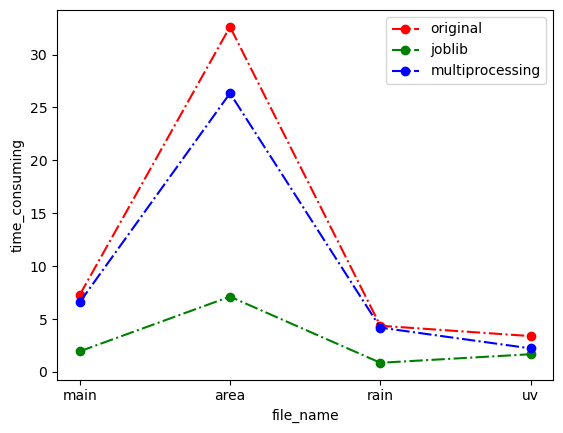

In [91]:
plt.plot(name_list,time_list_none,'ro-.',label='original')
plt.plot(name_list,time_list_joblib,'go-.',label='joblib')
plt.plot(name_list,time_list_mul,'bo-.',label='multiprocessing')
plt.xlabel('file_name')
plt.ylabel('time_consuming')
plt.legend()
plt.show()